In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import os
os.chdir("/content/drive/MyDrive/triple_mnist")
!ls

generator_state.pt	 np_save_test_labels.npy   np_save_val_images.npy  train
np_save.npy		 np_save_train_images.npy  np_save_val_labels.npy  val
np_save_test_images.npy  np_save_train_labels.npy  test


In [ ]:
train_dir = os.path.join(dataset_dir, 'train')
validation_dir = os.path.join(dataset_dir, 'val')
test_dir = os.path.join(dataset_dir, 'test')


NameError: name 'dataset_dir' is not defined

In [ ]:
train_images = np.load('/content/drive/MyDrive/np_saves/np_save_train_images.npy')
train_labels = np.load('/content/drive/MyDrive/np_saves/np_save_train_labels.npy')
test_images = np.load('/content/drive/MyDrive/np_saves/np_save_test_images.npy')
test_labels = np.load('/content/drive/MyDrive/np_saves/np_save_test_labels.npy')
val_images = np.load('/content/drive/MyDrive/np_saves/np_save_val_images.npy')
val_labels = np.load('/content/drive/MyDrive/np_saves/np_save_val_labels.npy')


NameError: name 'np' is not defined

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

In [ ]:
test_images = np.load('/content/drive/MyDrive/npy_2/np_save_test_images_2.npy')
test_labels = np.load('/content/drive/MyDrive/npy_2/np_save_test_labels_2.npy')
val_images = np.load('/content/drive/MyDrive/npy_2/np_save_val_images_2.npy')
val_labels = np.load('/content/drive/MyDrive/npy_2/np_save_val_labels_2.npy')
train_images = np.load('/content/drive/MyDrive/npy_2/np_save_train_images_2.npy')
train_labels = np.load('/content/drive/MyDrive/npy_2/np_save_train_labels_2.npy')

In [ ]:
print(test_images.shape)
print(test_labels.shape)
print(test_labels[1])
print(val_images.shape)
print(val_labels.shape)
print(val_labels[1])
print(train_images.shape)
print(train_labels.shape)
print(train_labels[1])

(20000, 84, 84)
(20000,)
002
(16000, 84, 84)
(16000,)
001
(64000, 84, 84)
(64000,)
000


In [ ]:
# prompt: get the number of unique labels in test val and train labels. add them

unique_train_labels = np.unique(train_labels)
num_unique_train_labels = len(unique_train_labels)

unique_val_labels = np.unique(val_labels)
num_unique_val_labels = len(unique_val_labels)

unique_test_labels = np.unique(test_labels)
num_unique_test_labels = len(unique_test_labels)

total_unique_labels = num_unique_train_labels + num_unique_val_labels + num_unique_test_labels

print(f"Number of unique labels in train set: {num_unique_train_labels}")
print(f"Number of unique labels in validation set: {num_unique_val_labels}")
print(f"Number of unique labels in test set: {num_unique_test_labels}")
print(f"Total number of unique labels: {total_unique_labels}")

Number of unique labels in train set: 640
Number of unique labels in validation set: 160
Number of unique labels in test set: 200
Total number of unique labels: 1000


In [ ]:
test_min = test_images.min()
test_max = test_images.max()
test_mean = test_images.mean()

print("Test images statistics:")
print("Min:", test_min)
print("Max:", test_max)
print("Mean:", test_mean)

train_min = train_images.min()
train_max = train_images.max()
train_mean = train_images.mean()

print("Train images statistics:")
print("Min:", train_min)
print("Max:", train_max)

Test images statistics:
Min: 0
Max: 255
Mean: 11.225057553854874
Train images statistics:
Min: 0
Max: 255


In [ ]:
import numpy as np
from sklearn.decomposition import PCA
from sklearn.decomposition import IncrementalPCA


train_images = train_images.reshape(train_images.shape[0], -1)
#test_images = test_images.reshape(test_images.shape[0], -1)
#val_images = val_images.reshape(val_images.shape[0], -1)

pca = IncrementalPCA(n_components=250)  # Adjust the number of components as needed
train_images = pca.fit_transform(train_images)
#test_images = pca.fit_transform(test_images)
#val_images = pca.fit_transform(val_images)

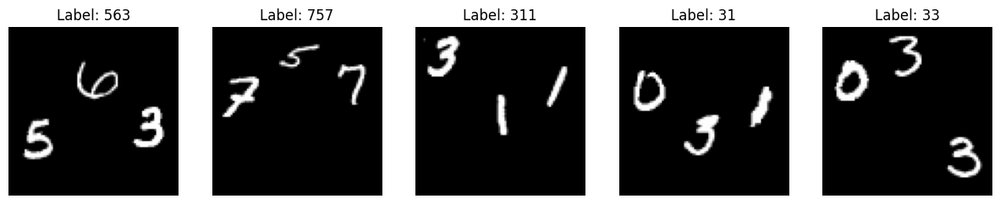

In [ ]:
import matplotlib.pyplot as plt

# Select 5 random indices
random_indices = np.random.choice(len(train_images), size=5, replace=False)

# Plot the images
fig, axes = plt.subplots(1, 5, figsize=(15, 15))
for i, idx in enumerate(random_indices):
    ax = axes[i]
    ax.imshow(train_images[idx].squeeze(), cmap='gray')
    ax.set_title(f"Label: {np.argmax(train_labels[idx])}")
    ax.axis('off')
plt.show()

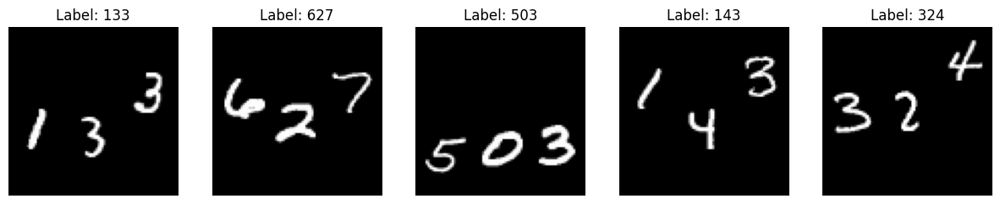

In [ ]:
import matplotlib.pyplot as plt

# Select 5 random indices
random_indices = np.random.choice(len(val_images), size=5, replace=False)

# Plot the images
fig, axes = plt.subplots(1, 5, figsize=(15, 15))
for i, idx in enumerate(random_indices):
    ax = axes[i]
    ax.imshow(val_images[idx].squeeze(), cmap='gray')
    ax.set_title(f"Label: {np.argmax(val_labels[idx])}")
    ax.axis('off')
plt.show()

In [ ]:
import cv2
import numpy as np
from PIL import Image

dataset_dir = '/content/drive/MyDrive/triple_mnist'

train_dir = os.path.join(dataset_dir, 'train')
validation_dir = os.path.join(dataset_dir, 'val')
test_dir = os.path.join(dataset_dir, 'test')

def load_images(directory):
  images = []
  labels = []
  for subdir in os.listdir(directory):
    subdir_path = os.path.join(directory, subdir)
    if subdir.startswith('00') or subdir.startswith('01'):
      for filename in os.listdir(subdir_path):
        img_path = os.path.join(subdir_path, filename)
        im = Image.open(img_path)
        im.draft('L', (im.width, im.height))
        images.append(np.asarray(im))
        labels.append(subdir)
    return np.array(images), np.array(labels)

dataset_train_images, dataset_train_labels = load_images(train_dir)
dataset_test_images, dataset_test_labels = load_images(test_dir)
dataset_val_images, dataset_val_labels = load_images(validation_dir)
print(dataset_test_images.shape)
print(dataset_test_labels.shape)
test_min = dataset_test_images.min()
test_max = dataset_test_images.max()
test_mean = dataset_test_images.mean()

print("Test images statistics:")
print("Min:", test_min)
print("Max:", test_max)
print("Mean:", test_mean)
print(test_images.shape)
print(test_labels.shape)
print(test_labels[1])


(0,)
(0,)


ValueError: zero-size array to reduction operation minimum which has no identity

In [ ]:
import cv2
import numpy as np
from PIL import Image

dataset_dir = '/content/drive/MyDrive/triple_mnist'

train_dir = os.path.join(dataset_dir, 'train')
validation_dir = os.path.join(dataset_dir, 'val')
test_dir = os.path.join(dataset_dir, 'test')

def load_images(directory):
  images = []
  labels = []
  for subdir in os.listdir(directory):
    subdir_path = os.path.join(directory, subdir)
    if subdir.startswith('00') or subdir.startswith('01'):
      for filename in os.listdir(subdir_path):
        img_path = os.path.join(subdir_path, filename)
        im = Image.open(img_path)
        im.draft('L', (im.width, im.height))
        images.append(np.asarray(im))
        labels.append(subdir)
  # The return statement should be outside the outer loop
  return np.array(images), np.array(labels) # Moved outside the loop

dataset_train_images, dataset_train_labels = load_images(train_dir)
dataset_test_images, dataset_test_labels = load_images(test_dir)
dataset_val_images, dataset_val_labels = load_images(validation_dir)
print(dataset_test_images.shape)
print(dataset_test_labels.shape)
test_min = dataset_test_images.min()
test_max = dataset_test_images.max()
test_mean = dataset_test_images.mean()

print("Test images statistics:")
print("Min:", test_min)
print("Max:", test_max)
print("Mean:", test_mean)
print(dataset_test_images.shape)
print(dataset_test_labels.shape)
print(dataset_test_labels[1])

(600, 84, 84)
(600,)
Test images statistics:
Min: 0
Max: 255
Mean: 12.303930697278911
(600, 84, 84)
(600,)
003


Lengths:  640 160
Overlaps:  []
Lengths:  640 200
Overlaps:  []
Lengths:  160 200
Overlaps:  []
1000
600
400
(1000, 84, 84)
(600, 84, 84)
(400, 84, 84)
(1000,)
(600,)
(400,)
10
6
4


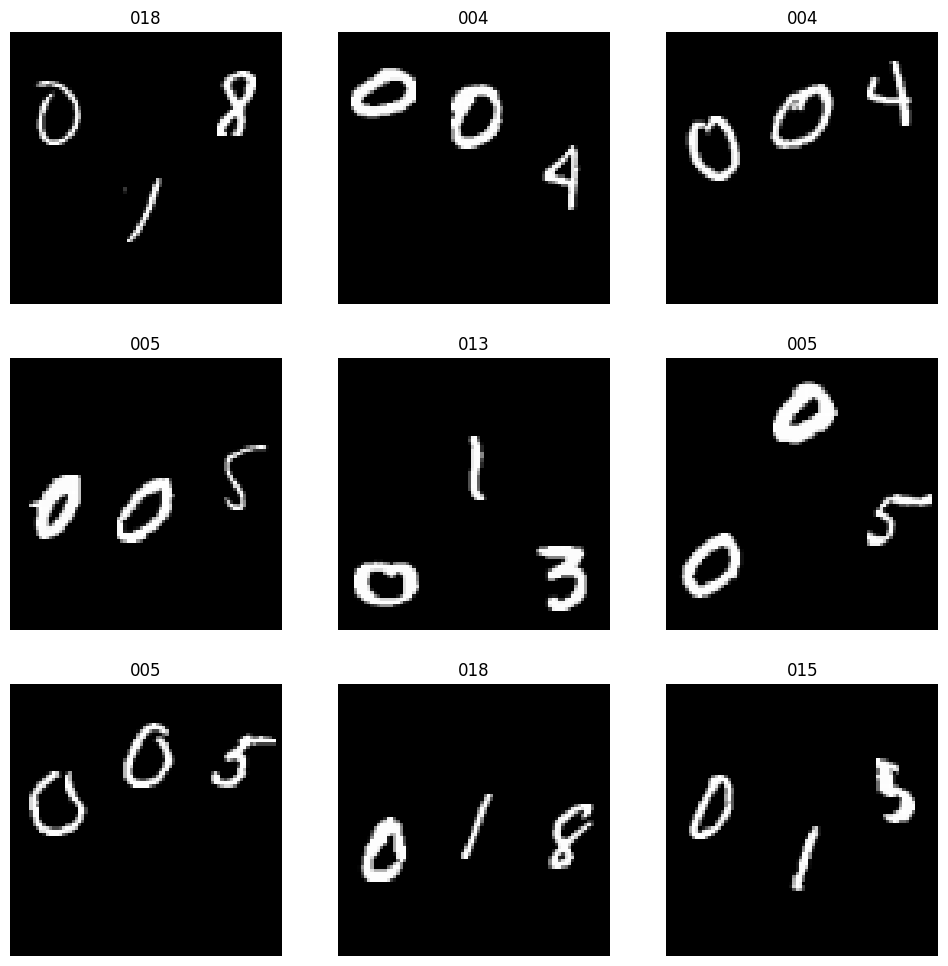

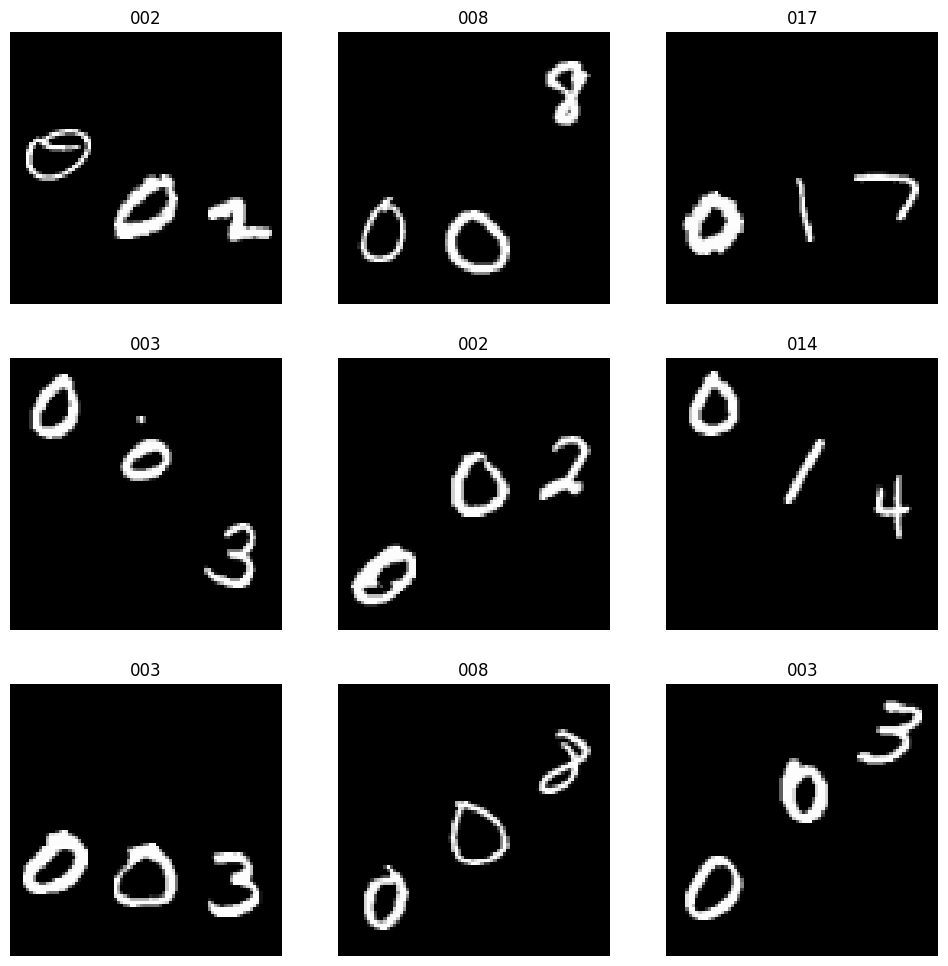

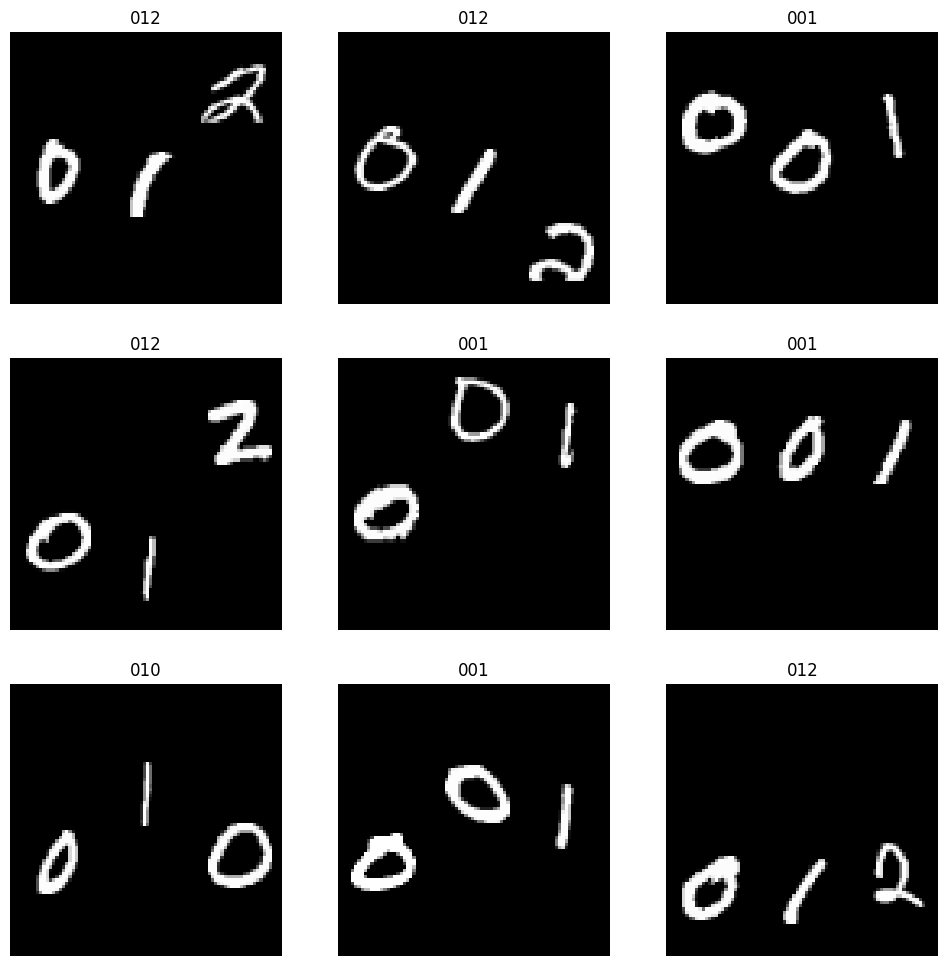

1000
(1000, 84, 84)
600
(600, 84, 84)
400
(400, 84, 84)


In [ ]:
# TASK-1

import os
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
from sklearn.utils import shuffle
import cv2

dataset_dir = '/content/drive/MyDrive/triple_mnist'

train_dir = os.path.join(dataset_dir, 'train')
validation_dir = os.path.join(dataset_dir, 'val')
test_dir = os.path.join(dataset_dir, 'test')

def check_overlap(directory1, directory2):
    images = []
    labels = []
    d1 = os.listdir(directory1)
    d2 = os.listdir(directory2)
    print("Lengths: ", len(d1), len(d2))
    overlaps = list(set(d1) & set(d2))
    print("Overlaps: ", overlaps)

check_overlap(train_dir, validation_dir)
check_overlap(train_dir, test_dir)
check_overlap(validation_dir, test_dir)


def load_images(directory):
  images = []
  labels = []
  for subdir in os.listdir(directory):
    subdir_path = os.path.join(directory, subdir)
    if subdir.startswith('00') or subdir.startswith('01'):
      for filename in os.listdir(subdir_path):
        img_path = os.path.join(subdir_path, filename)
        #im = Image.open(img_path)
        #im.draft('L', (im.width, im.height))
        #images.append(np.asarray(im))
        img = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)
        images.append(img)
        labels.append(subdir)
  return np.array(images), np.array(labels)


train_images, train_labels = load_images(train_dir)
test_images, test_labels = load_images(test_dir)
val_images, val_labels = load_images(validation_dir)
print(len(train_images))
print(len(test_images))
print(len(val_images))
print(train_images.shape)
print(test_images.shape)
print(val_images.shape)
print(train_labels.shape)
print(test_labels.shape)
print(val_labels.shape)

print(len(np.unique(train_labels)))
print(len(np.unique(test_labels)))
print(len(np.unique(val_labels)))

def visualize(images, labels):
  np.random.seed(42)
  random_indices = np.random.choice(len(images), size=9, replace=False)
  random_images = images[random_indices]
  random_labels = labels[random_indices]

  fig, axes = plt.subplots(3, 3, figsize=(12, 12))
  for i, (img, label) in enumerate(zip(random_images, random_labels)):
      ax = axes[i // 3, i % 3]
      ax.imshow(img, cmap='gray')
      ax.set_title(label)
      ax.axis('off')
  plt.show()

visualize(train_images, train_labels)
visualize(test_images, test_labels)
visualize(val_images, val_labels)

'''
np.save('np_save_train_images', train_images)
np.save('np_save_train_labels', train_labels)
np.save('np_save_test_images', test_images)
np.save('np_save_test_labels', test_labels)
np.save('np_save_val_images', val_images)
np.save('np_save_val_labels', val_labels)
'''
loaded_train_images = np.load('np_save_train_images.npy')
print(len(loaded_train_images))
print(loaded_train_images.shape)
loaded_test_images = np.load('np_save_test_images.npy')
print(len(loaded_test_images))
print(loaded_test_images.shape)
loaded_val_images = np.load('np_save_val_images.npy')
print(len(loaded_val_images))
print(loaded_val_images.shape)



In [ ]:
#TASK-2 Logistic Regression
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
import numpy as np
import tensorflow as tf

flattened_train_images = train_images
flattened_test_images = test_images
flattened_val_images = val_images
print("Train size: ", flattened_train_images.shape)
print("Test size: ", flattened_test_images.shape)
print("Validation size: ", flattened_val_images.shape)

train_labels = tf.keras.utils.to_categorical(train_labels, num_classes=1000)
val_labels = tf.keras.utils.to_categorical(val_labels, num_classes=1000)
test_labels = tf.keras.utils.to_categorical(test_labels, num_classes=1000)



param_grid_lr = {
    'C': [0.1, 1, 10],
    'max_iter': [500, 1000, 2000],
    'penalty': ['l2']
}

lr_model = LogisticRegression()

best_params_lr = None
best_accuracy_lr = -1
for C in param_grid_lr['C']:
    for max_iter in param_grid_lr['max_iter']:
        for penalty in param_grid_lr['penalty']:
            lr_model.set_params(C=C, max_iter=max_iter, penalty=penalty)
            lr_model.fit(flattened_train_images, train_labels.argmax(axis=1))
            train_pred_lr = lr_model.predict(flattened_train_images)
            validation_pred_lr = lr_model.predict(flattened_val_images)
            #print(validation_pred_lr)
            #print(val_labels)
            accuracy_lr_train = accuracy_score(train_labels.argmax(axis=1), train_pred_lr)
            print("Train Accuracy (Logistic Regression):", accuracy_lr_train)
            accuracy_lr_val = accuracy_score(val_labels.argmax(axis=1), validation_pred_lr)
            print("Validation Accuracy (Logistic Regression):", accuracy_lr_val)
            if accuracy_lr_val > best_accuracy_lr:
                best_accuracy_lr = accuracy_lr_val
                best_params_lr = {'C': C, 'max_iter': max_iter, 'penalty': penalty}

print("Best Hyperparameters (Logistic Regression):", best_params_lr)
print("Best Accuracy (Logistic Regression):", best_accuracy_lr)

best_lr_model = LogisticRegression(**best_params_lr)
best_lr_model.fit(flattened_train_images, train_labels.argmax(axis=1))

validation_pred_lr = best_lr_model.predict(flattened_val_images)
print("Validation Accuracy (Logistic Regression):", accuracy_score(val_labels.argmax(axis=1), validation_pred_lr))
print("Validation Classification Report (Logistic Regression):\n", classification_report(val_labels.argmax(axis=1), validation_pred_lr))
print("Validation Confusion Matrix (Logistic Regression):\n", confusion_matrix(val_labels.argmax(axis=1), validation_pred_lr))

test_pred_lr = best_lr_model.predict(flattened_test_images)
print("Test Accuracy (Logistic Regression):", accuracy_score(test_labels.argmax(axis=1), test_pred_lr))
print("Test Classification Report (Logistic Regression):\n", classification_report(test_labels.argmax(axis=1), test_pred_lr))
print("Test Confusion Matrix (Logistic Regression):\n", confusion_matrix(test_labels.argmax(axis=1), test_pred_lr))




Train size:  (64000, 2367)
Test size:  (20000, 2367)
Validation size:  (16000, 2367)
Train Accuracy (Logistic Regression): 1.0
Validation Accuracy (Logistic Regression): 0.0
Train Accuracy (Logistic Regression): 1.0
Validation Accuracy (Logistic Regression): 0.0
Train Accuracy (Logistic Regression): 1.0
Validation Accuracy (Logistic Regression): 0.0
Train Accuracy (Logistic Regression): 1.0
Validation Accuracy (Logistic Regression): 0.0
Train Accuracy (Logistic Regression): 1.0
Validation Accuracy (Logistic Regression): 0.0
Train Accuracy (Logistic Regression): 1.0
Validation Accuracy (Logistic Regression): 0.0
Train Accuracy (Logistic Regression): 1.0
Validation Accuracy (Logistic Regression): 0.0
Train Accuracy (Logistic Regression): 1.0
Validation Accuracy (Logistic Regression): 0.0
Train Accuracy (Logistic Regression): 1.0
Validation Accuracy (Logistic Regression): 0.0
Best Hyperparameters (Logistic Regression): {'C': 0.1, 'max_iter': 500, 'penalty': 'l2'}
Best Accuracy (Logistic R

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_

Test Accuracy (Logistic Regression): 0.0
Test Classification Report (Logistic Regression):
               precision    recall  f1-score   support

           0       0.00      0.00      0.00       0.0
           2       0.00      0.00      0.00     100.0
           3       0.00      0.00      0.00     100.0
           4       0.00      0.00      0.00       0.0
           5       0.00      0.00      0.00       0.0
           6       0.00      0.00      0.00       0.0
           7       0.00      0.00      0.00       0.0
           8       0.00      0.00      0.00     100.0
           9       0.00      0.00      0.00       0.0
          11       0.00      0.00      0.00       0.0
          13       0.00      0.00      0.00       0.0
          14       0.00      0.00      0.00     100.0
          15       0.00      0.00      0.00       0.0
          16       0.00      0.00      0.00     100.0
          17       0.00      0.00      0.00     100.0
          18       0.00      0.00      0.00

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_

In [ ]:
from sklearn.preprocessing import StandardScaler
flattened_train_images = train_images.reshape(train_images.shape[0], -1)/255
flattened_val_images = val_images.reshape(val_images.shape[0], -1)/255
flattened_test_images = test_images.reshape(test_images.shape[0], -1)/255
print(f"flattened train shape {flattened_train_images.shape}")
print(f"f val s{flattened_val_images.shape}")
print(f"f t s{flattened_test_images.shape}")
test_min = flattened_test_images.min()
test_max = flattened_test_images.max()
test_mean = flattened_test_images.mean()

print("Test images statistics:")
print("Min:", test_min)
print("Max:", test_max)
print("Mean:", test_mean)

train_min = flattened_train_images.min()
train_max = flattened_train_images.max()
train_mean = flattened_train_images.mean()

print("Train images statistics:")
print("Min:", train_min)
print("Max:", train_max)
print("Mean:", train_mean)
scaler = StandardScaler()
scaled_flattened_train_images = scaler.fit_transform(flattened_train_images)
scaled_flattened_val_images = scaler.transform(flattened_val_images)
scaled_flattened_test_images = scaler.transform(flattened_test_images)


flattened train shape (64000, 7056)
f val s(16000, 7056)
f t s(20000, 7056)
Test images statistics:
Min: 0.0
Max: 1.0
Mean: 0.04401983354452888
Train images statistics:
Min: 0.0
Max: 1.0
Mean: 0.0439493152816683


Number of components explaining 95% variance: 2367


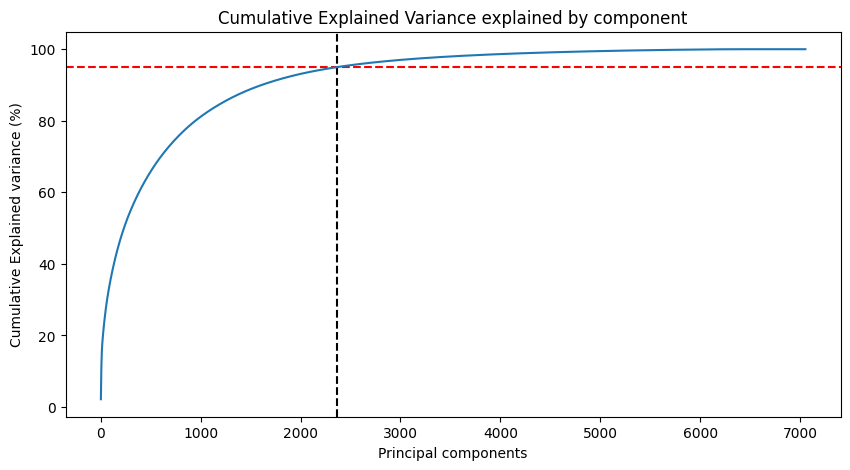

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.decomposition import IncrementalPCA




# Apply Incremental PCA to the subset
ipca = IncrementalPCA()
ipca.fit(scaled_flattened_train_images)

# Getting the cumulative variance
var_cumu = np.cumsum(ipca.explained_variance_ratio_) * 100

# How many PCs explain 95% of the variance?
k = np.argmax(var_cumu > 95) + 1  # +1 to get the number of components

print("Number of components explaining 95% variance: " + str(k))

# Plot the cumulative explained variance
plt.figure(figsize=[10, 5])
plt.title('Cumulative Explained Variance explained by component')
plt.ylabel('Cumulative Explained variance (%)')
plt.xlabel('Principal components')
plt.axvline(x=k, color="k", linestyle="--")
plt.axhline(y=95, color="r", linestyle="--")
plt.plot(var_cumu)
plt.show()

In [ ]:
from sklearn.decomposition import IncrementalPCA

ipca = IncrementalPCA(n_components=2367)  # Retain 95% of the variance
ipca_train_images = ipca.fit_transform(scaled_flattened_train_images)
print("Original shape:", scaled_flattened_train_images.shape)
print("Transformed shape:", ipca_train_images.shape)
ipca_val_images = ipca.transform(scaled_flattened_val_images)
print("Original shape:", scaled_flattened_val_images.shape)
print("Transformed shape:", ipca_val_images.shape)
ipca_test_images = ipca.transform(scaled_flattened_test_images)
print("Original shape:", scaled_flattened_test_images.shape)
print("Transformed shape:", ipca_test_images.shape)
print(ipca_test_images[1].shape)

Original shape: (64000, 7056)
Transformed shape: (64000, 2367)
Original shape: (16000, 7056)
Transformed shape: (16000, 2367)
Original shape: (20000, 7056)
Transformed shape: (20000, 2367)
(2367,)


PCA transformed flattened validation image 0:
[  1.47010588 -14.98425931  12.7267346  ...  -0.14534864   0.18383506
  -0.36772463]




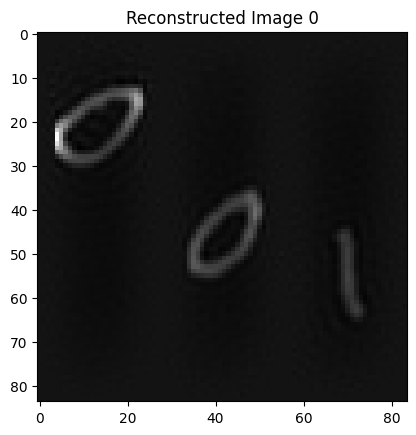

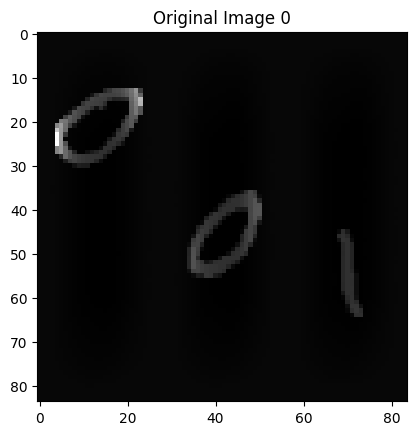

PCA transformed flattened validation image 1:
[ 13.75212277 -15.7267185   -9.30297981 ...   0.12021815  -0.51410698
  -0.39789391]




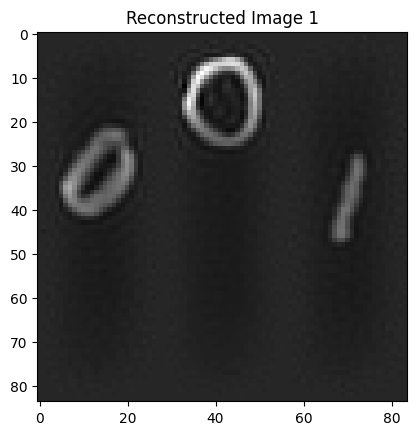

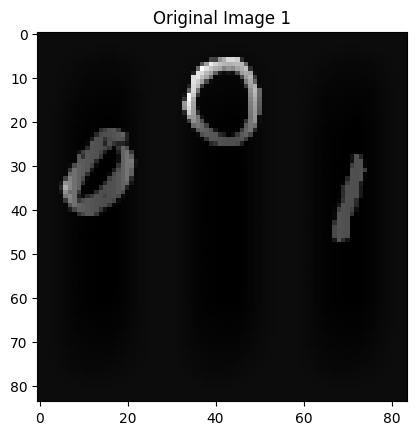

PCA transformed flattened validation image 2:
[-1.58510573e+01 -1.36978394e+01  1.13133381e+01 ...  5.44877726e-01
 -1.33774268e-02 -8.38515413e-01]




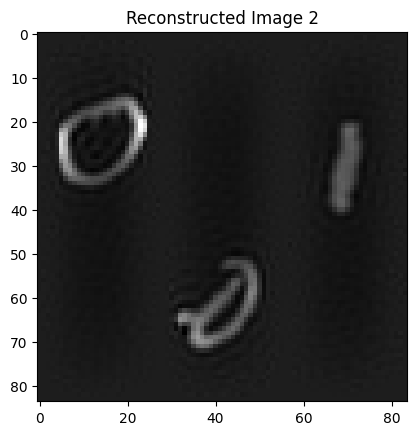

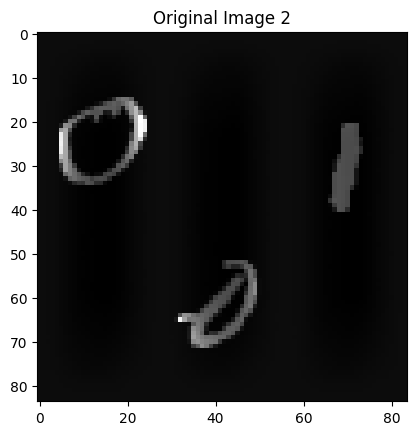

PCA transformed flattened validation image 3:
[  8.68357305  12.3687687  -12.84076866 ...   0.23809715  -0.0436559
   0.59133564]




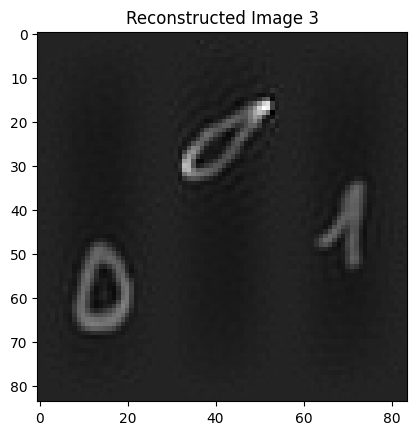

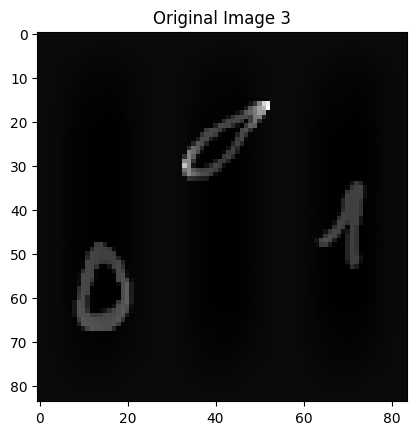

PCA transformed flattened validation image 4:
[  9.57671316   6.84918648 -23.03140622 ...  -0.81419844   0.19827469
   0.70566594]




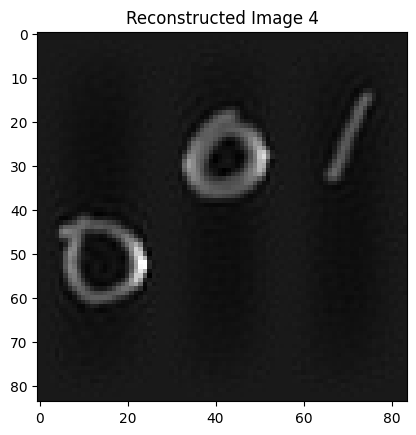

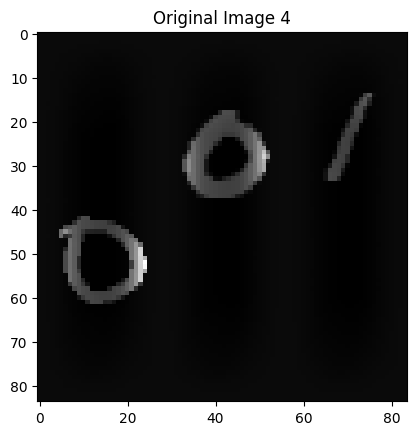

In [ ]:
import matplotlib.pyplot as plt

num_images_to_print = 5  # Number of images to print

for i in range(num_images_to_print):
    print(f"PCA transformed flattened validation image {i}:")
    print(ipca_val_images[i])
    print("\n")


    # Inverse transform the PCA-transformed image
    image_recon = ipca.inverse_transform(ipca_val_images[i].reshape(1, -1))

    # Reshape the reconstructed image back to its original 2D shape
    image_recon = image_recon.reshape(84, 84)
    og_image = scaled_flattened_val_images[i].reshape(84, 84)
    # Plot the reconstructed image
    plt.figure()
    plt.title(f"Reconstructed Image {i}")
    plt.imshow(image_recon, cmap='gray')
    # Plot the original image
    plt.figure()
    plt.title(f"Original Image {i}")
    plt.imshow(og_image, cmap='gray')
    plt.show()

In [ ]:
print(sklearn.version_info)

In [ ]:
import numpy as np

In [ ]:
ipca_val_images = np.load('/content/drive/MyDrive/ipca_95/ipca_val_images_2.npy')
print(ipca_val_images.shape)
ipca_train_images = np.load('/content/drive/MyDrive/ipca_95/ipca_train_images_2.npy')
print(ipca_train_images.shape)
ipca_test_images = np.load('/content/drive/MyDrive/ipca_95/ipca_test_images_2.npy')
print(ipca_test_images.shape)

(16000, 2367)
(64000, 2367)
(20000, 2367)


In [ ]:
import sklearn
print(sklearn.__version__)

1.6.0


In [ ]:
train_labels = np.load('/content/drive/MyDrive/npy_2/np_save_train_labels_2.npy')
test_labels = np.load('/content/drive/MyDrive/npy_2/np_save_test_labels_2.npy')
val_labels = np.load('/content/drive/MyDrive/npy_2/np_save_val_labels_2.npy')

In [ ]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import cross_val_score
import numpy as np
# Step 5: Hyperparameter Tuning for Logistic Regression
param_grid_lr = {
    'C': [0.1, 1, 10],
    'max_iter': [500, 1000, 2000],
    'penalty': ['l2']
}

best_params_lr = None
best_accuracy_lr = -1

# Hyperparameter tuning
for C in param_grid_lr['C']:
    for max_iter in param_grid_lr['max_iter']:
        for penalty in param_grid_lr['penalty']:
            print(f"C: {C}, max_iter: {max_iter}, penalty: {penalty}")
            lr_model = LogisticRegression(C=C, max_iter=max_iter, penalty=penalty, random_state=42, solver='saga')
            #lr_model = LogisticRegression(C=C, max_iter=max_iter, penalty=penalty, random_state=42
            lr_model.fit(ipca_train_images, train_labels)
            val_pred_lr = lr_model.predict(ipca_val_images)
            val_accuracy = accuracy_score(val_labels, val_pred_lr)
            print(f"Validation Accuracy (C={C}, max_iter={max_iter}, penalty={penalty}): {val_accuracy:.4f}")
            if val_accuracy > best_accuracy_lr:
                best_accuracy_lr = val_accuracy
                best_params_lr = {'C': C, 'max_iter': max_iter, 'penalty': penalty}

print("Best Hyperparameters (Logistic Regression):", best_params_lr)
print("Best Validation Accuracy (Logistic Regression):", best_accuracy_lr)

# Step 6: Train the Best Model on the Entire Training Set
best_lr_model = LogisticRegression(**best_params_lr, random_state=42)
best_lr_model.fit(ipca_train_images, train_labels)

# Step 7: Evaluate on Validation and Test Sets
val_pred_lr = best_lr_model.predict(ipca_val_images)
print("Validation Accuracy (Logistic Regression):", accuracy_score(val_labels, val_pred_lr))
print("Validation Classification Report (Logistic Regression):\n", classification_report(val_labels, val_pred_lr))
print("Validation Confusion Matrix (Logistic Regression):\n", confusion_matrix(val_labels, val_pred_lr))

test_pred_lr = best_lr_model.predict(ipca_test_images)
print("Test Accuracy (Logistic Regression):", accuracy_score(test_labels, test_pred_lr))
print("Test Classification Report (Logistic Regression):\n", classification_report(test_labels, test_pred_lr))
print("Test Confusion Matrix (Logistic Regression):\n", confusion_matrix(test_labels, test_pred_lr))


C: 0.1, max_iter: 500, penalty: l2


In [ ]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
from sklearn.model_selection import cross_val_score
import numpy as np

# Step 5: Hyperparameter Tuning for Logistic Regression
param_grid_lr = {
    'C': [0.1, 1, 10],
    'max_iter': [500, 1000, 2000]
    # 'penalty': ['l2']  # If you want to keep penalty as a hyperparam, you can re-add it
}

best_params_lr = None
best_accuracy_lr = -1

# Hyperparameter tuning
for C in param_grid_lr['C']:
    for max_iter in param_grid_lr['max_iter']:
        # If you want to keep penalty in the loop:
        # for penalty in param_grid_lr['penalty']:
        #     lr_model = LogisticRegression(C=C, max_iter=max_iter, penalty=penalty,
        #                                   multi_class='multinomial', solver='saga',
        #                                   random_state=42)

        # Otherwise, just do:
        lr_model = LogisticRegression(
            C=C,
            max_iter=max_iter,
            penalty='l2',               # Usually 'l2' for 'multinomial' with 'saga'
            multi_class='multinomial',  # The key change
            solver='saga',             # Good for large-scale, supports 'multinomial'
            random_state=42
        )

        lr_model.fit(ipca_train_images, train_labels)
        val_pred_lr = lr_model.predict(ipca_val_images)
        val_accuracy = accuracy_score(val_labels, val_pred_lr)

        print(f"Validation Accuracy (C={C}, max_iter={max_iter}): {val_accuracy:.4f}")

        if val_accuracy > best_accuracy_lr:
            best_accuracy_lr = val_accuracy
            best_params_lr = {
                'C': C,
                'max_iter': max_iter,
                'penalty': 'l2',              # or penalty if you reintroduce it
                'multi_class': 'multinomial',
                'solver': 'saga'
            }

print("Best Hyperparameters (Logistic Regression):", best_params_lr)
print("Best Validation Accuracy (Logistic Regression):", best_accuracy_lr)

# Step 6: Train the Best Model on the Entire Training Set
best_lr_model = LogisticRegression(
    **{k: v for k, v in best_params_lr.items() if k in ['C','max_iter','penalty','multi_class','solver']},
    random_state=42
)
best_lr_model.fit(ipca_train_images, train_labels)

# Step 7: Evaluate on Validation and Test Sets
val_pred_lr = best_lr_model.predict(ipca_val_images)
print("Validation Accuracy (Logistic Regression):", accuracy_score(val_labels, val_pred_lr))
print("Validation Classification Report (Logistic Regression):\n", classification_report(val_labels, val_pred_lr))
print("Validation Confusion Matrix (Logistic Regression):\n", confusion_matrix(val_labels, val_pred_lr))

test_pred_lr = best_lr_model.predict(ipca_test_images)
print("Test Accuracy (Logistic Regression):", accuracy_score(test_labels, test_pred_lr))
print("Test Classification Report (Logistic Regression):\n", classification_report(test_labels, test_pred_lr))
print("Test Confusion Matrix (Logistic Regression):\n", confusion_matrix(test_labels, test_pred_lr))


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:1247: FutureWarning: 'multi_class' was deprecated in version 1.5 and will be removed in 1.7. From then on, it will always use 'multinomial'. Leave it to its default value to avoid this warning.
  warnings.warn(


In [ ]:

from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import cross_val_score
import numpy as np
# Step 5: Hyperparameter Tuning for Logistic Regression
param_grid_lr = {
    'C': [0.1, 1, 10],
    'max_iter': [500, 1000, 2000],
    'penalty': ['l2']
}

best_params_lr = None
best_accuracy_lr = -1

# Hyperparameter tuning
for C in param_grid_lr['C']:
    for max_iter in param_grid_lr['max_iter']:
        for penalty in param_grid_lr['penalty']:
            lr_model = LogisticRegression(C=C, max_iter=max_iter, penalty=penalty, random_state=42)
            lr_model.fit(ipca_train_images, train_labels)
            val_pred_lr = lr_model.predict(ipca_val_images)
            val_accuracy = accuracy_score(val_labels, val_pred_lr)
            print(f"Validation Accuracy (C={C}, max_iter={max_iter}, penalty={penalty}): {val_accuracy:.4f}")
            if val_accuracy > best_accuracy_lr:
                best_accuracy_lr = val_accuracy
                best_params_lr = {'C': C, 'max_iter': max_iter, 'penalty': penalty}

print("Best Hyperparameters (Logistic Regression):", best_params_lr)
print("Best Validation Accuracy (Logistic Regression):", best_accuracy_lr)

# Step 6: Train the Best Model on the Entire Training Set
best_lr_model = LogisticRegression(**best_params_lr, random_state=42)
best_lr_model.fit(ipca_train_images, train_labels)

# Step 7: Evaluate on Validation and Test Sets
val_pred_lr = best_lr_model.predict(ipca_val_images)
print("Validation Accuracy (Logistic Regression):", accuracy_score(val_labels, val_pred_lr))
print("Validation Classification Report (Logistic Regression):\n", classification_report(val_labels, val_pred_lr))
print("Validation Confusion Matrix (Logistic Regression):\n", confusion_matrix(val_labels, val_pred_lr))

test_pred_lr = best_lr_model.predict(ipca_test_images)
print("Test Accuracy (Logistic Regression):", accuracy_score(test_labels, test_pred_lr))
print("Test Classification Report (Logistic Regression):\n", classification_report(test_labels, test_pred_lr))
print("Test Confusion Matrix (Logistic Regression):\n", confusion_matrix(test_labels, test_pred_lr))


Validation Accuracy (C=0.1, max_iter=500, penalty=l2): 0.0000
Validation Accuracy (C=0.1, max_iter=1000, penalty=l2): 0.0000
Validation Accuracy (C=0.1, max_iter=2000, penalty=l2): 0.0000
Validation Accuracy (C=1, max_iter=500, penalty=l2): 0.0000
Validation Accuracy (C=1, max_iter=1000, penalty=l2): 0.0000
Validation Accuracy (C=1, max_iter=2000, penalty=l2): 0.0000
Validation Accuracy (C=10, max_iter=500, penalty=l2): 0.0000
Validation Accuracy (C=10, max_iter=1000, penalty=l2): 0.0000
Validation Accuracy (C=10, max_iter=2000, penalty=l2): 0.0000
Best Hyperparameters (Logistic Regression): {'C': 0.1, 'max_iter': 500, 'penalty': 'l2'}
Best Validation Accuracy (Logistic Regression): 0.0
Validation Accuracy (Logistic Regression): 0.0
Validation Classification Report (Logistic Regression):
               precision    recall  f1-score   support

         000       0.00      0.00      0.00       0.0
         001       0.00      0.00      0.00     100.0
         004       0.00      0.00    

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_

Test Accuracy (Logistic Regression): 0.0
Test Classification Report (Logistic Regression):
               precision    recall  f1-score   support

         000       0.00      0.00      0.00       0.0
         002       0.00      0.00      0.00     100.0
         003       0.00      0.00      0.00     100.0
         004       0.00      0.00      0.00       0.0
         005       0.00      0.00      0.00       0.0
         006       0.00      0.00      0.00       0.0
         007       0.00      0.00      0.00       0.0
         008       0.00      0.00      0.00     100.0
         009       0.00      0.00      0.00       0.0
         011       0.00      0.00      0.00       0.0
         013       0.00      0.00      0.00       0.0
         014       0.00      0.00      0.00     100.0
         015       0.00      0.00      0.00       0.0
         016       0.00      0.00      0.00     100.0
         017       0.00      0.00      0.00     100.0
         018       0.00      0.00      0.00

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_

In [ ]:
#TASK-2 CNN
import tensorflow as tf
import tensorflow.keras as keras
from tensorflow.keras import layers, models

import cv2
from tensorflow.keras.preprocessing.image import ImageDataGenerator


#TASK-2 CNN
import tensorflow as tf
import tensorflow.keras as keras
from tensorflow.keras import layers, models

train_images = train_images / 255.0
train_images = train_images.astype(np.float32)
val_images = val_images / 255.0
val_images = val_images.astype(np.float32)
test_images = test_images / 255.0
test_images = test_images.astype(np.float32)

train_images = train_images.reshape((train_images.shape[0], 84, 84, 1))
val_images = val_images.reshape((val_images.shape[0], 84, 84, 1))
test_images = test_images.reshape((test_images.shape[0], 84, 84, 1))

print('Training data shape:', train_images.shape, train_labels.shape)
print('Validation data shape:', val_images.shape, val_labels.shape)
print('Test data shape:', test_images.shape, test_labels.shape)

train_labels = tf.keras.utils.to_categorical(train_labels, num_classes=1000)
val_labels = tf.keras.utils.to_categorical(val_labels, num_classes=1000)
test_labels = tf.keras.utils.to_categorical(test_labels, num_classes=1000)

model = tf.keras.models.Sequential()
model.add(layers.Conv2D(8, (3, 3), activation='relu', strides=2, input_shape=(84, 84, 1), dtype='float32'))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Conv2D(16, (3, 3), activation='relu', strides=2))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Flatten())
model.add(layers.Dropout(0.5))
model.add(layers.Dense(1000, activation='softmax'))
model.summary()

param_grid_cnn = {
    'batch_size': [8, 16],
    'epochs': [1, 3],
    'learning_rate': [1e-1, 1e-2, 1e-3],
}

best_params_cnn = None
best_accuracy_cnn = -1
for batch_size in param_grid_cnn['batch_size']:
    for epochs in param_grid_cnn['epochs']:
        for learning_rate in param_grid_cnn['learning_rate']:
          model.compile(loss="categorical_crossentropy", optimizer=keras.optimizers.Adam(learning_rate=learning_rate), metrics=["accuracy"])

          history = model.fit(train_images, train_labels, batch_size=batch_size, epochs=epochs, validation_data=(val_images, val_labels))

          score_train = model.evaluate(train_images, train_labels, verbose=0)
          print("Train loss:", score_train[0])
          print("Train accuracy:", score_train[1])
          score_val = model.evaluate(val_images, val_labels, verbose=0)
          print("Validation loss:", score_val[0])
          print("Validation accuracy:", score_val[1])
          if score_val[1] > best_accuracy_cnn:
                  best__cnn = score_val[0]
                  best_params_cnn = {'batch_size': batch_size, 'epochs': epochs}

print("Best Hyperparameters (CNN):", best_params_cnn)
print("Best Loss Score (CNN):", best_loss_cnn)

plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

score = model.evaluate(test_images, test_labels, verbose=0)
print("Test loss:", score[0])
print("Test accuracy:", score[1])



In [ ]:
#TASK-2 CNN
import tensorflow as tf
import tensorflow.keras as keras
from tensorflow.keras import layers, models

import cv2
from tensorflow.keras.preprocessing.image import ImageDataGenerator

from tensorflow.keras.callbacks import ModelCheckpoint

#TASK-2 CNN
import tensorflow as tf
import tensorflow.keras as keras
from tensorflow.keras import layers, models

train_images = train_images / 255.0
train_images = train_images.astype(np.float32)
val_images = val_images / 255.0
val_images = val_images.astype(np.float32)
test_images = test_images / 255.0
test_images = test_images.astype(np.float32)

train_images = train_images.reshape((train_images.shape[0], 84, 84, 1))
val_images = val_images.reshape((val_images.shape[0], 84, 84, 1))
test_images = test_images.reshape((test_images.shape[0], 84, 84, 1))

print('Training data shape:', train_images.shape, train_labels.shape)
print('Validation data shape:', val_images.shape, val_labels.shape)
print('Test data shape:', test_images.shape, test_labels.shape)

train_labels = tf.keras.utils.to_categorical(train_labels, num_classes=1000)
val_labels = tf.keras.utils.to_categorical(val_labels, num_classes=1000)
test_labels = tf.keras.utils.to_categorical(test_labels, num_classes=1000)



param_grid_cnn = {
    'batch_size': [8, 16],
    'epochs': [1, 3],
    'learning_rate': [1e-1, 1e-2, 1e-3],
}

best_params_cnn = None
best_val_accuracy = -1
best_history = None

for batch_size in param_grid_cnn['batch_size']:
    for epochs in param_grid_cnn['epochs']:
        for learning_rate in param_grid_cnn['learning_rate']:
          model = tf.keras.models.Sequential()
          model.add(layers.Conv2D(8, (3, 3), activation='relu', strides=2, input_shape=(84, 84, 1), dtype='float32'))
          model.add(layers.MaxPooling2D((2, 2)))
          model.add(layers.Conv2D(16, (3, 3), activation='relu', strides=2))
          model.add(layers.MaxPooling2D((2, 2)))
          model.add(layers.Flatten())
          model.add(layers.Dropout(0.5))
          model.add(layers.Dense(1000, activation='softmax'))
          model.compile(loss="categorical_crossentropy", optimizer=keras.optimizers.Adam(learning_rate=learning_rate), metrics=["accuracy"])




          history = model.fit(
                train_images, train_labels,
                batch_size=batch_size,
                epochs=epochs,
                validation_data=(val_images, val_labels),
                callbacks=[model_checkpoint],
                verbose=1
            )


          score_val = model.evaluate(val_images, val_labels, verbose=0)
          print("Validation loss:", score_val[0])
          print("Validation accuracy:", score_val[1])
          if score_val[1] > best_val_accuracy:
                  best_val_accuracy = score_val[1]
                  best_params_cnn = {'batch_size': batch_size, 'epochs': epochs,'learning_rate':learning_rate,'model_filepath':checkpoint_filepath}
                  best_history = history
                  checkpoint_filepath = f"best_model_bs{batch_size}_ep{epochs}_lr{learning_rate}.keras"
                  model_checkpoint = ModelCheckpoint(checkpoint_filepath, monitor='val_accuracy', save_best_only=True, mode='max', verbose=1)

print("Best Hyperparameters (CNN):", best_params_cnn)
print("Best val accuracy Score (CNN):", best_val_accuracy)

plt.plot(best_history.history['loss'])
plt.plot(best_history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

plt.plot(best_history.history['accuracy'])
plt.plot(best_history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()
print("\nLoading the best model for final evaluation...")
best_model = tf.keras.models.load_model(best_params_cnn['model_filepath'])

score = best_model.evaluate(test_images, test_labels, verbose=0)
print("Test loss:", score[0])
print("Test accuracy:", score[1])

NameError: name 'train_images' is not defined

In [ ]:
import numpy as np########################################################################################################################################################################
import matplotlib.pyplot as plt
from tensorflow.keras.callbacks import ModelCheckpoint
from tensorflow.keras import metrics
from tensorflow.keras.callbacks import ModelCheckpoint
import tensorflow as tf
import tensorflow.keras as keras
from tensorflow.keras import layers, models

train_images = train_images / 255.0
train_images = train_images.astype(np.float32)
val_images = val_images / 255.0
val_images = val_images.astype(np.float32)
test_images = test_images / 255.0
test_images = test_images.astype(np.float32)

train_images = train_images.reshape((train_images.shape[0], 84, 84, 1))
val_images = val_images.reshape((val_images.shape[0], 84, 84, 1))
test_images = test_images.reshape((test_images.shape[0], 84, 84, 1))

train_labels = tf.keras.utils.to_categorical(train_labels, num_classes=1000)
val_labels = tf.keras.utils.to_categorical(val_labels, num_classes=1000)
test_labels = tf.keras.utils.to_categorical(test_labels, num_classes=1000)

# Hyperparameter grid
param_grid_cnn = {
    'batch_size': [8, 16],
    'epochs': [1, 3],
    'learning_rate': [1e-3, 1e-4, 1e-5],
}

best_params_cnn = None
best_val_loss = float('inf')
best_history = None

for batch_size in param_grid_cnn['batch_size']:
    for epochs in param_grid_cnn['epochs']:
        for learning_rate in param_grid_cnn['learning_rate']:
            # Define the model
            model = tf.keras.models.Sequential([
                layers.Conv2D(8, (3, 3), activation='relu', strides=2, input_shape=(84, 84, 1), dtype='float32'),
                layers.MaxPooling2D((2, 2)),
                layers.Conv2D(16, (3, 3), activation='relu', strides=2),
                layers.MaxPooling2D((2, 2)),
                layers.Flatten(),
                layers.Dense(1000, activation='softmax')
            ])
            model.compile(
                loss="categorical_crossentropy",
                optimizer=keras.optimizers.Adam(learning_rate=learning_rate),
                metrics=["accuracy",
                        metrics.Precision(),
                        metrics.Recall(),
                        metrics.AUC()]
            )

            # Define checkpoint callback
            checkpoint_filepath = f"best_model_bs{batch_size}_ep{epochs}_lr{learning_rate}.keras"
            model_checkpoint = ModelCheckpoint(checkpoint_filepath, monitor='val_accuracy', save_best_only=True, mode='max', verbose=1)

            # Train the model
            history = model.fit(
                train_images, train_labels,
                batch_size=batch_size,
                epochs=epochs,
                validation_data=(val_images, val_labels),
                callbacks=[model_checkpoint],
                verbose=1
            )

            # Evaluate on validation set
            score_val = model.evaluate(val_images, val_labels, verbose=0)
            print("Validation loss:", score_val[0])
            print("Validation accuracy:", score_val[1])
            print("Validation precision:", score_val[2])
            print("Validation recall:", score_val[3])
            print("Validation AUC:", score_val[4])

            # Update best model if needed
            if score_val[0] < best_val_loss:
                best_val_accuracy = score_val[1]
                best_params_cnn = {
                    'batch_size': batch_size,
                    'epochs': epochs,
                    'learning_rate': learning_rate,
                    'model_filepath': checkpoint_filepath
                }
                best_history = history

print("Best Hyperparameters (CNN):", best_params_cnn)
print("Best val loaa Score (CNN):", best_val_loss)


# Plot results
if best_history:
    plt.plot(best_history.history['loss'])
    plt.plot(best_history.history['val_loss'])
    plt.title('model loss')
    plt.ylabel('loss')
    plt.xlabel('epoch')
    plt.legend(['train', 'val'], loc='upper left')
    plt.show()

    plt.plot(best_history.history['accuracy'])
    plt.plot(best_history.history['val_accuracy'])
    plt.title('model accuracy')
    plt.ylabel('accuracy')
    plt.xlabel('epoch')
    plt.legend(['train', 'val'], loc='upper left')
    plt.show()

# Load and evaluate the best model
print("\nLoading the best model for final evaluation...")
best_model = tf.keras.models.load_model(best_params_cnn['model_filepath'])

score = best_model.evaluate(test_images, test_labels, verbose=0)
print("Test loss:", score[0])
print("Test accuracy:", score[1])

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import classification_report, confusion_matrix

In [ ]:
test_images = np.load('/content/drive/MyDrive/npy_2/np_save_test_images_2.npy')
test_labels = np.load('/content/drive/MyDrive/npy_2/np_save_test_labels_2.npy')
val_images = np.load('/content/drive/MyDrive/npy_2/np_save_val_images_2.npy')
val_labels = np.load('/content/drive/MyDrive/npy_2/np_save_val_labels_2.npy')
train_images = np.load('/content/drive/MyDrive/npy_2/np_save_train_images_2.npy')
train_labels = np.load('/content/drive/MyDrive/npy_2/np_save_train_labels_2.npy')

Label: 000
0
0
0
0
crop shape: (28, 28)
0
crop shape: (28, 28)
0
crop shape: (28, 28)


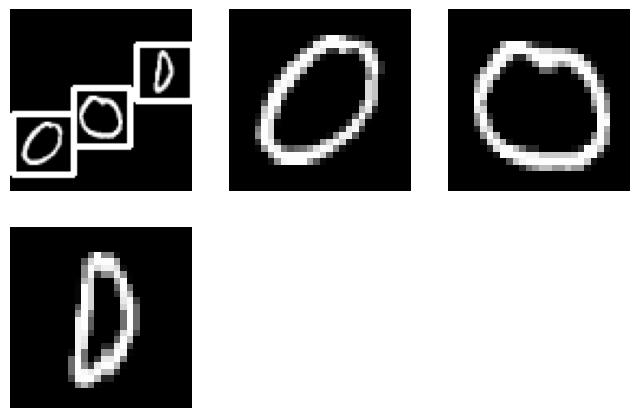

192000
60000
48000
(192000, 28, 28)
(60000, 28, 28)
(48000, 28, 28)
(192000,)
(60000,)
(48000,)
10
10
10


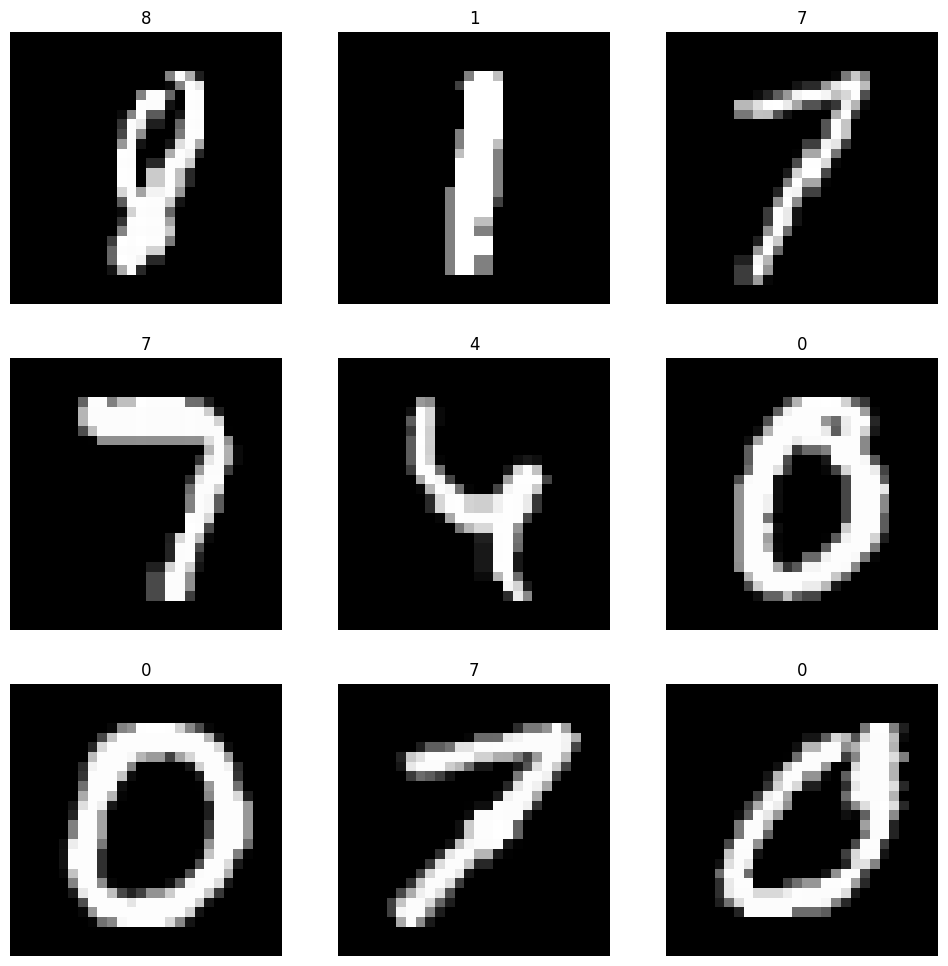

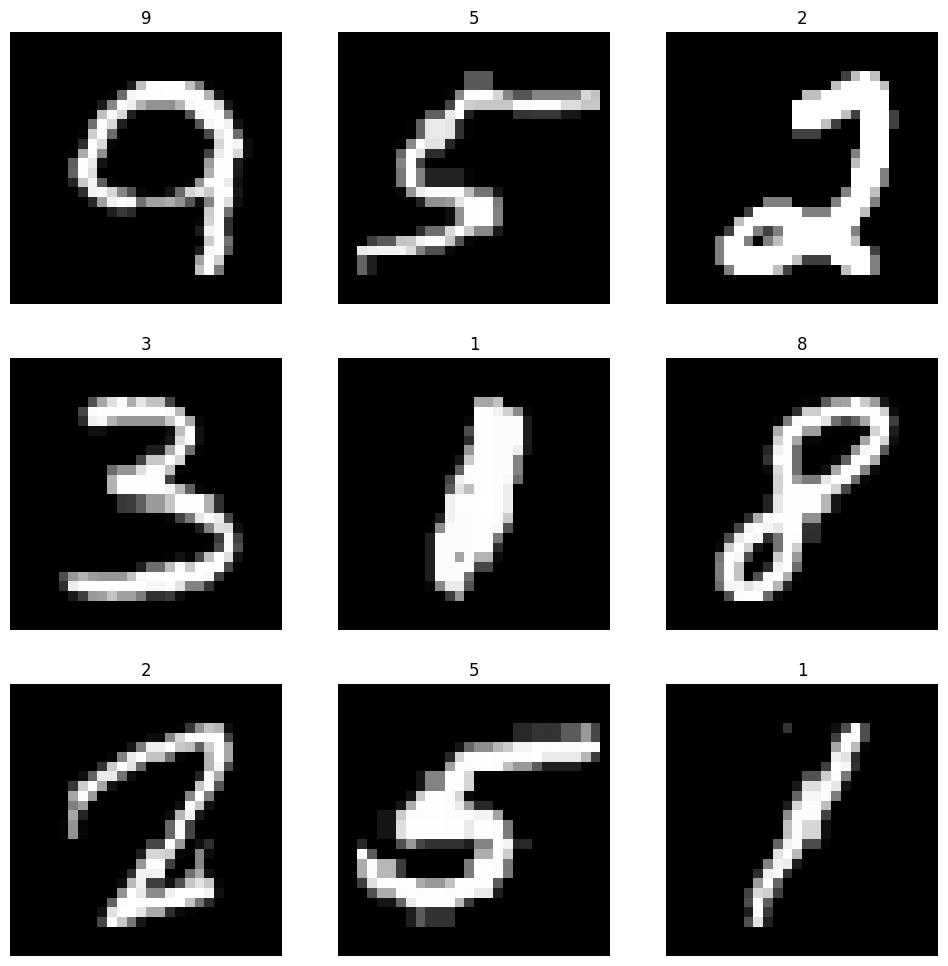

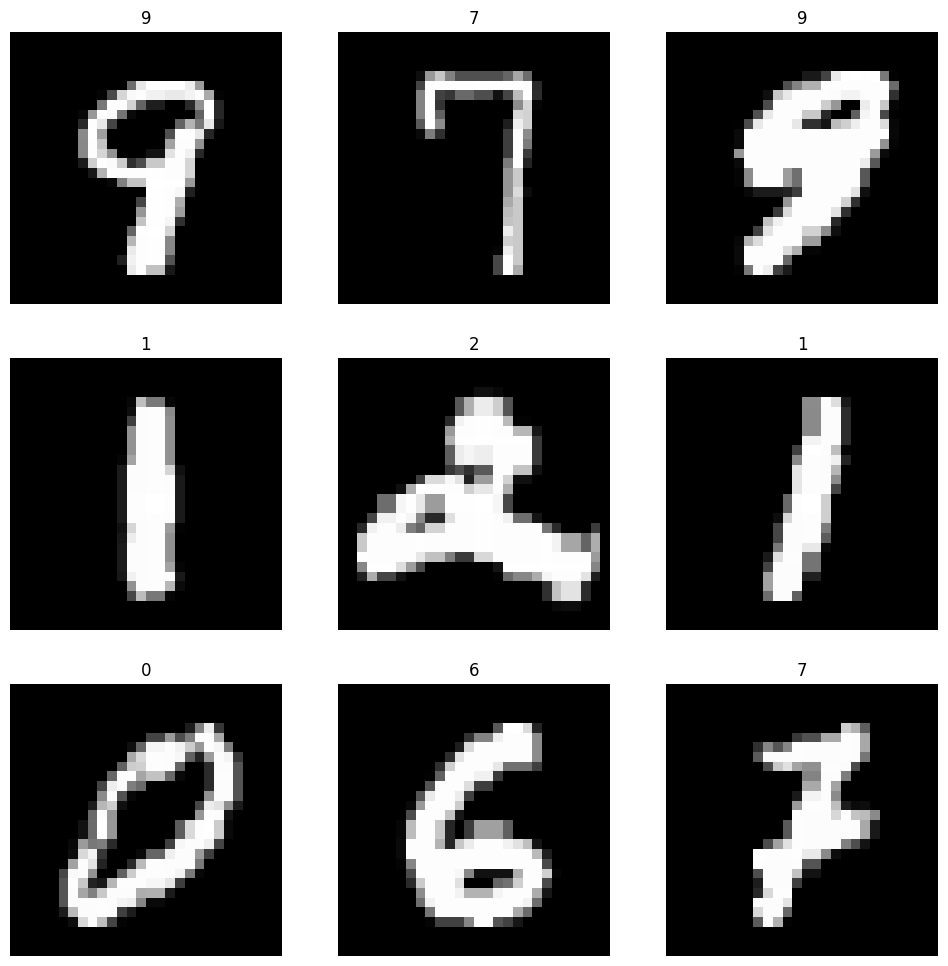

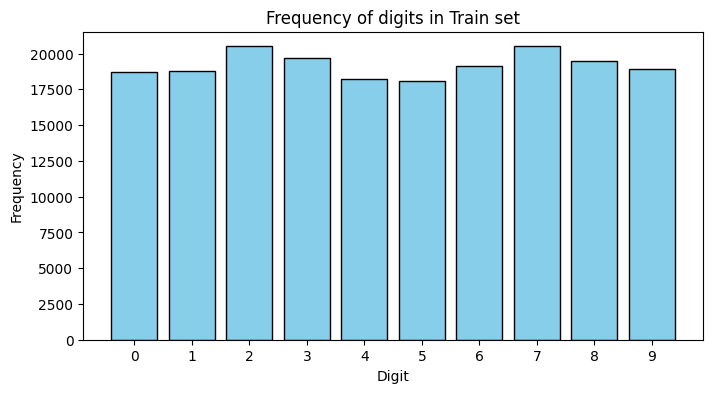

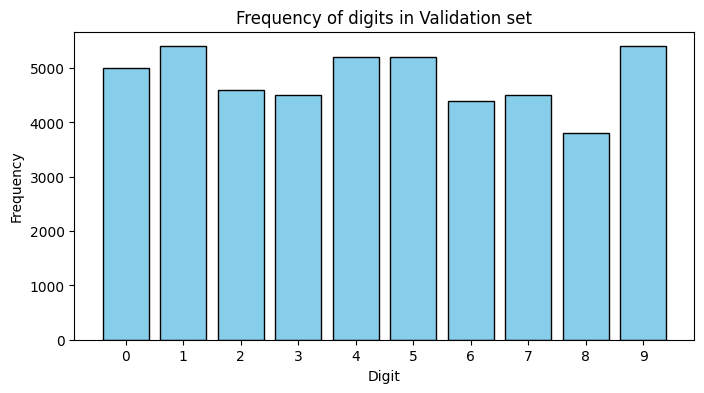

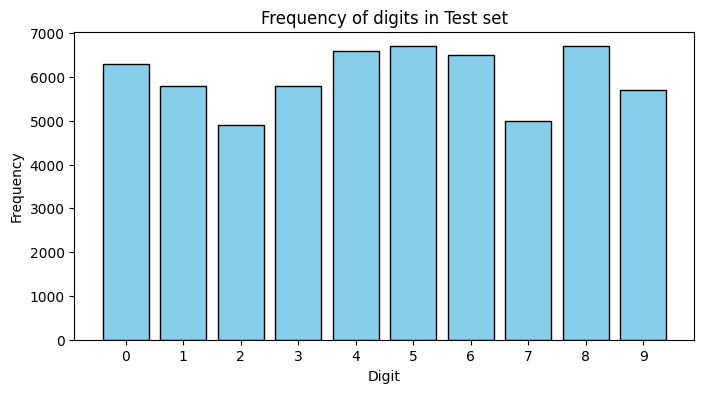

In [ ]:
#TASK-3 CNN with 3 distinct digits specific hyperparams######################              #############           #################            #################   SADECE 2 LAYER AZ FILTER
import tensorflow as tf
import tensorflow.keras as keras
from tensorflow.keras import layers, models
from sklearn.metrics import classification_report, confusion_matrix
import cv2
from tensorflow.keras import metrics
##### SPLIT FUNCTION AND ITS DEMONSTRATION #####
digit_shape = (28, 28)
def crop_digits(img_path: str = None, im = None):
    #if im is None:
    #    im = cv2.imread(img_path)

    #gray = cv2.cvtColor(im, cv2.COLOR_BGR2GRAY)
    blur = cv2.GaussianBlur(img_path, (5, 5), 0)
    thresh = cv2.threshold(blur, 90, 255, cv2.THRESH_BINARY+cv2.THRESH_OTSU)[1]
    contours, hierarchy = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    digits = []
    rect = img_path.copy()
    for cnt in contours:
        x, y, w, h = cv2.boundingRect(cnt)

        x = max(x - 3, 0)
        y = max(y - 3, 0)
        w += 6
        h += 6

        del_x = int(w / 2)
        del_y = int(h / 2)
        center_x = x + del_x
        center_y = y + del_y

        lu_corner = (max(center_x - del_y, 0), y)
        rd_corner = (max(center_x + del_y, 0), y + h)

        rect = cv2.rectangle(rect, lu_corner, rd_corner, (255, 0, 0), 2) #rectangle

        cropped = img_path[lu_corner[1]:rd_corner[1], lu_corner[0]:rd_corner[0]]
        digits.append(cropped)

    def filter_and_sort_digits(digits, contours):
        sizes = []
        for digit in digits:
            size = digit.shape[0] * digit.shape[1]
            sizes.append(size)
        avg_size = sum(sizes) / len(sizes)
        deviations = [abs(size - avg_size) for size in sizes]

        indices = np.argsort(deviations)[0:3]
        digits = [digits[i] for i in indices]
        contours = [cv2.boundingRect(contours[i]) for i in indices]

        xs = [contour[0] for contour in contours]
        indices = np.argsort(xs) #get highest likelihood digit
        digits = [digits[i] for i in indices]

        while len(digits) < 3:
            digits.append(digits[0])
        return digits

    digits = filter_and_sort_digits(digits, contours) #get highest likelihood digits
    digits = [cv2.resize(digit, digit_shape, interpolation = cv2.INTER_NEAREST) for digit in digits] #resize to 28,28

    return digits, contours, rect

print(f"Label: {train_labels[0]}")
print(train_labels[0][0])
print(train_labels[0][1])
print(train_labels[0][2])

fig = plt.figure(figsize=(8, 8))
cols, rows = 3, 3

digits, contours, rect = crop_digits(train_images[0])

fig.add_subplot(rows, cols, 1)
plt.axis("off")
plt.imshow(rect.squeeze(), cmap="gray")
for i in range(len(digits)):
    img = digits[i]
    print(train_labels[0][i])
    fig.add_subplot(rows, cols, i+2)
    plt.axis("off")
    plt.imshow(img.squeeze(), cmap="gray")
    print(f"crop shape: {img.shape}")
plt.show()


##### SPLIT ALL DATA TO DIGITS #####
def load_digits(images, labels):
  all_digits = []
  all_labels = []
  for i in range(len(images)):
    digits, contours, rect = crop_digits(images[i])
    for j in range(len(digits)):
      all_digits.append(digits[j])
      all_labels.append(labels[i][j])
  return np.array(all_digits), np.array(all_labels)

train_images, train_labels = load_digits(train_images, train_labels)
test_images_digits, test_labels_digits = load_digits(test_images, test_labels)
val_images, val_labels = load_digits(val_images, val_labels)
print(len(train_images))
print(len(test_images_digits))
print(len(val_images))
print(train_images.shape)
print(test_images_digits.shape)
print(val_images.shape)
print(train_labels.shape)
print(test_labels_digits.shape)
print(val_labels.shape)

print(len(np.unique(train_labels)))
print(len(np.unique(test_labels_digits)))
print(len(np.unique(val_labels)))

def visualize(images, labels):
  np.random.seed(42)
  random_indices = np.random.choice(len(images), size=9, replace=False)
  random_images = images[random_indices]
  random_labels = labels[random_indices]

  fig, axes = plt.subplots(3, 3, figsize=(12, 12))
  for i, (img, label) in enumerate(zip(random_images, random_labels)):
      ax = axes[i // 3, i % 3]
      ax.imshow(img, cmap='gray')
      ax.set_title(label)
      ax.axis('off')
  plt.show()

visualize(train_images, train_labels)
visualize(test_images_digits, test_labels_digits)
visualize(val_images, val_labels)
def show_digit_frequency(labels, set_name=""):
    """
    Displays a bar chart of digit frequencies in the given label array.

    :param labels: 1D numpy array of digit labels (e.g., [0,1,2,1,9, ...])
    :param set_name: A string to identify the dataset (e.g. 'Train', 'Test')
    """
    unique_digits, counts = np.unique(labels, return_counts=True)

    plt.figure(figsize=(8, 4))
    plt.bar(unique_digits, counts, color='skyblue', edgecolor='black')
    plt.xlabel("Digit")
    plt.ylabel("Frequency")
    plt.title(f"Frequency of digits in {set_name} set")
    plt.xticks(unique_digits)  # Ensure all digit labels (0-9) are shown
    plt.show()

# Example usage on your extracted digit labels:
show_digit_frequency(train_labels, set_name="Train")
show_digit_frequency(val_labels, set_name="Validation")
show_digit_frequency(test_labels_digits, set_name="Test")


Label: 000
0
0
0
0
crop shape: (28, 28)
0
crop shape: (28, 28)
0
crop shape: (28, 28)


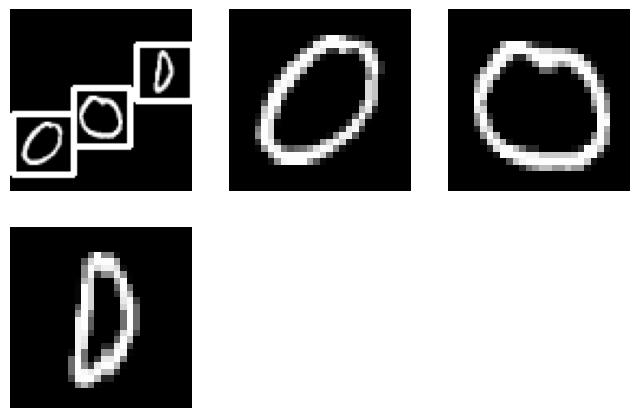

192000
60000
48000
(192000, 28, 28)
(60000, 28, 28)
(48000, 28, 28)
(192000,)
(60000,)
(48000,)
10
10
10


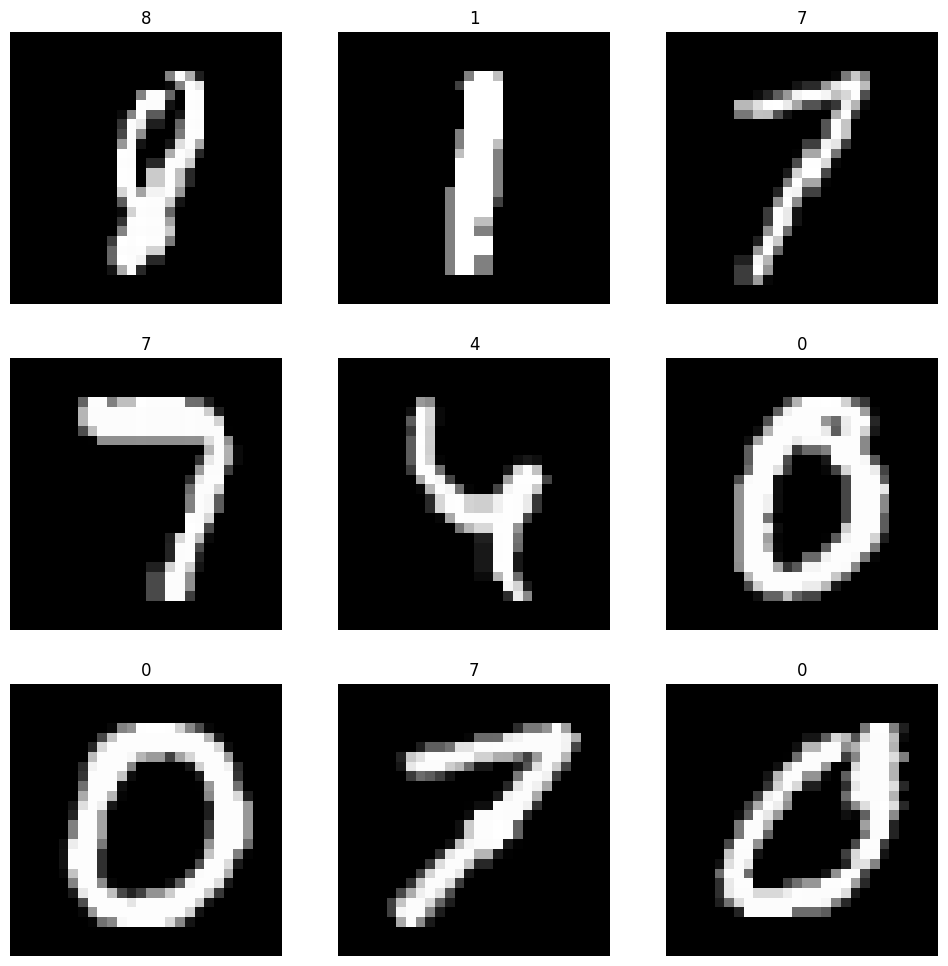

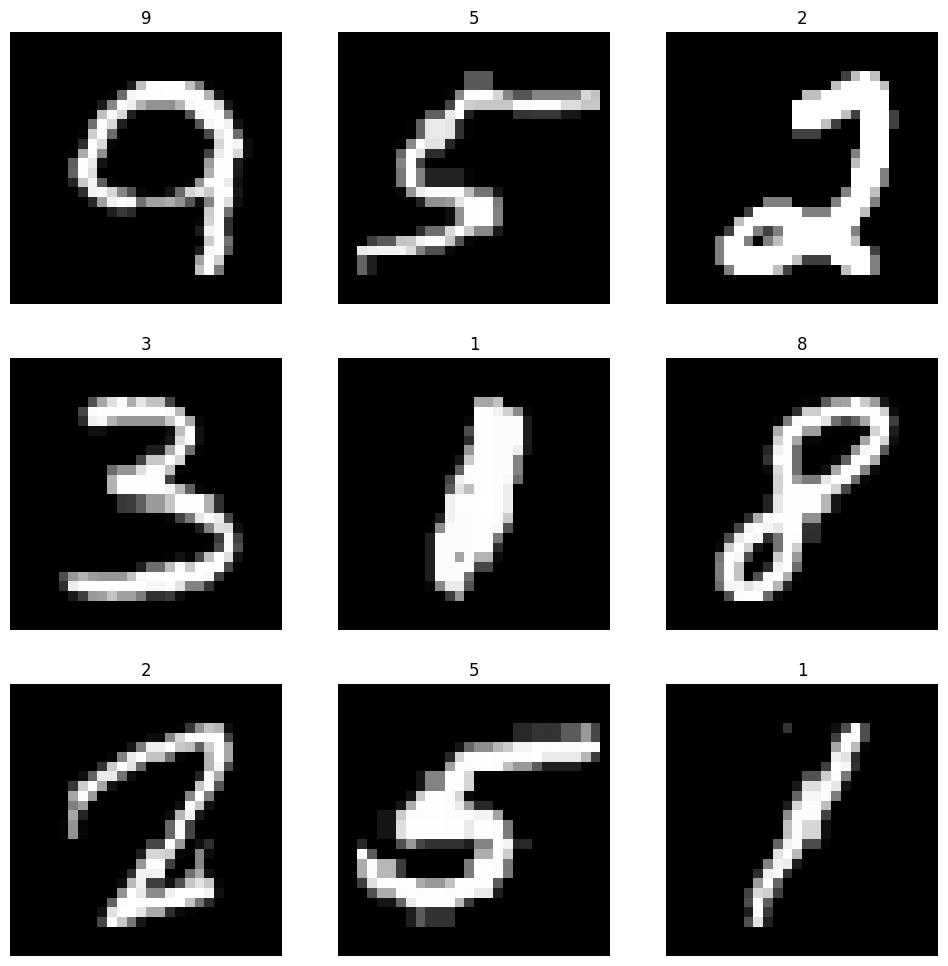

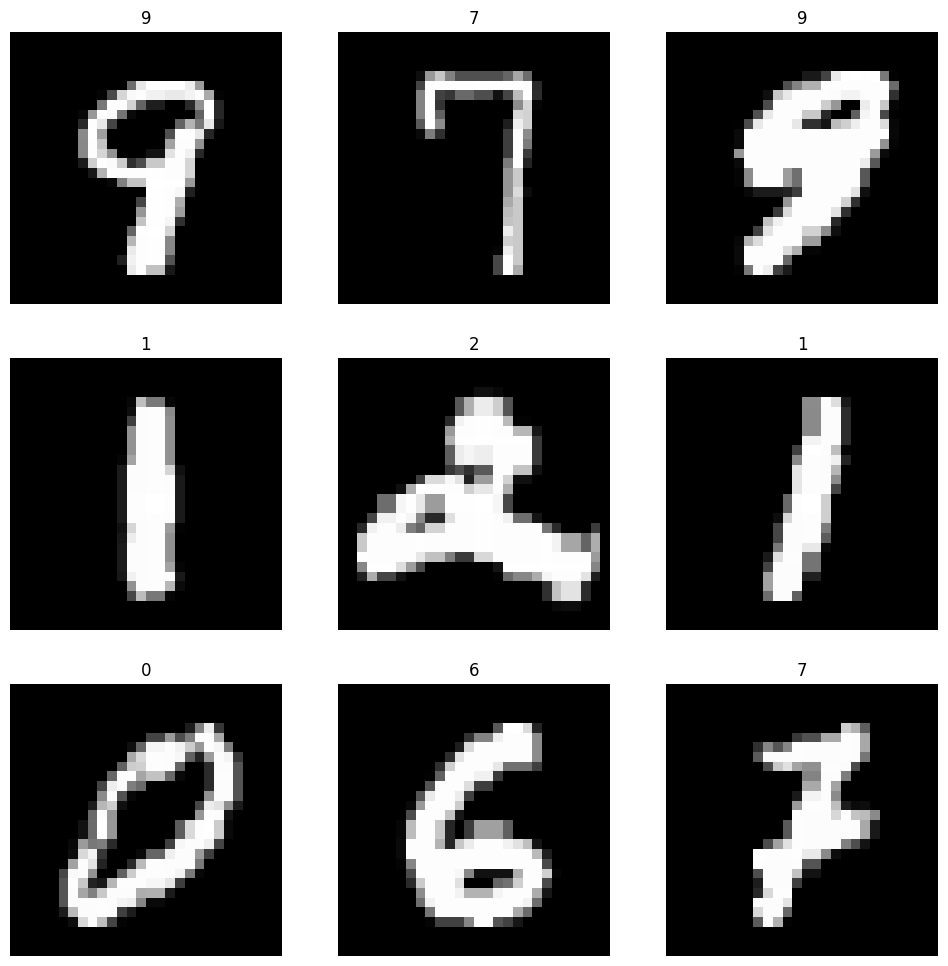

Training data shape: (192000, 28, 28, 1) (192000,)
Validation data shape: (48000, 28, 28, 1) (48000,)
Test data shape: (60000, 28, 28, 1) (60000,)
batch_size: 16, epochs: 7, learning_rate: 0.0001


/usr/local/lib/python3.10/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                      │ (None, 26, 26, 8)           │              80 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d (MaxPooling2D)         │ (None, 13, 13, 8)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_1 (Conv2D)                    │ (None, 11, 11, 16)          │           1,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_1 (MaxPooling2D)       │ (None, 5, 5, 16)            │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 400)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 10)                  │           4,010 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 5,258 (20.54 KB)

 Trainable params: 5,258 (20.54 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/7
12000/12000 ━━━━━━━━━━━━━━━━━━━━ 39s 3ms/step - accuracy: 0.7952 - auc: 0.9596 - loss: 0.7239 - precision: 0.8971 - recall: 0.6602 - val_accuracy: 0.9496 - val_auc: 0.9953 - val_loss: 0.1982 - val_precision: 0.9609 - val_recall: 0.9401
Epoch 2/7
12000/12000 ━━━━━━━━━━━━━━━━━━━━ 31s 3ms/step - accuracy: 0.9538 - auc: 0.9960 - loss: 0.1791 - precision: 0.9641 - recall: 0.9453 - val_accuracy: 0.9633 - val_auc: 0.9966 - val_loss: 0.1445 - val_precision: 0.9707 - val_recall: 0.9567
Epoch 3/7
12000/12000 ━━━━━━━━━━━━━━━━━━━━ 31s 3ms/step - accuracy: 0.9641 - auc: 0.9972 - loss: 0.1365 - precision: 0.9716 - recall: 0.9583 - val_accuracy: 0.9698 - val_auc: 0.9975 - val_loss: 0.1184 - val_precision: 0.9756 - val_recall: 0.9648
Epoch 4/7
12000/12000 ━━━━━━━━━━━━━━━━━━━━ 31s 3ms/step - accuracy: 0.9701 - auc: 0.9979 - loss: 0.1130 - precision: 0.9761 - recall: 0.9654 - val_accuracy: 0.9718 - val_auc: 0.9978 - val_loss: 0.1070 - val_precision: 0.9770 - val_recall: 0.9674
Epoch 5/7
12000/

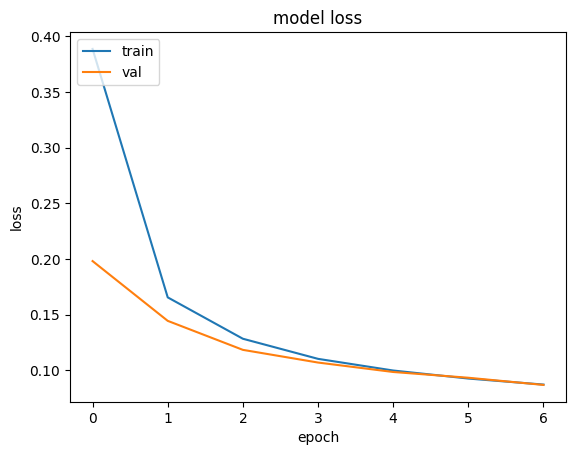

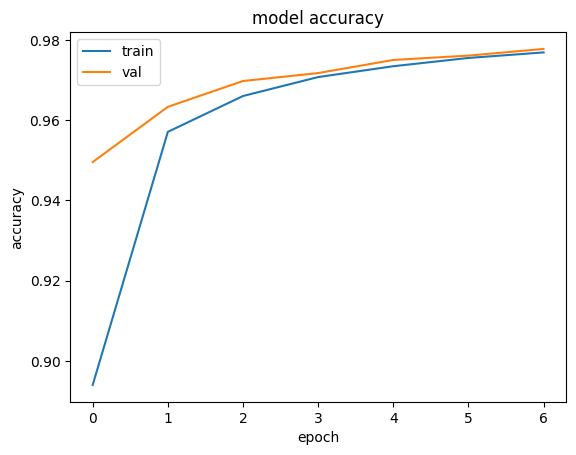

Single Digits Best Hyperparameters (CNN): {'batch_size': 16, 'epochs': 7, 'learning_rate': 0.0001}
Single Digits Best Accuracy Score (CNN): 0.08695593476295471


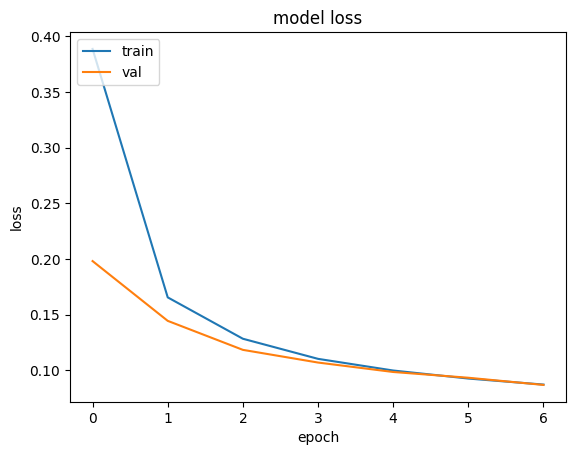

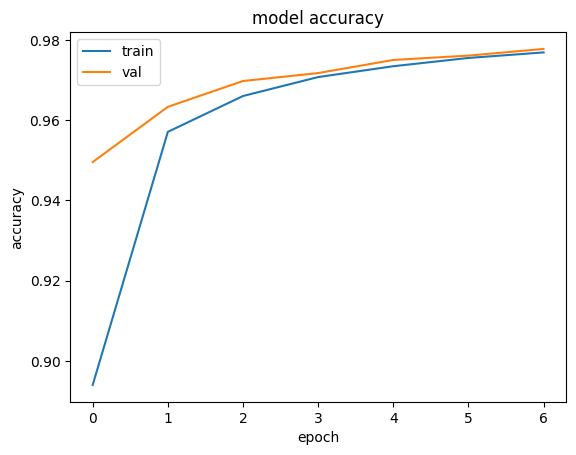

Single Digits Test loss: 0.08631303906440735
Single Digits Test accuracy: 0.9770500063896179
Single Digits Test precision: 0.980837345123291
Single Digits Test recall: 0.974216639995575
Single Digits Test AUC: 0.9983702898025513
single digit classific report
1875/1875 ━━━━━━━━━━━━━━━━━━━━ 3s 1ms/step
Classification Report (Single Digits):
              precision    recall  f1-score   support

           0     0.9798    0.9930    0.9864      6300
           1     0.9748    0.9936    0.9841      5800
           2     0.9626    0.9818    0.9721      4900
           3     0.9742    0.9710    0.9726      5800
           4     0.9736    0.9785    0.9760      6600
           5     0.9786    0.9701    0.9744      6700
           6     0.9828    0.9838    0.9833      6500
           7     0.9826    0.9718    0.9772      5000
           8     0.9847    0.9636    0.9740      6700
           9     0.9738    0.9637    0.9687      5700

    accuracy                         0.9770     60000
   macro 

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


[[  0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0 

In [ ]:
#TASK-3 CNN with 3 distinct digits specific hyperparams######################              #############           #################            #################   SADECE 2 LAYER AZ
import tensorflow as tf
import tensorflow.keras as keras
from tensorflow.keras import layers, models
from sklearn.metrics import classification_report, confusion_matrix
import cv2
from tensorflow.keras import metrics
##### SPLIT FUNCTION AND ITS DEMONSTRATION #####
digit_shape = (28, 28)
def crop_digits(img_path: str = None, im = None):
    #if im is None:
    #    im = cv2.imread(img_path)

    #gray = cv2.cvtColor(im, cv2.COLOR_BGR2GRAY)
    blur = cv2.GaussianBlur(img_path, (5, 5), 0)
    thresh = cv2.threshold(blur, 90, 255, cv2.THRESH_BINARY+cv2.THRESH_OTSU)[1]
    contours, hierarchy = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    digits = []
    rect = img_path.copy()
    for cnt in contours:
        x, y, w, h = cv2.boundingRect(cnt)

        x = max(x - 3, 0)
        y = max(y - 3, 0)
        w += 6
        h += 6

        del_x = int(w / 2)
        del_y = int(h / 2)
        center_x = x + del_x
        center_y = y + del_y

        lu_corner = (max(center_x - del_y, 0), y)
        rd_corner = (max(center_x + del_y, 0), y + h)

        rect = cv2.rectangle(rect, lu_corner, rd_corner, (255, 0, 0), 2) #rectangle

        cropped = img_path[lu_corner[1]:rd_corner[1], lu_corner[0]:rd_corner[0]]
        digits.append(cropped)

    def filter_and_sort_digits(digits, contours):
        sizes = []
        for digit in digits:
            size = digit.shape[0] * digit.shape[1]
            sizes.append(size)
        avg_size = sum(sizes) / len(sizes)
        deviations = [abs(size - avg_size) for size in sizes]

        indices = np.argsort(deviations)[0:3]
        digits = [digits[i] for i in indices]
        contours = [cv2.boundingRect(contours[i]) for i in indices]

        xs = [contour[0] for contour in contours]
        indices = np.argsort(xs) #get highest likelihood digit
        digits = [digits[i] for i in indices]

        while len(digits) < 3:
            digits.append(digits[0])
        return digits

    digits = filter_and_sort_digits(digits, contours) #get highest likelihood digits
    digits = [cv2.resize(digit, digit_shape, interpolation = cv2.INTER_NEAREST) for digit in digits] #resize to 28,28

    return digits, contours, rect

print(f"Label: {train_labels[0]}")
print(train_labels[0][0])
print(train_labels[0][1])
print(train_labels[0][2])

fig = plt.figure(figsize=(8, 8))
cols, rows = 3, 3

digits, contours, rect = crop_digits(train_images[0])

fig.add_subplot(rows, cols, 1)
plt.axis("off")
plt.imshow(rect.squeeze(), cmap="gray")
for i in range(len(digits)):
    img = digits[i]
    print(train_labels[0][i])
    fig.add_subplot(rows, cols, i+2)
    plt.axis("off")
    plt.imshow(img.squeeze(), cmap="gray")
    print(f"crop shape: {img.shape}")
plt.show()


##### SPLIT ALL DATA TO DIGITS #####
def load_digits(images, labels):
  all_digits = []
  all_labels = []
  for i in range(len(images)):
    digits, contours, rect = crop_digits(images[i])
    for j in range(len(digits)):
      all_digits.append(digits[j])
      all_labels.append(labels[i][j])
  return np.array(all_digits), np.array(all_labels)

train_images, train_labels = load_digits(train_images, train_labels)
test_images_digits, test_labels_digits = load_digits(test_images, test_labels)
val_images, val_labels = load_digits(val_images, val_labels)
print(len(train_images))
print(len(test_images_digits))
print(len(val_images))
print(train_images.shape)
print(test_images_digits.shape)
print(val_images.shape)
print(train_labels.shape)
print(test_labels_digits.shape)
print(val_labels.shape)

print(len(np.unique(train_labels)))
print(len(np.unique(test_labels_digits)))
print(len(np.unique(val_labels)))

def visualize(images, labels):
  np.random.seed(42)
  random_indices = np.random.choice(len(images), size=9, replace=False)
  random_images = images[random_indices]
  random_labels = labels[random_indices]

  fig, axes = plt.subplots(3, 3, figsize=(12, 12))
  for i, (img, label) in enumerate(zip(random_images, random_labels)):
      ax = axes[i // 3, i % 3]
      ax.imshow(img, cmap='gray')
      ax.set_title(label)
      ax.axis('off')
  plt.show()

visualize(train_images, train_labels)
visualize(test_images_digits, test_labels_digits)
visualize(val_images, val_labels)


##### TRAIN CNN ######################################################################################################################################################################0000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000
train_images = train_images / 255.0
val_images = val_images / 255.0
test_images_digits = test_images_digits / 255.0

train_images = train_images.reshape((train_images.shape[0], 28, 28, 1))
val_images = val_images.reshape((val_images.shape[0], 28, 28, 1))
test_images_digits = test_images_digits.reshape((test_images_digits.shape[0], 28, 28, 1))

print('Training data shape:', train_images.shape, train_labels.shape)
print('Validation data shape:', val_images.shape, val_labels.shape)
print('Test data shape:', test_images_digits.shape, test_labels_digits.shape)

train_labels = tf.keras.utils.to_categorical(train_labels, num_classes=10)
val_labels = tf.keras.utils.to_categorical(val_labels, num_classes=10)
test_labels_digits = tf.keras.utils.to_categorical(test_labels_digits, num_classes=10)




param_grid_cnn = {
    'batch_size': [16],
    'epochs': [7 ],
    'learning_rate': [1e-4 ]
    #'batch_size': [32],
    #'epochs': [3],
    #'learning_rate': [1e-4],
}

best_params_cnn = None
best_accuracy_cnn = -1
for batch_size in param_grid_cnn['batch_size']:
    for epochs in param_grid_cnn['epochs']:
        for learning_rate in param_grid_cnn['learning_rate']:
          print(f"batch_size: {batch_size}, epochs: {epochs}, learning_rate: {learning_rate}")
          model = models.Sequential()
          model.add(layers.Conv2D(8, (3, 3), activation='relu', input_shape=(28, 28, 1)))
          #model.add(layers.BatchNormalization()) #### FOR TASK 4
          model.add(layers.MaxPooling2D((2, 2)))
          model.add(layers.Conv2D(16, (3, 3), activation='relu'))
          #model.add(layers.BatchNormalization()) #### FOR TASK 4
          model.add(layers.MaxPooling2D((2, 2)))
          #model.add(layers.Conv2D(128, (3, 3), activation='relu')) #### FOR TASK 4
          #model.add(layers.BatchNormalization()) #### FOR TASK 4
          #model.add(layers.MaxPooling2D((2, 2))) #### FOR TASK 4
          model.add(layers.Flatten())
          # model.add(layers.Dropout(0.5)) #0.7 #### FOR TASK 4
          model.add(layers.Dense(10, activation='softmax'))
          model.summary()

          model.compile(loss="categorical_crossentropy", optimizer=keras.optimizers.Adam(learning_rate=learning_rate), metrics=["accuracy", metrics.Precision(), metrics.Recall(), metrics.AUC()])


          history = model.fit(train_images, train_labels, batch_size=batch_size, epochs=epochs, validation_data=(val_images, val_labels))

          score_train = model.evaluate(train_images, train_labels, verbose=0)
          print("Single Digits Train loss:", score_train[0])
          print("Single Digits Train accuracy:", score_train[1])
          score_val = model.evaluate(val_images, val_labels, verbose=0)
          print("Single Digits Validation loss:", score_val[0])
          print("Single Digits Validation accuracy:", score_val[1])
          plt.plot(history.history['loss'])
          plt.plot(history.history['val_loss'])
          plt.title('model loss')
          plt.ylabel('loss')
          plt.xlabel('epoch')
          plt.legend(['train', 'val'], loc='upper left')
          plt.show()

          plt.plot(history.history['accuracy'])
          plt.plot(history.history['val_accuracy'])
          plt.title('model accuracy')
          plt.ylabel('accuracy')
          plt.xlabel('epoch')
          plt.legend(['train', 'val'], loc='upper left')
          plt.show()
          if score_val[1] > best_accuracy_cnn:
                  best_accuracy_cnn = score_val[1]
                  best_params_cnn = {'batch_size': batch_size, 'epochs': epochs, 'learning_rate':learning_rate}

                  model.save('best_model.h5')


print("Single Digits Best Hyperparameters (CNN):", best_params_cnn)
print("Single Digits Best Accuracy Score (CNN):", best_accuracy_cnn)
model = tf.keras.models.load_model('best_model.h5')
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

score = model.evaluate(test_images_digits, test_labels_digits, verbose=0)
print("Single Digits Test loss:", score[0])
print("Single Digits Test accuracy:", score[1])
print("Single Digits Test precision:", score[2])
print("Single Digits Test recall:", score[3])
print("Single Digits Test AUC:", score[4])
print("single digit classific report")
predictions_digits = model.predict(test_images_digits)
predicted_labels_digits = np.argmax(predictions_digits, axis=1)  # Convert predictions to class labels
true_labels_digits = np.argmax(test_labels_digits, axis=1)  # Convert one-hot encoded labels to class labels

# Print the classification report for single digits
print("Classification Report (Single Digits):")
print(classification_report(true_labels_digits, predicted_labels_digits, digits=4))

final_test_predictions = []
for i in range(len(test_images)):
  img = test_images[i]
  concat = ""
  for j in range(0,3):
    img_digit = test_images_digits[3*i + j]
    #prediction = model.predict_on_batch([img_digit])
    prediction = model.predict_on_batch(np.expand_dims(img_digit, axis=0))
    prediction = np.argmax(prediction)
    #print(prediction, test_labels[i])
    concat = concat + str(prediction)
  #print(concat, test_labels[i])
  final_test_predictions.append(concat)

np.set_printoptions(threshold=np.inf)

print("Classification Report:")
print(classification_report(test_labels, final_test_predictions, digits = 4))

print("\nConfusion Matrix:")
print(confusion_matrix(test_labels, final_test_predictions))


# 2 layer low filter

Label: 000
0
0
0
0
crop shape: (28, 28)
0
crop shape: (28, 28)
0
crop shape: (28, 28)


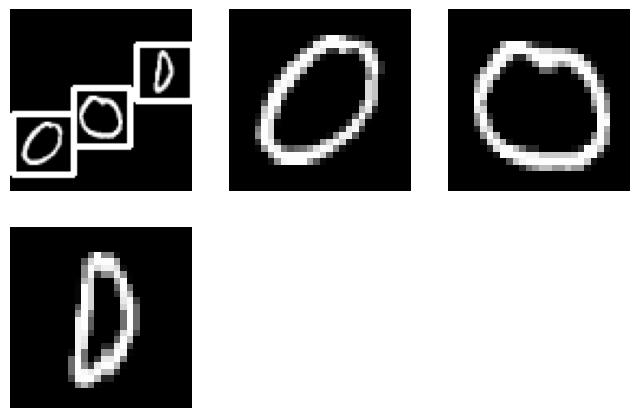

192000
60000
48000
(192000, 28, 28)
(60000, 28, 28)
(48000, 28, 28)
(192000,)
(60000,)
(48000,)
10
10
10


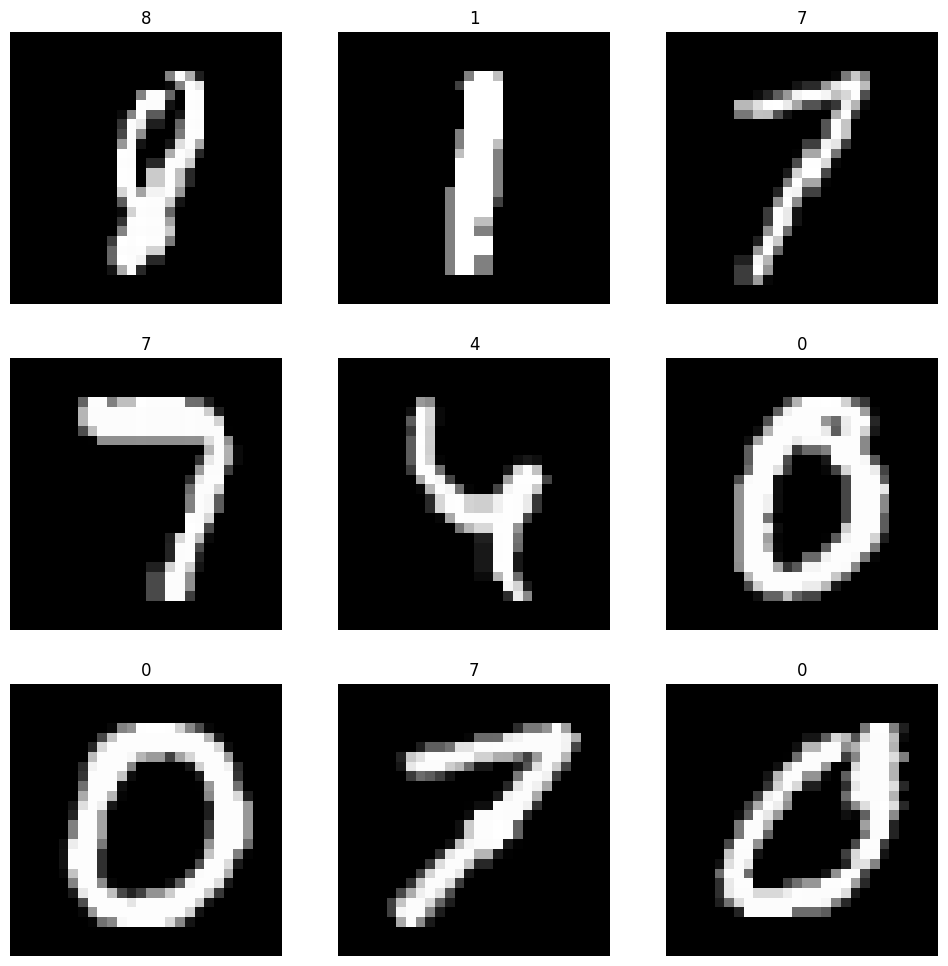

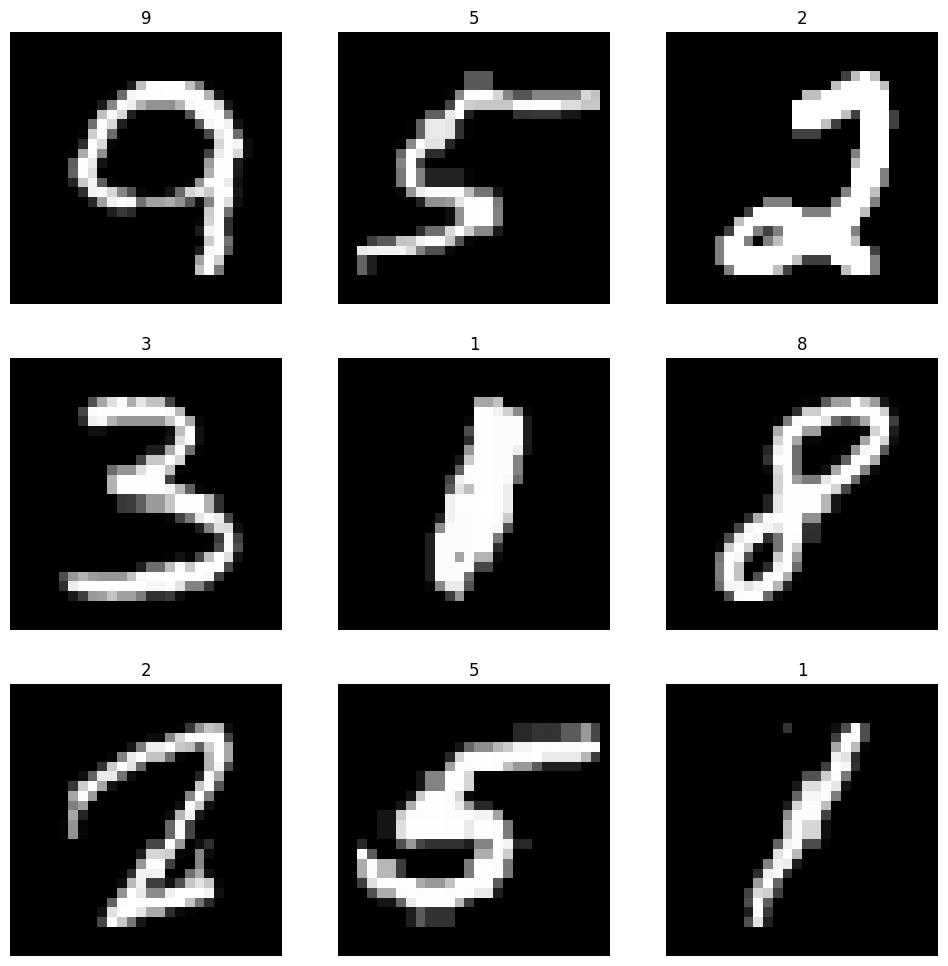

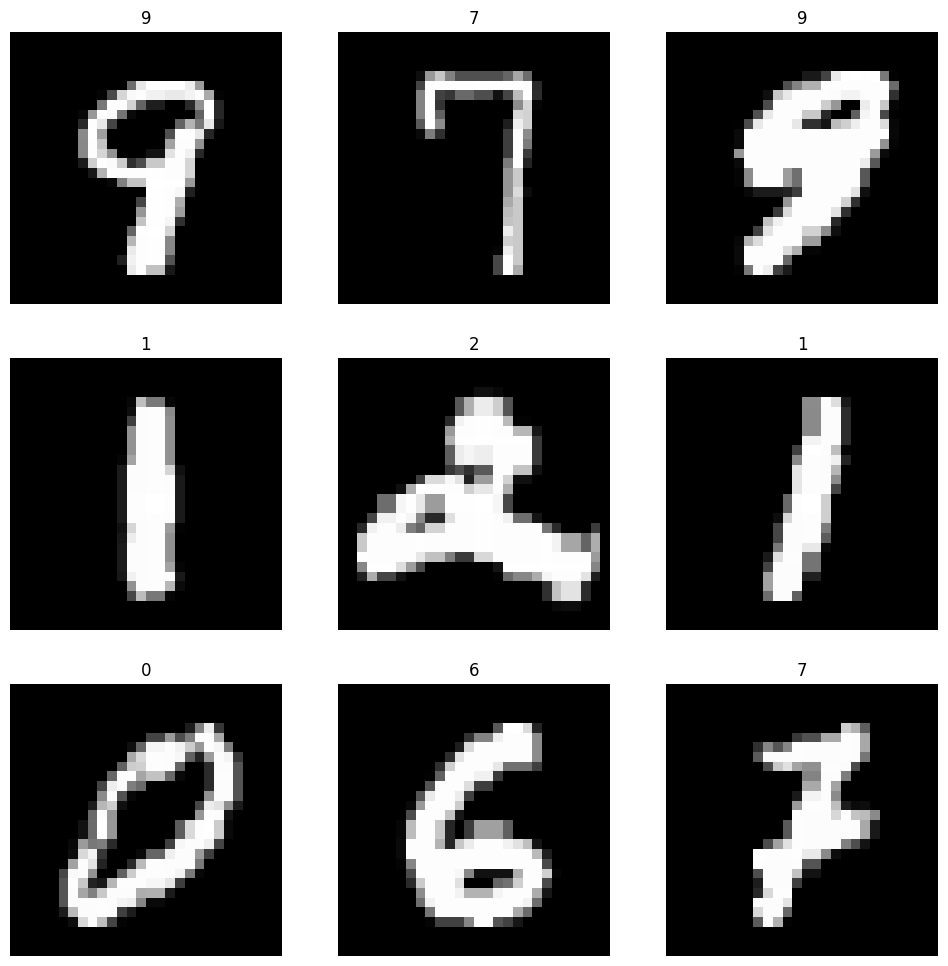

Training data shape: (192000, 28, 28, 1) (192000,)
Validation data shape: (48000, 28, 28, 1) (48000,)
Test data shape: (60000, 28, 28, 1) (60000,)
batch_size: 32, epochs: 5, learning_rate: 0.0001


/usr/local/lib/python3.10/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential_8"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d_24 (Conv2D)                   │ (None, 26, 26, 8)           │              80 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_24 (MaxPooling2D)      │ (None, 13, 13, 8)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_25 (Conv2D)                   │ (None, 11, 11, 16)          │           1,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_25 (MaxPooling2D)      │ (None, 5, 5, 16)            │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_8 (Flatten)                  │ (None, 400)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_8 (Dense)                      │ (None, 10)                  │           4,010 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 5,258 (20.54 KB)

 Trainable params: 5,258 (20.54 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/5
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 17s 2ms/step - accuracy: 0.6941 - auc_8: 0.9244 - loss: 1.0078 - precision_8: 0.8511 - recall_8: 0.5182 - val_accuracy: 0.9318 - val_auc_8: 0.9931 - val_loss: 0.2626 - val_precision_8: 0.9490 - val_recall_8: 0.9167
Epoch 2/5
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 13s 2ms/step - accuracy: 0.9383 - auc_8: 0.9944 - loss: 0.2356 - precision_8: 0.9523 - recall_8: 0.9250 - val_accuracy: 0.9516 - val_auc_8: 0.9956 - val_loss: 0.1883 - val_precision_8: 0.9618 - val_recall_8: 0.9421
Epoch 3/5
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 13s 2ms/step - accuracy: 0.9523 - auc_8: 0.9959 - loss: 0.1808 - precision_8: 0.9628 - recall_8: 0.9440 - val_accuracy: 0.9602 - val_auc_8: 0.9966 - val_loss: 0.1559 - val_precision_8: 0.9683 - val_recall_8: 0.9534
Epoch 4/5
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 13s 2ms/step - accuracy: 0.9611 - auc_8: 0.9968 - loss: 0.1490 - precision_8: 0.9693 - recall_8: 0.9547 - val_accuracy: 0.9654 - val_auc_8: 0.9973 - val_loss: 0.1325 - val_precision_8: 0.9728

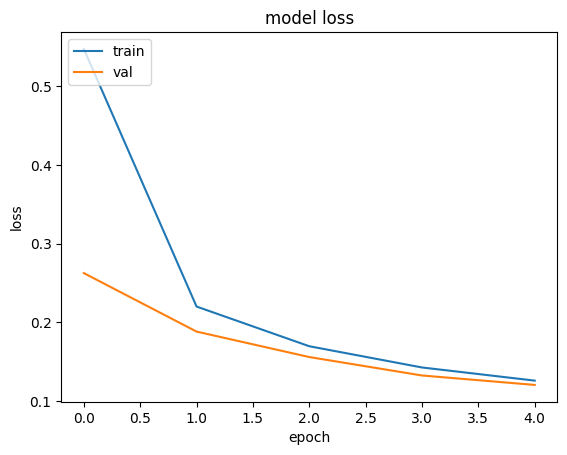

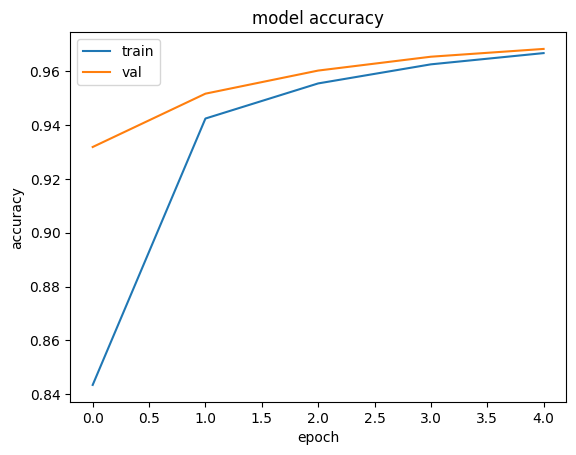

batch_size: 32, epochs: 5, learning_rate: 0.001


Model: "sequential_9"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d_26 (Conv2D)                   │ (None, 26, 26, 8)           │              80 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_26 (MaxPooling2D)      │ (None, 13, 13, 8)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_27 (Conv2D)                   │ (None, 11, 11, 16)          │           1,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_27 (MaxPooling2D)      │ (None, 5, 5, 16)            │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_9 (Flatten)                  │ (None, 400)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_9 (Dense)                      │ (None, 10)                  │           4,010 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 5,258 (20.54 KB)

 Trainable params: 5,258 (20.54 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/5
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 16s 2ms/step - accuracy: 0.9054 - auc_9: 0.9874 - loss: 0.3267 - precision_9: 0.9468 - recall_9: 0.8640 - val_accuracy: 0.9786 - val_auc_9: 0.9983 - val_loss: 0.0836 - val_precision_9: 0.9822 - val_recall_9: 0.9759
Epoch 2/5
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 13s 2ms/step - accuracy: 0.9789 - auc_9: 0.9984 - loss: 0.0799 - precision_9: 0.9825 - recall_9: 0.9762 - val_accuracy: 0.9824 - val_auc_9: 0.9987 - val_loss: 0.0685 - val_precision_9: 0.9853 - val_recall_9: 0.9799
Epoch 3/5
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 13s 2ms/step - accuracy: 0.9831 - auc_9: 0.9989 - loss: 0.0634 - precision_9: 0.9860 - recall_9: 0.9810 - val_accuracy: 0.9841 - val_auc_9: 0.9987 - val_loss: 0.0611 - val_precision_9: 0.9867 - val_recall_9: 0.9824
Epoch 4/5
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 13s 2ms/step - accuracy: 0.9855 - auc_9: 0.9991 - loss: 0.0541 - precision_9: 0.9878 - recall_9: 0.9841 - val_accuracy: 0.9871 - val_auc_9: 0.9988 - val_loss: 0.0558 - val_precision_9: 0.9890

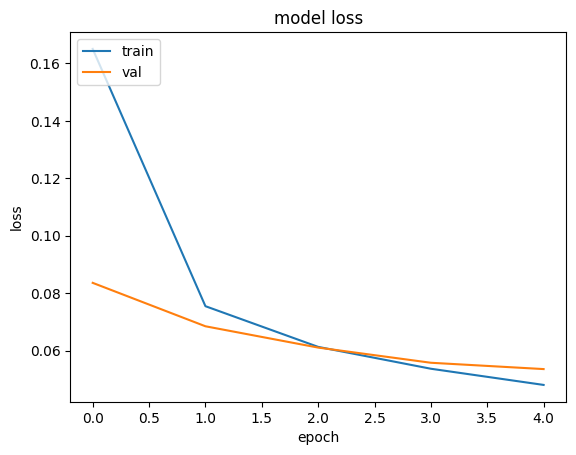

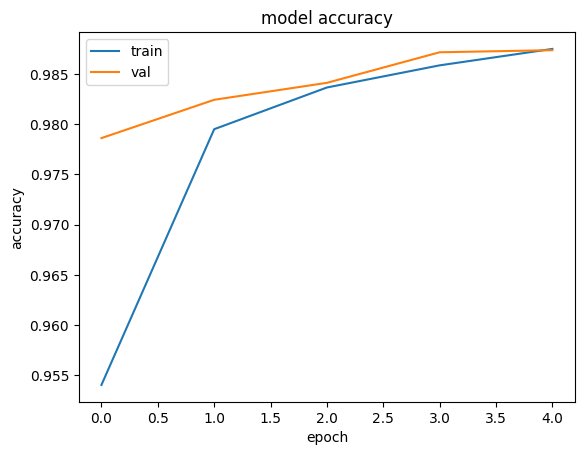

batch_size: 32, epochs: 10, learning_rate: 0.0001


Model: "sequential_10"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d_28 (Conv2D)                   │ (None, 26, 26, 8)           │              80 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_28 (MaxPooling2D)      │ (None, 13, 13, 8)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_29 (Conv2D)                   │ (None, 11, 11, 16)          │           1,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_29 (MaxPooling2D)      │ (None, 5, 5, 16)            │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_10 (Flatten)                 │ (None, 400)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_10 (Dense)                     │ (None, 10)                  │           4,010 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 5,258 (20.54 KB)

 Trainable params: 5,258 (20.54 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/10
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 16s 2ms/step - accuracy: 0.7393 - auc_10: 0.9444 - loss: 0.8792 - precision_10: 0.8822 - recall_10: 0.5742 - val_accuracy: 0.9371 - val_auc_10: 0.9941 - val_loss: 0.2366 - val_precision_10: 0.9518 - val_recall_10: 0.9235
Epoch 2/10
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 13s 2ms/step - accuracy: 0.9421 - auc_10: 0.9950 - loss: 0.2153 - precision_10: 0.9553 - recall_10: 0.9309 - val_accuracy: 0.9530 - val_auc_10: 0.9958 - val_loss: 0.1775 - val_precision_10: 0.9615 - val_recall_10: 0.9445
Epoch 3/10
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 13s 2ms/step - accuracy: 0.9549 - auc_10: 0.9963 - loss: 0.1693 - precision_10: 0.9646 - recall_10: 0.9473 - val_accuracy: 0.9601 - val_auc_10: 0.9967 - val_loss: 0.1513 - val_precision_10: 0.9673 - val_recall_10: 0.9535
Epoch 4/10
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 13s 2ms/step - accuracy: 0.9621 - auc_10: 0.9970 - loss: 0.1424 - precision_10: 0.9695 - recall_10: 0.9561 - val_accuracy: 0.9642 - val_auc_10: 0.9971 - val_loss: 0.1360

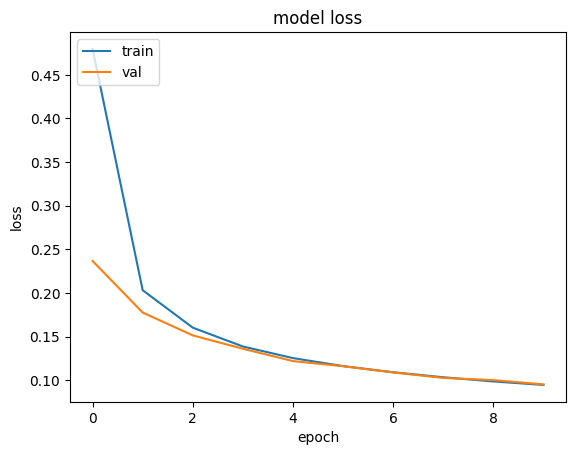

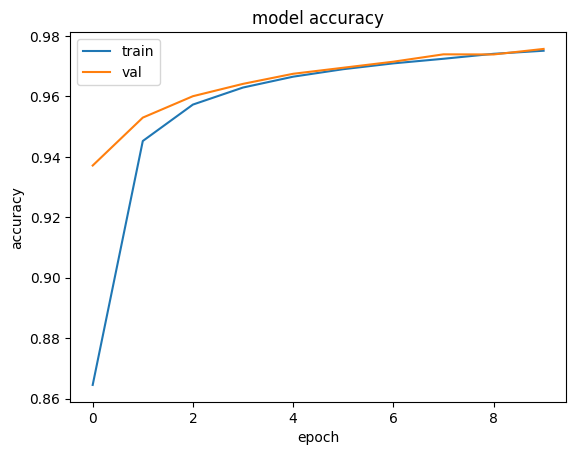

batch_size: 32, epochs: 10, learning_rate: 0.001


Model: "sequential_11"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d_30 (Conv2D)                   │ (None, 26, 26, 8)           │              80 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_30 (MaxPooling2D)      │ (None, 13, 13, 8)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_31 (Conv2D)                   │ (None, 11, 11, 16)          │           1,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_31 (MaxPooling2D)      │ (None, 5, 5, 16)            │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_11 (Flatten)                 │ (None, 400)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_11 (Dense)                     │ (None, 10)                  │           4,010 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 5,258 (20.54 KB)

 Trainable params: 5,258 (20.54 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/10
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 16s 2ms/step - accuracy: 0.9088 - auc_11: 0.9888 - loss: 0.3163 - precision_11: 0.9499 - recall_11: 0.8699 - val_accuracy: 0.9742 - val_auc_11: 0.9982 - val_loss: 0.0941 - val_precision_11: 0.9788 - val_recall_11: 0.9716
Epoch 2/10
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 13s 2ms/step - accuracy: 0.9780 - auc_11: 0.9985 - loss: 0.0818 - precision_11: 0.9814 - recall_11: 0.9754 - val_accuracy: 0.9793 - val_auc_11: 0.9982 - val_loss: 0.0779 - val_precision_11: 0.9820 - val_recall_11: 0.9769
Epoch 3/10
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 13s 2ms/step - accuracy: 0.9827 - auc_11: 0.9988 - loss: 0.0642 - precision_11: 0.9855 - recall_11: 0.9808 - val_accuracy: 0.9850 - val_auc_11: 0.9987 - val_loss: 0.0616 - val_precision_11: 0.9870 - val_recall_11: 0.9834
Epoch 4/10
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 13s 2ms/step - accuracy: 0.9861 - auc_11: 0.9990 - loss: 0.0532 - precision_11: 0.9886 - recall_11: 0.9846 - val_accuracy: 0.9850 - val_auc_11: 0.9989 - val_loss: 0.0587

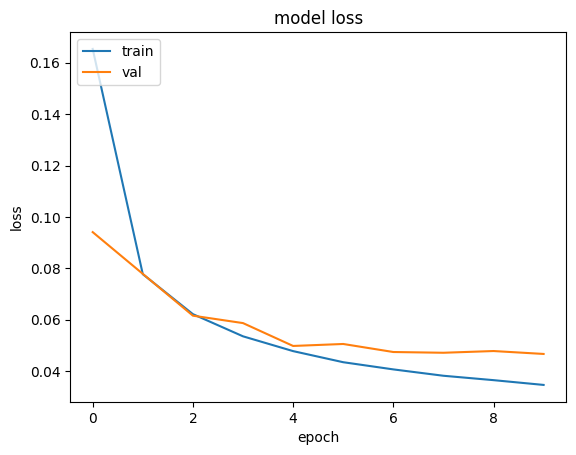

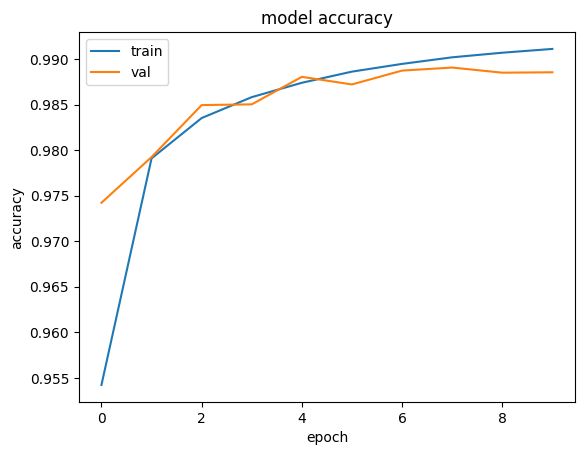

batch_size: 64, epochs: 5, learning_rate: 0.0001


Model: "sequential_12"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d_32 (Conv2D)                   │ (None, 26, 26, 8)           │              80 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_32 (MaxPooling2D)      │ (None, 13, 13, 8)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_33 (Conv2D)                   │ (None, 11, 11, 16)          │           1,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_33 (MaxPooling2D)      │ (None, 5, 5, 16)            │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_12 (Flatten)                 │ (None, 400)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_12 (Dense)                     │ (None, 10)                  │           4,010 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 5,258 (20.54 KB)

 Trainable params: 5,258 (20.54 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/5
3000/3000 ━━━━━━━━━━━━━━━━━━━━ 11s 3ms/step - accuracy: 0.6784 - auc_12: 0.9162 - loss: 1.1498 - precision_12: 0.8378 - recall_12: 0.4332 - val_accuracy: 0.9214 - val_auc_12: 0.9925 - val_loss: 0.2886 - val_precision_12: 0.9415 - val_recall_12: 0.9029
Epoch 2/5
3000/3000 ━━━━━━━━━━━━━━━━━━━━ 7s 2ms/step - accuracy: 0.9296 - auc_12: 0.9938 - loss: 0.2600 - precision_12: 0.9471 - recall_12: 0.9136 - val_accuracy: 0.9468 - val_auc_12: 0.9953 - val_loss: 0.2054 - val_precision_12: 0.9592 - val_recall_12: 0.9356
Epoch 3/5
3000/3000 ━━━━━━━━━━━━━━━━━━━━ 7s 2ms/step - accuracy: 0.9496 - auc_12: 0.9958 - loss: 0.1918 - precision_12: 0.9615 - recall_12: 0.9397 - val_accuracy: 0.9590 - val_auc_12: 0.9965 - val_loss: 0.1616 - val_precision_12: 0.9684 - val_recall_12: 0.9510
Epoch 4/5
3000/3000 ━━━━━━━━━━━━━━━━━━━━ 7s 2ms/step - accuracy: 0.9598 - auc_12: 0.9969 - loss: 0.1531 - precision_12: 0.9694 - recall_12: 0.9524 - val_accuracy: 0.9652 - val_auc_12: 0.9971 - val_loss: 0.1386 - val_

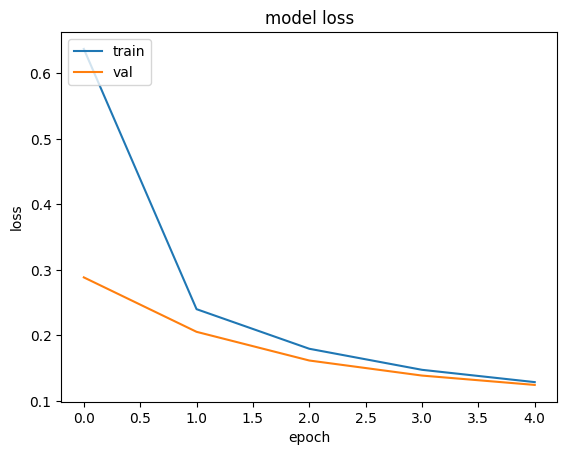

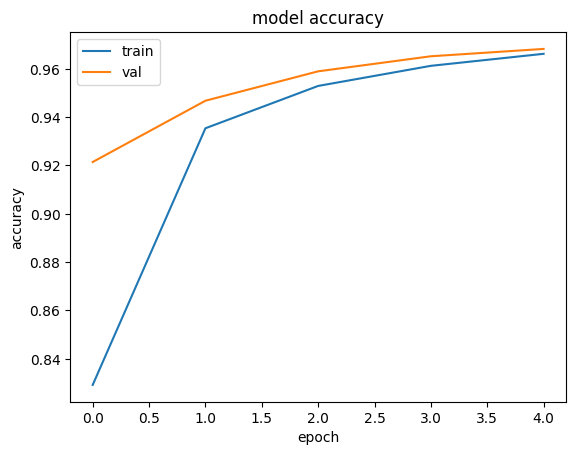

batch_size: 64, epochs: 5, learning_rate: 0.001


Model: "sequential_13"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d_34 (Conv2D)                   │ (None, 26, 26, 8)           │              80 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_34 (MaxPooling2D)      │ (None, 13, 13, 8)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_35 (Conv2D)                   │ (None, 11, 11, 16)          │           1,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_35 (MaxPooling2D)      │ (None, 5, 5, 16)            │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_13 (Flatten)                 │ (None, 400)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_13 (Dense)                     │ (None, 10)                  │           4,010 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 5,258 (20.54 KB)

 Trainable params: 5,258 (20.54 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/5
3000/3000 ━━━━━━━━━━━━━━━━━━━━ 11s 3ms/step - accuracy: 0.8752 - auc_13: 0.9804 - loss: 0.4290 - precision_13: 0.9349 - recall_13: 0.8172 - val_accuracy: 0.9723 - val_auc_13: 0.9980 - val_loss: 0.1027 - val_precision_13: 0.9766 - val_recall_13: 0.9685
Epoch 2/5
3000/3000 ━━━━━━━━━━━━━━━━━━━━ 7s 2ms/step - accuracy: 0.9740 - auc_13: 0.9983 - loss: 0.0969 - precision_13: 0.9787 - recall_13: 0.9704 - val_accuracy: 0.9778 - val_auc_13: 0.9984 - val_loss: 0.0827 - val_precision_13: 0.9809 - val_recall_13: 0.9748
Epoch 3/5
3000/3000 ━━━━━━━━━━━━━━━━━━━━ 7s 2ms/step - accuracy: 0.9802 - auc_13: 0.9987 - loss: 0.0738 - precision_13: 0.9839 - recall_13: 0.9776 - val_accuracy: 0.9788 - val_auc_13: 0.9986 - val_loss: 0.0750 - val_precision_13: 0.9827 - val_recall_13: 0.9765
Epoch 4/5
3000/3000 ━━━━━━━━━━━━━━━━━━━━ 7s 2ms/step - accuracy: 0.9833 - auc_13: 0.9988 - loss: 0.0629 - precision_13: 0.9863 - recall_13: 0.9814 - val_accuracy: 0.9855 - val_auc_13: 0.9987 - val_loss: 0.0597 - val_

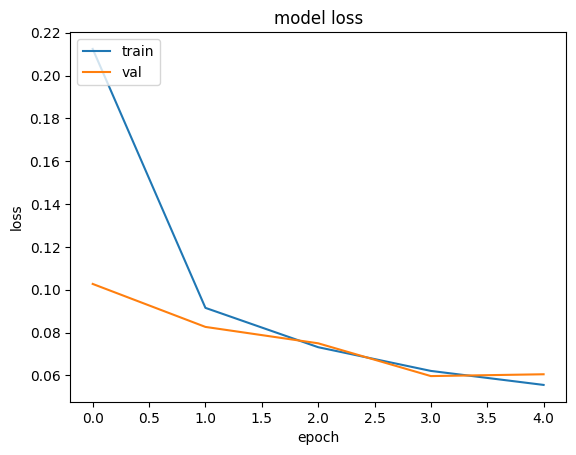

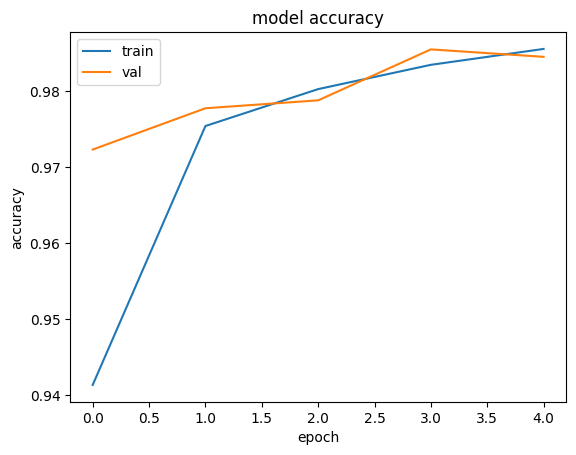

batch_size: 64, epochs: 10, learning_rate: 0.0001


Model: "sequential_14"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d_36 (Conv2D)                   │ (None, 26, 26, 8)           │              80 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_36 (MaxPooling2D)      │ (None, 13, 13, 8)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_37 (Conv2D)                   │ (None, 11, 11, 16)          │           1,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_37 (MaxPooling2D)      │ (None, 5, 5, 16)            │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_14 (Flatten)                 │ (None, 400)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_14 (Dense)                     │ (None, 10)                  │           4,010 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 5,258 (20.54 KB)

 Trainable params: 5,258 (20.54 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/10
3000/3000 ━━━━━━━━━━━━━━━━━━━━ 11s 3ms/step - accuracy: 0.6823 - auc_14: 0.9160 - loss: 1.1011 - precision_14: 0.8513 - recall_14: 0.4586 - val_accuracy: 0.9215 - val_auc_14: 0.9923 - val_loss: 0.2914 - val_precision_14: 0.9428 - val_recall_14: 0.9041
Epoch 2/10
3000/3000 ━━━━━━━━━━━━━━━━━━━━ 7s 2ms/step - accuracy: 0.9278 - auc_14: 0.9935 - loss: 0.2663 - precision_14: 0.9455 - recall_14: 0.9111 - val_accuracy: 0.9447 - val_auc_14: 0.9950 - val_loss: 0.2130 - val_precision_14: 0.9580 - val_recall_14: 0.9333
Epoch 3/10
3000/3000 ━━━━━━━━━━━━━━━━━━━━ 7s 2ms/step - accuracy: 0.9465 - auc_14: 0.9956 - loss: 0.2010 - precision_14: 0.9586 - recall_14: 0.9365 - val_accuracy: 0.9550 - val_auc_14: 0.9962 - val_loss: 0.1708 - val_precision_14: 0.9650 - val_recall_14: 0.9469
Epoch 4/10
3000/3000 ━━━━━━━━━━━━━━━━━━━━ 7s 2ms/step - accuracy: 0.9561 - auc_14: 0.9966 - loss: 0.1630 - precision_14: 0.9655 - recall_14: 0.9482 - val_accuracy: 0.9614 - val_auc_14: 0.9968 - val_loss: 0.1491 - 

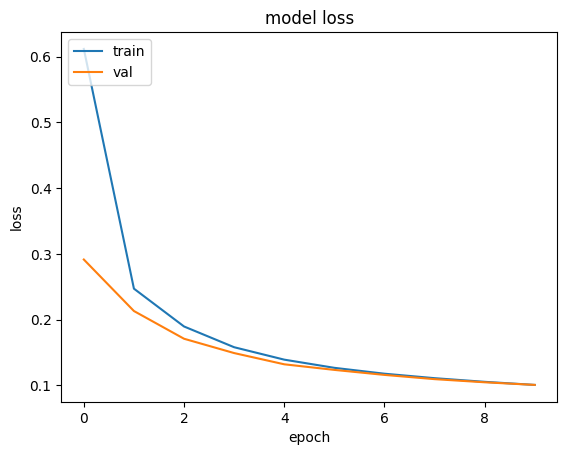

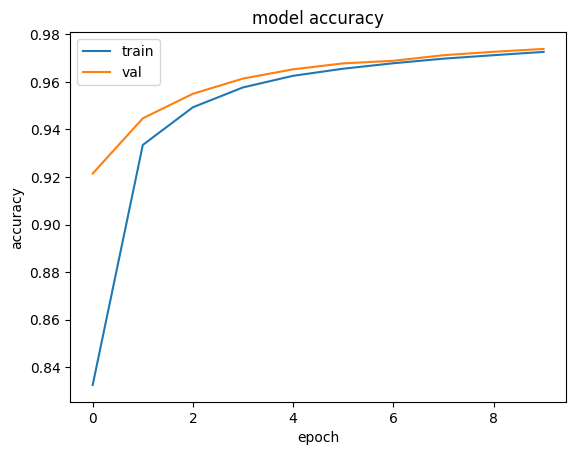

batch_size: 64, epochs: 10, learning_rate: 0.001


Model: "sequential_15"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d_38 (Conv2D)                   │ (None, 26, 26, 8)           │              80 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_38 (MaxPooling2D)      │ (None, 13, 13, 8)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_39 (Conv2D)                   │ (None, 11, 11, 16)          │           1,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_39 (MaxPooling2D)      │ (None, 5, 5, 16)            │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_15 (Flatten)                 │ (None, 400)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_15 (Dense)                     │ (None, 10)                  │           4,010 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 5,258 (20.54 KB)

 Trainable params: 5,258 (20.54 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/10
3000/3000 ━━━━━━━━━━━━━━━━━━━━ 11s 3ms/step - accuracy: 0.8819 - auc_15: 0.9834 - loss: 0.4106 - precision_15: 0.9354 - recall_15: 0.8214 - val_accuracy: 0.9707 - val_auc_15: 0.9978 - val_loss: 0.1095 - val_precision_15: 0.9758 - val_recall_15: 0.9672
Epoch 2/10
3000/3000 ━━━━━━━━━━━━━━━━━━━━ 7s 2ms/step - accuracy: 0.9746 - auc_15: 0.9983 - loss: 0.0924 - precision_15: 0.9792 - recall_15: 0.9714 - val_accuracy: 0.9773 - val_auc_15: 0.9983 - val_loss: 0.0841 - val_precision_15: 0.9802 - val_recall_15: 0.9748
Epoch 3/10
3000/3000 ━━━━━━━━━━━━━━━━━━━━ 7s 2ms/step - accuracy: 0.9799 - auc_15: 0.9988 - loss: 0.0731 - precision_15: 0.9831 - recall_15: 0.9777 - val_accuracy: 0.9827 - val_auc_15: 0.9986 - val_loss: 0.0693 - val_precision_15: 0.9852 - val_recall_15: 0.9807
Epoch 4/10
3000/3000 ━━━━━━━━━━━━━━━━━━━━ 7s 2ms/step - accuracy: 0.9840 - auc_15: 0.9990 - loss: 0.0615 - precision_15: 0.9864 - recall_15: 0.9820 - val_accuracy: 0.9830 - val_auc_15: 0.9985 - val_loss: 0.0652 - 

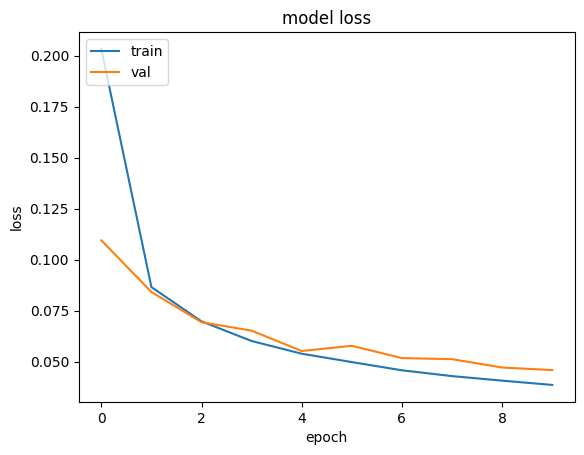

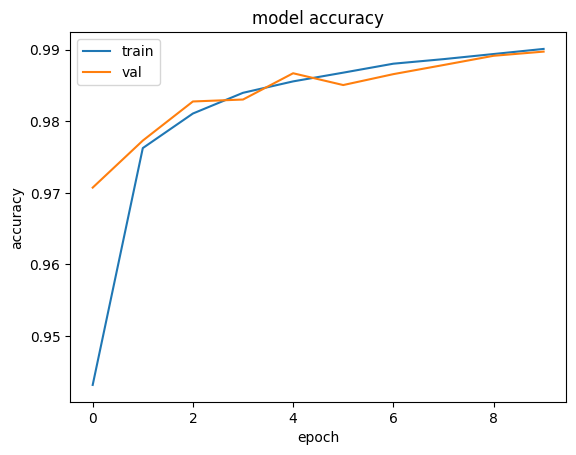

Single Digits Best Hyperparameters (CNN): {'batch_size': 64, 'epochs': 10, 'learning_rate': 0.001}
Single Digits Best Accuracy Score (CNN): 0.9897083044052124


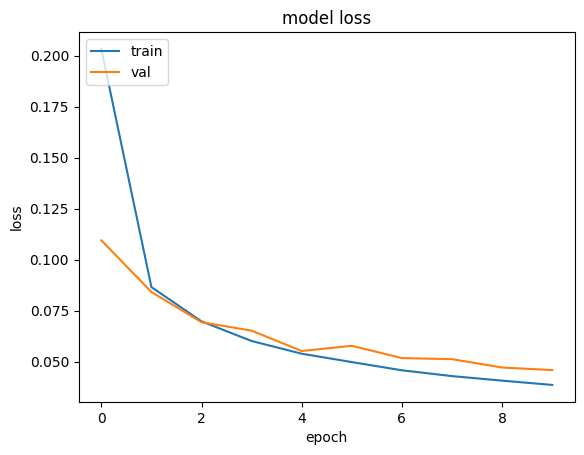

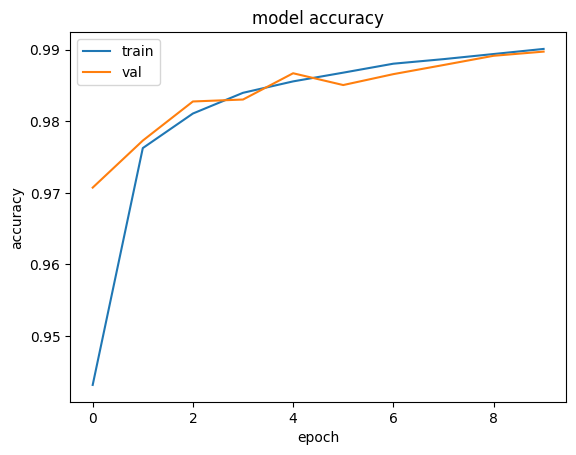

Single Digits Test loss: 0.04143715649843216
Single Digits Test accuracy: 0.9896500110626221
Single Digits Test precision: 0.990912914276123
Single Digits Test recall: 0.9886833429336548
Single Digits Test AUC: 0.9991244077682495
single digit classific report
1875/1875 ━━━━━━━━━━━━━━━━━━━━ 2s 1ms/step
Classification Report (Single Digits):
              precision    recall  f1-score   support

           0     0.9963    0.9943    0.9953      6300
           1     0.9924    0.9938    0.9931      5800
           2     0.9790    0.9906    0.9848      4900
           3     0.9944    0.9838    0.9891      5800
           4     0.9896    0.9933    0.9915      6600
           5     0.9853    0.9876    0.9864      6700
           6     0.9909    0.9935    0.9922      6500
           7     0.9886    0.9866    0.9876      5000
           8     0.9891    0.9882    0.9887      6700
           9     0.9892    0.9835    0.9864      5700

    accuracy                         0.9897     60000
   macro

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


[[ 97   0   0   1   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   1   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   1   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0 

In [ ]:
#TASK-3 CNN with 3 distinct digits specific hyperparams######################              #############           #################            #################   SADECE 2 LAYER AZ
import tensorflow as tf
import tensorflow.keras as keras
from tensorflow.keras import layers, models
from sklearn.metrics import classification_report, confusion_matrix
import cv2
from tensorflow.keras import metrics
##### SPLIT FUNCTION AND ITS DEMONSTRATION #####
digit_shape = (28, 28)
def crop_digits(img_path: str = None, im = None):
    #if im is None:
    #    im = cv2.imread(img_path)

    #gray = cv2.cvtColor(im, cv2.COLOR_BGR2GRAY)
    blur = cv2.GaussianBlur(img_path, (5, 5), 0)
    thresh = cv2.threshold(blur, 90, 255, cv2.THRESH_BINARY+cv2.THRESH_OTSU)[1]
    contours, hierarchy = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    digits = []
    rect = img_path.copy()
    for cnt in contours:
        x, y, w, h = cv2.boundingRect(cnt)

        x = max(x - 3, 0)
        y = max(y - 3, 0)
        w += 6
        h += 6

        del_x = int(w / 2)
        del_y = int(h / 2)
        center_x = x + del_x
        center_y = y + del_y

        lu_corner = (max(center_x - del_y, 0), y)
        rd_corner = (max(center_x + del_y, 0), y + h)

        rect = cv2.rectangle(rect, lu_corner, rd_corner, (255, 0, 0), 2) #rectangle

        cropped = img_path[lu_corner[1]:rd_corner[1], lu_corner[0]:rd_corner[0]]
        digits.append(cropped)

    def filter_and_sort_digits(digits, contours):
        sizes = []
        for digit in digits:
            size = digit.shape[0] * digit.shape[1]
            sizes.append(size)
        avg_size = sum(sizes) / len(sizes)
        deviations = [abs(size - avg_size) for size in sizes]

        indices = np.argsort(deviations)[0:3]
        digits = [digits[i] for i in indices]
        contours = [cv2.boundingRect(contours[i]) for i in indices]

        xs = [contour[0] for contour in contours]
        indices = np.argsort(xs) #get highest likelihood digit
        digits = [digits[i] for i in indices]

        while len(digits) < 3:
            digits.append(digits[0])
        return digits

    digits = filter_and_sort_digits(digits, contours) #get highest likelihood digits
    digits = [cv2.resize(digit, digit_shape, interpolation = cv2.INTER_NEAREST) for digit in digits] #resize to 28,28

    return digits, contours, rect

print(f"Label: {train_labels[0]}")
print(train_labels[0][0])
print(train_labels[0][1])
print(train_labels[0][2])

fig = plt.figure(figsize=(8, 8))
cols, rows = 3, 3

digits, contours, rect = crop_digits(train_images[0])

fig.add_subplot(rows, cols, 1)
plt.axis("off")
plt.imshow(rect.squeeze(), cmap="gray")
for i in range(len(digits)):
    img = digits[i]
    print(train_labels[0][i])
    fig.add_subplot(rows, cols, i+2)
    plt.axis("off")
    plt.imshow(img.squeeze(), cmap="gray")
    print(f"crop shape: {img.shape}")
plt.show()


##### SPLIT ALL DATA TO DIGITS #####
def load_digits(images, labels):
  all_digits = []
  all_labels = []
  for i in range(len(images)):
    digits, contours, rect = crop_digits(images[i])
    for j in range(len(digits)):
      all_digits.append(digits[j])
      all_labels.append(labels[i][j])
  return np.array(all_digits), np.array(all_labels)

train_images, train_labels = load_digits(train_images, train_labels)
test_images_digits, test_labels_digits = load_digits(test_images, test_labels)
val_images, val_labels = load_digits(val_images, val_labels)
print(len(train_images))
print(len(test_images_digits))
print(len(val_images))
print(train_images.shape)
print(test_images_digits.shape)
print(val_images.shape)
print(train_labels.shape)
print(test_labels_digits.shape)
print(val_labels.shape)

print(len(np.unique(train_labels)))
print(len(np.unique(test_labels_digits)))
print(len(np.unique(val_labels)))

def visualize(images, labels):
  np.random.seed(42)
  random_indices = np.random.choice(len(images), size=9, replace=False)
  random_images = images[random_indices]
  random_labels = labels[random_indices]

  fig, axes = plt.subplots(3, 3, figsize=(12, 12))
  for i, (img, label) in enumerate(zip(random_images, random_labels)):
      ax = axes[i // 3, i % 3]
      ax.imshow(img, cmap='gray')
      ax.set_title(label)
      ax.axis('off')
  plt.show()

visualize(train_images, train_labels)
visualize(test_images_digits, test_labels_digits)
visualize(val_images, val_labels)


##### TRAIN CNN ######################################################################################################################################################################0000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000
train_images = train_images / 255.0
val_images = val_images / 255.0
test_images_digits = test_images_digits / 255.0

train_images = train_images.reshape((train_images.shape[0], 28, 28, 1))
val_images = val_images.reshape((val_images.shape[0], 28, 28, 1))
test_images_digits = test_images_digits.reshape((test_images_digits.shape[0], 28, 28, 1))

print('Training data shape:', train_images.shape, train_labels.shape)
print('Validation data shape:', val_images.shape, val_labels.shape)
print('Test data shape:', test_images_digits.shape, test_labels_digits.shape)

train_labels = tf.keras.utils.to_categorical(train_labels, num_classes=10)
val_labels = tf.keras.utils.to_categorical(val_labels, num_classes=10)
test_labels_digits = tf.keras.utils.to_categorical(test_labels_digits, num_classes=10)




param_grid_cnn = {
    'batch_size': [32,64],
    'epochs': [5,10 ],
    'learning_rate': [1e-4,1e-3 ]
    #'batch_size': [32],
    #'epochs': [3],
    #'learning_rate': [1e-4],
}

best_params_cnn = None
best_accuracy_cnn = -1
for batch_size in param_grid_cnn['batch_size']:
    for epochs in param_grid_cnn['epochs']:
        for learning_rate in param_grid_cnn['learning_rate']:
          print(f"batch_size: {batch_size}, epochs: {epochs}, learning_rate: {learning_rate}")
          model = models.Sequential()
          model.add(layers.Conv2D(8, (3, 3), activation='relu', input_shape=(28, 28, 1)))
          #model.add(layers.BatchNormalization()) #### FOR TASK 4
          model.add(layers.MaxPooling2D((2, 2)))
          model.add(layers.Conv2D(16, (3, 3), activation='relu'))
          #model.add(layers.BatchNormalization()) #### FOR TASK 4
          model.add(layers.MaxPooling2D((2, 2)))
          #model.add(layers.Conv2D(128, (3, 3), activation='relu')) #### FOR TASK 4
          #model.add(layers.BatchNormalization()) #### FOR TASK 4
          #model.add(layers.MaxPooling2D((2, 2))) #### FOR TASK 4
          model.add(layers.Flatten())
          # model.add(layers.Dropout(0.5)) #0.7 #### FOR TASK 4
          model.add(layers.Dense(10, activation='softmax'))
          model.summary()

          model.compile(loss="categorical_crossentropy", optimizer=keras.optimizers.Adam(learning_rate=learning_rate), metrics=["accuracy", metrics.Precision(), metrics.Recall(), metrics.AUC()])


          history = model.fit(train_images, train_labels, batch_size=batch_size, epochs=epochs, validation_data=(val_images, val_labels))

          score_train = model.evaluate(train_images, train_labels, verbose=0)
          print("Single Digits Train loss:", score_train[0])
          print("Single Digits Train accuracy:", score_train[1])
          score_val = model.evaluate(val_images, val_labels, verbose=0)
          print("Single Digits Validation loss:", score_val[0])
          print("Single Digits Validation accuracy:", score_val[1])
          plt.plot(history.history['loss'])
          plt.plot(history.history['val_loss'])
          plt.title('model loss')
          plt.ylabel('loss')
          plt.xlabel('epoch')
          plt.legend(['train', 'val'], loc='upper left')
          plt.show()

          plt.plot(history.history['accuracy'])
          plt.plot(history.history['val_accuracy'])
          plt.title('model accuracy')
          plt.ylabel('accuracy')
          plt.xlabel('epoch')
          plt.legend(['train', 'val'], loc='upper left')
          plt.show()
          if score_val[1] > best_accuracy_cnn:
                  best_accuracy_cnn = score_val[1]
                  best_params_cnn = {'batch_size': batch_size, 'epochs': epochs, 'learning_rate':learning_rate}

                  model.save('best_model.h5')


print("Single Digits Best Hyperparameters (CNN):", best_params_cnn)
print("Single Digits Best Accuracy Score (CNN):", best_accuracy_cnn)
model = tf.keras.models.load_model('best_model.h5')
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

score = model.evaluate(test_images_digits, test_labels_digits, verbose=0)
print("Single Digits Test loss:", score[0])
print("Single Digits Test accuracy:", score[1])
print("Single Digits Test precision:", score[2])
print("Single Digits Test recall:", score[3])
print("Single Digits Test AUC:", score[4])
print("single digit classific report")
predictions_digits = model.predict(test_images_digits)
predicted_labels_digits = np.argmax(predictions_digits, axis=1)  # Convert predictions to class labels
true_labels_digits = np.argmax(test_labels_digits, axis=1)  # Convert one-hot encoded labels to class labels

# Print the classification report for single digits
print("Classification Report (Single Digits):")
print(classification_report(true_labels_digits, predicted_labels_digits, digits=4))

final_test_predictions = []
for i in range(len(test_images)):
  img = test_images[i]
  concat = ""
  for j in range(0,3):
    img_digit = test_images_digits[3*i + j]
    #prediction = model.predict_on_batch([img_digit])
    prediction = model.predict_on_batch(np.expand_dims(img_digit, axis=0))
    prediction = np.argmax(prediction)
    #print(prediction, test_labels[i])
    concat = concat + str(prediction)
  #print(concat, test_labels[i])
  final_test_predictions.append(concat)

np.set_printoptions(threshold=np.inf)

print("Classification Report:")
print(classification_report(test_labels, final_test_predictions, digits = 4))

print("\nConfusion Matrix:")
print(confusion_matrix(test_labels, final_test_predictions))


### *3 Layers low filters grid search*

Label: 000
0
0
0
0
crop shape: (28, 28)
0
crop shape: (28, 28)
0
crop shape: (28, 28)


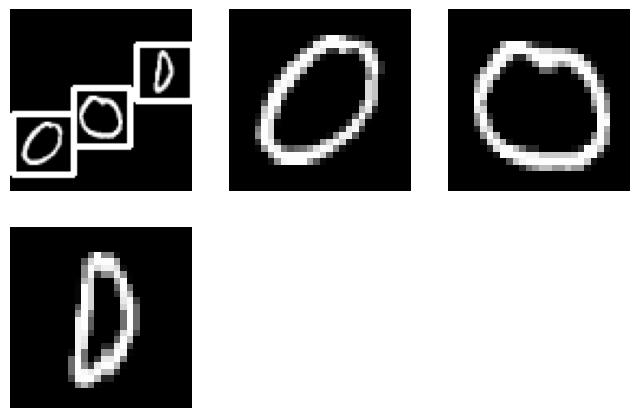

192000
60000
48000
(192000, 28, 28)
(60000, 28, 28)
(48000, 28, 28)
(192000,)
(60000,)
(48000,)
10
10
10


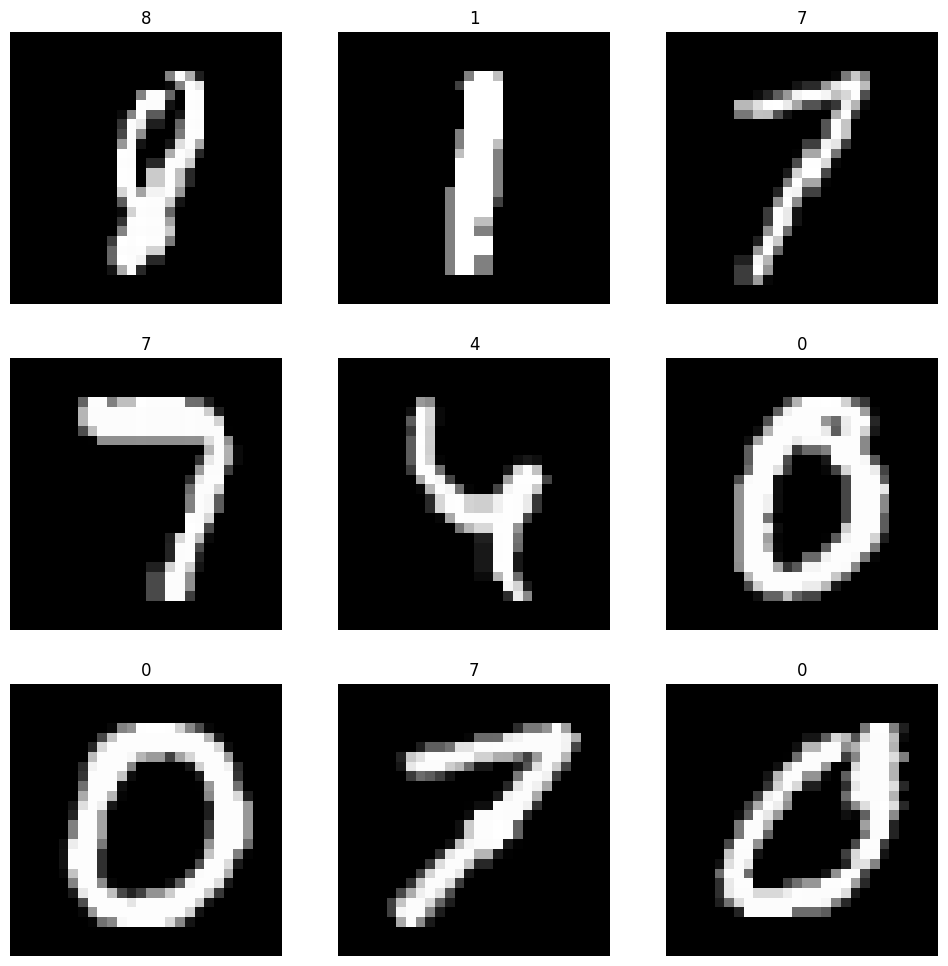

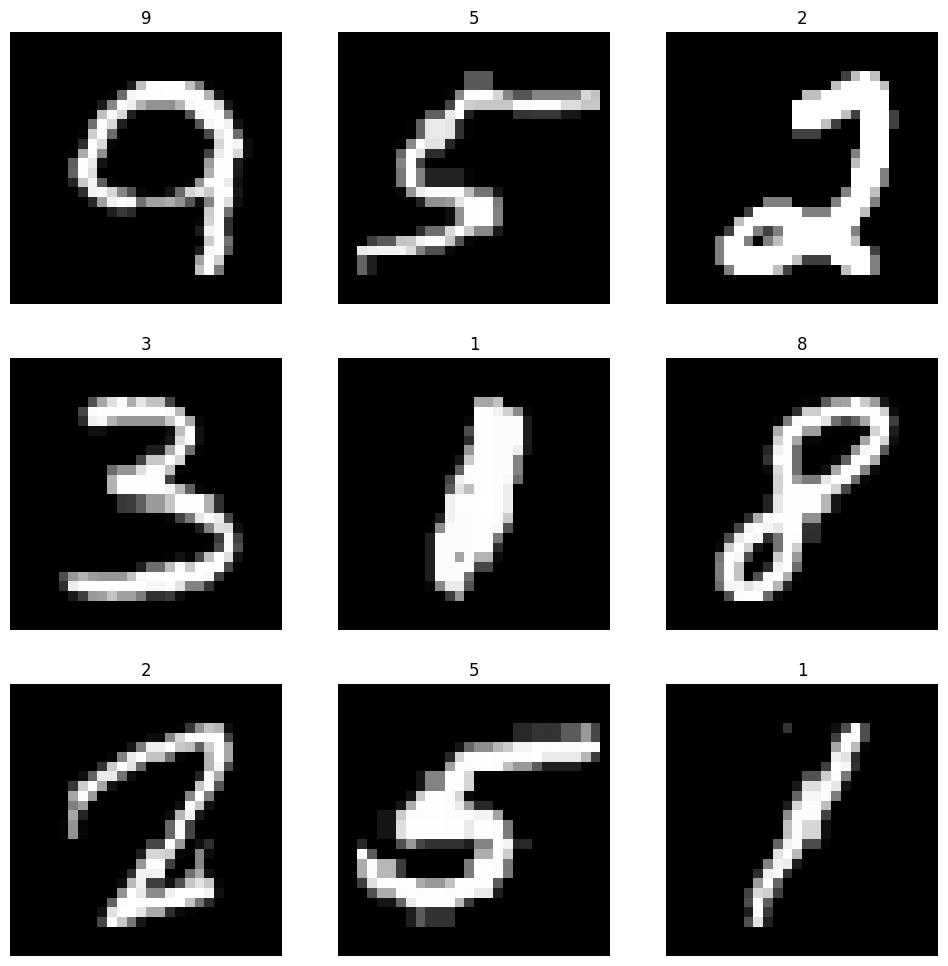

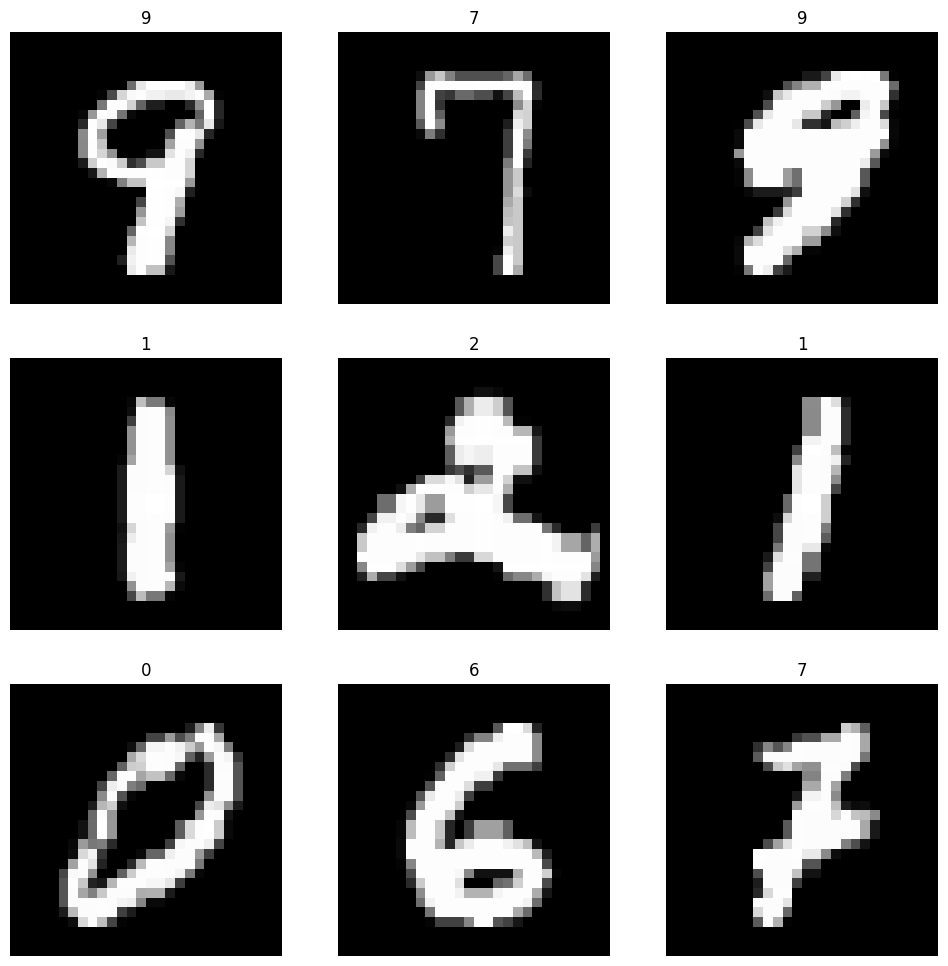

Training data shape: (192000, 28, 28, 1) (192000,)
Validation data shape: (48000, 28, 28, 1) (48000,)
Test data shape: (60000, 28, 28, 1) (60000,)
batch_size: 32, epochs: 5, learning_rate: 0.0001


/usr/local/lib/python3.10/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                      │ (None, 26, 26, 8)           │              80 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d (MaxPooling2D)         │ (None, 13, 13, 8)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_1 (Conv2D)                    │ (None, 11, 11, 16)          │           1,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_1 (MaxPooling2D)       │ (None, 5, 5, 16)            │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_2 (Conv2D)                    │ (None, 3, 3, 32)            │           4,640 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_2 (MaxPooling2D)       │ (None, 1, 1, 32)            │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 32)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 10)                  │             330 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 6,218 (24.29 KB)

 Trainable params: 6,218 (24.29 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/5
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 22s 3ms/step - accuracy: 0.6331 - auc: 0.9062 - loss: 1.1793 - precision: 0.8164 - recall: 0.4225 - val_accuracy: 0.8935 - val_auc: 0.9902 - val_loss: 0.3593 - val_precision: 0.9227 - val_recall: 0.8676
Epoch 2/5
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 14s 2ms/step - accuracy: 0.9046 - auc: 0.9918 - loss: 0.3233 - precision: 0.9293 - recall: 0.8819 - val_accuracy: 0.9310 - val_auc: 0.9946 - val_loss: 0.2446 - val_precision: 0.9474 - val_recall: 0.9164
Epoch 3/5
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 14s 2ms/step - accuracy: 0.9340 - auc: 0.9948 - loss: 0.2326 - precision: 0.9489 - recall: 0.9200 - val_accuracy: 0.9434 - val_auc: 0.9958 - val_loss: 0.2006 - val_precision: 0.9558 - val_recall: 0.9329
Epoch 4/5
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 14s 2ms/step - accuracy: 0.9439 - auc: 0.9957 - loss: 0.1977 - precision: 0.9556 - recall: 0.9336 - val_accuracy: 0.9509 - val_auc: 0.9963 - val_loss: 0.1767 - val_precision: 0.9604 - val_recall: 0.9423
Epoch 5/5
6000/6000 ━━━━

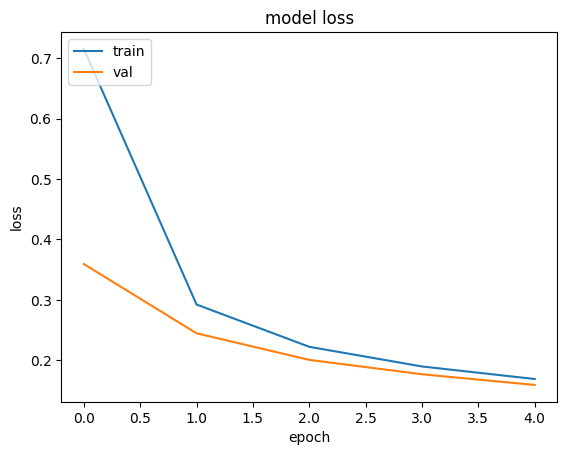

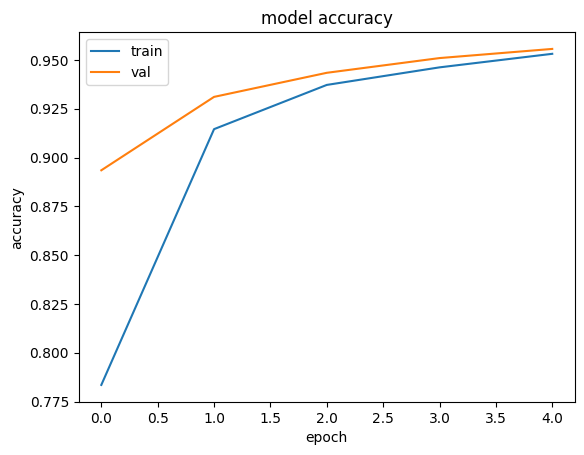

batch_size: 32, epochs: 5, learning_rate: 0.001


Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d_3 (Conv2D)                    │ (None, 26, 26, 8)           │              80 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_3 (MaxPooling2D)       │ (None, 13, 13, 8)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_4 (Conv2D)                    │ (None, 11, 11, 16)          │           1,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_4 (MaxPooling2D)       │ (None, 5, 5, 16)            │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_5 (Conv2D)                    │ (None, 3, 3, 32)            │           4,640 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_5 (MaxPooling2D)       │ (None, 1, 1, 32)            │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_1 (Flatten)                  │ (None, 32)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 10)                  │             330 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 6,218 (24.29 KB)

 Trainable params: 6,218 (24.29 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/5
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 20s 3ms/step - accuracy: 0.8635 - auc_1: 0.9807 - loss: 0.4385 - precision_1: 0.9275 - recall_1: 0.8129 - val_accuracy: 0.9648 - val_auc_1: 0.9975 - val_loss: 0.1253 - val_precision_1: 0.9711 - val_recall_1: 0.9599
Epoch 2/5
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 14s 2ms/step - accuracy: 0.9676 - auc_1: 0.9980 - loss: 0.1127 - precision_1: 0.9732 - recall_1: 0.9633 - val_accuracy: 0.9741 - val_auc_1: 0.9982 - val_loss: 0.0950 - val_precision_1: 0.9787 - val_recall_1: 0.9712
Epoch 3/5
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 14s 2ms/step - accuracy: 0.9760 - auc_1: 0.9984 - loss: 0.0849 - precision_1: 0.9800 - recall_1: 0.9731 - val_accuracy: 0.9791 - val_auc_1: 0.9984 - val_loss: 0.0764 - val_precision_1: 0.9828 - val_recall_1: 0.9771
Epoch 4/5
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 14s 2ms/step - accuracy: 0.9796 - auc_1: 0.9987 - loss: 0.0726 - precision_1: 0.9827 - recall_1: 0.9769 - val_accuracy: 0.9789 - val_auc_1: 0.9984 - val_loss: 0.0773 - val_precision_1: 0.9817

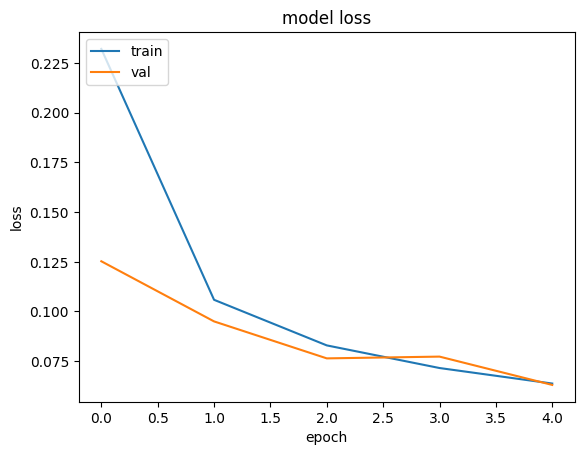

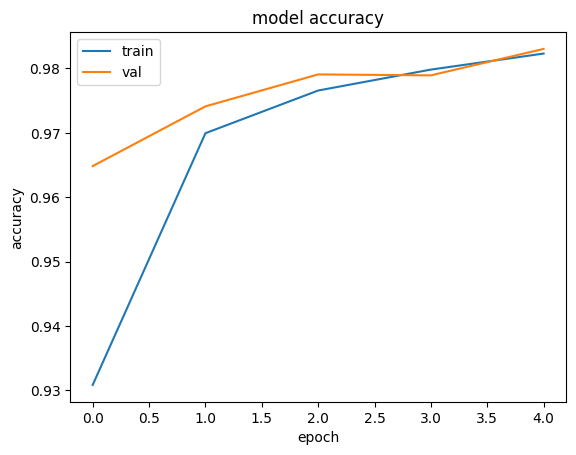

batch_size: 32, epochs: 10, learning_rate: 0.0001


Model: "sequential_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d_6 (Conv2D)                    │ (None, 26, 26, 8)           │              80 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_6 (MaxPooling2D)       │ (None, 13, 13, 8)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_7 (Conv2D)                    │ (None, 11, 11, 16)          │           1,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_7 (MaxPooling2D)       │ (None, 5, 5, 16)            │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_8 (Conv2D)                    │ (None, 3, 3, 32)            │           4,640 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_8 (MaxPooling2D)       │ (None, 1, 1, 32)            │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_2 (Flatten)                  │ (None, 32)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 10)                  │             330 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 6,218 (24.29 KB)

 Trainable params: 6,218 (24.29 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/10
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 20s 3ms/step - accuracy: 0.6738 - auc_2: 0.9168 - loss: 1.0913 - precision_2: 0.8383 - recall_2: 0.4757 - val_accuracy: 0.9140 - val_auc_2: 0.9934 - val_loss: 0.2867 - val_precision_2: 0.9355 - val_recall_2: 0.8942
Epoch 2/10
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 14s 2ms/step - accuracy: 0.9191 - auc_2: 0.9940 - loss: 0.2686 - precision_2: 0.9385 - recall_2: 0.9022 - val_accuracy: 0.9407 - val_auc_2: 0.9959 - val_loss: 0.2046 - val_precision_2: 0.9538 - val_recall_2: 0.9283
Epoch 3/10
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 14s 2ms/step - accuracy: 0.9424 - auc_2: 0.9962 - loss: 0.1960 - precision_2: 0.9551 - recall_2: 0.9312 - val_accuracy: 0.9510 - val_auc_2: 0.9965 - val_loss: 0.1728 - val_precision_2: 0.9614 - val_recall_2: 0.9419
Epoch 4/10
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 14s 2ms/step - accuracy: 0.9506 - auc_2: 0.9966 - loss: 0.1712 - precision_2: 0.9607 - recall_2: 0.9421 - val_accuracy: 0.9574 - val_auc_2: 0.9970 - val_loss: 0.1504 - val_precision_2: 0.

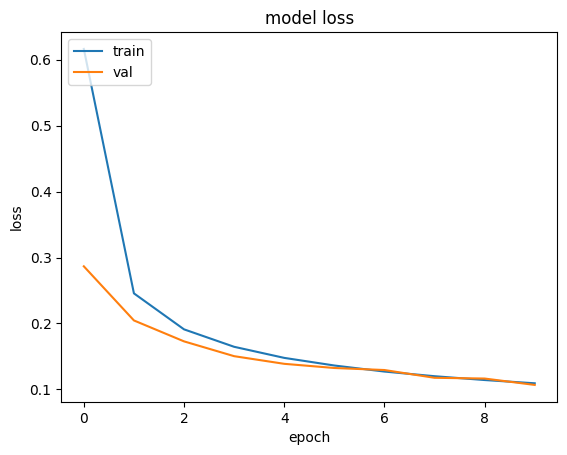

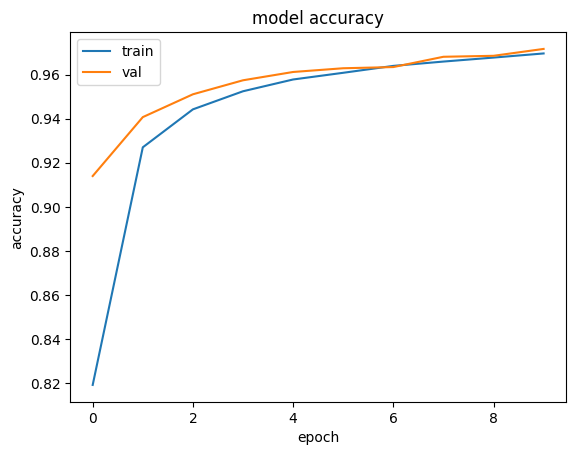

batch_size: 32, epochs: 10, learning_rate: 0.001


Model: "sequential_3"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d_9 (Conv2D)                    │ (None, 26, 26, 8)           │              80 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_9 (MaxPooling2D)       │ (None, 13, 13, 8)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_10 (Conv2D)                   │ (None, 11, 11, 16)          │           1,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_10 (MaxPooling2D)      │ (None, 5, 5, 16)            │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_11 (Conv2D)                   │ (None, 3, 3, 32)            │           4,640 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_11 (MaxPooling2D)      │ (None, 1, 1, 32)            │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_3 (Flatten)                  │ (None, 32)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 10)                  │             330 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 6,218 (24.29 KB)

 Trainable params: 6,218 (24.29 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/10
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 19s 3ms/step - accuracy: 0.8642 - auc_3: 0.9817 - loss: 0.4346 - precision_3: 0.9215 - recall_3: 0.8125 - val_accuracy: 0.9679 - val_auc_3: 0.9978 - val_loss: 0.1145 - val_precision_3: 0.9728 - val_recall_3: 0.9636
Epoch 2/10
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 14s 2ms/step - accuracy: 0.9674 - auc_3: 0.9978 - loss: 0.1136 - precision_3: 0.9727 - recall_3: 0.9633 - val_accuracy: 0.9748 - val_auc_3: 0.9984 - val_loss: 0.0912 - val_precision_3: 0.9790 - val_recall_3: 0.9720
Epoch 3/10
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 14s 2ms/step - accuracy: 0.9753 - auc_3: 0.9984 - loss: 0.0864 - precision_3: 0.9791 - recall_3: 0.9724 - val_accuracy: 0.9787 - val_auc_3: 0.9986 - val_loss: 0.0768 - val_precision_3: 0.9820 - val_recall_3: 0.9766
Epoch 4/10
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 13s 2ms/step - accuracy: 0.9800 - auc_3: 0.9987 - loss: 0.0714 - precision_3: 0.9830 - recall_3: 0.9774 - val_accuracy: 0.9798 - val_auc_3: 0.9985 - val_loss: 0.0737 - val_precision_3: 0.

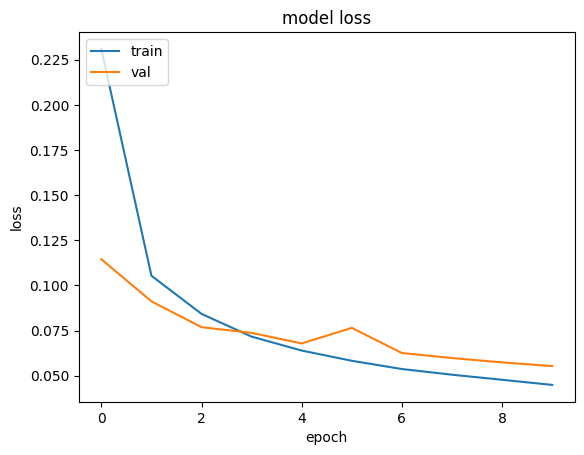

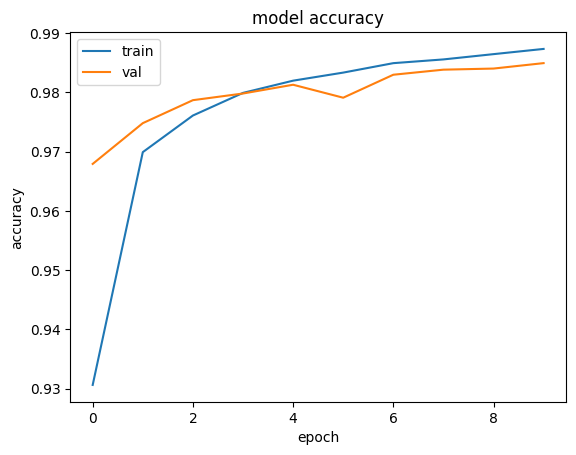

batch_size: 64, epochs: 5, learning_rate: 0.0001


Model: "sequential_4"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d_12 (Conv2D)                   │ (None, 26, 26, 8)           │              80 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_12 (MaxPooling2D)      │ (None, 13, 13, 8)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_13 (Conv2D)                   │ (None, 11, 11, 16)          │           1,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_13 (MaxPooling2D)      │ (None, 5, 5, 16)            │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_14 (Conv2D)                   │ (None, 3, 3, 32)            │           4,640 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_14 (MaxPooling2D)      │ (None, 1, 1, 32)            │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_4 (Flatten)                  │ (None, 32)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_4 (Dense)                      │ (None, 10)                  │             330 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 6,218 (24.29 KB)

 Trainable params: 6,218 (24.29 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/5
3000/3000 ━━━━━━━━━━━━━━━━━━━━ 12s 3ms/step - accuracy: 0.5537 - auc_4: 0.8778 - loss: 1.3862 - precision_4: 0.7698 - recall_4: 0.3110 - val_accuracy: 0.8843 - val_auc_4: 0.9895 - val_loss: 0.3946 - val_precision_4: 0.9198 - val_recall_4: 0.8468
Epoch 2/5
3000/3000 ━━━━━━━━━━━━━━━━━━━━ 8s 3ms/step - accuracy: 0.8913 - auc_4: 0.9910 - loss: 0.3588 - precision_4: 0.9214 - recall_4: 0.8629 - val_accuracy: 0.9206 - val_auc_4: 0.9941 - val_loss: 0.2683 - val_precision_4: 0.9398 - val_recall_4: 0.9041
Epoch 3/5
3000/3000 ━━━━━━━━━━━━━━━━━━━━ 8s 3ms/step - accuracy: 0.9223 - auc_4: 0.9944 - loss: 0.2611 - precision_4: 0.9399 - recall_4: 0.9063 - val_accuracy: 0.9356 - val_auc_4: 0.9954 - val_loss: 0.2209 - val_precision_4: 0.9491 - val_recall_4: 0.9226
Epoch 4/5
3000/3000 ━━━━━━━━━━━━━━━━━━━━ 8s 3ms/step - accuracy: 0.9374 - auc_4: 0.9957 - loss: 0.2139 - precision_4: 0.9505 - recall_4: 0.9258 - val_accuracy: 0.9467 - val_auc_4: 0.9961 - val_loss: 0.1903 - val_precision_4: 0.9580 - 

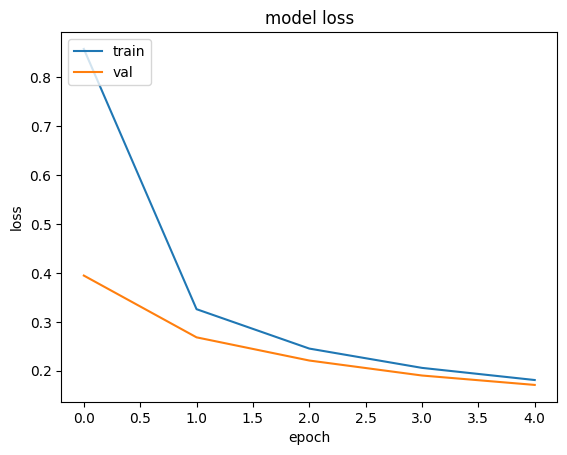

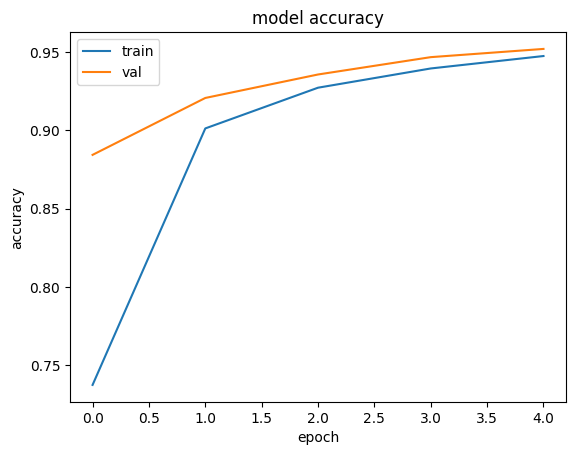

batch_size: 64, epochs: 5, learning_rate: 0.001


Model: "sequential_5"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d_15 (Conv2D)                   │ (None, 26, 26, 8)           │              80 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_15 (MaxPooling2D)      │ (None, 13, 13, 8)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_16 (Conv2D)                   │ (None, 11, 11, 16)          │           1,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_16 (MaxPooling2D)      │ (None, 5, 5, 16)            │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_17 (Conv2D)                   │ (None, 3, 3, 32)            │           4,640 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_17 (MaxPooling2D)      │ (None, 1, 1, 32)            │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_5 (Flatten)                  │ (None, 32)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_5 (Dense)                      │ (None, 10)                  │             330 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 6,218 (24.29 KB)

 Trainable params: 6,218 (24.29 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/5
3000/3000 ━━━━━━━━━━━━━━━━━━━━ 11s 3ms/step - accuracy: 0.8325 - auc_5: 0.9729 - loss: 0.5458 - precision_5: 0.9103 - recall_5: 0.7592 - val_accuracy: 0.9569 - val_auc_5: 0.9972 - val_loss: 0.1475 - val_precision_5: 0.9645 - val_recall_5: 0.9505
Epoch 2/5
3000/3000 ━━━━━━━━━━━━━━━━━━━━ 8s 3ms/step - accuracy: 0.9614 - auc_5: 0.9975 - loss: 0.1328 - precision_5: 0.9680 - recall_5: 0.9563 - val_accuracy: 0.9675 - val_auc_5: 0.9977 - val_loss: 0.1166 - val_precision_5: 0.9730 - val_recall_5: 0.9632
Epoch 3/5
3000/3000 ━━━━━━━━━━━━━━━━━━━━ 8s 3ms/step - accuracy: 0.9696 - auc_5: 0.9982 - loss: 0.1053 - precision_5: 0.9747 - recall_5: 0.9654 - val_accuracy: 0.9718 - val_auc_5: 0.9983 - val_loss: 0.0985 - val_precision_5: 0.9767 - val_recall_5: 0.9677
Epoch 4/5
3000/3000 ━━━━━━━━━━━━━━━━━━━━ 8s 3ms/step - accuracy: 0.9747 - auc_5: 0.9984 - loss: 0.0904 - precision_5: 0.9789 - recall_5: 0.9713 - val_accuracy: 0.9774 - val_auc_5: 0.9984 - val_loss: 0.0831 - val_precision_5: 0.9806 - 

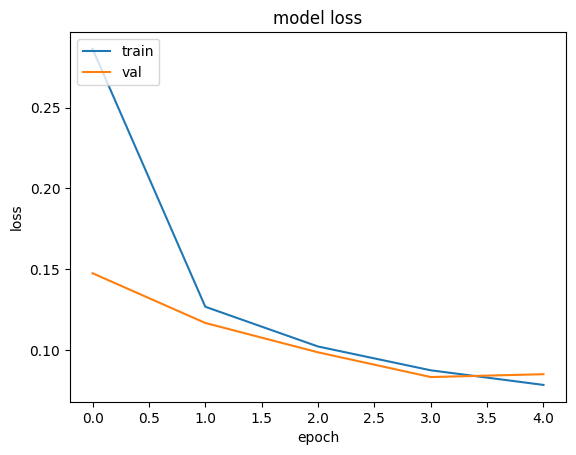

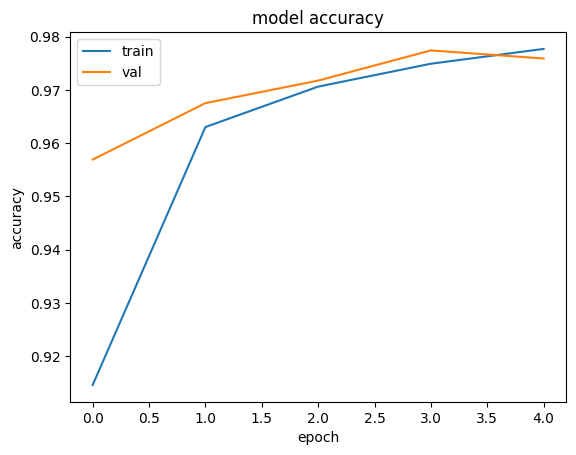

batch_size: 64, epochs: 10, learning_rate: 0.0001


Model: "sequential_6"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d_18 (Conv2D)                   │ (None, 26, 26, 8)           │              80 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_18 (MaxPooling2D)      │ (None, 13, 13, 8)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_19 (Conv2D)                   │ (None, 11, 11, 16)          │           1,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_19 (MaxPooling2D)      │ (None, 5, 5, 16)            │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_20 (Conv2D)                   │ (None, 3, 3, 32)            │           4,640 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_20 (MaxPooling2D)      │ (None, 1, 1, 32)            │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_6 (Flatten)                  │ (None, 32)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_6 (Dense)                      │ (None, 10)                  │             330 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 6,218 (24.29 KB)

 Trainable params: 6,218 (24.29 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/10
3000/3000 ━━━━━━━━━━━━━━━━━━━━ 12s 3ms/step - accuracy: 0.5563 - auc_6: 0.8705 - loss: 1.4310 - precision_6: 0.7730 - recall_6: 0.3003 - val_accuracy: 0.8719 - val_auc_6: 0.9872 - val_loss: 0.4329 - val_precision_6: 0.9092 - val_recall_6: 0.8341
Epoch 2/10
3000/3000 ━━━━━━━━━━━━━━━━━━━━ 8s 3ms/step - accuracy: 0.8806 - auc_6: 0.9883 - loss: 0.4047 - precision_6: 0.9142 - recall_6: 0.8462 - val_accuracy: 0.9085 - val_auc_6: 0.9923 - val_loss: 0.3134 - val_precision_6: 0.9320 - val_recall_6: 0.8868
Epoch 3/10
3000/3000 ━━━━━━━━━━━━━━━━━━━━ 8s 3ms/step - accuracy: 0.9099 - auc_6: 0.9927 - loss: 0.3024 - precision_6: 0.9322 - recall_6: 0.8899 - val_accuracy: 0.9246 - val_auc_6: 0.9942 - val_loss: 0.2584 - val_precision_6: 0.9427 - val_recall_6: 0.9081
Epoch 4/10
3000/3000 ━━━━━━━━━━━━━━━━━━━━ 8s 3ms/step - accuracy: 0.9260 - auc_6: 0.9944 - loss: 0.2514 - precision_6: 0.9435 - recall_6: 0.9109 - val_accuracy: 0.9355 - val_auc_6: 0.9951 - val_loss: 0.2239 - val_precision_6: 0.950

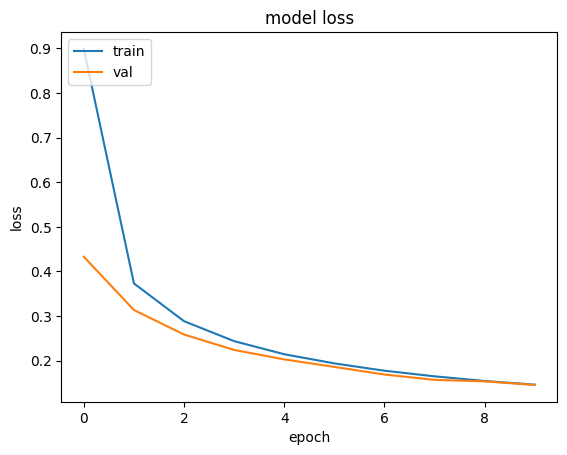

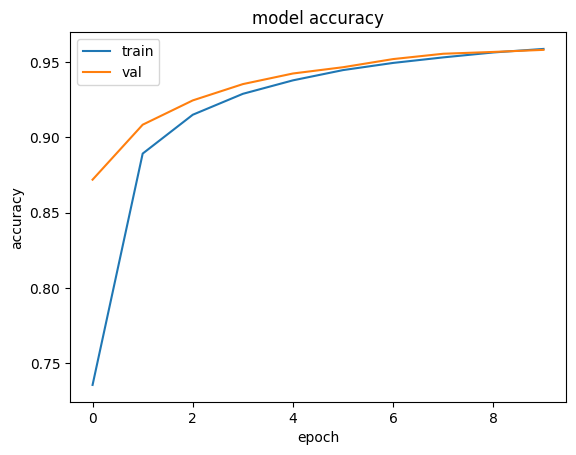

batch_size: 64, epochs: 10, learning_rate: 0.001


Model: "sequential_7"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d_21 (Conv2D)                   │ (None, 26, 26, 8)           │              80 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_21 (MaxPooling2D)      │ (None, 13, 13, 8)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_22 (Conv2D)                   │ (None, 11, 11, 16)          │           1,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_22 (MaxPooling2D)      │ (None, 5, 5, 16)            │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_23 (Conv2D)                   │ (None, 3, 3, 32)            │           4,640 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_23 (MaxPooling2D)      │ (None, 1, 1, 32)            │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_7 (Flatten)                  │ (None, 32)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_7 (Dense)                      │ (None, 10)                  │             330 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 6,218 (24.29 KB)

 Trainable params: 6,218 (24.29 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/10
3000/3000 ━━━━━━━━━━━━━━━━━━━━ 11s 3ms/step - accuracy: 0.8167 - auc_7: 0.9699 - loss: 0.5859 - precision_7: 0.8992 - recall_7: 0.7400 - val_accuracy: 0.9588 - val_auc_7: 0.9972 - val_loss: 0.1484 - val_precision_7: 0.9669 - val_recall_7: 0.9520
Epoch 2/10
3000/3000 ━━━━━━━━━━━━━━━━━━━━ 8s 3ms/step - accuracy: 0.9600 - auc_7: 0.9973 - loss: 0.1380 - precision_7: 0.9674 - recall_7: 0.9538 - val_accuracy: 0.9674 - val_auc_7: 0.9978 - val_loss: 0.1123 - val_precision_7: 0.9736 - val_recall_7: 0.9638
Epoch 3/10
3000/3000 ━━━━━━━━━━━━━━━━━━━━ 8s 3ms/step - accuracy: 0.9691 - auc_7: 0.9979 - loss: 0.1091 - precision_7: 0.9739 - recall_7: 0.9648 - val_accuracy: 0.9743 - val_auc_7: 0.9981 - val_loss: 0.0961 - val_precision_7: 0.9786 - val_recall_7: 0.9708
Epoch 4/10
3000/3000 ━━━━━━━━━━━━━━━━━━━━ 8s 3ms/step - accuracy: 0.9743 - auc_7: 0.9984 - loss: 0.0913 - precision_7: 0.9783 - recall_7: 0.9707 - val_accuracy: 0.9761 - val_auc_7: 0.9984 - val_loss: 0.0877 - val_precision_7: 0.980

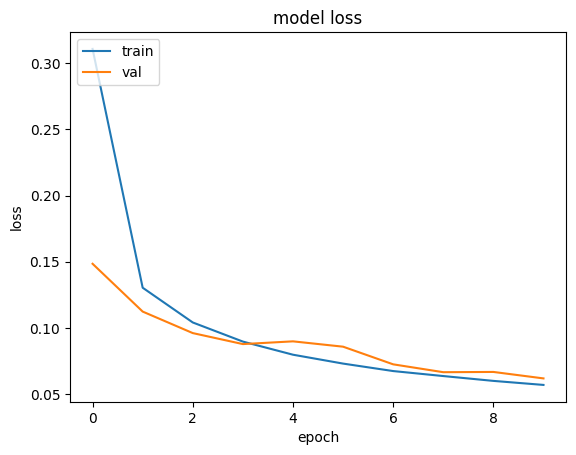

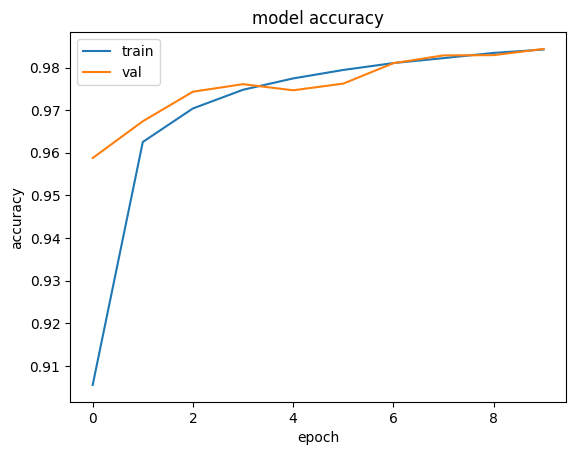

Single Digits Best Hyperparameters (CNN): {'batch_size': 32, 'epochs': 10, 'learning_rate': 0.001}
Single Digits Best Accuracy Score (CNN): 0.9849166870117188


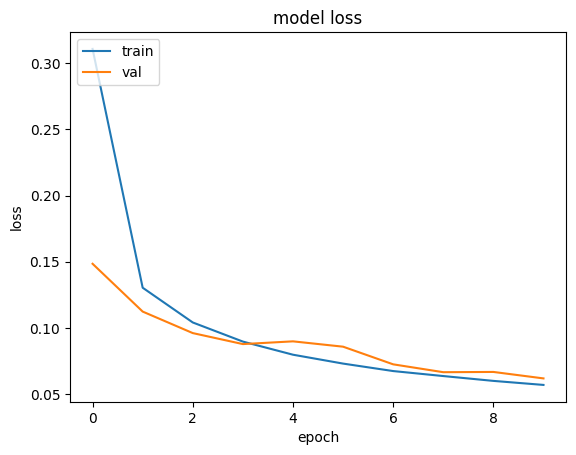

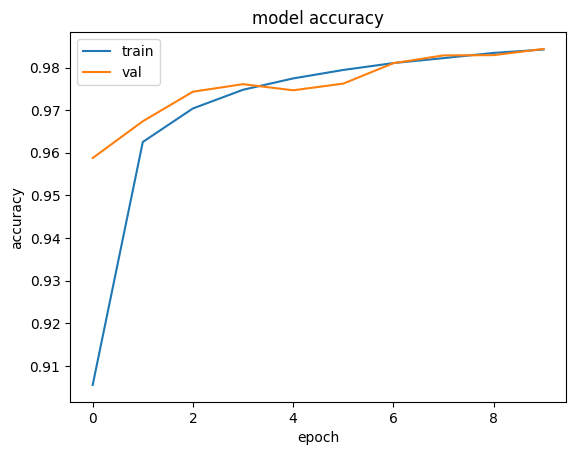

Single Digits Test loss: 0.0512985922396183
Single Digits Test accuracy: 0.9855166673660278
Single Digits Test precision: 0.9877247214317322
Single Digits Test recall: 0.9843500256538391
Single Digits Test AUC: 0.998927652835846
single digit classific report
1875/1875 ━━━━━━━━━━━━━━━━━━━━ 2s 1ms/step
Classification Report (Single Digits):
              precision    recall  f1-score   support

           0     0.9883    0.9930    0.9907      6300
           1     0.9904    0.9928    0.9916      5800
           2     0.9763    0.9749    0.9756      4900
           3     0.9900    0.9871    0.9885      5800
           4     0.9748    0.9948    0.9847      6600
           5     0.9870    0.9854    0.9862      6700
           6     0.9901    0.9835    0.9868      6500
           7     0.9666    0.9902    0.9783      5000
           8     0.9957    0.9733    0.9844      6700
           9     0.9920    0.9793    0.9856      5700

    accuracy                         0.9855     60000
   macro 

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


[[  0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0 

In [ ]:
#TASK-3 CNN with 3 distinct digits specific hyperparams######################              #############           #################            #################   SADECE 3 LAYER AZ FILTER
import tensorflow as tf
import tensorflow.keras as keras
from tensorflow.keras import layers, models
from sklearn.metrics import classification_report, confusion_matrix
import cv2
from tensorflow.keras import metrics
##### SPLIT FUNCTION AND ITS DEMONSTRATION #####
digit_shape = (28, 28)
def crop_digits(img_path: str = None, im = None):
    #if im is None:
    #    im = cv2.imread(img_path)

    #gray = cv2.cvtColor(im, cv2.COLOR_BGR2GRAY)
    blur = cv2.GaussianBlur(img_path, (5, 5), 0)
    thresh = cv2.threshold(blur, 90, 255, cv2.THRESH_BINARY+cv2.THRESH_OTSU)[1]
    contours, hierarchy = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    digits = []
    rect = img_path.copy()
    for cnt in contours:
        x, y, w, h = cv2.boundingRect(cnt)

        x = max(x - 3, 0)
        y = max(y - 3, 0)
        w += 6
        h += 6

        del_x = int(w / 2)
        del_y = int(h / 2)
        center_x = x + del_x
        center_y = y + del_y

        lu_corner = (max(center_x - del_y, 0), y)
        rd_corner = (max(center_x + del_y, 0), y + h)

        rect = cv2.rectangle(rect, lu_corner, rd_corner, (255, 0, 0), 2) #rectangle

        cropped = img_path[lu_corner[1]:rd_corner[1], lu_corner[0]:rd_corner[0]]
        digits.append(cropped)

    def filter_and_sort_digits(digits, contours):
        sizes = []
        for digit in digits:
            size = digit.shape[0] * digit.shape[1]
            sizes.append(size)
        avg_size = sum(sizes) / len(sizes)
        deviations = [abs(size - avg_size) for size in sizes]

        indices = np.argsort(deviations)[0:3]
        digits = [digits[i] for i in indices]
        contours = [cv2.boundingRect(contours[i]) for i in indices]

        xs = [contour[0] for contour in contours]
        indices = np.argsort(xs) #get highest likelihood digit
        digits = [digits[i] for i in indices]

        while len(digits) < 3:
            digits.append(digits[0])
        return digits

    digits = filter_and_sort_digits(digits, contours) #get highest likelihood digits
    digits = [cv2.resize(digit, digit_shape, interpolation = cv2.INTER_NEAREST) for digit in digits] #resize to 28,28

    return digits, contours, rect

print(f"Label: {train_labels[0]}")
print(train_labels[0][0])
print(train_labels[0][1])
print(train_labels[0][2])

fig = plt.figure(figsize=(8, 8))
cols, rows = 3, 3

digits, contours, rect = crop_digits(train_images[0])

fig.add_subplot(rows, cols, 1)
plt.axis("off")
plt.imshow(rect.squeeze(), cmap="gray")
for i in range(len(digits)):
    img = digits[i]
    print(train_labels[0][i])
    fig.add_subplot(rows, cols, i+2)
    plt.axis("off")
    plt.imshow(img.squeeze(), cmap="gray")
    print(f"crop shape: {img.shape}")
plt.show()


##### SPLIT ALL DATA TO DIGITS #####
def load_digits(images, labels):
  all_digits = []
  all_labels = []
  for i in range(len(images)):
    digits, contours, rect = crop_digits(images[i])
    for j in range(len(digits)):
      all_digits.append(digits[j])
      all_labels.append(labels[i][j])
  return np.array(all_digits), np.array(all_labels)

train_images, train_labels = load_digits(train_images, train_labels)
test_images_digits, test_labels_digits = load_digits(test_images, test_labels)
val_images, val_labels = load_digits(val_images, val_labels)
print(len(train_images))
print(len(test_images_digits))
print(len(val_images))
print(train_images.shape)
print(test_images_digits.shape)
print(val_images.shape)
print(train_labels.shape)
print(test_labels_digits.shape)
print(val_labels.shape)

print(len(np.unique(train_labels)))
print(len(np.unique(test_labels_digits)))
print(len(np.unique(val_labels)))

def visualize(images, labels):
  np.random.seed(42)
  random_indices = np.random.choice(len(images), size=9, replace=False)
  random_images = images[random_indices]
  random_labels = labels[random_indices]

  fig, axes = plt.subplots(3, 3, figsize=(12, 12))
  for i, (img, label) in enumerate(zip(random_images, random_labels)):
      ax = axes[i // 3, i % 3]
      ax.imshow(img, cmap='gray')
      ax.set_title(label)
      ax.axis('off')
  plt.show()

visualize(train_images, train_labels)
visualize(test_images_digits, test_labels_digits)
visualize(val_images, val_labels)


##### TRAIN CNN ######################################################################################################################################################################0000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000
train_images = train_images / 255.0
val_images = val_images / 255.0
test_images_digits = test_images_digits / 255.0

train_images = train_images.reshape((train_images.shape[0], 28, 28, 1))
val_images = val_images.reshape((val_images.shape[0], 28, 28, 1))
test_images_digits = test_images_digits.reshape((test_images_digits.shape[0], 28, 28, 1))

print('Training data shape:', train_images.shape, train_labels.shape)
print('Validation data shape:', val_images.shape, val_labels.shape)
print('Test data shape:', test_images_digits.shape, test_labels_digits.shape)

train_labels = tf.keras.utils.to_categorical(train_labels, num_classes=10)
val_labels = tf.keras.utils.to_categorical(val_labels, num_classes=10)
test_labels_digits = tf.keras.utils.to_categorical(test_labels_digits, num_classes=10)




param_grid_cnn = {
    'batch_size': [32, 64],
    'epochs': [5,10 ],
    'learning_rate': [1e-4,1e-3 ]
    #'batch_size': [32],
    #'epochs': [3],
    #'learning_rate': [1e-4],
}

best_params_cnn = None
best_accuracy_cnn = -1
for batch_size in param_grid_cnn['batch_size']:
    for epochs in param_grid_cnn['epochs']:
        for learning_rate in param_grid_cnn['learning_rate']:
          print(f"batch_size: {batch_size}, epochs: {epochs}, learning_rate: {learning_rate}")
          model = models.Sequential()
          model.add(layers.Conv2D(8, (3, 3), activation='relu', input_shape=(28, 28, 1)))
          #model.add(layers.BatchNormalization()) #### FOR TASK 4
          model.add(layers.MaxPooling2D((2, 2)))
          model.add(layers.Conv2D(16, (3, 3), activation='relu'))
          #model.add(layers.BatchNormalization()) #### FOR TASK 4
          model.add(layers.MaxPooling2D((2, 2)))
          model.add(layers.Conv2D(32, (3, 3), activation='relu'))
          #model.add(layers.BatchNormalization()) #### FOR TASK 4
          model.add(layers.MaxPooling2D((2, 2)))
          #model.add(layers.Conv2D(128, (3, 3), activation='relu')) #### FOR TASK 4
          #model.add(layers.BatchNormalization()) #### FOR TASK 4
          #model.add(layers.MaxPooling2D((2, 2))) #### FOR TASK 4
          model.add(layers.Flatten())
          # model.add(layers.Dropout(0.5)) #0.7 #### FOR TASK 4
          model.add(layers.Dense(10, activation='softmax'))
          model.summary()

          model.compile(loss="categorical_crossentropy", optimizer=keras.optimizers.Adam(learning_rate=learning_rate), metrics=["accuracy", metrics.Precision(), metrics.Recall(), metrics.AUC()])


          history = model.fit(train_images, train_labels, batch_size=batch_size, epochs=epochs, validation_data=(val_images, val_labels))

          score_train = model.evaluate(train_images, train_labels, verbose=0)
          print("Single Digits Train loss:", score_train[0])
          print("Single Digits Train accuracy:", score_train[1])
          score_val = model.evaluate(val_images, val_labels, verbose=0)
          print("Single Digits Validation loss:", score_val[0])
          print("Single Digits Validation accuracy:", score_val[1])
          plt.plot(history.history['loss'])
          plt.plot(history.history['val_loss'])
          plt.title('model loss')
          plt.ylabel('loss')
          plt.xlabel('epoch')
          plt.legend(['train', 'val'], loc='upper left')
          plt.show()

          plt.plot(history.history['accuracy'])
          plt.plot(history.history['val_accuracy'])
          plt.title('model accuracy')
          plt.ylabel('accuracy')
          plt.xlabel('epoch')
          plt.legend(['train', 'val'], loc='upper left')
          plt.show()
          if score_val[1] > best_accuracy_cnn:
                  best_accuracy_cnn = score_val[1]
                  best_params_cnn = {'batch_size': batch_size, 'epochs': epochs, 'learning_rate':learning_rate}

                  model.save('best_model.h5')


print("Single Digits Best Hyperparameters (CNN):", best_params_cnn)
print("Single Digits Best Accuracy Score (CNN):", best_accuracy_cnn)
model = tf.keras.models.load_model('best_model.h5')
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

score = model.evaluate(test_images_digits, test_labels_digits, verbose=0)
print("Single Digits Test loss:", score[0])
print("Single Digits Test accuracy:", score[1])
print("Single Digits Test precision:", score[2])
print("Single Digits Test recall:", score[3])
print("Single Digits Test AUC:", score[4])
print("single digit classific report")
predictions_digits = model.predict(test_images_digits)
predicted_labels_digits = np.argmax(predictions_digits, axis=1)  # Convert predictions to class labels
true_labels_digits = np.argmax(test_labels_digits, axis=1)  # Convert one-hot encoded labels to class labels

# Print the classification report for single digits
print("Classification Report (Single Digits):")
print(classification_report(true_labels_digits, predicted_labels_digits, digits=4))

final_test_predictions = []
for i in range(len(test_images)):
  img = test_images[i]
  concat = ""
  for j in range(0,3):
    img_digit = test_images_digits[3*i + j]
    #prediction = model.predict_on_batch([img_digit])
    prediction = model.predict_on_batch(np.expand_dims(img_digit, axis=0))
    prediction = np.argmax(prediction)
    #print(prediction, test_labels[i])
    concat = concat + str(prediction)
  #print(concat, test_labels[i])
  final_test_predictions.append(concat)

np.set_printoptions(threshold=np.inf)

print("Classification Report:")
print(classification_report(test_labels, final_test_predictions, digits = 4))

print("\nConfusion Matrix:")
print(confusion_matrix(test_labels, final_test_predictions))


Label: 000
0
0
0
0
crop shape: (28, 28)
0
crop shape: (28, 28)
0
crop shape: (28, 28)


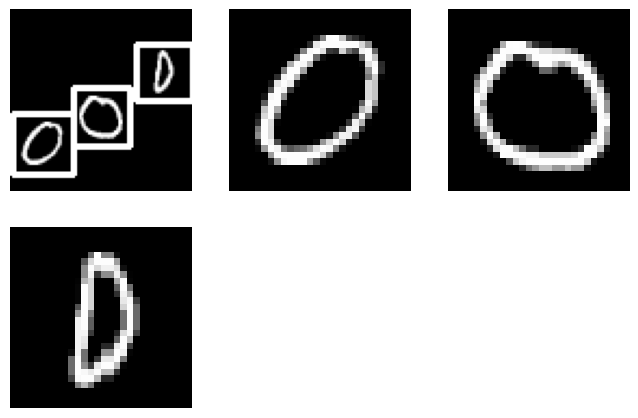

192000
60000
48000
(192000, 28, 28)
(60000, 28, 28)
(48000, 28, 28)
(192000,)
(60000,)
(48000,)
10
10
10


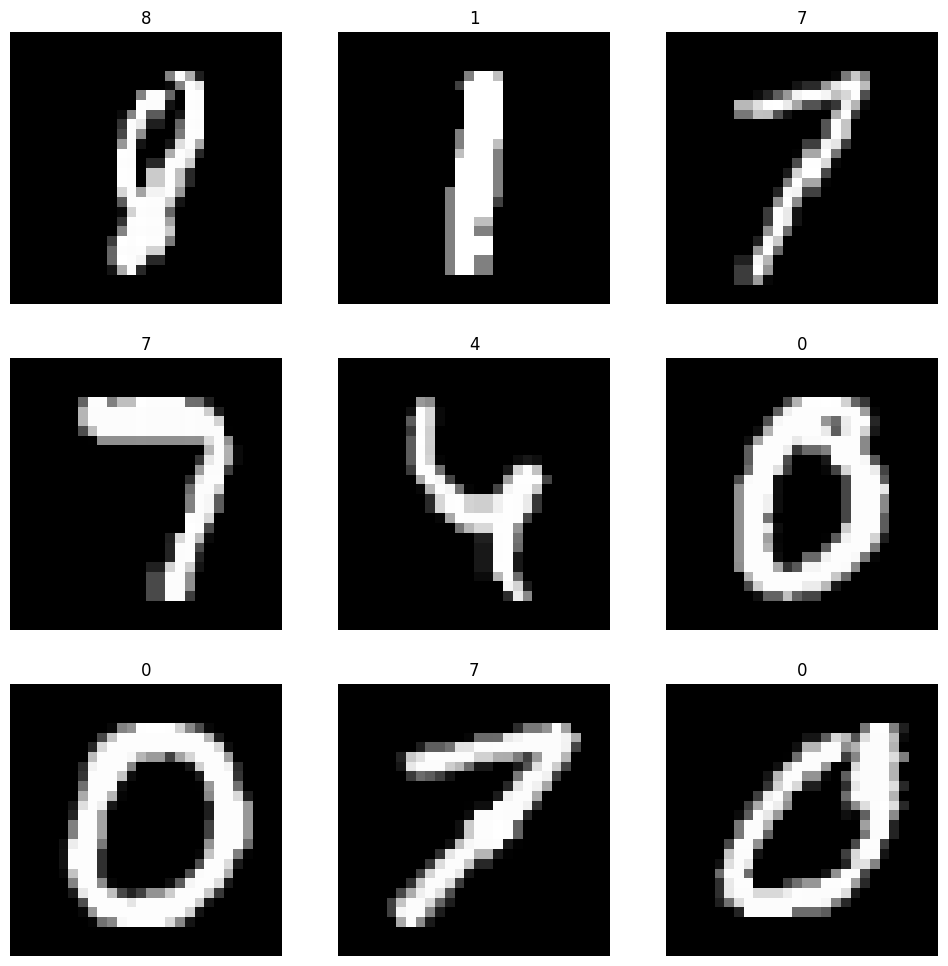

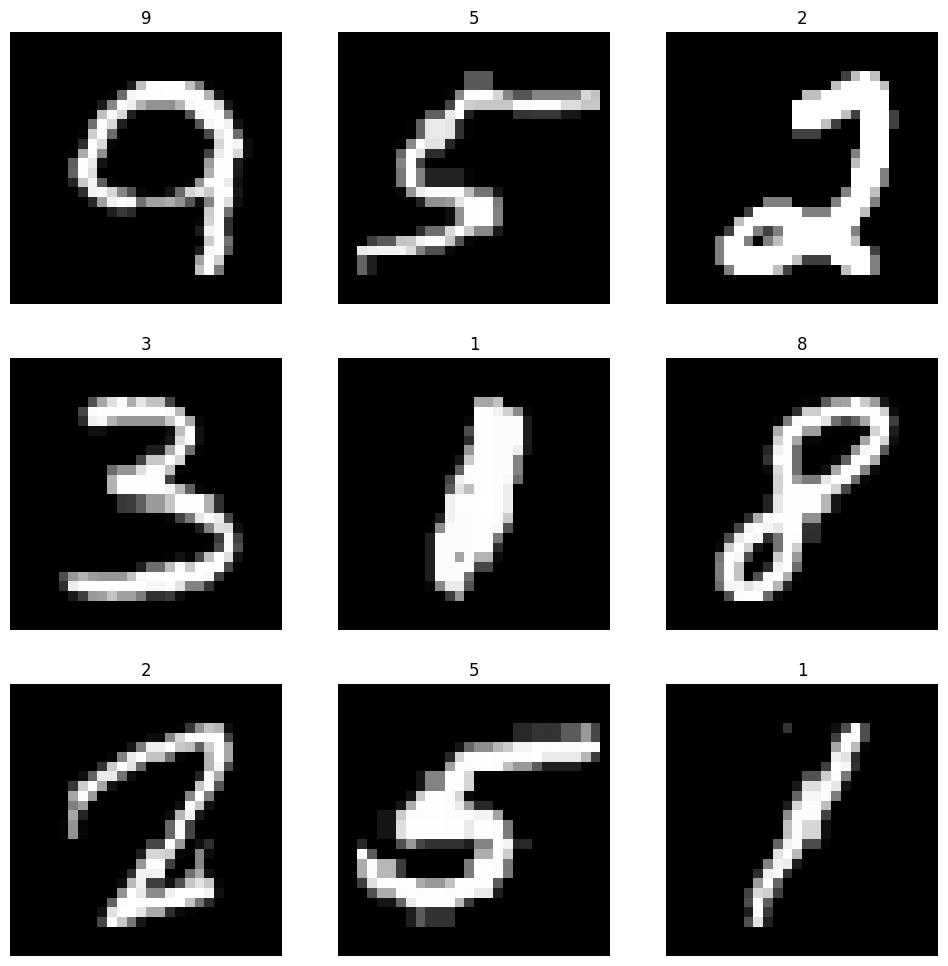

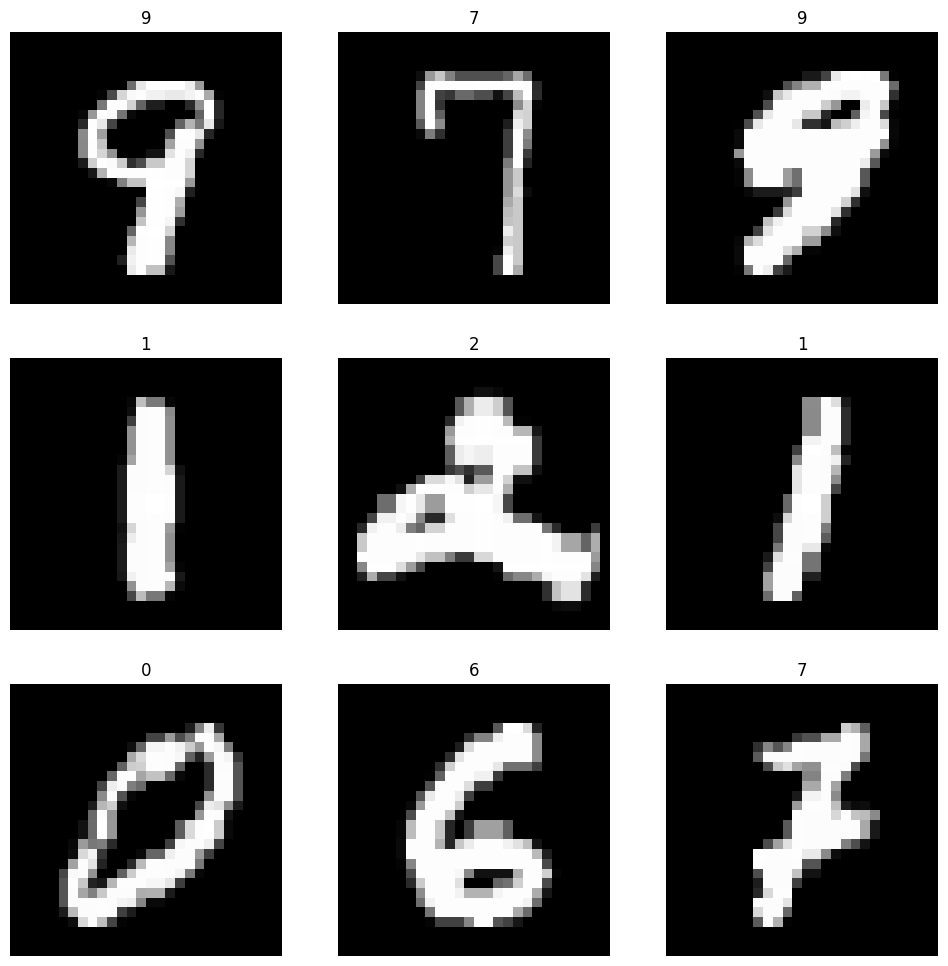

Training data shape: (192000, 28, 28, 1) (192000,)
Validation data shape: (48000, 28, 28, 1) (48000,)
Test data shape: (60000, 28, 28, 1) (60000,)
batch_size: 16, epochs: 7, learning_rate: 0.0001


/usr/local/lib/python3.10/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                      │ (None, 26, 26, 32)          │             320 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d (MaxPooling2D)         │ (None, 13, 13, 32)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_1 (Conv2D)                    │ (None, 11, 11, 64)          │          18,496 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_1 (MaxPooling2D)       │ (None, 5, 5, 64)            │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 1600)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 10)                  │          16,010 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 34,826 (136.04 KB)

 Trainable params: 34,826 (136.04 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/7
12000/12000 ━━━━━━━━━━━━━━━━━━━━ 35s 3ms/step - accuracy: 0.8848 - loss: 0.4502 - val_accuracy: 0.9690 - val_loss: 0.1191
Epoch 2/7
12000/12000 ━━━━━━━━━━━━━━━━━━━━ 33s 3ms/step - accuracy: 0.9737 - loss: 0.0969 - val_accuracy: 0.9789 - val_loss: 0.0801
Epoch 3/7
12000/12000 ━━━━━━━━━━━━━━━━━━━━ 41s 3ms/step - accuracy: 0.9798 - loss: 0.0747 - val_accuracy: 0.9830 - val_loss: 0.0677
Epoch 4/7
12000/12000 ━━━━━━━━━━━━━━━━━━━━ 42s 3ms/step - accuracy: 0.9832 - loss: 0.0641 - val_accuracy: 0.9829 - val_loss: 0.0673
Epoch 5/7
12000/12000 ━━━━━━━━━━━━━━━━━━━━ 39s 3ms/step - accuracy: 0.9856 - loss: 0.0560 - val_accuracy: 0.9855 - val_loss: 0.0585
Epoch 6/7
12000/12000 ━━━━━━━━━━━━━━━━━━━━ 41s 3ms/step - accuracy: 0.9875 - loss: 0.0488 - val_accuracy: 0.9864 - val_loss: 0.0543
Epoch 7/7
12000/12000 ━━━━━━━━━━━━━━━━━━━━ 41s 3ms/step - accuracy: 0.9885 - loss: 0.0449 - val_accuracy: 0.9882 - val_loss: 0.0508
Single Digits Train loss: 0.041658222675323486
Single Digits Train accuracy:

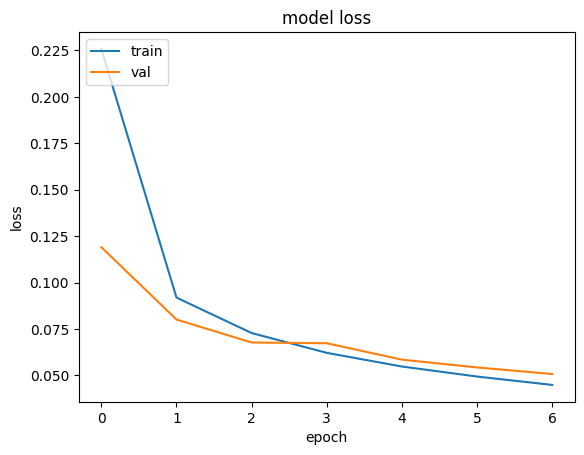

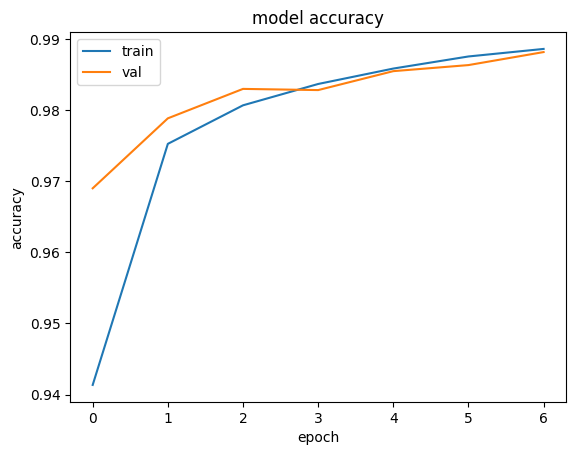

Single Digits Best Hyperparameters (CNN): {'batch_size': 16, 'epochs': 7, 'learning_rate': 0.0001}
Single Digits Best Loss Score (CNN): 0.050762709230184555


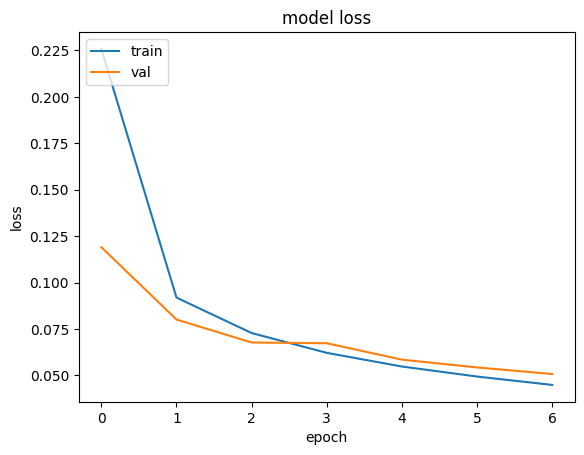

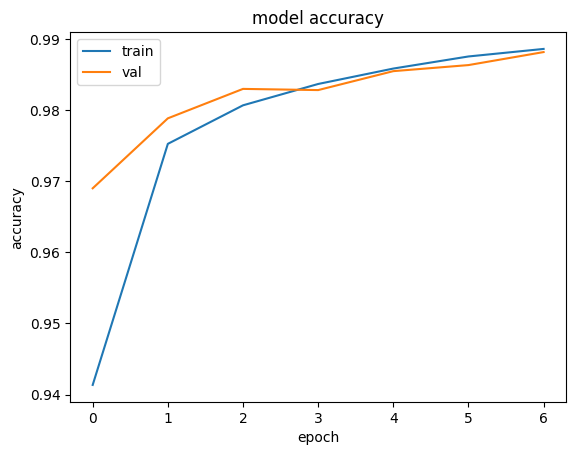

Single Digits Test loss: 0.04659894481301308
Single Digits Test accuracy: 0.9884999990463257
Classification Report:
              precision    recall  f1-score   support

         001     0.0000    0.0000    0.0000         0
         002     1.0000    0.9900    0.9950       100
         003     1.0000    0.9800    0.9899       100
         004     0.0000    0.0000    0.0000         0
         006     0.0000    0.0000    0.0000         0
         007     0.0000    0.0000    0.0000         0
         008     1.0000    0.9800    0.9899       100
         009     0.0000    0.0000    0.0000         0
         010     0.0000    0.0000    0.0000         0
         011     0.0000    0.0000    0.0000         0
         014     1.0000    0.9900    0.9950       100
         015     0.0000    0.0000    0.0000         0
         016     0.9899    0.9800    0.9849       100
         017     0.9802    0.9900    0.9851       100
         018     0.0000    0.0000    0.0000         0
         021     0.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


[[  0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0 

In [ ]:
#TASK-3 CNN with 3 distinct digits specific hyperparams
import tensorflow as tf
import tensorflow.keras as keras
from tensorflow.keras import layers, models
from sklearn.metrics import classification_report, confusion_matrix
import cv2
##### SPLIT FUNCTION AND ITS DEMONSTRATION #####
digit_shape = (28, 28)
def crop_digits(img_path: str = None, im = None):
    #if im is None:
    #    im = cv2.imread(img_path)

    #gray = cv2.cvtColor(im, cv2.COLOR_BGR2GRAY)
    blur = cv2.GaussianBlur(img_path, (5, 5), 0)
    thresh = cv2.threshold(blur, 90, 255, cv2.THRESH_BINARY+cv2.THRESH_OTSU)[1]
    contours, hierarchy = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    digits = []
    rect = img_path.copy()
    for cnt in contours:
        x, y, w, h = cv2.boundingRect(cnt)

        x = max(x - 3, 0)
        y = max(y - 3, 0)
        w += 6
        h += 6

        del_x = int(w / 2)
        del_y = int(h / 2)
        center_x = x + del_x
        center_y = y + del_y

        lu_corner = (max(center_x - del_y, 0), y)
        rd_corner = (max(center_x + del_y, 0), y + h)

        rect = cv2.rectangle(rect, lu_corner, rd_corner, (255, 0, 0), 2) #rectangle

        cropped = img_path[lu_corner[1]:rd_corner[1], lu_corner[0]:rd_corner[0]]
        digits.append(cropped)

    def filter_and_sort_digits(digits, contours):
        sizes = []
        for digit in digits:
            size = digit.shape[0] * digit.shape[1]
            sizes.append(size)
        avg_size = sum(sizes) / len(sizes)
        deviations = [abs(size - avg_size) for size in sizes]

        indices = np.argsort(deviations)[0:3]
        digits = [digits[i] for i in indices]
        contours = [cv2.boundingRect(contours[i]) for i in indices]

        xs = [contour[0] for contour in contours]
        indices = np.argsort(xs) #get highest likelihood digit
        digits = [digits[i] for i in indices]

        while len(digits) < 3:
            digits.append(digits[0])
        return digits

    digits = filter_and_sort_digits(digits, contours) #get highest likelihood digits
    digits = [cv2.resize(digit, digit_shape, interpolation = cv2.INTER_NEAREST) for digit in digits] #resize to 28,28

    return digits, contours, rect

print(f"Label: {train_labels[0]}")
print(train_labels[0][0])
print(train_labels[0][1])
print(train_labels[0][2])

fig = plt.figure(figsize=(8, 8))
cols, rows = 3, 3

digits, contours, rect = crop_digits(train_images[0])

fig.add_subplot(rows, cols, 1)
plt.axis("off")
plt.imshow(rect.squeeze(), cmap="gray")
for i in range(len(digits)):
    img = digits[i]
    print(train_labels[0][i])
    fig.add_subplot(rows, cols, i+2)
    plt.axis("off")
    plt.imshow(img.squeeze(), cmap="gray")
    print(f"crop shape: {img.shape}")
plt.show()


##### SPLIT ALL DATA TO DIGITS #####
def load_digits(images, labels):
  all_digits = []
  all_labels = []
  for i in range(len(images)):
    digits, contours, rect = crop_digits(images[i])
    for j in range(len(digits)):
      all_digits.append(digits[j])
      all_labels.append(labels[i][j])
  return np.array(all_digits), np.array(all_labels)

train_images, train_labels = load_digits(train_images, train_labels)
test_images_digits, test_labels_digits = load_digits(test_images, test_labels)
val_images, val_labels = load_digits(val_images, val_labels)
print(len(train_images))
print(len(test_images_digits))
print(len(val_images))
print(train_images.shape)
print(test_images_digits.shape)
print(val_images.shape)
print(train_labels.shape)
print(test_labels_digits.shape)
print(val_labels.shape)

print(len(np.unique(train_labels)))
print(len(np.unique(test_labels_digits)))
print(len(np.unique(val_labels)))

def visualize(images, labels):
  np.random.seed(42)
  random_indices = np.random.choice(len(images), size=9, replace=False)
  random_images = images[random_indices]
  random_labels = labels[random_indices]

  fig, axes = plt.subplots(3, 3, figsize=(12, 12))
  for i, (img, label) in enumerate(zip(random_images, random_labels)):
      ax = axes[i // 3, i % 3]
      ax.imshow(img, cmap='gray')
      ax.set_title(label)
      ax.axis('off')
  plt.show()

visualize(train_images, train_labels)
visualize(test_images_digits, test_labels_digits)
visualize(val_images, val_labels)


##### TRAIN CNN #####
train_images = train_images / 255.0
val_images = val_images / 255.0
test_images_digits = test_images_digits / 255.0

train_images = train_images.reshape((train_images.shape[0], 28, 28, 1))
val_images = val_images.reshape((val_images.shape[0], 28, 28, 1))
test_images_digits = test_images_digits.reshape((test_images_digits.shape[0], 28, 28, 1))

print('Training data shape:', train_images.shape, train_labels.shape)
print('Validation data shape:', val_images.shape, val_labels.shape)
print('Test data shape:', test_images_digits.shape, test_labels_digits.shape)

train_labels = tf.keras.utils.to_categorical(train_labels, num_classes=10)
val_labels = tf.keras.utils.to_categorical(val_labels, num_classes=10)
test_labels_digits = tf.keras.utils.to_categorical(test_labels_digits, num_classes=10)




param_grid_cnn = {
    'batch_size': [16],
    'epochs': [7 ],
    'learning_rate': [1e-4 ]
    #'batch_size': [32],
    #'epochs': [3],
    #'learning_rate': [1e-4],
}

best_params_cnn = None
best_loss_cnn = 999
for batch_size in param_grid_cnn['batch_size']:
    for epochs in param_grid_cnn['epochs']:
        for learning_rate in param_grid_cnn['learning_rate']:
          print(f"batch_size: {batch_size}, epochs: {epochs}, learning_rate: {learning_rate}")
          model = models.Sequential()
          model.add(layers.Conv2D(32, (3, 3), activation='relu', input_shape=(28, 28, 1)))
          #model.add(layers.BatchNormalization()) #### FOR TASK 4
          model.add(layers.MaxPooling2D((2, 2)))
          model.add(layers.Conv2D(64, (3, 3), activation='relu'))
          #model.add(layers.BatchNormalization()) #### FOR TASK 4
          model.add(layers.MaxPooling2D((2, 2)))
          #model.add(layers.Conv2D(128, (3, 3), activation='relu')) #### FOR TASK 4
          #model.add(layers.BatchNormalization()) #### FOR TASK 4
          #model.add(layers.MaxPooling2D((2, 2))) #### FOR TASK 4
          model.add(layers.Flatten())
          # model.add(layers.Dropout(0.5)) #0.7 #### FOR TASK 4
          model.add(layers.Dense(10, activation='softmax'))
          model.summary()
          model.compile(loss="categorical_crossentropy", optimizer=keras.optimizers.Adam(learning_rate=learning_rate), metrics=["accuracy"])

          history = model.fit(train_images, train_labels, batch_size=batch_size, epochs=epochs, validation_data=(val_images, val_labels))

          score_train = model.evaluate(train_images, train_labels, verbose=0)
          print("Single Digits Train loss:", score_train[0])
          print("Single Digits Train accuracy:", score_train[1])
          score_val = model.evaluate(val_images, val_labels, verbose=0)
          print("Single Digits Validation loss:", score_val[0])
          print("Single Digits Validation accuracy:", score_val[1])
          plt.plot(history.history['loss'])
          plt.plot(history.history['val_loss'])
          plt.title('model loss')
          plt.ylabel('loss')
          plt.xlabel('epoch')
          plt.legend(['train', 'val'], loc='upper left')
          plt.show()

          plt.plot(history.history['accuracy'])
          plt.plot(history.history['val_accuracy'])
          plt.title('model accuracy')
          plt.ylabel('accuracy')
          plt.xlabel('epoch')
          plt.legend(['train', 'val'], loc='upper left')
          plt.show()
          if score_val[0] < best_loss_cnn:
                  best_loss_cnn = score_val[0]
                  best_params_cnn = {'batch_size': batch_size, 'epochs': epochs, 'learning_rate':learning_rate}

                  model.save('best_model.h5')


print("Single Digits Best Hyperparameters (CNN):", best_params_cnn)
print("Single Digits Best Loss Score (CNN):", best_loss_cnn)
model = tf.keras.models.load_model('best_model.h5')
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

score = model.evaluate(test_images_digits, test_labels_digits, verbose=0)
print("Single Digits Test loss:", score[0])
print("Single Digits Test accuracy:", score[1])

final_test_predictions = []
for i in range(len(test_images)):
  img = test_images[i]
  concat = ""
  for j in range(0,3):
    img_digit = test_images_digits[3*i + j]
    #prediction = model.predict_on_batch([img_digit])
    prediction = model.predict_on_batch(np.expand_dims(img_digit, axis=0))
    prediction = np.argmax(prediction)
    #print(prediction, test_labels[i])
    concat = concat + str(prediction)
  #print(concat, test_labels[i])
  final_test_predictions.append(concat)

np.set_printoptions(threshold=np.inf)

print("Classification Report:")
print(classification_report(test_labels, final_test_predictions, digits = 4))

print("\nConfusion Matrix:")
print(confusion_matrix(test_labels, final_test_predictions))



Label: 000
0
0
0
0
crop shape: (28, 28)
0
crop shape: (28, 28)
0
crop shape: (28, 28)


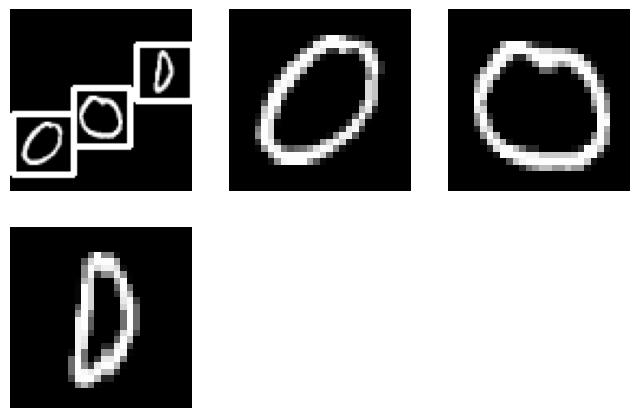

192000
60000
48000
(192000, 28, 28)
(60000, 28, 28)
(48000, 28, 28)
(192000,)
(60000,)
(48000,)
10
10
10


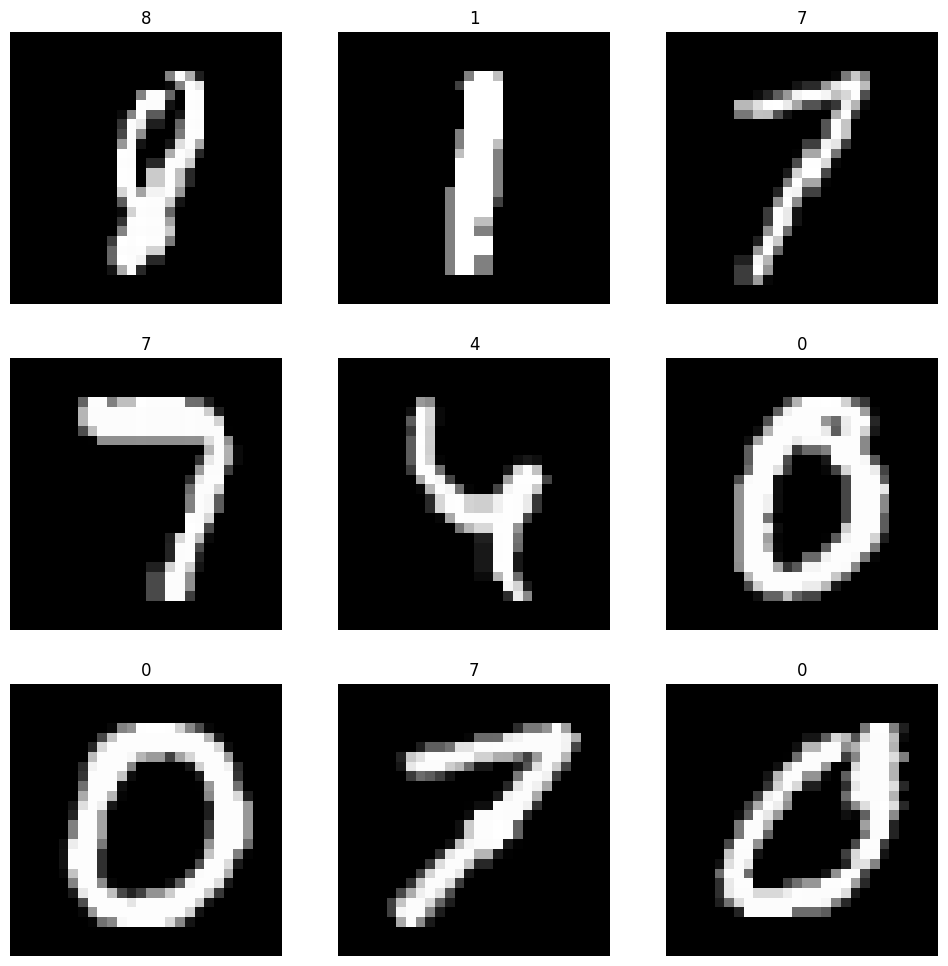

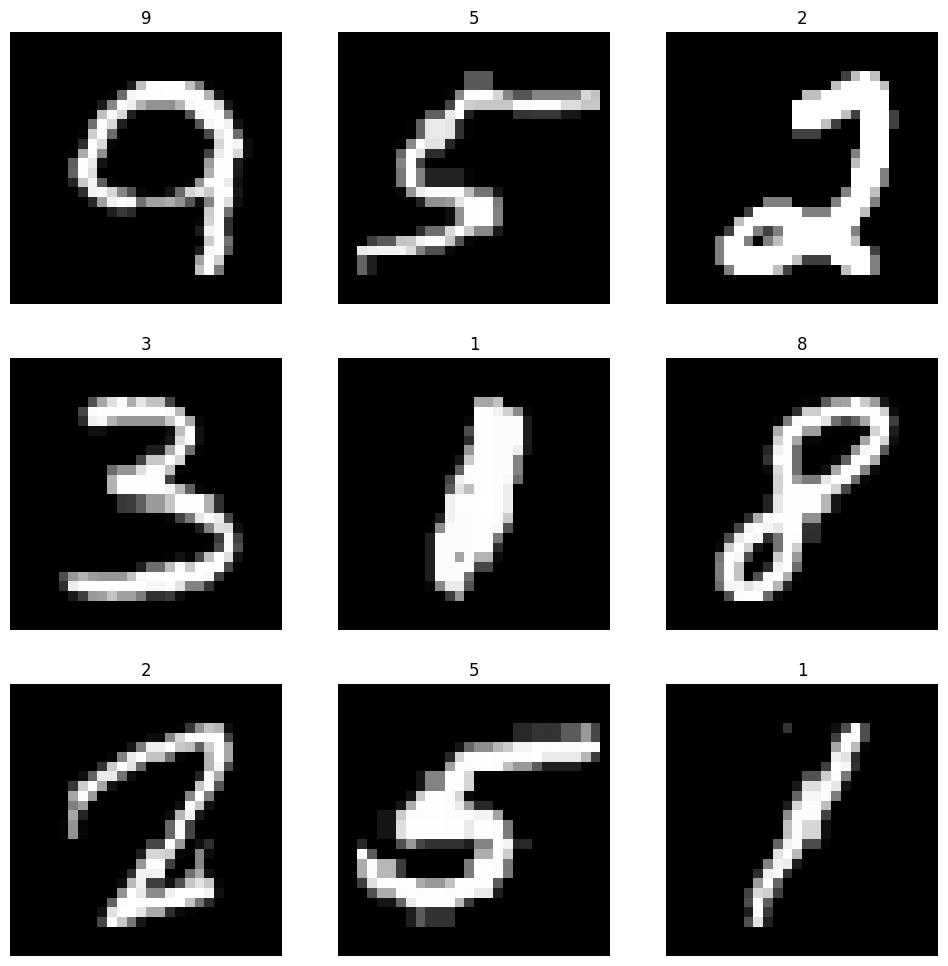

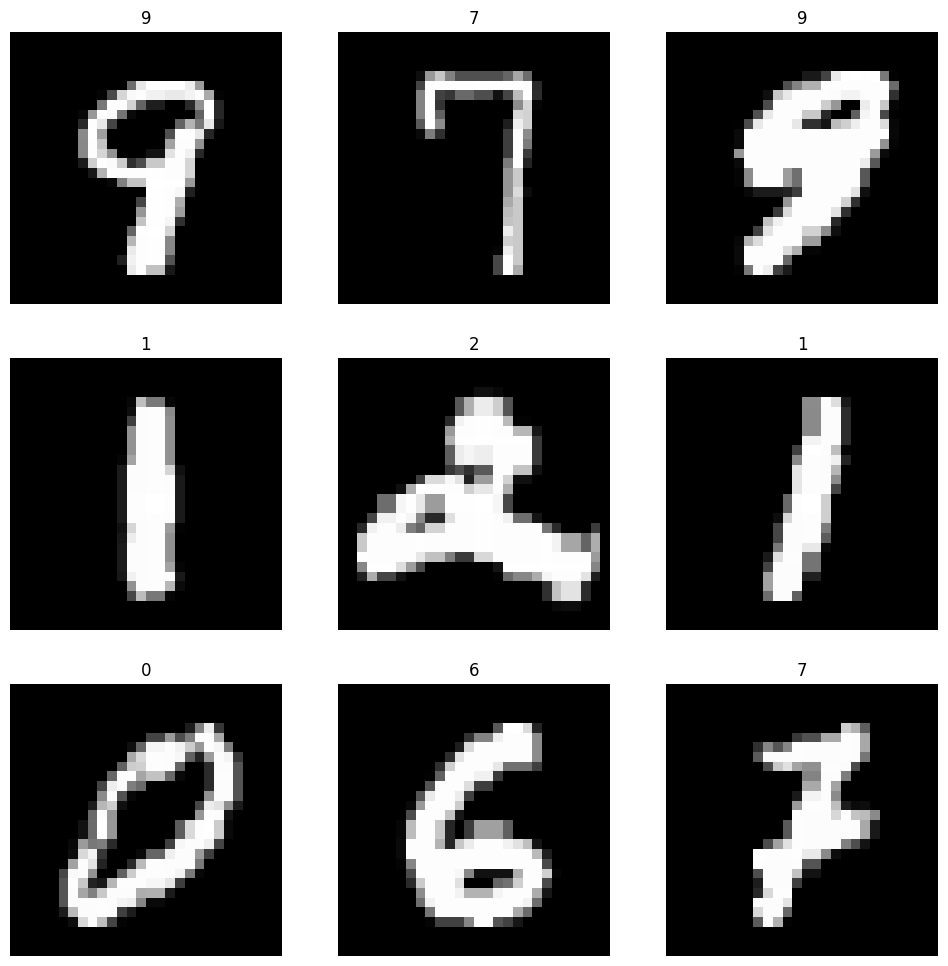

Training data shape: (192000, 28, 28, 1) (192000,)
Validation data shape: (48000, 28, 28, 1) (48000,)
Test data shape: (60000, 28, 28, 1) (60000,)
batch_size: 16, epochs: 7, learning_rate: 0.0001


/usr/local/lib/python3.10/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d_4 (Conv2D)                    │ (None, 26, 26, 32)          │             320 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_4 (MaxPooling2D)       │ (None, 13, 13, 32)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_5 (Conv2D)                    │ (None, 11, 11, 64)          │          18,496 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_5 (MaxPooling2D)       │ (None, 5, 5, 64)            │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_2 (Flatten)                  │ (None, 1600)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 10)                  │          16,010 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 34,826 (136.04 KB)

 Trainable params: 34,826 (136.04 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/7
12000/12000 ━━━━━━━━━━━━━━━━━━━━ 26s 2ms/step - accuracy: 0.8761 - loss: 0.4560 - val_accuracy: 0.9722 - val_loss: 0.1099
Epoch 2/7
12000/12000 ━━━━━━━━━━━━━━━━━━━━ 23s 2ms/step - accuracy: 0.9733 - loss: 0.1006 - val_accuracy: 0.9795 - val_loss: 0.0805
Epoch 3/7
12000/12000 ━━━━━━━━━━━━━━━━━━━━ 23s 2ms/step - accuracy: 0.9787 - loss: 0.0764 - val_accuracy: 0.9822 - val_loss: 0.0706
Epoch 4/7
12000/12000 ━━━━━━━━━━━━━━━━━━━━ 23s 2ms/step - accuracy: 0.9828 - loss: 0.0629 - val_accuracy: 0.9846 - val_loss: 0.0630
Epoch 5/7
12000/12000 ━━━━━━━━━━━━━━━━━━━━ 23s 2ms/step - accuracy: 0.9849 - loss: 0.0577 - val_accuracy: 0.9861 - val_loss: 0.0572
Epoch 6/7
12000/12000 ━━━━━━━━━━━━━━━━━━━━ 23s 2ms/step - accuracy: 0.9872 - loss: 0.0496 - val_accuracy: 0.9880 - val_loss: 0.0513
Epoch 7/7
12000/12000 ━━━━━━━━━━━━━━━━━━━━ 24s 2ms/step - accuracy: 0.9884 - loss: 0.0453 - val_accuracy: 0.9893 - val_loss: 0.0478
Single Digits Train loss: 0.04012531414628029
Single Digits Train accuracy: 

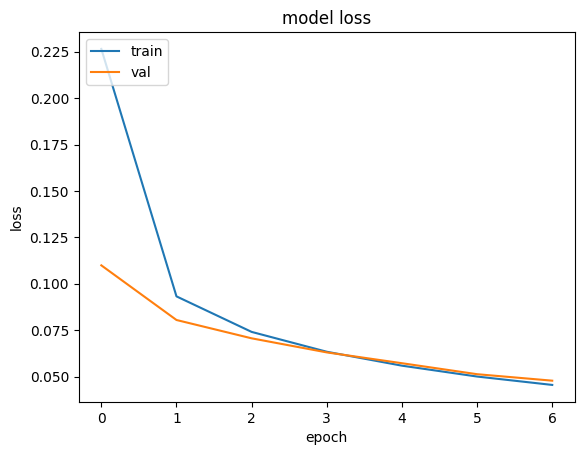

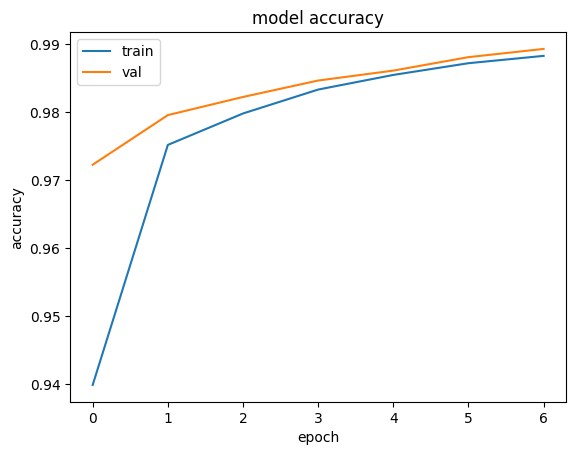

Single Digits Best Hyperparameters (CNN): {'batch_size': 16, 'epochs': 7, 'learning_rate': 0.0001}
Single Digits Best accufracy Score (CNN): -1


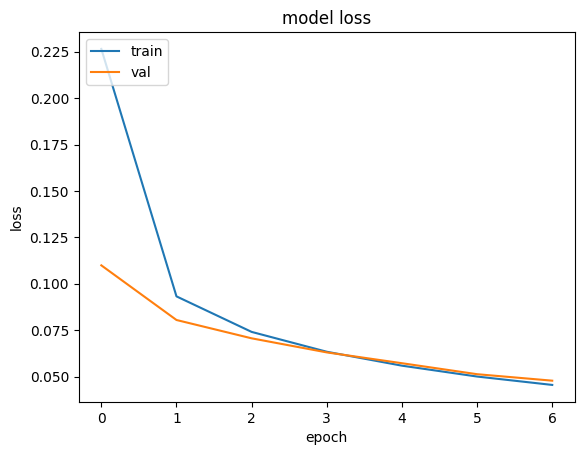

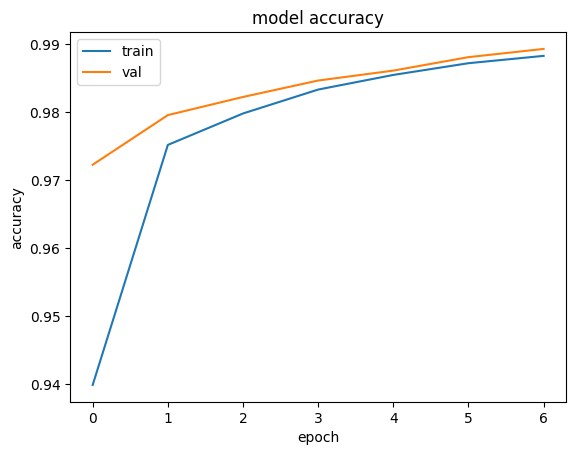

Streaming output truncated to the last 5000 lines.
755 755
755 755
755 755
755 755
755 755
785 755
755 755
755 755
755 755
755 755
755 755
753 755
755 755
755 755
755 755
755 755
755 755
755 755
755 755
755 755
755 755
755 755
755 755
755 755
755 755
754 755
755 755
755 755
755 755
755 755
755 755
755 755
755 755
755 755
755 755
755 755
755 755
755 755
755 755
755 755
755 755
755 755
755 755
755 755
755 755
755 755
755 755
755 755
755 755
455 755
755 755
755 755
755 755
755 755
755 755
755 755
755 755
755 755
755 755
755 755
755 755
755 755
755 755
755 755
755 755
755 755
755 755
755 755
755 755
755 755
755 755
755 755
755 755
755 755
755 755
755 755
755 755
755 755
756 755
755 755
755 755
755 755
755 755
755 755
755 755
755 755
755 755
755 755
755 755
755 755
755 755
755 755
755 755
755 755
755 755
755 755
755 755
755 755
755 755
759 759
759 759
759 759
759 759
759 759
759 759
759 759
759 759
759 759
759 759
759 759
759 759
759 759
759 759
759 759
759 759
359 759
759 759
759 759
759 7

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Streaming output truncated to the last 5000 lines.
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0

In [ ]:
#TASK-3 CNN with 3 distinct digits specific hyperparams
import tensorflow as tf####################################################################################################################################################################################################################################################################################
import tensorflow.keras as keras
from tensorflow.keras import layers, models
from sklearn.metrics import classification_report, confusion_matrix
import cv2
##### SPLIT FUNCTION AND ITS DEMONSTRATION #####
digit_shape = (28, 28)
def crop_digits(img_path: str = None, im = None):
    #if im is None:
    #    im = cv2.imread(img_path)

    #gray = cv2.cvtColor(im, cv2.COLOR_BGR2GRAY)
    blur = cv2.GaussianBlur(img_path, (5, 5), 0)
    thresh = cv2.threshold(blur, 90, 255, cv2.THRESH_BINARY+cv2.THRESH_OTSU)[1]
    contours, hierarchy = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    digits = []
    rect = img_path.copy()
    for cnt in contours:
        x, y, w, h = cv2.boundingRect(cnt)

        x = max(x - 3, 0)
        y = max(y - 3, 0)
        w += 6
        h += 6

        del_x = int(w / 2)
        del_y = int(h / 2)
        center_x = x + del_x
        center_y = y + del_y

        lu_corner = (max(center_x - del_y, 0), y)
        rd_corner = (max(center_x + del_y, 0), y + h)

        rect = cv2.rectangle(rect, lu_corner, rd_corner, (255, 0, 0), 2) #rectangle

        cropped = img_path[lu_corner[1]:rd_corner[1], lu_corner[0]:rd_corner[0]]
        digits.append(cropped)

    def filter_and_sort_digits(digits, contours):
        sizes = []
        for digit in digits:
            size = digit.shape[0] * digit.shape[1]
            sizes.append(size)
        avg_size = sum(sizes) / len(sizes)
        deviations = [abs(size - avg_size) for size in sizes]

        indices = np.argsort(deviations)[0:3]
        digits = [digits[i] for i in indices]
        contours = [cv2.boundingRect(contours[i]) for i in indices]

        xs = [contour[0] for contour in contours]
        indices = np.argsort(xs) #get highest likelihood digit
        digits = [digits[i] for i in indices]

        while len(digits) < 3:
            digits.append(digits[0])
        return digits

    digits = filter_and_sort_digits(digits, contours) #get highest likelihood digits
    digits = [cv2.resize(digit, digit_shape, interpolation = cv2.INTER_NEAREST) for digit in digits] #resize to 28,28

    return digits, contours, rect

print(f"Label: {train_labels[0]}")
print(train_labels[0][0])
print(train_labels[0][1])
print(train_labels[0][2])

fig = plt.figure(figsize=(8, 8))
cols, rows = 3, 3

digits, contours, rect = crop_digits(train_images[0])

fig.add_subplot(rows, cols, 1)
plt.axis("off")
plt.imshow(rect.squeeze(), cmap="gray")
for i in range(len(digits)):
    img = digits[i]
    print(train_labels[0][i])
    fig.add_subplot(rows, cols, i+2)
    plt.axis("off")
    plt.imshow(img.squeeze(), cmap="gray")
    print(f"crop shape: {img.shape}")
plt.show()


##### SPLIT ALL DATA TO DIGITS #####
def load_digits(images, labels):
  all_digits = []
  all_labels = []
  for i in range(len(images)):
    digits, contours, rect = crop_digits(images[i])
    for j in range(len(digits)):
      all_digits.append(digits[j])
      all_labels.append(labels[i][j])
  return np.array(all_digits), np.array(all_labels)

train_images, train_labels = load_digits(train_images, train_labels)
test_images_digits, test_labels_digits = load_digits(test_images, test_labels)
val_images, val_labels = load_digits(val_images, val_labels)
print(len(train_images))
print(len(test_images_digits))
print(len(val_images))
print(train_images.shape)
print(test_images_digits.shape)
print(val_images.shape)
print(train_labels.shape)
print(test_labels_digits.shape)
print(val_labels.shape)

print(len(np.unique(train_labels)))
print(len(np.unique(test_labels_digits)))
print(len(np.unique(val_labels)))

def visualize(images, labels):
  np.random.seed(42)
  random_indices = np.random.choice(len(images), size=9, replace=False)
  random_images = images[random_indices]
  random_labels = labels[random_indices]

  fig, axes = plt.subplots(3, 3, figsize=(12, 12))
  for i, (img, label) in enumerate(zip(random_images, random_labels)):
      ax = axes[i // 3, i % 3]
      ax.imshow(img, cmap='gray')
      ax.set_title(label)
      ax.axis('off')
  plt.show()

visualize(train_images, train_labels)
visualize(test_images_digits, test_labels_digits)
visualize(val_images, val_labels)


##### TRAIN CNN #####
train_images = train_images / 255.0
val_images = val_images / 255.0
test_images_digits = test_images_digits / 255.0

train_images = train_images.reshape((train_images.shape[0], 28, 28, 1))
val_images = val_images.reshape((val_images.shape[0], 28, 28, 1))
test_images_digits = test_images_digits.reshape((test_images_digits.shape[0], 28, 28, 1))

print('Training data shape:', train_images.shape, train_labels.shape)
print('Validation data shape:', val_images.shape, val_labels.shape)
print('Test data shape:', test_images_digits.shape, test_labels_digits.shape)

train_labels = tf.keras.utils.to_categorical(train_labels, num_classes=10)
val_labels = tf.keras.utils.to_categorical(val_labels, num_classes=10)
test_labels_digits = tf.keras.utils.to_categorical(test_labels_digits, num_classes=10)




param_grid_cnn = {
    'batch_size': [16],
    'epochs': [7 ],
    'learning_rate': [1e-4 ]
    #'batch_size': [32],
    #'epochs': [3],
    #'learning_rate': [1e-4],
}

best_params_cnn = None
best_accuracy_cnn = -1
for batch_size in param_grid_cnn['batch_size']:
    for epochs in param_grid_cnn['epochs']:
        for learning_rate in param_grid_cnn['learning_rate']:
          print(f"batch_size: {batch_size}, epochs: {epochs}, learning_rate: {learning_rate}")
          model = models.Sequential()
          model.add(layers.Conv2D(32, (3, 3), activation='relu', input_shape=(28, 28, 1)))
          #model.add(layers.BatchNormalization()) #### FOR TASK 4
          model.add(layers.MaxPooling2D((2, 2)))
          model.add(layers.Conv2D(64, (3, 3), activation='relu'))
          #model.add(layers.BatchNormalization()) #### FOR TASK 4
          model.add(layers.MaxPooling2D((2, 2)))
          #model.add(layers.Conv2D(128, (3, 3), activation='relu')) #### FOR TASK 4
          #model.add(layers.BatchNormalization()) #### FOR TASK 4
          #model.add(layers.MaxPooling2D((2, 2))) #### FOR TASK 4
          model.add(layers.Flatten())
          # model.add(layers.Dropout(0.5)) #0.7 #### FOR TASK 4
          model.add(layers.Dense(10, activation='softmax'))
          model.summary()
          model.compile(loss="categorical_crossentropy", optimizer=keras.optimizers.Adam(learning_rate=learning_rate), metrics=["accuracy"])

          history = model.fit(train_images, train_labels, batch_size=batch_size, epochs=epochs, validation_data=(val_images, val_labels))

          score_train = model.evaluate(train_images, train_labels, verbose=0)
          print("Single Digits Train loss:", score_train[0])
          print("Single Digits Train accuracy:", score_train[1])
          score_val = model.evaluate(val_images, val_labels, verbose=0)
          print("Single Digits Validation loss:", score_val[0])
          print("Single Digits Validation accuracy:", score_val[1])
          plt.plot(history.history['loss'])
          plt.plot(history.history['val_loss'])
          plt.title('model loss')
          plt.ylabel('loss')
          plt.xlabel('epoch')
          plt.legend(['train', 'val'], loc='upper left')
          plt.show()

          plt.plot(history.history['accuracy'])
          plt.plot(history.history['val_accuracy'])
          plt.title('model accuracy')
          plt.ylabel('accuracy')
          plt.xlabel('epoch')
          plt.legend(['train', 'val'], loc='upper left')
          plt.show()
          if score_val[1] > best_accuracy_cnn:
                  best_accuracy_cnn = score_val[1]
                  best_params_cnn = {'batch_size': batch_size, 'epochs': epochs, 'learning_rate':learning_rate}

                  model.save('best_model.h5')


print("Single Digits Best Hyperparameters (CNN):", best_params_cnn)
print("Single Digits Best accufracy Score (CNN):", best_accuracy_cnn)
model = tf.keras.models.load_model('best_model.h5')
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

score = model.evaluate(test_images_digits, test_labels_digits, verbose=0)
print("Single Digits Test loss:", score[0])
print("Single Digits Test accuracy:", score[1])

final_test_predictions = []
for i in range(len(test_images)):
  img = test_images[i]
  concat = ""
  for j in range(0,3):
    img_digit = test_images_digits[3*i + j]
    #prediction = model.predict_on_batch([img_digit])
    prediction = model.predict_on_batch(np.expand_dims(img_digit, axis=0))
    prediction = np.argmax(prediction)
    #print(prediction, test_labels[i])
    concat = concat + str(prediction)
  print(concat, test_labels[i])
  final_test_predictions.append(concat)

np.set_printoptions(threshold=np.inf)

print("Classification Report:")
print(classification_report(test_labels, final_test_predictions, digits = 4))

print("\nConfusion Matrix:")
print(confusion_matrix(test_labels, final_test_predictions))



In [ ]:
import os
if not os.path.exists('confusion_matrix.txt'):
    with open('confusion_matrix.txt', 'w') as f:
        pass  # Create an empty file


Label: 000
0
0
0
0
crop shape: (28, 28)
0
crop shape: (28, 28)
0
crop shape: (28, 28)


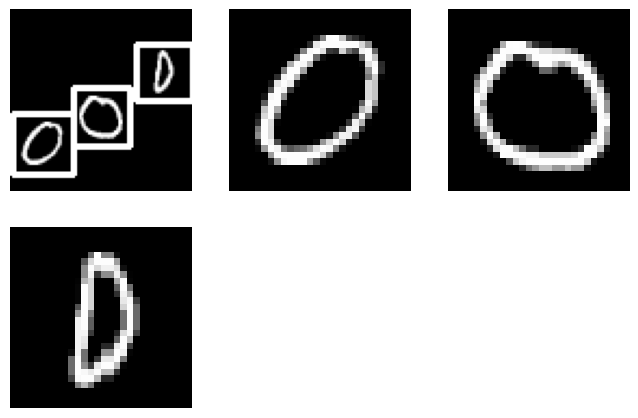

192000
60000
48000
(192000, 28, 28)
(60000, 28, 28)
(48000, 28, 28)
(192000,)
(60000,)
(48000,)
10
10
10


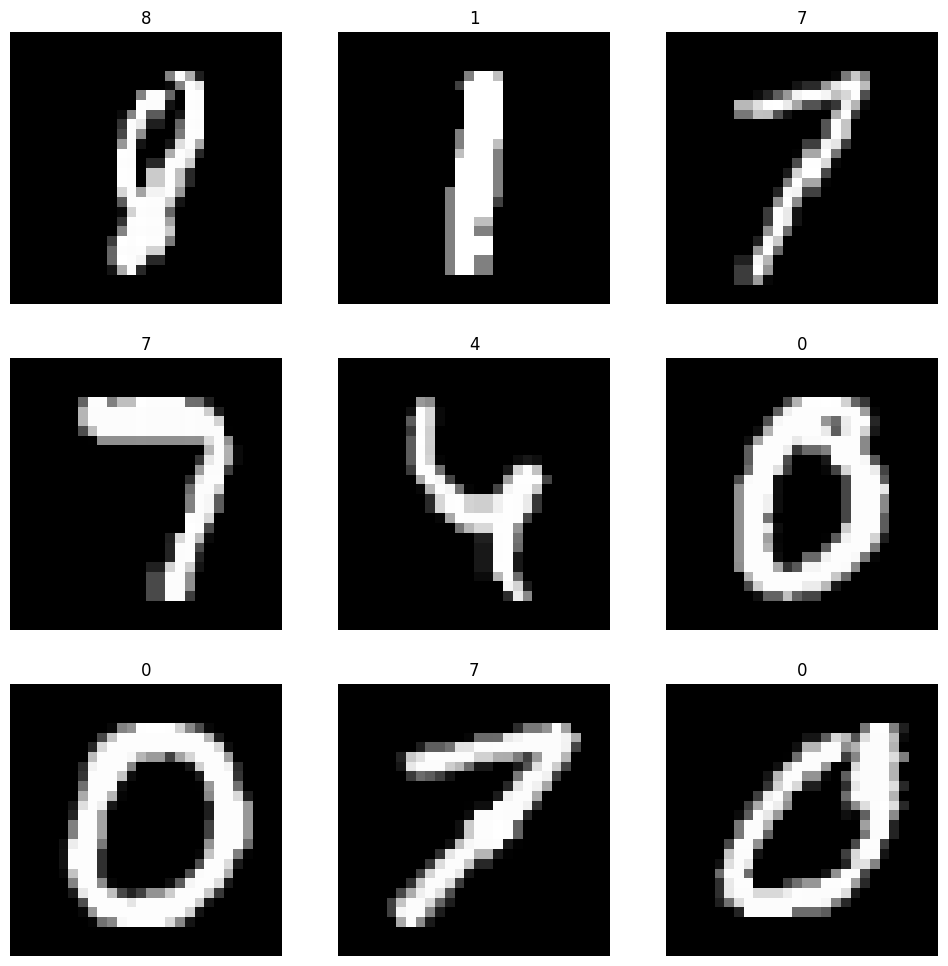

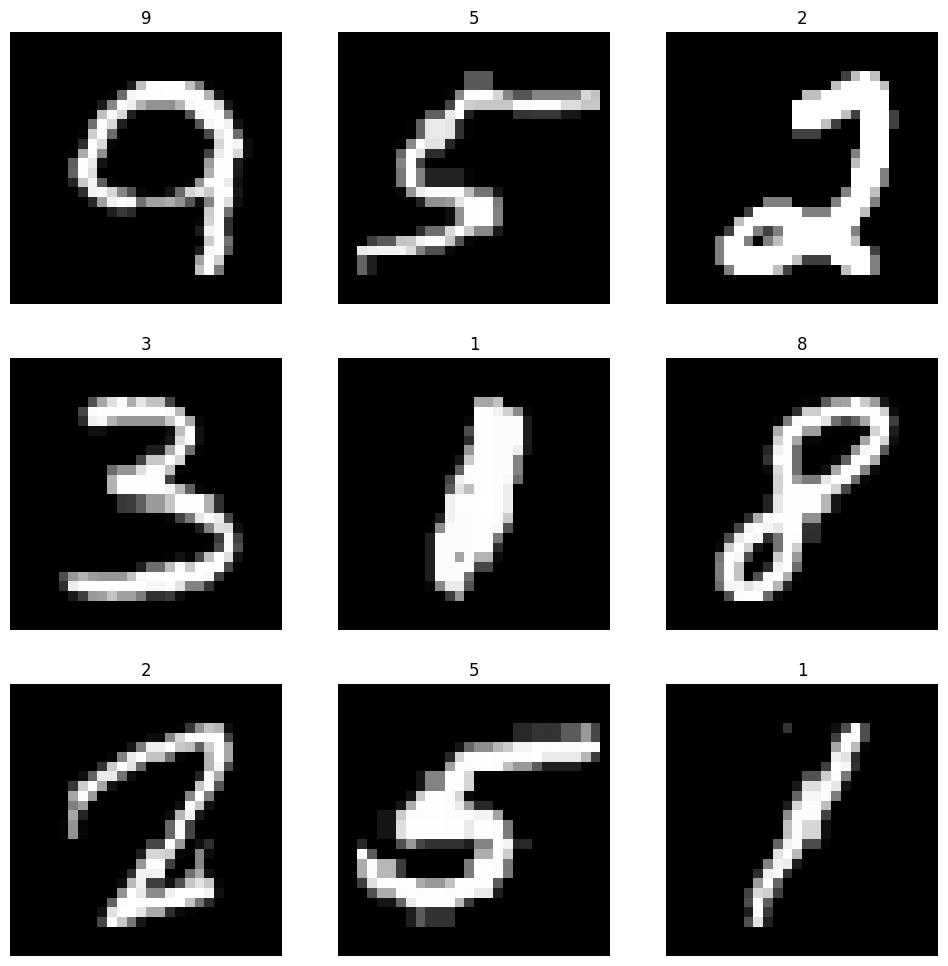

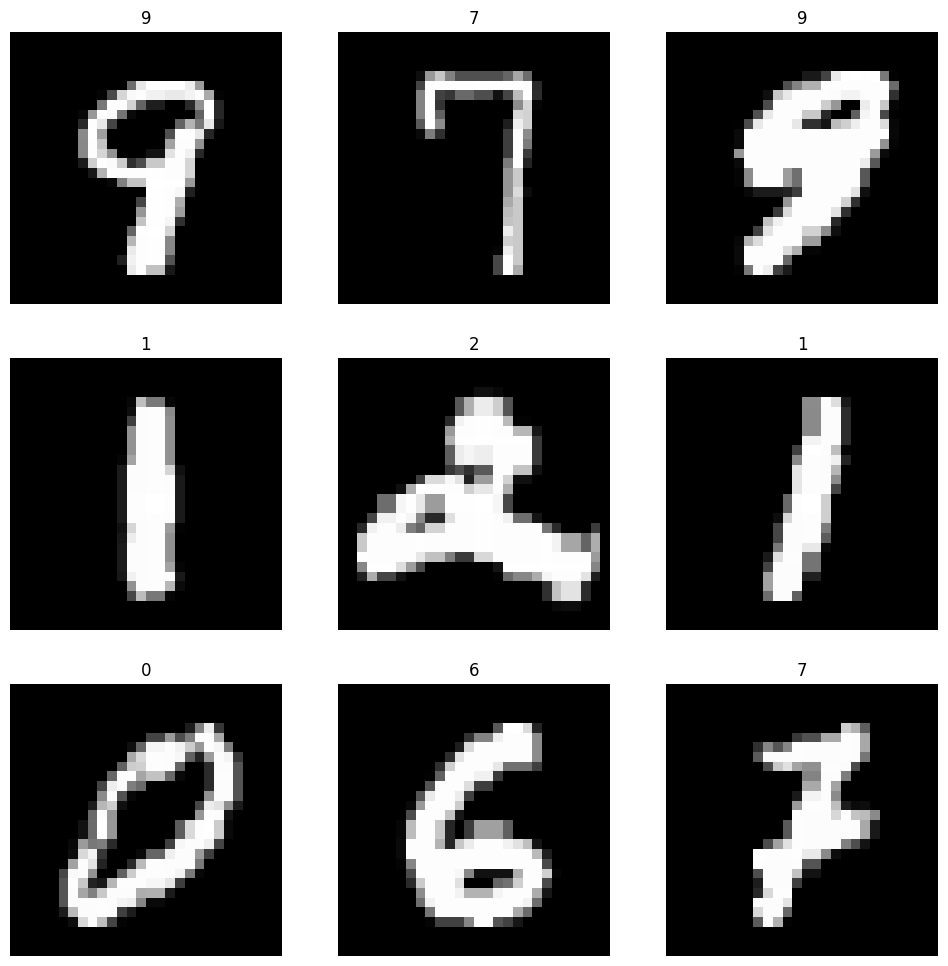

Training data shape: (192000, 28, 28, 1) (192000,)
Validation data shape: (48000, 28, 28, 1) (48000,)
Test data shape: (60000, 28, 28, 1) (60000,)


/usr/local/lib/python3.10/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                      │ (None, 26, 26, 32)          │             320 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d (MaxPooling2D)         │ (None, 13, 13, 32)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_1 (Conv2D)                    │ (None, 11, 11, 64)          │          18,496 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_1 (MaxPooling2D)       │ (None, 5, 5, 64)            │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 1600)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 10)                  │          16,010 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 34,826 (136.04 KB)

 Trainable params: 34,826 (136.04 KB)

 Non-trainable params: 0 (0.00 B)

6000/6000 ━━━━━━━━━━━━━━━━━━━━ 21s 3ms/step - accuracy: 0.9499 - loss: 0.1698 - val_accuracy: 0.9788 - val_loss: 0.0756
Single Digits Train loss: 0.06934192031621933
Single Digits Train accuracy: 0.9804896116256714
Single Digits Validation loss: 0.07561903446912766
Single Digits Validation accuracy: 0.9788333177566528
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 21s 3ms/step - accuracy: 0.9883 - loss: 0.0406 - val_accuracy: 0.9914 - val_loss: 0.0372
Single Digits Train loss: 0.026476221159100533
Single Digits Train accuracy: 0.9933645725250244
Single Digits Validation loss: 0.037179358303546906
Single Digits Validation accuracy: 0.9914166927337646
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 19s 3ms/step - accuracy: 0.9935 - loss: 0.0254 - val_accuracy: 0.9921 - val_loss: 0.0352
Single Digits Train loss: 0.02436728961765766
Single Digits Train accuracy: 0.9941874742507935
Single Digits Validation loss: 0.03522038832306862
Single Digits Validation accuracy: 0.9921249747276306
Epoch 1/3
6000/6000 ━━━━━━━━━━━━━━━━━━

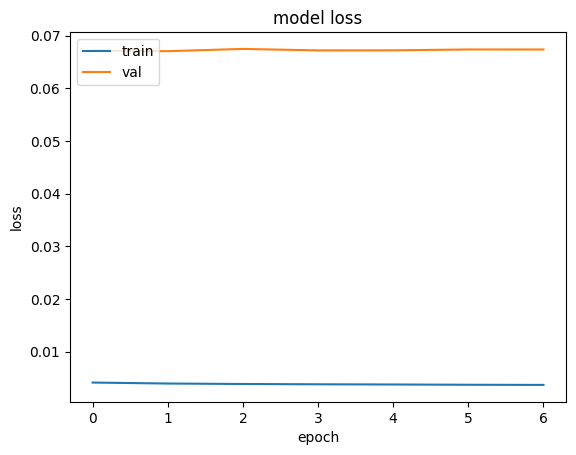

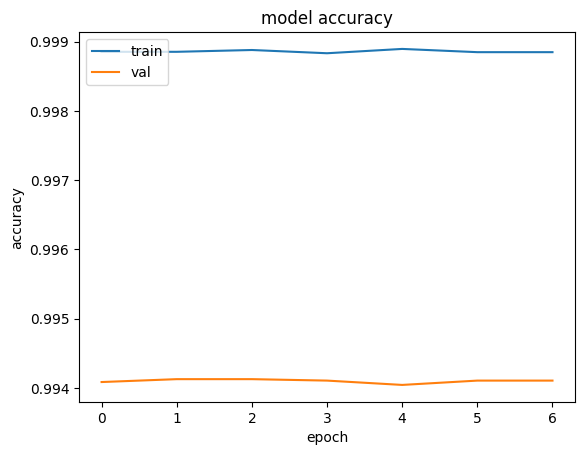

Single Digits Test loss: 0.053839050233364105
Single Digits Test accuracy: 0.9944166541099548
Classification Report:
              precision    recall  f1-score   support

         000       0.00      0.00      0.00         0
         002       1.00      0.99      0.99       100
         003       1.00      0.99      0.99       100
         006       0.00      0.00      0.00         0
         008       1.00      0.97      0.98       100
         009       0.00      0.00      0.00         0
         010       0.00      0.00      0.00         0
         014       1.00      0.99      0.99       100
         015       0.00      0.00      0.00         0
         016       1.00      0.99      0.99       100
         017       0.99      1.00      1.00       100
         019       0.00      0.00      0.00         0
         023       0.00      0.00      0.00         0
         025       0.00      0.00      0.00         0
         031       0.00      0.00      0.00         0
         035      

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


[[  0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0 

In [ ]:
#TASK-3 CNN with 3 distinct digits
import tensorflow as tf
import tensorflow.keras as keras
from tensorflow.keras import layers, models
from sklearn.metrics import classification_report, confusion_matrix
import cv2
##### SPLIT FUNCTION AND ITS DEMONSTRATION #####
digit_shape = (28, 28)
def crop_digits(img_path: str = None, im = None):
    #if im is None:
    #    im = cv2.imread(img_path)

    #gray = cv2.cvtColor(im, cv2.COLOR_BGR2GRAY)
    blur = cv2.GaussianBlur(img_path, (5, 5), 0)
    thresh = cv2.threshold(blur, 90, 255, cv2.THRESH_BINARY+cv2.THRESH_OTSU)[1]
    contours, hierarchy = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    digits = []
    rect = img_path.copy()
    for cnt in contours:
        x, y, w, h = cv2.boundingRect(cnt)

        x = max(x - 3, 0)
        y = max(y - 3, 0)
        w += 6
        h += 6

        del_x = int(w / 2)
        del_y = int(h / 2)
        center_x = x + del_x
        center_y = y + del_y

        lu_corner = (max(center_x - del_y, 0), y)
        rd_corner = (max(center_x + del_y, 0), y + h)

        rect = cv2.rectangle(rect, lu_corner, rd_corner, (255, 0, 0), 2) #rectangle

        cropped = img_path[lu_corner[1]:rd_corner[1], lu_corner[0]:rd_corner[0]]
        digits.append(cropped)

    def filter_and_sort_digits(digits, contours):
        sizes = []
        for digit in digits:
            size = digit.shape[0] * digit.shape[1]
            sizes.append(size)
        avg_size = sum(sizes) / len(sizes)
        deviations = [abs(size - avg_size) for size in sizes]

        indices = np.argsort(deviations)[0:3]
        digits = [digits[i] for i in indices]
        contours = [cv2.boundingRect(contours[i]) for i in indices]

        xs = [contour[0] for contour in contours]
        indices = np.argsort(xs) #get highest likelihood digit
        digits = [digits[i] for i in indices]

        while len(digits) < 3:
            digits.append(digits[0])
        return digits

    digits = filter_and_sort_digits(digits, contours) #get highest likelihood digits
    digits = [cv2.resize(digit, digit_shape, interpolation = cv2.INTER_NEAREST) for digit in digits] #resize to 28,28

    return digits, contours, rect

print(f"Label: {train_labels[0]}")
print(train_labels[0][0])
print(train_labels[0][1])
print(train_labels[0][2])

fig = plt.figure(figsize=(8, 8))
cols, rows = 3, 3

digits, contours, rect = crop_digits(train_images[0])

fig.add_subplot(rows, cols, 1)
plt.axis("off")
plt.imshow(rect.squeeze(), cmap="gray")
for i in range(len(digits)):
    img = digits[i]
    print(train_labels[0][i])
    fig.add_subplot(rows, cols, i+2)
    plt.axis("off")
    plt.imshow(img.squeeze(), cmap="gray")
    print(f"crop shape: {img.shape}")
plt.show()


##### SPLIT ALL DATA TO DIGITS #####
def load_digits(images, labels):
  all_digits = []
  all_labels = []
  for i in range(len(images)):
    digits, contours, rect = crop_digits(images[i])
    for j in range(len(digits)):
      all_digits.append(digits[j])
      all_labels.append(labels[i][j])
  return np.array(all_digits), np.array(all_labels)

train_images, train_labels = load_digits(train_images, train_labels)
test_images_digits, test_labels_digits = load_digits(test_images, test_labels)
val_images, val_labels = load_digits(val_images, val_labels)
print(len(train_images))
print(len(test_images_digits))
print(len(val_images))
print(train_images.shape)
print(test_images_digits.shape)
print(val_images.shape)
print(train_labels.shape)
print(test_labels_digits.shape)
print(val_labels.shape)

print(len(np.unique(train_labels)))
print(len(np.unique(test_labels_digits)))
print(len(np.unique(val_labels)))

def visualize(images, labels):
  np.random.seed(42)
  random_indices = np.random.choice(len(images), size=9, replace=False)
  random_images = images[random_indices]
  random_labels = labels[random_indices]

  fig, axes = plt.subplots(3, 3, figsize=(12, 12))
  for i, (img, label) in enumerate(zip(random_images, random_labels)):
      ax = axes[i // 3, i % 3]
      ax.imshow(img, cmap='gray')
      ax.set_title(label)
      ax.axis('off')
  plt.show()

visualize(train_images, train_labels)
visualize(test_images_digits, test_labels_digits)
visualize(val_images, val_labels)


##### TRAIN CNN #####
train_images = train_images / 255.0
val_images = val_images / 255.0
test_images_digits = test_images_digits / 255.0

train_images = train_images.reshape((train_images.shape[0], 28, 28, 1))
val_images = val_images.reshape((val_images.shape[0], 28, 28, 1))
test_images_digits = test_images_digits.reshape((test_images_digits.shape[0], 28, 28, 1))

print('Training data shape:', train_images.shape, train_labels.shape)
print('Validation data shape:', val_images.shape, val_labels.shape)
print('Test data shape:', test_images_digits.shape, test_labels_digits.shape)

train_labels = tf.keras.utils.to_categorical(train_labels, num_classes=10)
val_labels = tf.keras.utils.to_categorical(val_labels, num_classes=10)
test_labels_digits = tf.keras.utils.to_categorical(test_labels_digits, num_classes=10)

model = models.Sequential()
model.add(layers.Conv2D(32, (3, 3), activation='relu', input_shape=(28, 28, 1)))
#model.add(layers.BatchNormalization()) #### FOR TASK 4
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Conv2D(64, (3, 3), activation='relu'))
#model.add(layers.BatchNormalization()) #### FOR TASK 4
model.add(layers.MaxPooling2D((2, 2)))
#model.add(layers.Conv2D(128, (3, 3), activation='relu')) #### FOR TASK 4
#model.add(layers.BatchNormalization()) #### FOR TASK 4
#model.add(layers.MaxPooling2D((2, 2))) #### FOR TASK 4
model.add(layers.Flatten())
# model.add(layers.Dropout(0.5)) #0.7 #### FOR TASK 4
model.add(layers.Dense(10, activation='softmax'))
model.summary()


param_grid_cnn = {
    'batch_size': [16],
    'epochs': [7 ],
    'learning_rate': [1e-4 ]
    #'batch_size': [32],
    #'epochs': [7],
    #'learning_rate': [1e-2],
}

best_params_cnn = None
best_loss_cnn = 999
for batch_size in param_grid_cnn['batch_size']:
    for epochs in param_grid_cnn['epochs']:
        for learning_rate in param_grid_cnn['learning_rate']:
          model.compile(loss="categorical_crossentropy", optimizer=keras.optimizers.Adam(learning_rate=learning_rate), metrics=["accuracy"])

          history = model.fit(train_images, train_labels, batch_size=batch_size, epochs=epochs, validation_data=(val_images, val_labels))

          score_train = model.evaluate(train_images, train_labels, verbose=0)
          print("Single Digits Train loss:", score_train[0])
          print("Single Digits Train accuracy:", score_train[1])
          score_val = model.evaluate(val_images, val_labels, verbose=0)
          print("Single Digits Validation loss:", score_val[0])
          print("Single Digits Validation accuracy:", score_val[1])
          if score_val[0] < best_loss_cnn:
                  best_loss_cnn = score_val[0]
                  best_params_cnn = {'batch_size': batch_size, 'epochs': epochs, 'learning_rate':learning_rate}

print("Single Digits Best Hyperparameters (CNN):", best_params_cnn)
print("Single Digits Best Loss Score (CNN):", best_loss_cnn)

plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

score = model.evaluate(test_images_digits, test_labels_digits, verbose=0)
print("Single Digits Test loss:", score[0])
print("Single Digits Test accuracy:", score[1])

final_test_predictions = []
for i in range(len(test_images)):
  img = test_images[i]
  concat = ""
  for j in range(0,3):
    img_digit = test_images_digits[3*i + j]
    #prediction = model.predict_on_batch([img_digit])
    prediction = model.predict_on_batch(np.expand_dims(img_digit, axis=0))
    prediction = np.argmax(prediction)
    #print(prediction, test_labels[i])
    concat = concat + str(prediction)
  #print(concat, test_labels[i])
  final_test_predictions.append(concat)

np.set_printoptions(threshold=np.inf)

print("Classification Report:")
print(classification_report(test_labels, final_test_predictions))

print("\nConfusion Matrix:")
print(confusion_matrix(test_labels, final_test_predictions))



In [ ]:
print(confusion_matrix(test_labels, final_test_predictions))


NameError: name 'confusion_matrix' is not defined

In [ ]:
print(train_images.shape)
print(train_labels.shape)
print(val_images.shape)
print(val_labels.shape)


(64000, 84, 84)
(64000,)
(16000, 84, 84)
(16000,)


NameError: name 'test_images_digits' is not defined

Label: 000
0
0
0
0
crop shape: (28, 28)
0
crop shape: (28, 28)
0
crop shape: (28, 28)


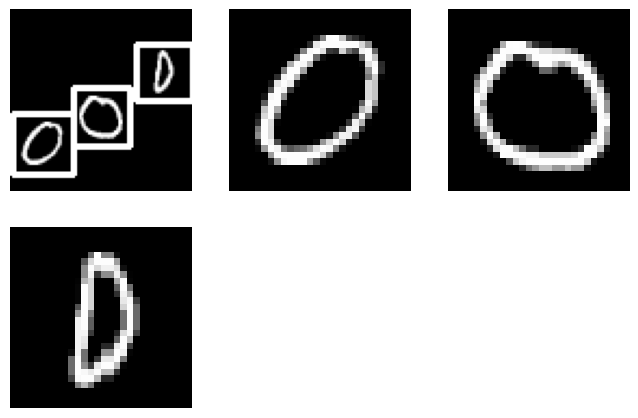

192000
60000
48000
(192000, 28, 28)
(60000, 28, 28)
(48000, 28, 28)
(192000,)
(60000,)
(48000,)
10
10
10


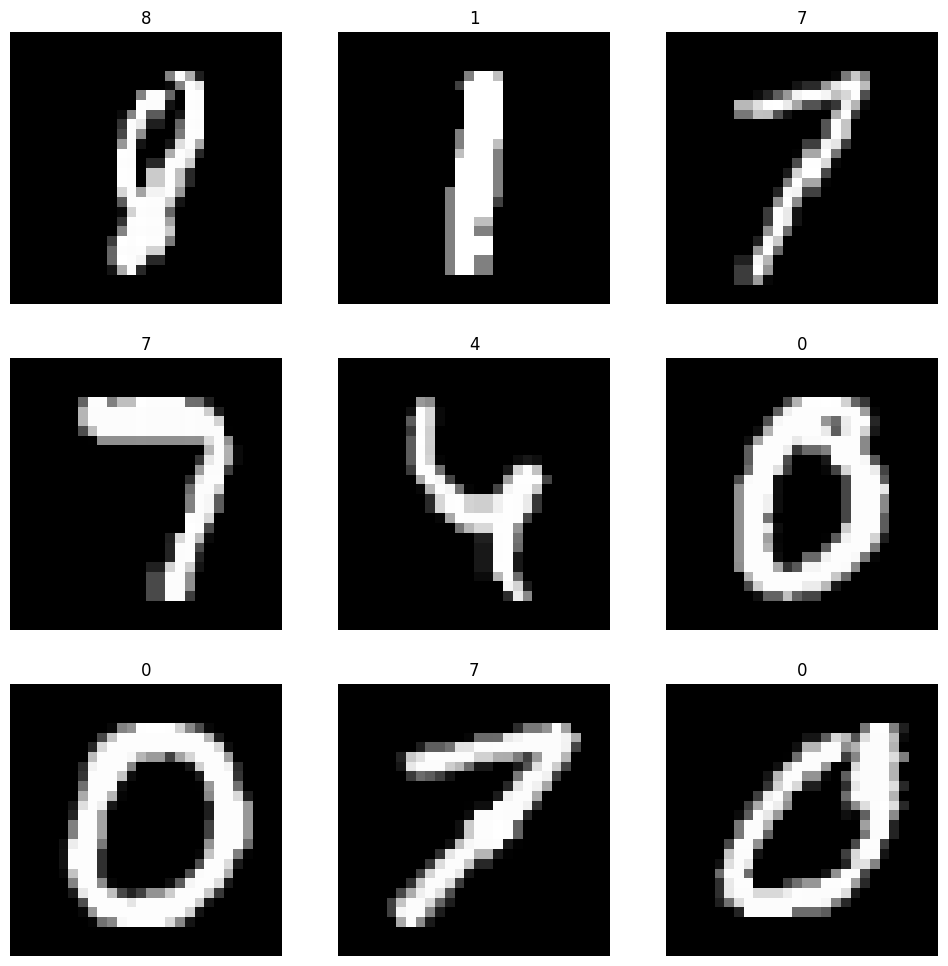

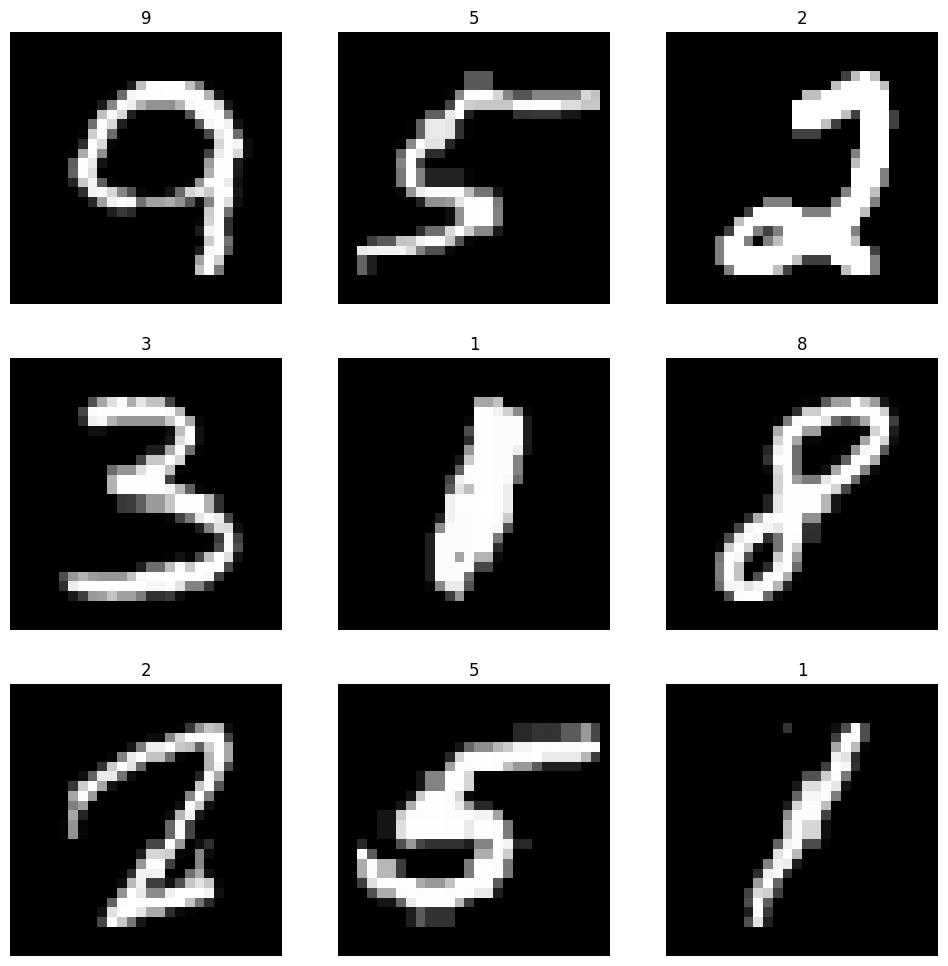

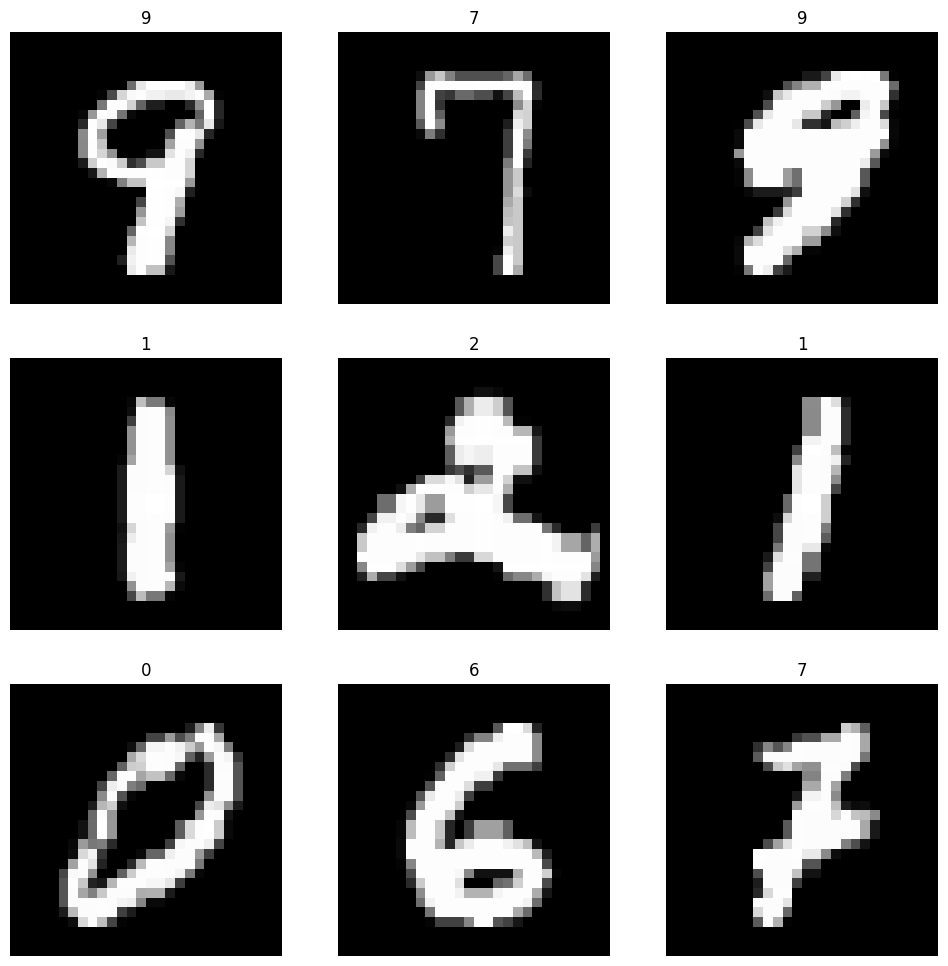

Training data shape: (192000, 28, 28, 1) (192000,)
Validation data shape: (48000, 28, 28, 1) (48000,)
Test data shape: (60000, 28, 28, 1) (60000,)


/usr/local/lib/python3.10/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                      │ (None, 26, 26, 32)          │             320 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d (MaxPooling2D)         │ (None, 13, 13, 32)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_1 (Conv2D)                    │ (None, 11, 11, 64)          │          18,496 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_1 (MaxPooling2D)       │ (None, 5, 5, 64)            │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 1600)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 1600)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 10)                  │          16,010 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 34,826 (136.04 KB)

 Trainable params: 34,826 (136.04 KB)

 Non-trainable params: 0 (0.00 B)

6000/6000 ━━━━━━━━━━━━━━━━━━━━ 23s 3ms/step - accuracy: 0.9339 - loss: 0.2186 - val_accuracy: 0.9811 - val_loss: 0.0725
Single Digits Train loss: 0.0670904666185379
Single Digits Train accuracy: 0.9813229441642761
Single Digits Validation loss: 0.07253148406744003
Single Digits Validation accuracy: 0.9811458587646484
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 21s 3ms/step - accuracy: 0.9741 - loss: 0.0905 - val_accuracy: 0.9877 - val_loss: 0.0479
Single Digits Train loss: 0.04078669846057892
Single Digits Train accuracy: 0.9886041879653931
Single Digits Validation loss: 0.04787147417664528
Single Digits Validation accuracy: 0.987666666507721
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 21s 3ms/step - accuracy: 0.9797 - loss: 0.0684 - val_accuracy: 0.9879 - val_loss: 0.0457
Single Digits Train loss: 0.038944996893405914
Single Digits Train accuracy: 0.9888020753860474
Single Digits Validation loss: 0.04573049768805504
Single Digits Validation accuracy: 0.9878749847412109
Epoch 1/3
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 

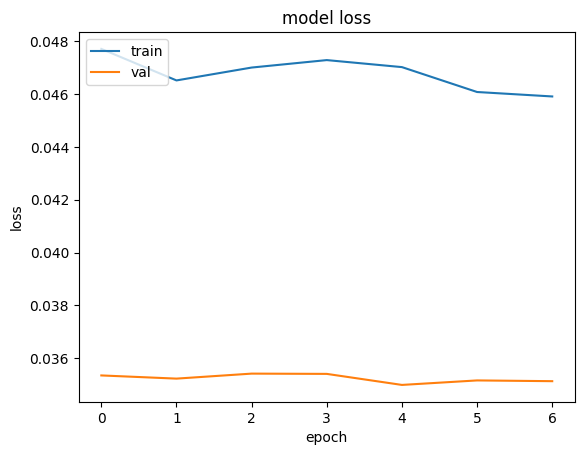

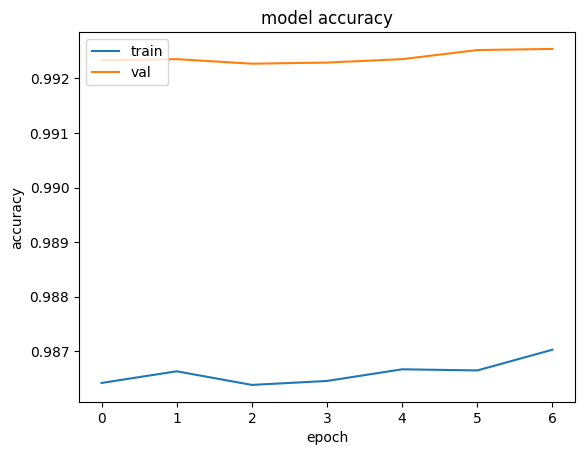

Single Digits Test loss: 0.027438027784228325
Single Digits Test accuracy: 0.9934166669845581
Classification Report:
              precision    recall  f1-score   support

         001       0.00      0.00      0.00         0
         002       0.99      0.99      0.99       100
         003       1.00      0.97      0.98       100
         004       0.00      0.00      0.00         0
         006       0.00      0.00      0.00         0
         007       0.00      0.00      0.00         0
         008       1.00      0.99      0.99       100
         009       0.00      0.00      0.00         0
         010       0.00      0.00      0.00         0
         014       1.00      1.00      1.00       100
         015       0.00      0.00      0.00         0
         016       0.99      0.99      0.99       100
         017       0.99      0.99      0.99       100
         018       0.00      0.00      0.00         0
         031       0.00      0.00      0.00         0
         033      

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


[[  0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0 

In [ ]:
#TASK-3 CNN with 3 distinct digits only dropout
import tensorflow as tf
import tensorflow.keras as keras
from tensorflow.keras import layers, models
from sklearn.metrics import classification_report, confusion_matrix
import cv2
##### SPLIT FUNCTION AND ITS DEMONSTRATION #####
digit_shape = (28, 28)
def crop_digits(img_path: str = None, im = None):
    #if im is None:
    #    im = cv2.imread(img_path)

    #gray = cv2.cvtColor(im, cv2.COLOR_BGR2GRAY)
    blur = cv2.GaussianBlur(img_path, (5, 5), 0)
    thresh = cv2.threshold(blur, 90, 255, cv2.THRESH_BINARY+cv2.THRESH_OTSU)[1]
    contours, hierarchy = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    digits = []
    rect = img_path.copy()
    for cnt in contours:
        x, y, w, h = cv2.boundingRect(cnt)

        x = max(x - 3, 0)
        y = max(y - 3, 0)
        w += 6
        h += 6

        del_x = int(w / 2)
        del_y = int(h / 2)
        center_x = x + del_x
        center_y = y + del_y

        lu_corner = (max(center_x - del_y, 0), y)
        rd_corner = (max(center_x + del_y, 0), y + h)

        rect = cv2.rectangle(rect, lu_corner, rd_corner, (255, 0, 0), 2) #rectangle

        cropped = img_path[lu_corner[1]:rd_corner[1], lu_corner[0]:rd_corner[0]]
        digits.append(cropped)

    def filter_and_sort_digits(digits, contours):
        sizes = []
        for digit in digits:
            size = digit.shape[0] * digit.shape[1]
            sizes.append(size)
        avg_size = sum(sizes) / len(sizes)
        deviations = [abs(size - avg_size) for size in sizes]

        indices = np.argsort(deviations)[0:3]
        digits = [digits[i] for i in indices]
        contours = [cv2.boundingRect(contours[i]) for i in indices]

        xs = [contour[0] for contour in contours]
        indices = np.argsort(xs) #get highest likelihood digit
        digits = [digits[i] for i in indices]

        while len(digits) < 3:
            digits.append(digits[0])
        return digits

    digits = filter_and_sort_digits(digits, contours) #get highest likelihood digits
    digits = [cv2.resize(digit, digit_shape, interpolation = cv2.INTER_NEAREST) for digit in digits] #resize to 28,28

    return digits, contours, rect

print(f"Label: {train_labels[0]}")
print(train_labels[0][0])
print(train_labels[0][1])
print(train_labels[0][2])

fig = plt.figure(figsize=(8, 8))
cols, rows = 3, 3

digits, contours, rect = crop_digits(train_images[0])

fig.add_subplot(rows, cols, 1)
plt.axis("off")
plt.imshow(rect.squeeze(), cmap="gray")
for i in range(len(digits)):
    img = digits[i]
    print(train_labels[0][i])
    fig.add_subplot(rows, cols, i+2)
    plt.axis("off")
    plt.imshow(img.squeeze(), cmap="gray")
    print(f"crop shape: {img.shape}")
plt.show()


##### SPLIT ALL DATA TO DIGITS #####
def load_digits(images, labels):
  all_digits = []
  all_labels = []
  for i in range(len(images)):
    digits, contours, rect = crop_digits(images[i])
    for j in range(len(digits)):
      all_digits.append(digits[j])
      all_labels.append(labels[i][j])
  return np.array(all_digits), np.array(all_labels)

train_images, train_labels = load_digits(train_images, train_labels)
test_images_digits, test_labels_digits = load_digits(test_images, test_labels)
val_images, val_labels = load_digits(val_images, val_labels)
print(len(train_images))
print(len(test_images_digits))
print(len(val_images))
print(train_images.shape)
print(test_images_digits.shape)
print(val_images.shape)
print(train_labels.shape)
print(test_labels_digits.shape)
print(val_labels.shape)

print(len(np.unique(train_labels)))
print(len(np.unique(test_labels_digits)))
print(len(np.unique(val_labels)))

def visualize(images, labels):
  np.random.seed(42)
  random_indices = np.random.choice(len(images), size=9, replace=False)
  random_images = images[random_indices]
  random_labels = labels[random_indices]

  fig, axes = plt.subplots(3, 3, figsize=(12, 12))
  for i, (img, label) in enumerate(zip(random_images, random_labels)):
      ax = axes[i // 3, i % 3]
      ax.imshow(img, cmap='gray')
      ax.set_title(label)
      ax.axis('off')
  plt.show()

visualize(train_images, train_labels)
visualize(test_images_digits, test_labels_digits)
visualize(val_images, val_labels)


##### TRAIN CNN #####
train_images = train_images / 255.0
val_images = val_images / 255.0
test_images_digits = test_images_digits / 255.0

train_images = train_images.reshape((train_images.shape[0], 28, 28, 1))
val_images = val_images.reshape((val_images.shape[0], 28, 28, 1))
test_images_digits = test_images_digits.reshape((test_images_digits.shape[0], 28, 28, 1))

print('Training data shape:', train_images.shape, train_labels.shape)
print('Validation data shape:', val_images.shape, val_labels.shape)
print('Test data shape:', test_images_digits.shape, test_labels_digits.shape)

train_labels = tf.keras.utils.to_categorical(train_labels, num_classes=10)
val_labels = tf.keras.utils.to_categorical(val_labels, num_classes=10)
test_labels_digits = tf.keras.utils.to_categorical(test_labels_digits, num_classes=10)

model = models.Sequential()
model.add(layers.Conv2D(32, (3, 3), activation='relu', input_shape=(28, 28, 1)))
#model.add(layers.BatchNormalization()) #### FOR TASK 4
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Conv2D(64, (3, 3), activation='relu'))
#model.add(layers.BatchNormalization()) #### FOR TASK 4
model.add(layers.MaxPooling2D((2, 2)))
#model.add(layers.Conv2D(128, (3, 3), activation='relu')) #### FOR TASK 4
#model.add(layers.BatchNormalization()) #### FOR TASK 4
#model.add(layers.MaxPooling2D((2, 2))) #### FOR TASK 4
model.add(layers.Flatten())
model.add(layers.Dropout(0.5)) #0.7 #### FOR TASK 4
model.add(layers.Dense(10, activation='softmax'))
model.summary()

# FOR TASK 4, NO HYPERPARAM SEARCH NEEDED!
param_grid_cnn = {
    'batch_size': [16],
    'epochs': [7 ],
    'learning_rate': [1e-4 ]
    #'batch_size': [32],
    #'epochs': [7],
    #'learning_rate': [1e-2],
}

best_params_cnn = None
best_loss_cnn = 999
for batch_size in param_grid_cnn['batch_size']:
    for epochs in param_grid_cnn['epochs']:
        for learning_rate in param_grid_cnn['learning_rate']:
          model.compile(loss="categorical_crossentropy", optimizer=keras.optimizers.Adam(learning_rate=learning_rate), metrics=["accuracy"])

          history = model.fit(train_images, train_labels, batch_size=batch_size, epochs=epochs, validation_data=(val_images, val_labels))

          score_train = model.evaluate(train_images, train_labels, verbose=0)
          print("Single Digits Train loss:", score_train[0])
          print("Single Digits Train accuracy:", score_train[1])
          score_val = model.evaluate(val_images, val_labels, verbose=0)
          print("Single Digits Validation loss:", score_val[0])
          print("Single Digits Validation accuracy:", score_val[1])
          if score_val[0] < best_loss_cnn:
                  best_loss_cnn = score_val[0]
                  best_params_cnn = {'batch_size': batch_size, 'epochs': epochs, 'learning_rate':learning_rate}

print("Single Digits Best Hyperparameters (CNN):", best_params_cnn)
print("Single Digits Best Loss Score (CNN):", best_loss_cnn)
# Print the classification report for single digits
print("Classification Report (Single Digits):")
print(classification_report(true_labels_digits, predicted_labels_digits, digits=4))
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

score = model.evaluate(test_images_digits, test_labels_digits, verbose=0)
print("Single Digits Test loss:", score[0])
print("Single Digits Test accuracy:", score[1])

final_test_predictions = []
for i in range(len(test_images)):
  img = test_images[i]
  concat = ""
  for j in range(0,3):
    img_digit = test_images_digits[3*i + j]
    #prediction = model.predict_on_batch([img_digit])
    prediction = model.predict_on_batch(np.expand_dims(img_digit, axis=0))
    prediction = np.argmax(prediction)
    #print(prediction, test_labels[i])
    concat = concat + str(prediction)
  #print(concat, test_labels[i])
  final_test_predictions.append(concat)

np.set_printoptions(threshold=np.inf)

print("Classification Report:")
print(classification_report(test_labels, final_test_predictions,digits = 4))

print("\nConfusion Matrix:")
print(confusion_matrix(test_labels, final_test_predictions,digits = 4))



In [ ]:
import numpy as np
import matplotlib.pyplot as plt
test_images = np.load('/content/drive/MyDrive/npy_2/np_save_test_images_2.npy')
test_labels = np.load('/content/drive/MyDrive/npy_2/np_save_test_labels_2.npy')
val_images = np.load('/content/drive/MyDrive/npy_2/np_save_val_images_2.npy')
val_labels = np.load('/content/drive/MyDrive/npy_2/np_save_val_labels_2.npy')
train_images = np.load('/content/drive/MyDrive/npy_2/np_save_train_images_2.npy')
train_labels = np.load('/content/drive/MyDrive/npy_2/np_save_train_labels_2.npy')

Label: 000
0
0
0
0
crop shape: (28, 28)
0
crop shape: (28, 28)
0
crop shape: (28, 28)


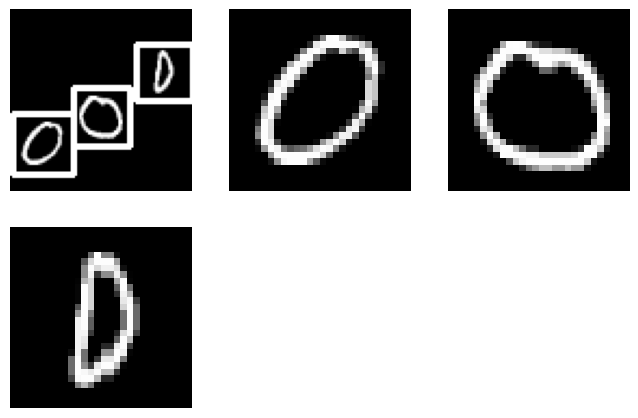

192000
60000
48000
(192000, 28, 28)
(60000, 28, 28)
(48000, 28, 28)
(192000,)
(60000,)
(48000,)
10
10
10


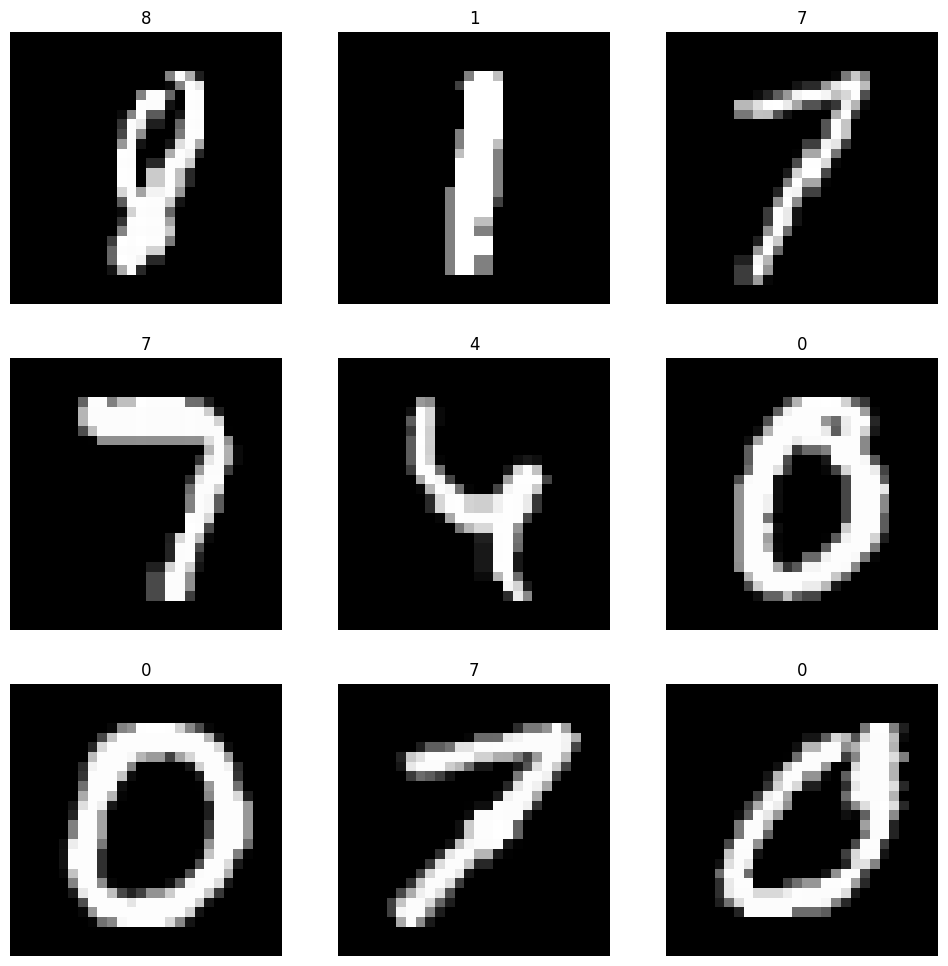

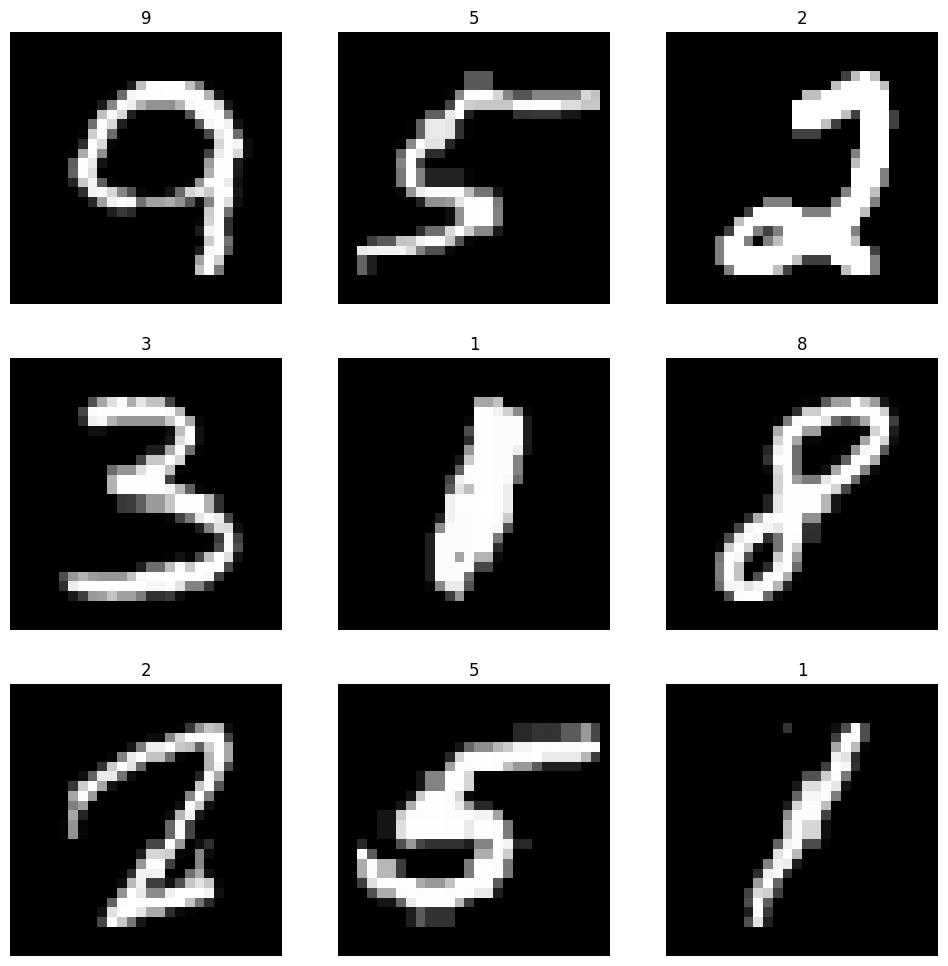

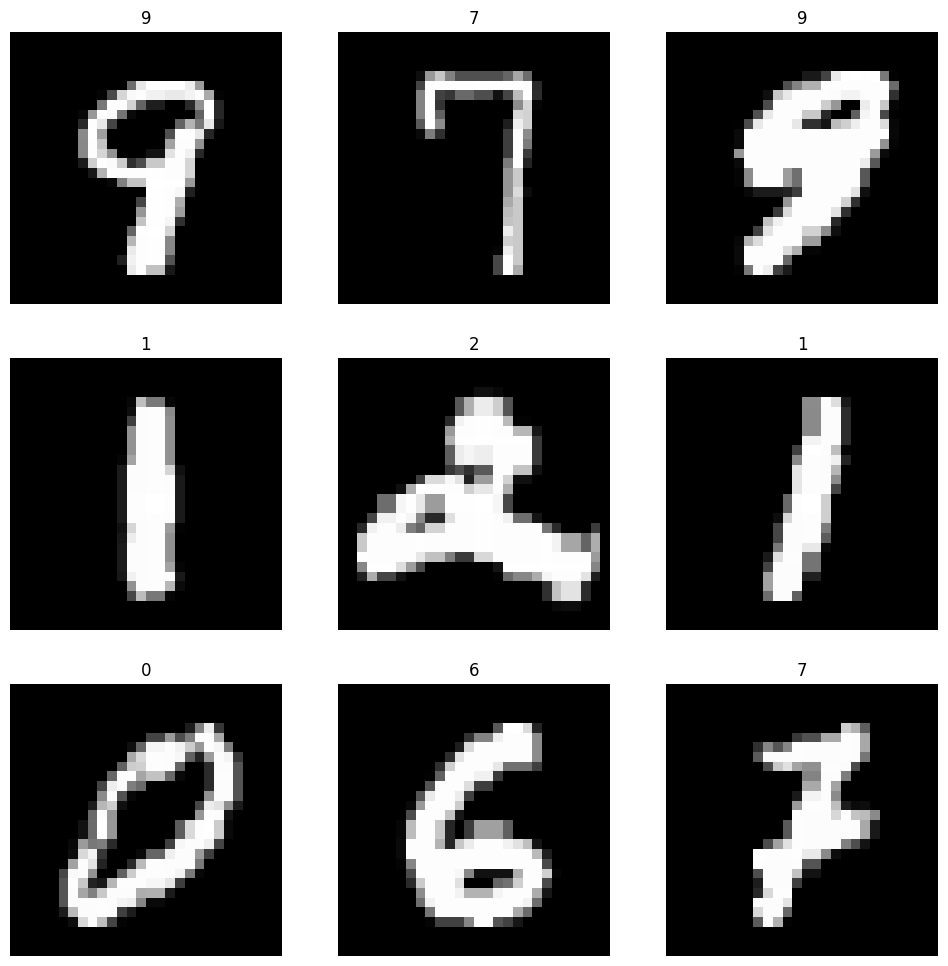

Training data shape: (192000, 28, 28, 1) (192000,)
Validation data shape: (48000, 28, 28, 1) (48000,)
Test data shape: (60000, 28, 28, 1) (60000,)


/usr/local/lib/python3.10/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                      │ (None, 26, 26, 32)          │             320 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d (MaxPooling2D)         │ (None, 13, 13, 32)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_1 (Conv2D)                    │ (None, 11, 11, 64)          │          18,496 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_1 (MaxPooling2D)       │ (None, 5, 5, 64)            │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 1600)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 1600)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 10)                  │          16,010 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 34,826 (136.04 KB)

 Trainable params: 34,826 (136.04 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/7
12000/12000 ━━━━━━━━━━━━━━━━━━━━ 38s 3ms/step - accuracy: 0.8163 - loss: 0.5987 - val_accuracy: 0.9700 - val_loss: 0.1133
Epoch 2/7
12000/12000 ━━━━━━━━━━━━━━━━━━━━ 36s 3ms/step - accuracy: 0.9642 - loss: 0.1293 - val_accuracy: 0.9786 - val_loss: 0.0824
Epoch 3/7
12000/12000 ━━━━━━━━━━━━━━━━━━━━ 40s 3ms/step - accuracy: 0.9726 - loss: 0.1005 - val_accuracy: 0.9821 - val_loss: 0.0703
Epoch 4/7
12000/12000 ━━━━━━━━━━━━━━━━━━━━ 32s 3ms/step - accuracy: 0.9769 - loss: 0.0849 - val_accuracy: 0.9847 - val_loss: 0.0615
Epoch 5/7
12000/12000 ━━━━━━━━━━━━━━━━━━━━ 37s 3ms/step - accuracy: 0.9795 - loss: 0.0760 - val_accuracy: 0.9860 - val_loss: 0.0562
Epoch 6/7
12000/12000 ━━━━━━━━━━━━━━━━━━━━ 32s 3ms/step - accuracy: 0.9803 - loss: 0.0703 - val_accuracy: 0.9872 - val_loss: 0.0533
Epoch 7/7
12000/12000 ━━━━━━━━━━━━━━━━━━━━ 41s 3ms/step - accuracy: 0.9821 - loss: 0.0650 - val_accuracy: 0.9866 - val_loss: 0.0530
Single Digits Train loss: 0.046748965978622437
Single Digits Train accuracy:

Single Digits Validation loss: 0.05299849435687065
Single Digits Validation accuracy: 0.9865624904632568
Single Digits Best Hyperparameters (CNN): {'batch_size': 16, 'epochs': 7, 'learning_rate': 0.0001}
Single Digits Best Loss Score (CNN): 0.05299849435687065


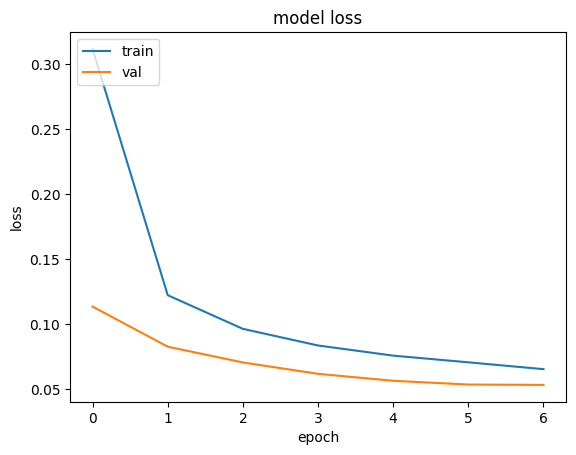

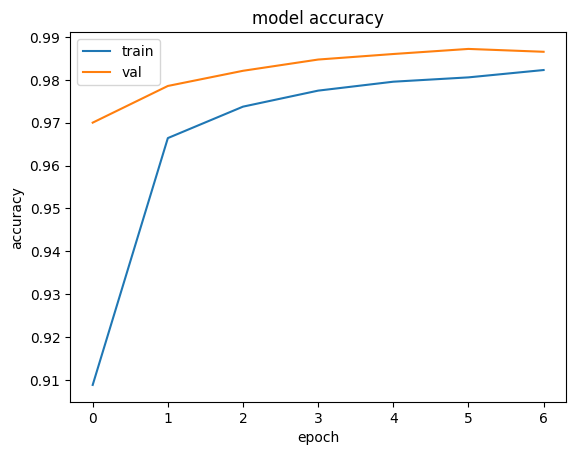

Single Digits Test loss: 0.04757619649171829
Single Digits Test accuracy: 0.9872000217437744
Classification Report:
              precision    recall  f1-score   support

         002     0.9900    0.9900    0.9900       100
         003     1.0000    0.9600    0.9796       100
         004     0.0000    0.0000    0.0000         0
         005     0.0000    0.0000    0.0000         0
         006     0.0000    0.0000    0.0000         0
         007     0.0000    0.0000    0.0000         0
         008     1.0000    1.0000    1.0000       100
         014     1.0000    0.9900    0.9950       100
         015     0.0000    0.0000    0.0000         0
         016     1.0000    0.9800    0.9899       100
         017     0.9802    0.9900    0.9851       100
         018     0.0000    0.0000    0.0000         0
         019     0.0000    0.0000    0.0000         0
         023     0.0000    0.0000    0.0000         0
         028     0.0000    0.0000    0.0000         0
         031     0.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


[[ 99   0   0   1   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0 

In [ ]:
#TASK-3 CNN with 3 distinct digits only dropout
import tensorflow as tf
import tensorflow.keras as keras
from tensorflow.keras import layers, models
from sklearn.metrics import classification_report, confusion_matrix
import cv2
##### SPLIT FUNCTION AND ITS DEMONSTRATION #####
digit_shape = (28, 28)
def crop_digits(img_path: str = None, im = None):
    #if im is None:
    #    im = cv2.imread(img_path)

    #gray = cv2.cvtColor(im, cv2.COLOR_BGR2GRAY)
    blur = cv2.GaussianBlur(img_path, (5, 5), 0)
    thresh = cv2.threshold(blur, 90, 255, cv2.THRESH_BINARY+cv2.THRESH_OTSU)[1]
    contours, hierarchy = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    digits = []
    rect = img_path.copy()
    for cnt in contours:
        x, y, w, h = cv2.boundingRect(cnt)

        x = max(x - 3, 0)
        y = max(y - 3, 0)
        w += 6
        h += 6

        del_x = int(w / 2)
        del_y = int(h / 2)
        center_x = x + del_x
        center_y = y + del_y

        lu_corner = (max(center_x - del_y, 0), y)
        rd_corner = (max(center_x + del_y, 0), y + h)

        rect = cv2.rectangle(rect, lu_corner, rd_corner, (255, 0, 0), 2) #rectangle

        cropped = img_path[lu_corner[1]:rd_corner[1], lu_corner[0]:rd_corner[0]]
        digits.append(cropped)

    def filter_and_sort_digits(digits, contours):
        sizes = []
        for digit in digits:
            size = digit.shape[0] * digit.shape[1]
            sizes.append(size)
        avg_size = sum(sizes) / len(sizes)
        deviations = [abs(size - avg_size) for size in sizes]

        indices = np.argsort(deviations)[0:3]
        digits = [digits[i] for i in indices]
        contours = [cv2.boundingRect(contours[i]) for i in indices]

        xs = [contour[0] for contour in contours]
        indices = np.argsort(xs) #get highest likelihood digit
        digits = [digits[i] for i in indices]

        while len(digits) < 3:
            digits.append(digits[0])
        return digits

    digits = filter_and_sort_digits(digits, contours) #get highest likelihood digits
    digits = [cv2.resize(digit, digit_shape, interpolation = cv2.INTER_NEAREST) for digit in digits] #resize to 28,28

    return digits, contours, rect

print(f"Label: {train_labels[0]}")
print(train_labels[0][0])
print(train_labels[0][1])
print(train_labels[0][2])

fig = plt.figure(figsize=(8, 8))
cols, rows = 3, 3

digits, contours, rect = crop_digits(train_images[0])

fig.add_subplot(rows, cols, 1)
plt.axis("off")
plt.imshow(rect.squeeze(), cmap="gray")
for i in range(len(digits)):
    img = digits[i]
    print(train_labels[0][i])
    fig.add_subplot(rows, cols, i+2)
    plt.axis("off")
    plt.imshow(img.squeeze(), cmap="gray")
    print(f"crop shape: {img.shape}")
plt.show()


##### SPLIT ALL DATA TO DIGITS #####
def load_digits(images, labels):
  all_digits = []
  all_labels = []
  for i in range(len(images)):
    digits, contours, rect = crop_digits(images[i])
    for j in range(len(digits)):
      all_digits.append(digits[j])
      all_labels.append(labels[i][j])
  return np.array(all_digits), np.array(all_labels)

train_images, train_labels = load_digits(train_images, train_labels)
test_images_digits, test_labels_digits = load_digits(test_images, test_labels)
val_images, val_labels = load_digits(val_images, val_labels)
print(len(train_images))
print(len(test_images_digits))
print(len(val_images))
print(train_images.shape)
print(test_images_digits.shape)
print(val_images.shape)
print(train_labels.shape)
print(test_labels_digits.shape)
print(val_labels.shape)

print(len(np.unique(train_labels)))
print(len(np.unique(test_labels_digits)))
print(len(np.unique(val_labels)))

def visualize(images, labels):
  np.random.seed(42)
  random_indices = np.random.choice(len(images), size=9, replace=False)
  random_images = images[random_indices]
  random_labels = labels[random_indices]

  fig, axes = plt.subplots(3, 3, figsize=(12, 12))
  for i, (img, label) in enumerate(zip(random_images, random_labels)):
      ax = axes[i // 3, i % 3]
      ax.imshow(img, cmap='gray')
      ax.set_title(label)
      ax.axis('off')
  plt.show()

visualize(train_images, train_labels)
visualize(test_images_digits, test_labels_digits)
visualize(val_images, val_labels)


##### TRAIN CNN #####
train_images = train_images / 255.0
val_images = val_images / 255.0
test_images_digits = test_images_digits / 255.0

train_images = train_images.reshape((train_images.shape[0], 28, 28, 1))
val_images = val_images.reshape((val_images.shape[0], 28, 28, 1))
test_images_digits = test_images_digits.reshape((test_images_digits.shape[0], 28, 28, 1))

print('Training data shape:', train_images.shape, train_labels.shape)
print('Validation data shape:', val_images.shape, val_labels.shape)
print('Test data shape:', test_images_digits.shape, test_labels_digits.shape)

train_labels = tf.keras.utils.to_categorical(train_labels, num_classes=10)
val_labels = tf.keras.utils.to_categorical(val_labels, num_classes=10)
test_labels_digits = tf.keras.utils.to_categorical(test_labels_digits, num_classes=10)


# FOR TASK 4, NO HYPERPARAM SEARCH NEEDED!
param_grid_cnn = {
    'batch_size': [16],
    'epochs': [7 ],
    'learning_rate': [1e-4 ]
    #'batch_size': [32],
    #'epochs': [7],
    #'learning_rate': [1e-2],
}

best_params_cnn = None
best_loss_cnn = 999
for batch_size in param_grid_cnn['batch_size']:
    for epochs in param_grid_cnn['epochs']:
        for learning_rate in param_grid_cnn['learning_rate']:
          model = models.Sequential()
          model.add(layers.Conv2D(32, (3, 3), activation='relu', input_shape=(28, 28, 1)))
          #model.add(layers.BatchNormalization()) #### FOR TASK 4
          model.add(layers.MaxPooling2D((2, 2)))
          model.add(layers.Conv2D(64, (3, 3), activation='relu'))
          #model.add(layers.BatchNormalization()) #### FOR TASK 4
          model.add(layers.MaxPooling2D((2, 2)))
          #model.add(layers.Conv2D(128, (3, 3), activation='relu')) #### FOR TASK 4
          #model.add(layers.BatchNormalization()) #### FOR TASK 4
          #model.add(layers.MaxPooling2D((2, 2))) #### FOR TASK 4
          model.add(layers.Flatten())
          model.add(layers.Dropout(0.5)) #0.7 #### FOR TASK 4
          model.add(layers.Dense(10, activation='softmax'))
          model.summary()

          model.compile(loss="categorical_crossentropy", optimizer=keras.optimizers.Adam(learning_rate=learning_rate), metrics=["accuracy"])

          history = model.fit(train_images, train_labels, batch_size=batch_size, epochs=epochs, validation_data=(val_images, val_labels))

          score_train = model.evaluate(train_images, train_labels, verbose=0)
          print("Single Digits Train loss:", score_train[0])
          print("Single Digits Train accuracy:", score_train[1])
          score_val = model.evaluate(val_images, val_labels, verbose=0)
          print("Single Digits Validation loss:", score_val[0])
          print("Single Digits Validation accuracy:", score_val[1])
          if score_val[0] < best_loss_cnn:
                  best_loss_cnn = score_val[0]
                  best_params_cnn = {'batch_size': batch_size, 'epochs': epochs, 'learning_rate':learning_rate}
                  model.save('best_model.h5')


print("Single Digits Best Hyperparameters (CNN):", best_params_cnn)
print("Single Digits Best Loss Score (CNN):", best_loss_cnn)
model = keras.models.load_model('best_model.h5')
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

score = model.evaluate(test_images_digits, test_labels_digits, verbose=0)
print("Single Digits Test loss:", score[0])
print("Single Digits Test accuracy:", score[1])

final_test_predictions = []
for i in range(len(test_images)):
  img = test_images[i]
  concat = ""
  for j in range(0,3):
    img_digit = test_images_digits[3*i + j]
    #prediction = model.predict_on_batch([img_digit])
    prediction = model.predict_on_batch(np.expand_dims(img_digit, axis=0))
    prediction = np.argmax(prediction)
    #print(prediction, test_labels[i])
    concat = concat + str(prediction)
  #print(concat, test_labels[i])
  final_test_predictions.append(concat)

np.set_printoptions(threshold=np.inf)

print("Classification Report:")
print(classification_report(test_labels, final_test_predictions, digits = 4))

print("\nConfusion Matrix:")
print(confusion_matrix(test_labels, final_test_predictions))



Label: 000
0
0
0
0
crop shape: (28, 28)
0
crop shape: (28, 28)
0
crop shape: (28, 28)


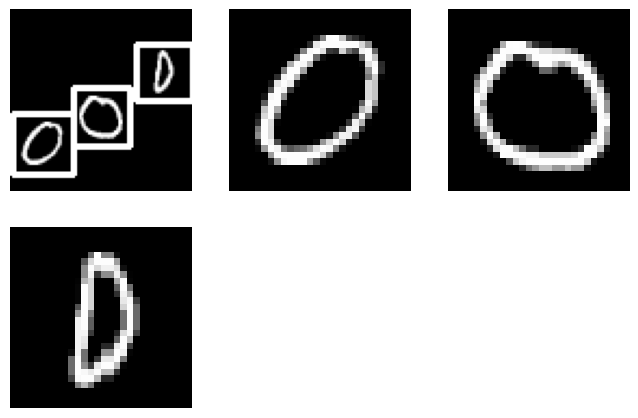

192000
60000
48000
(192000, 28, 28)
(60000, 28, 28)
(48000, 28, 28)
(192000,)
(60000,)
(48000,)
10
10
10


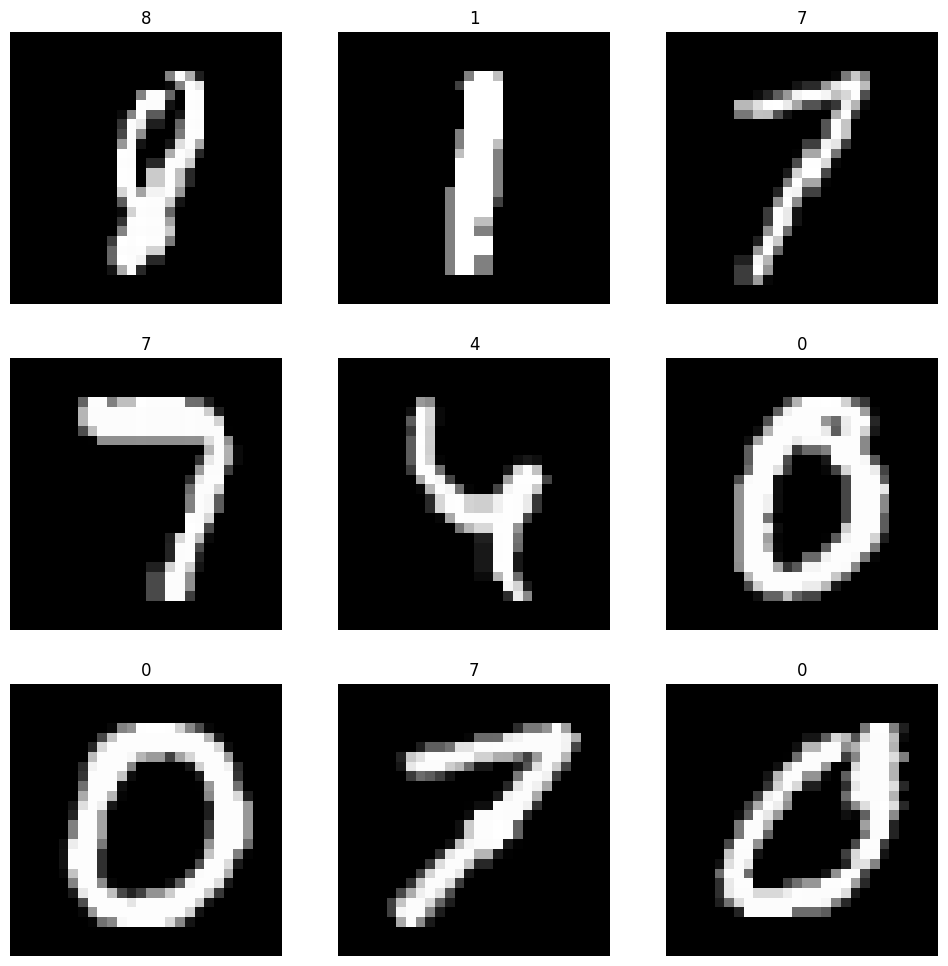

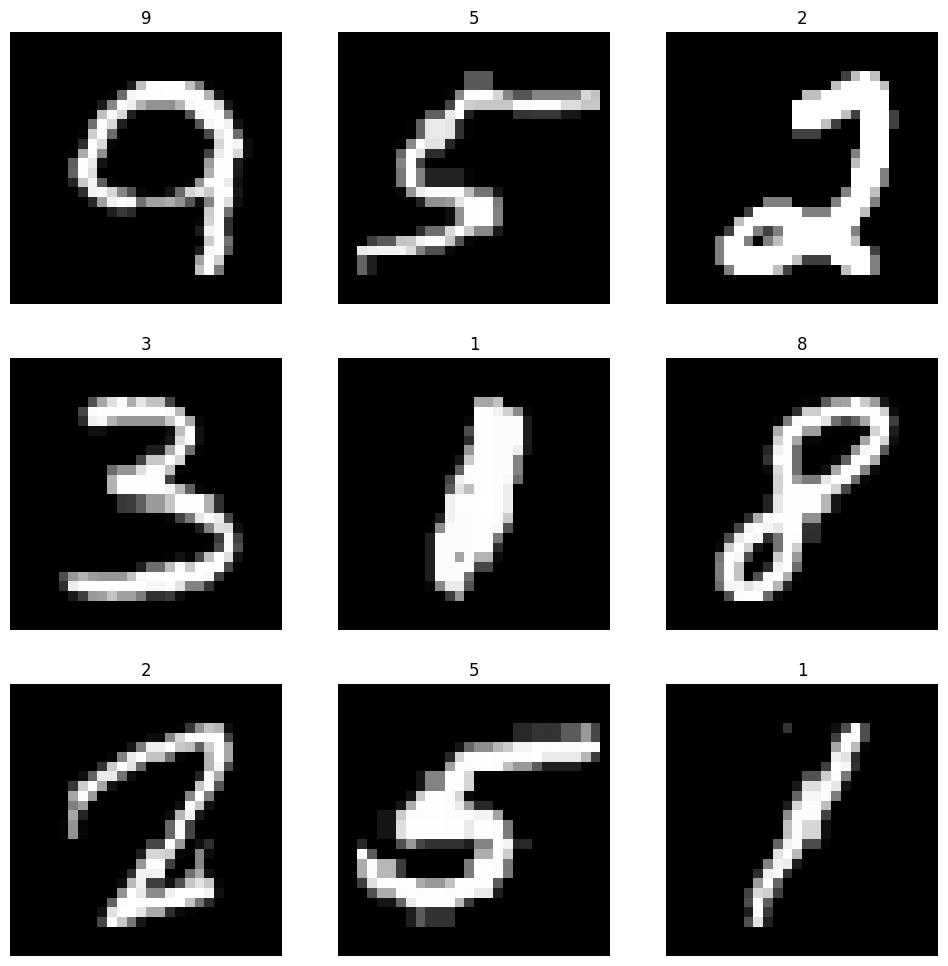

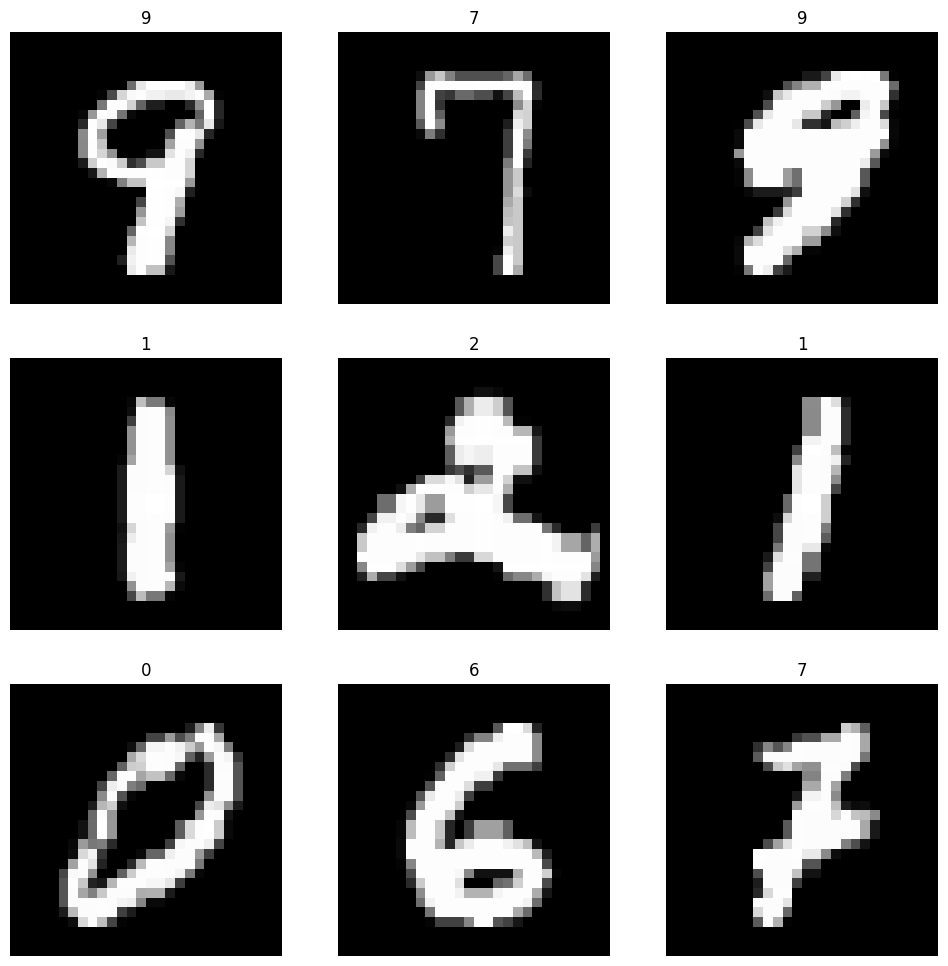

Training data shape: (192000, 28, 28, 1) (192000,)
Validation data shape: (48000, 28, 28, 1) (48000,)
Test data shape: (60000, 28, 28, 1) (60000,)


/usr/local/lib/python3.10/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                      │ (None, 26, 26, 32)          │             320 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d (MaxPooling2D)         │ (None, 13, 13, 32)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_1 (Conv2D)                    │ (None, 11, 11, 64)          │          18,496 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_1 (MaxPooling2D)       │ (None, 5, 5, 64)            │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 5, 5, 64)            │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 1600)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_1 (Dropout)                  │ (None, 1600)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 10)                  │          16,010 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 34,826 (136.04 KB)

 Trainable params: 34,826 (136.04 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/7
12000/12000 ━━━━━━━━━━━━━━━━━━━━ 38s 3ms/step - accuracy: 0.7912 - loss: 0.6601 - val_accuracy: 0.9677 - val_loss: 0.1203
Epoch 2/7
12000/12000 ━━━━━━━━━━━━━━━━━━━━ 37s 3ms/step - accuracy: 0.9584 - loss: 0.1498 - val_accuracy: 0.9778 - val_loss: 0.0858
Epoch 3/7
12000/12000 ━━━━━━━━━━━━━━━━━━━━ 42s 3ms/step - accuracy: 0.9679 - loss: 0.1169 - val_accuracy: 0.9810 - val_loss: 0.0729
Epoch 4/7
12000/12000 ━━━━━━━━━━━━━━━━━━━━ 40s 3ms/step - accuracy: 0.9726 - loss: 0.0983 - val_accuracy: 0.9843 - val_loss: 0.0642
Epoch 5/7
12000/12000 ━━━━━━━━━━━━━━━━━━━━ 41s 3ms/step - accuracy: 0.9763 - loss: 0.0859 - val_accuracy: 0.9857 - val_loss: 0.0589
Epoch 6/7
12000/12000 ━━━━━━━━━━━━━━━━━━━━ 34s 3ms/step - accuracy: 0.9770 - loss: 0.0824 - val_accuracy: 0.9864 - val_loss: 0.0557
Epoch 7/7
12000/12000 ━━━━━━━━━━━━━━━━━━━━ 34s 3ms/step - accuracy: 0.9781 - loss: 0.0769 - val_accuracy: 0.9869 - val_loss: 0.0536
Single Digits Train loss: 0.0480528250336647
Single Digits Train accuracy: 0

Single Digits Validation loss: 0.05364357680082321
Single Digits Validation accuracy: 0.9868958592414856
Single Digits Best Hyperparameters (CNN): {'batch_size': 16, 'epochs': 7, 'learning_rate': 0.0001}
Single Digits Best Loss Score (CNN): 0.05364357680082321


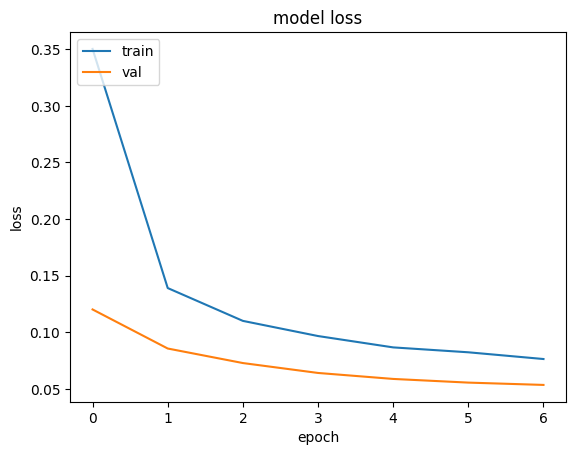

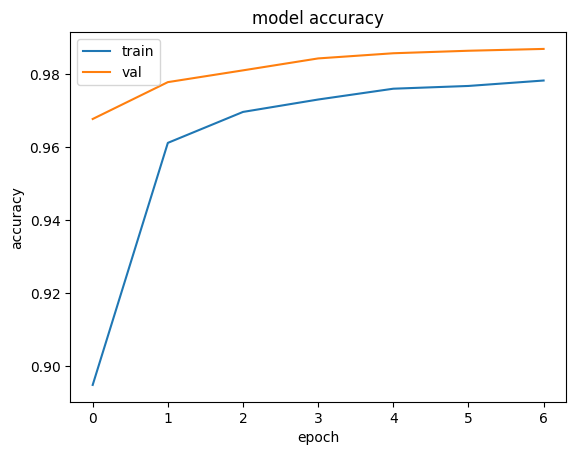

Single Digits Test loss: 0.048107169568538666
Single Digits Test accuracy: 0.9872999787330627
Classification Report:
              precision    recall  f1-score   support

         002     1.0000    0.9900    0.9950       100
         003     1.0000    0.9700    0.9848       100
         004     0.0000    0.0000    0.0000         0
         005     0.0000    0.0000    0.0000         0
         006     0.0000    0.0000    0.0000         0
         007     0.0000    0.0000    0.0000         0
         008     1.0000    0.9900    0.9950       100
         009     0.0000    0.0000    0.0000         0
         010     0.0000    0.0000    0.0000         0
         011     0.0000    0.0000    0.0000         0
         014     1.0000    0.9700    0.9848       100
         015     0.0000    0.0000    0.0000         0
         016     0.9899    0.9800    0.9849       100
         017     0.9706    0.9900    0.9802       100
         018     0.0000    0.0000    0.0000         0
         019     0

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


[[ 99   0   0   1   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0 

In [ ]:
#TASK-3 CNN with 3 distinct digits only dropout 2 times
import tensorflow as tf
import tensorflow.keras as keras
from tensorflow.keras import layers, models
from sklearn.metrics import classification_report, confusion_matrix
import cv2
##### SPLIT FUNCTION AND ITS DEMONSTRATION #####
digit_shape = (28, 28)
def crop_digits(img_path: str = None, im = None):
    #if im is None:
    #    im = cv2.imread(img_path)

    #gray = cv2.cvtColor(im, cv2.COLOR_BGR2GRAY)
    blur = cv2.GaussianBlur(img_path, (5, 5), 0)
    thresh = cv2.threshold(blur, 90, 255, cv2.THRESH_BINARY+cv2.THRESH_OTSU)[1]
    contours, hierarchy = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    digits = []
    rect = img_path.copy()
    for cnt in contours:
        x, y, w, h = cv2.boundingRect(cnt)

        x = max(x - 3, 0)
        y = max(y - 3, 0)
        w += 6
        h += 6

        del_x = int(w / 2)
        del_y = int(h / 2)
        center_x = x + del_x
        center_y = y + del_y

        lu_corner = (max(center_x - del_y, 0), y)
        rd_corner = (max(center_x + del_y, 0), y + h)

        rect = cv2.rectangle(rect, lu_corner, rd_corner, (255, 0, 0), 2) #rectangle

        cropped = img_path[lu_corner[1]:rd_corner[1], lu_corner[0]:rd_corner[0]]
        digits.append(cropped)

    def filter_and_sort_digits(digits, contours):
        sizes = []
        for digit in digits:
            size = digit.shape[0] * digit.shape[1]
            sizes.append(size)
        avg_size = sum(sizes) / len(sizes)
        deviations = [abs(size - avg_size) for size in sizes]

        indices = np.argsort(deviations)[0:3]
        digits = [digits[i] for i in indices]
        contours = [cv2.boundingRect(contours[i]) for i in indices]

        xs = [contour[0] for contour in contours]
        indices = np.argsort(xs) #get highest likelihood digit
        digits = [digits[i] for i in indices]

        while len(digits) < 3:
            digits.append(digits[0])
        return digits

    digits = filter_and_sort_digits(digits, contours) #get highest likelihood digits
    digits = [cv2.resize(digit, digit_shape, interpolation = cv2.INTER_NEAREST) for digit in digits] #resize to 28,28

    return digits, contours, rect

print(f"Label: {train_labels[0]}")
print(train_labels[0][0])
print(train_labels[0][1])
print(train_labels[0][2])

fig = plt.figure(figsize=(8, 8))
cols, rows = 3, 3

digits, contours, rect = crop_digits(train_images[0])

fig.add_subplot(rows, cols, 1)
plt.axis("off")
plt.imshow(rect.squeeze(), cmap="gray")
for i in range(len(digits)):
    img = digits[i]
    print(train_labels[0][i])
    fig.add_subplot(rows, cols, i+2)
    plt.axis("off")
    plt.imshow(img.squeeze(), cmap="gray")
    print(f"crop shape: {img.shape}")
plt.show()


##### SPLIT ALL DATA TO DIGITS #####
def load_digits(images, labels):
  all_digits = []
  all_labels = []
  for i in range(len(images)):
    digits, contours, rect = crop_digits(images[i])
    for j in range(len(digits)):
      all_digits.append(digits[j])
      all_labels.append(labels[i][j])
  return np.array(all_digits), np.array(all_labels)

train_images, train_labels = load_digits(train_images, train_labels)
test_images_digits, test_labels_digits = load_digits(test_images, test_labels)
val_images, val_labels = load_digits(val_images, val_labels)
print(len(train_images))
print(len(test_images_digits))
print(len(val_images))
print(train_images.shape)
print(test_images_digits.shape)
print(val_images.shape)
print(train_labels.shape)
print(test_labels_digits.shape)
print(val_labels.shape)

print(len(np.unique(train_labels)))
print(len(np.unique(test_labels_digits)))
print(len(np.unique(val_labels)))

def visualize(images, labels):
  np.random.seed(42)
  random_indices = np.random.choice(len(images), size=9, replace=False)
  random_images = images[random_indices]
  random_labels = labels[random_indices]

  fig, axes = plt.subplots(3, 3, figsize=(12, 12))
  for i, (img, label) in enumerate(zip(random_images, random_labels)):
      ax = axes[i // 3, i % 3]
      ax.imshow(img, cmap='gray')
      ax.set_title(label)
      ax.axis('off')
  plt.show()

visualize(train_images, train_labels)
visualize(test_images_digits, test_labels_digits)
visualize(val_images, val_labels)


##### TRAIN CNN #####
train_images = train_images / 255.0
val_images = val_images / 255.0
test_images_digits = test_images_digits / 255.0

train_images = train_images.reshape((train_images.shape[0], 28, 28, 1))
val_images = val_images.reshape((val_images.shape[0], 28, 28, 1))
test_images_digits = test_images_digits.reshape((test_images_digits.shape[0], 28, 28, 1))

print('Training data shape:', train_images.shape, train_labels.shape)
print('Validation data shape:', val_images.shape, val_labels.shape)
print('Test data shape:', test_images_digits.shape, test_labels_digits.shape)

train_labels = tf.keras.utils.to_categorical(train_labels, num_classes=10)
val_labels = tf.keras.utils.to_categorical(val_labels, num_classes=10)
test_labels_digits = tf.keras.utils.to_categorical(test_labels_digits, num_classes=10)


# FOR TASK 4, NO HYPERPARAM SEARCH NEEDED!
param_grid_cnn = {
    'batch_size': [16],
    'epochs': [7 ],
    'learning_rate': [1e-4 ]
    #'batch_size': [32],
    #'epochs': [7],
    #'learning_rate': [1e-2],
}

best_params_cnn = None
best_loss_cnn = 999
for batch_size in param_grid_cnn['batch_size']:
    for epochs in param_grid_cnn['epochs']:
        for learning_rate in param_grid_cnn['learning_rate']:
          model = models.Sequential()
          model.add(layers.Conv2D(32, (3, 3), activation='relu', input_shape=(28, 28, 1)))
          #model.add(layers.BatchNormalization()) #### FOR TASK 4
          model.add(layers.MaxPooling2D((2, 2)))
          model.add(layers.Conv2D(64, (3, 3), activation='relu'))
          #model.add(layers.BatchNormalization()) #### FOR TASK 4
          model.add(layers.MaxPooling2D((2, 2)))
          model.add(layers.Dropout(0.4)) #0.7 #### FOR TASK 4
          #model.add(layers.Conv2D(128, (3, 3), activation='relu')) #### FOR TASK 4
          #model.add(layers.BatchNormalization()) #### FOR TASK 4
          #model.add(layers.MaxPooling2D((2, 2))) #### FOR TASK 4
          model.add(layers.Flatten())
          model.add(layers.Dropout(0.4)) #0.7 #### FOR TASK 4
          model.add(layers.Dense(10, activation='softmax'))
          model.summary()

          model.compile(loss="categorical_crossentropy", optimizer=keras.optimizers.Adam(learning_rate=learning_rate), metrics=["accuracy"])

          history = model.fit(train_images, train_labels, batch_size=batch_size, epochs=epochs, validation_data=(val_images, val_labels))

          score_train = model.evaluate(train_images, train_labels, verbose=0)
          print("Single Digits Train loss:", score_train[0])
          print("Single Digits Train accuracy:", score_train[1])
          score_val = model.evaluate(val_images, val_labels, verbose=0)
          print("Single Digits Validation loss:", score_val[0])
          print("Single Digits Validation accuracy:", score_val[1])
          if score_val[0] < best_loss_cnn:
                  best_loss_cnn = score_val[0]
                  best_params_cnn = {'batch_size': batch_size, 'epochs': epochs, 'learning_rate':learning_rate}
                  model.save('best_model.h5')


print("Single Digits Best Hyperparameters (CNN):", best_params_cnn)
print("Single Digits Best Loss Score (CNN):", best_loss_cnn)
model = keras.models.load_model('best_model.h5')
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

score = model.evaluate(test_images_digits, test_labels_digits, verbose=0)
print("Single Digits Test loss:", score[0])
print("Single Digits Test accuracy:", score[1])

final_test_predictions = []
for i in range(len(test_images)):
  img = test_images[i]
  concat = ""
  for j in range(0,3):
    img_digit = test_images_digits[3*i + j]
    #prediction = model.predict_on_batch([img_digit])
    prediction = model.predict_on_batch(np.expand_dims(img_digit, axis=0))
    prediction = np.argmax(prediction)
    #print(prediction, test_labels[i])
    concat = concat + str(prediction)
  #print(concat, test_labels[i])
  final_test_predictions.append(concat)

np.set_printoptions(threshold=np.inf)

print("Classification Report:")
print(classification_report(test_labels, final_test_predictions, digits = 4))

print("\nConfusion Matrix:")
print(confusion_matrix(test_labels, final_test_predictions))

In [ ]:
from google.colab import drive
drive.mount('/content/drive')
import numpy as np
import matplotlib.pyplot as plt
train_images = np.load('/content/drive/MyDrive/npy_2/np_save_train_images_2.npy')
train_labels = np.load('/content/drive/MyDrive/npy_2/np_save_train_labels_2.npy')
test_images = np.load('/content/drive/MyDrive/npy_2/np_save_test_images_2.npy')
test_labels = np.load('/content/drive/MyDrive/npy_2/np_save_test_labels_2.npy')
val_images = np.load('/content/drive/MyDrive/npy_2/np_save_val_images_2.npy')
val_labels = np.load('/content/drive/MyDrive/npy_2/np_save_val_labels_2.npy')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


# 2 LAYER NORMAL FILTRE

Label: 000
0
0
0
0
crop shape: (28, 28)
0
crop shape: (28, 28)
0
crop shape: (28, 28)


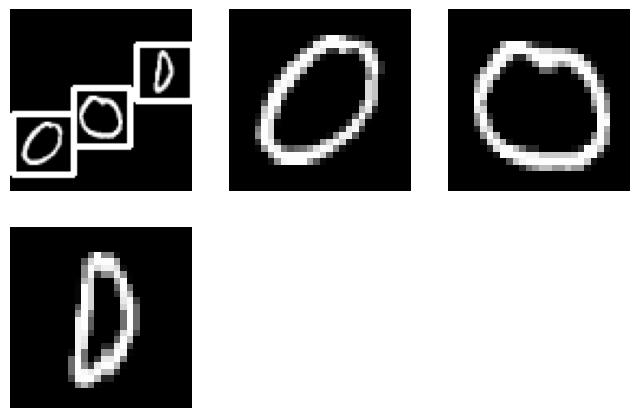

192000
60000
48000
(192000, 28, 28)
(60000, 28, 28)
(48000, 28, 28)
(192000,)
(60000,)
(48000,)
10
10
10


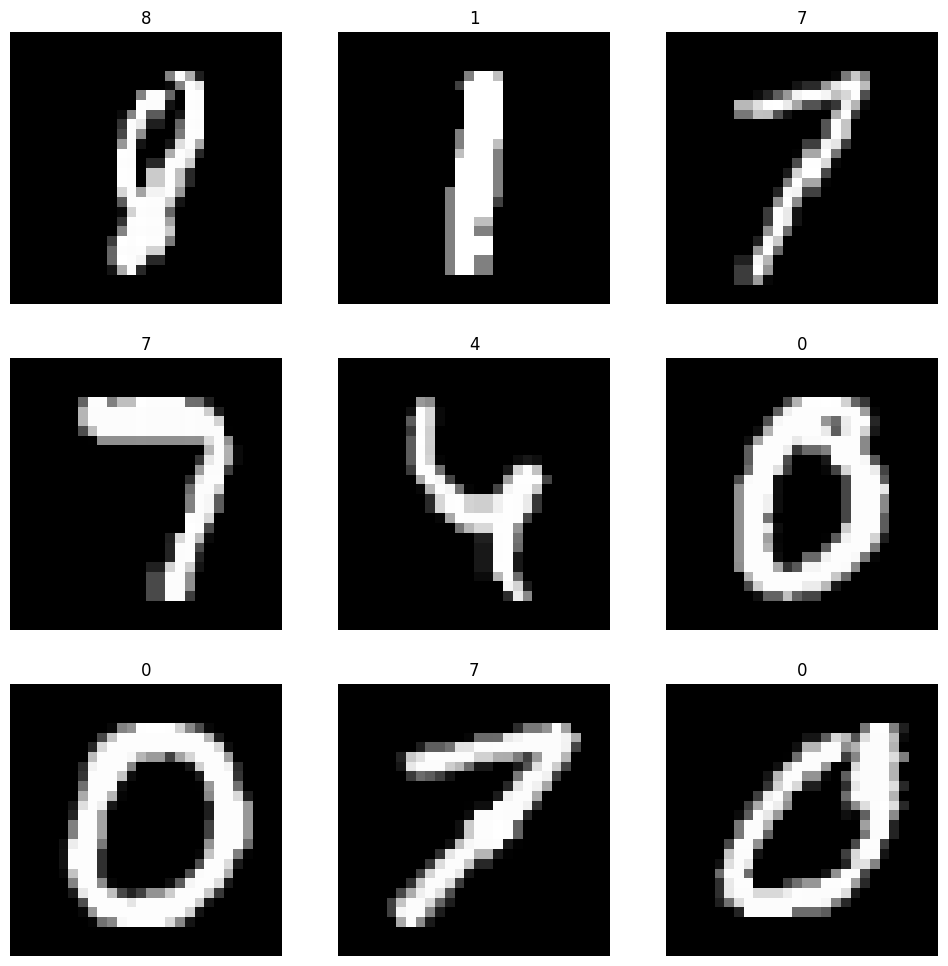

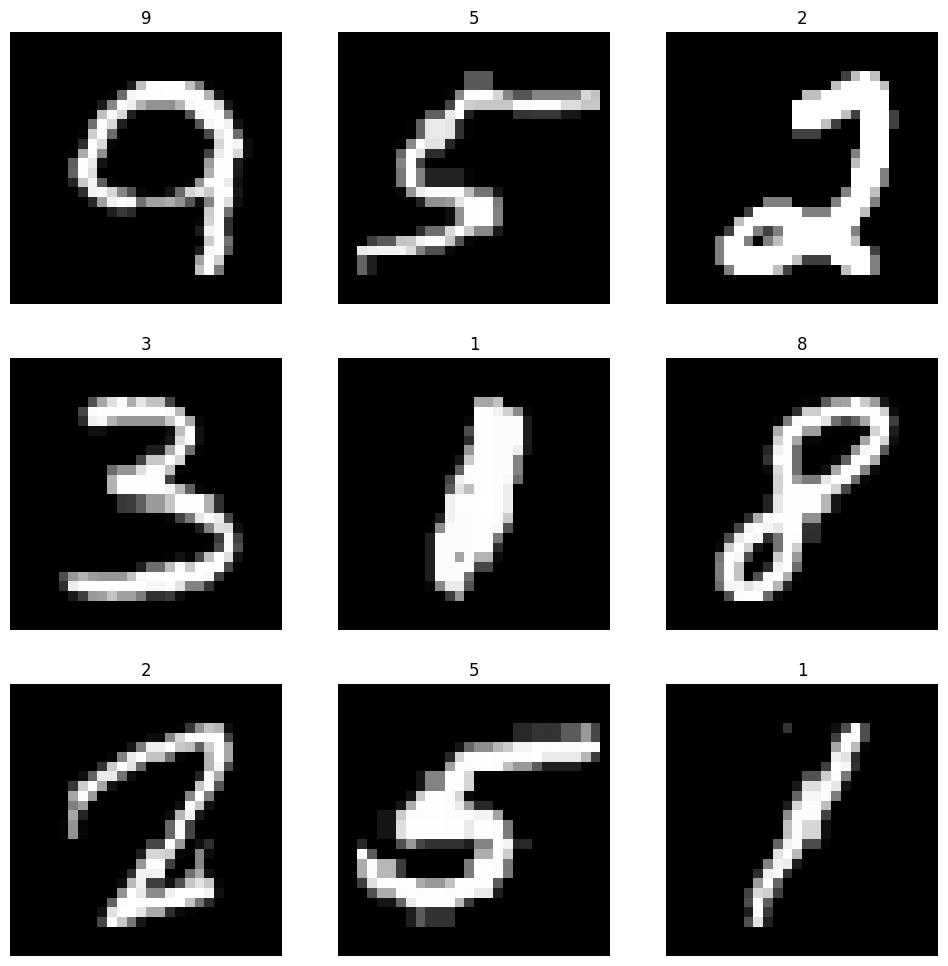

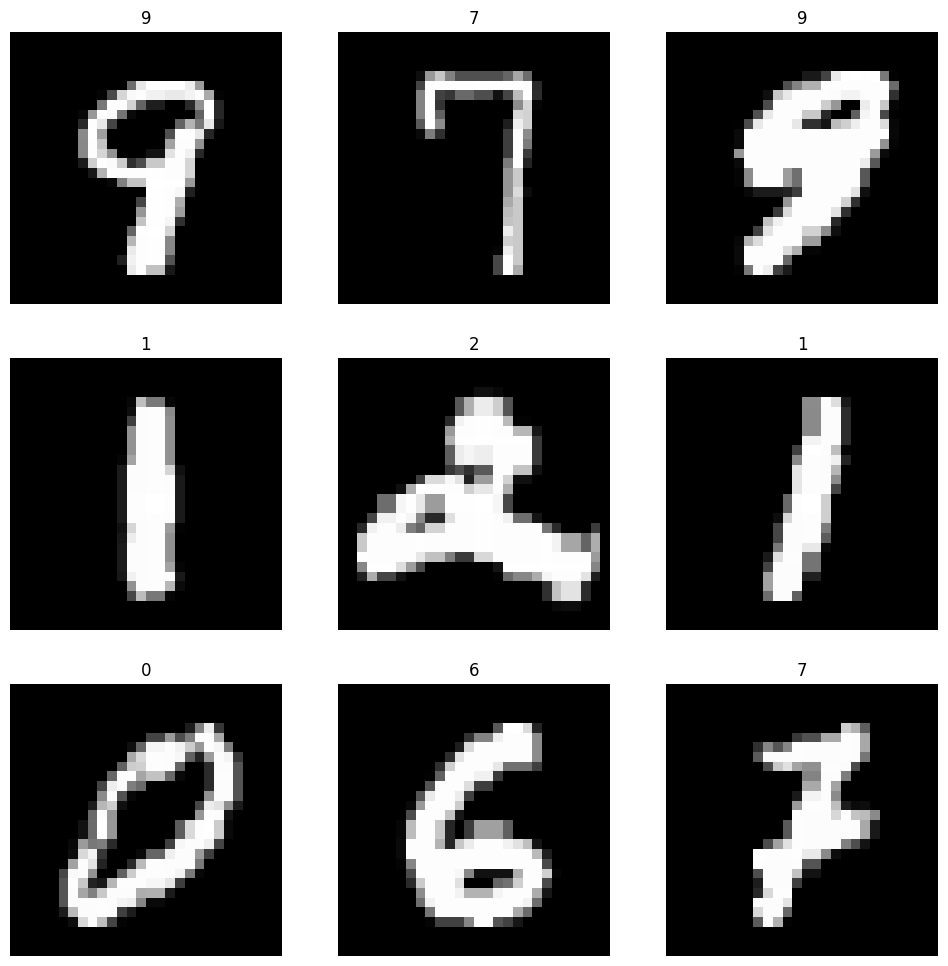

Training data shape: (192000, 28, 28, 1) (192000,)
Validation data shape: (48000, 28, 28, 1) (48000,)
Test data shape: (60000, 28, 28, 1) (60000,)


/usr/local/lib/python3.10/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/5
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 22s 3ms/step - accuracy: 0.8443 - auc_8: 0.9737 - loss: 0.5730 - precision_8: 0.9228 - recall_8: 0.7366 - val_accuracy: 0.9666 - val_auc_8: 0.9973 - val_loss: 0.1278 - val_precision_8: 0.9729 - val_recall_8: 0.9619
Epoch 2/5
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 17s 3ms/step - accuracy: 0.9708 - auc_8: 0.9980 - loss: 0.1101 - precision_8: 0.9770 - recall_8: 0.9657 - val_accuracy: 0.9765 - val_auc_8: 0.9982 - val_loss: 0.0898 - val_precision_8: 0.9809 - val_recall_8: 0.9731
Epoch 3/5
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 17s 3ms/step - accuracy: 0.9772 - auc_8: 0.9984 - loss: 0.0864 - precision_8: 0.9817 - recall_8: 0.9736 - val_accuracy: 0.9805 - val_auc_8: 0.9984 - val_loss: 0.0783 - val_precision_8: 0.9838 - val_recall_8: 0.9776
Epoch 4/5
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 17s 3ms/step - accuracy: 0.9800 - auc_8: 0.9987 - loss: 0.0736 - precision_8: 0.9839 - recall_8: 0.9774 - val_accuracy: 0.9808 - val_auc_8: 0.9985 - val_loss: 0.0765 - val_precision_8: 0.9841

Single Digits Validation loss: 0.06684380769729614
Single Digits Validation accuracy: 0.9825208187103271
Epoch 1/5
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 20s 3ms/step - accuracy: 0.9386 - auc_9: 0.9932 - loss: 0.2119 - precision_9: 0.9645 - recall_9: 0.9173 - val_accuracy: 0.9856 - val_auc_9: 0.9988 - val_loss: 0.0572 - val_precision_9: 0.9875 - val_recall_9: 0.9844
Epoch 2/5
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 17s 3ms/step - accuracy: 0.9881 - auc_9: 0.9992 - loss: 0.0457 - precision_9: 0.9901 - recall_9: 0.9867 - val_accuracy: 0.9912 - val_auc_9: 0.9992 - val_loss: 0.0388 - val_precision_9: 0.9930 - val_recall_9: 0.9900
Epoch 3/5
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 17s 3ms/step - accuracy: 0.9922 - auc_9: 0.9994 - loss: 0.0312 - precision_9: 0.9934 - recall_9: 0.9913 - val_accuracy: 0.9923 - val_auc_9: 0.9992 - val_loss: 0.0333 - val_precision_9: 0.9937 - val_recall_9: 0.9915
Epoch 4/5
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 17s 3ms/step - accuracy: 0.9939 - auc_9: 0.9996 - loss: 0.0241 - precision_9: 0.9951 -

Single Digits Validation loss: 0.027945691719651222
Single Digits Validation accuracy: 0.9940208196640015
Epoch 1/10
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 21s 3ms/step - accuracy: 0.8427 - auc_10: 0.9727 - loss: 0.5870 - precision_10: 0.9195 - recall_10: 0.7285 - val_accuracy: 0.9676 - val_auc_10: 0.9973 - val_loss: 0.1262 - val_precision_10: 0.9742 - val_recall_10: 0.9623
Epoch 2/10
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 17s 3ms/step - accuracy: 0.9709 - auc_10: 0.9978 - loss: 0.1121 - precision_10: 0.9767 - recall_10: 0.9660 - val_accuracy: 0.9776 - val_auc_10: 0.9982 - val_loss: 0.0881 - val_precision_10: 0.9817 - val_recall_10: 0.9738
Epoch 3/10
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 17s 3ms/step - accuracy: 0.9776 - auc_10: 0.9986 - loss: 0.0836 - precision_10: 0.9818 - recall_10: 0.9742 - val_accuracy: 0.9815 - val_auc_10: 0.9986 - val_loss: 0.0743 - val_precision_10: 0.9847 - val_recall_10: 0.9788
Epoch 4/10
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 17s 3ms/step - accuracy: 0.9808 - auc_10: 0.9988 - loss: 0.0718

Single Digits Validation loss: 0.028688296675682068
Single Digits Validation accuracy: 0.9945416450500488
Single Digits Best Hyperparameters (CNN): {'batch_size': 64, 'epochs': 10, 'learning_rate': 0.001}
Single Digits Best Accuracy Score (CNN): 0.9945416450500488


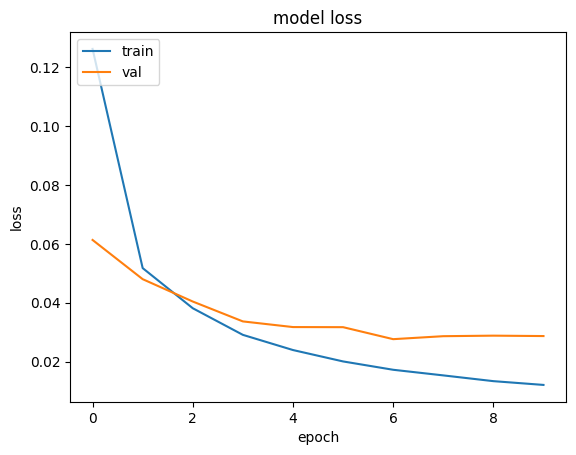

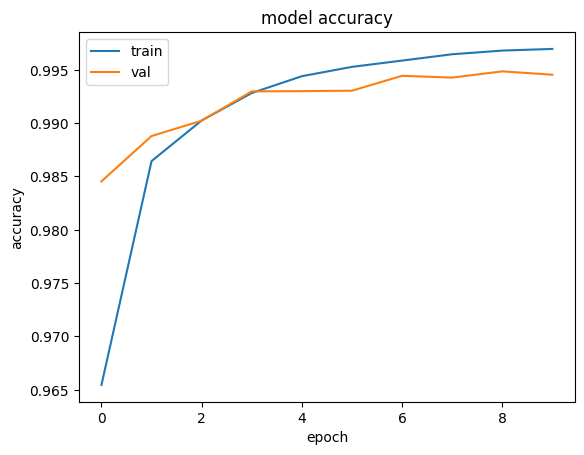

Single Digits Test loss: 0.02489466406404972
Single Digits Test accuracy: 0.9945833086967468
Single Digits Test precision: 0.9952783584594727
Single Digits Test recall: 0.9942333102226257
Single Digits Test AUC: 0.9993771314620972
single digit classific report
1875/1875 ━━━━━━━━━━━━━━━━━━━━ 3s 1ms/step
Classification Report (Single Digits):
              precision    recall  f1-score   support

           0     0.9986    0.9921    0.9953      6300
           1     0.9979    0.9953    0.9966      5800
           2     0.9863    0.9978    0.9920      4900
           3     0.9942    0.9962    0.9952      5800
           4     0.9919    0.9970    0.9944      6600
           5     0.9923    0.9945    0.9934      6700
           6     0.9969    0.9918    0.9944      6500
           7     0.9958    0.9932    0.9945      5000
           8     0.9973    0.9945    0.9959      6700
           9     0.9935    0.9940    0.9938      5700

    accuracy                         0.9946     60000
   macr

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


[[ 99   0   1   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0 

In [ ]:
#TASK-3 CNN with 3 distinct digits only bTCH NORMlızatıon
import tensorflow as tf
import tensorflow.keras as keras
from tensorflow.keras import layers, models
from sklearn.metrics import classification_report, confusion_matrix
import cv2
from tensorflow.keras import models, layers, optimizers, losses, metrics
##### SPLIT FUNCTION AND ITS DEMONSTRATION #####
digit_shape = (28, 28)
def crop_digits(img_path: str = None, im = None):
    #if im is None:
    #    im = cv2.imread(img_path)

    #gray = cv2.cvtColor(im, cv2.COLOR_BGR2GRAY)
    blur = cv2.GaussianBlur(img_path, (5, 5), 0)
    thresh = cv2.threshold(blur, 90, 255, cv2.THRESH_BINARY+cv2.THRESH_OTSU)[1]
    contours, hierarchy = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    digits = []
    rect = img_path.copy()
    for cnt in contours:
        x, y, w, h = cv2.boundingRect(cnt)
##########################################################666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666
        x = max(x - 3, 0)
        y = max(y - 3, 0)
        w += 6
        h += 6

        del_x = int(w / 2)
        del_y = int(h / 2)
        center_x = x + del_x
        center_y = y + del_y

        lu_corner = (max(center_x - del_y, 0), y)
        rd_corner = (max(center_x + del_y, 0), y + h)

        rect = cv2.rectangle(rect, lu_corner, rd_corner, (255, 0, 0), 2) #rectangle

        cropped = img_path[lu_corner[1]:rd_corner[1], lu_corner[0]:rd_corner[0]]
        digits.append(cropped)

    def filter_and_sort_digits(digits, contours):
        sizes = []
        for digit in digits:
            size = digit.shape[0] * digit.shape[1]
            sizes.append(size)
        avg_size = sum(sizes) / len(sizes)
        deviations = [abs(size - avg_size) for size in sizes]

        indices = np.argsort(deviations)[0:3]
        digits = [digits[i] for i in indices]
        contours = [cv2.boundingRect(contours[i]) for i in indices]

        xs = [contour[0] for contour in contours]
        indices = np.argsort(xs) #get highest likelihood digit
        digits = [digits[i] for i in indices]

        while len(digits) < 3:
            digits.append(digits[0])
        return digits

    digits = filter_and_sort_digits(digits, contours) #get highest likelihood digits
    digits = [cv2.resize(digit, digit_shape, interpolation = cv2.INTER_NEAREST) for digit in digits] #resize to 28,28

    return digits, contours, rect

print(f"Label: {train_labels[0]}")
print(train_labels[0][0])
print(train_labels[0][1])
print(train_labels[0][2])

fig = plt.figure(figsize=(8, 8))
cols, rows = 3, 3

digits, contours, rect = crop_digits(train_images[0])

fig.add_subplot(rows, cols, 1)
plt.axis("off")
plt.imshow(rect.squeeze(), cmap="gray")
for i in range(len(digits)):
    img = digits[i]
    print(train_labels[0][i])
    fig.add_subplot(rows, cols, i+2)
    plt.axis("off")
    plt.imshow(img.squeeze(), cmap="gray")
    print(f"crop shape: {img.shape}")
plt.show()


##### SPLIT ALL DATA TO DIGITS #####
def load_digits(images, labels):
  all_digits = []
  all_labels = []
  for i in range(len(images)):
    digits, contours, rect = crop_digits(images[i])
    for j in range(len(digits)):
      all_digits.append(digits[j])
      all_labels.append(labels[i][j])
  return np.array(all_digits), np.array(all_labels)

train_images, train_labels = load_digits(train_images, train_labels)
test_images_digits, test_labels_digits = load_digits(test_images, test_labels)
val_images, val_labels = load_digits(val_images, val_labels)
print(len(train_images))
print(len(test_images_digits))
print(len(val_images))
print(train_images.shape)
print(test_images_digits.shape)
print(val_images.shape)
print(train_labels.shape)
print(test_labels_digits.shape)
print(val_labels.shape)

print(len(np.unique(train_labels)))
print(len(np.unique(test_labels_digits)))
print(len(np.unique(val_labels)))

def visualize(images, labels):
  np.random.seed(42)
  random_indices = np.random.choice(len(images), size=9, replace=False)
  random_images = images[random_indices]
  random_labels = labels[random_indices]

  fig, axes = plt.subplots(3, 3, figsize=(12, 12))
  for i, (img, label) in enumerate(zip(random_images, random_labels)):
      ax = axes[i // 3, i % 3]
      ax.imshow(img, cmap='gray')
      ax.set_title(label)
      ax.axis('off')
  plt.show()

visualize(train_images, train_labels)
visualize(test_images_digits, test_labels_digits)
visualize(val_images, val_labels)

################################################################################################################################maxpooling iyii sionuc asssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssss
##### TRAIN CNN #####
train_images = train_images / 255.0
val_images = val_images / 255.0
test_images_digits = test_images_digits / 255.0

train_images = train_images.reshape((train_images.shape[0], 28, 28, 1))
val_images = val_images.reshape((val_images.shape[0], 28, 28, 1))
test_images_digits = test_images_digits.reshape((test_images_digits.shape[0], 28, 28, 1))

print('Training data shape:', train_images.shape, train_labels.shape)
print('Validation data shape:', val_images.shape, val_labels.shape)
print('Test data shape:', test_images_digits.shape, test_labels_digits.shape)

train_labels = tf.keras.utils.to_categorical(train_labels, num_classes=10)
val_labels = tf.keras.utils.to_categorical(val_labels, num_classes=10)
test_labels_digits = tf.keras.utils.to_categorical(test_labels_digits, num_classes=10)



# FOR TASK 4, NO HYPERPARAM SEARCH NEEDED!
param_grid_cnn = {
    'batch_size': [32,64],
    'epochs': [5,10],
    'learning_rate': [1e-4,1e-3],
    #'batch_size': [32],
    #'epochs': [7],
    #'learning_rate': [1e-2],
}

best_params_cnn = None
best_accuracy_cnn = -1
for batch_size in param_grid_cnn['batch_size']:
    for epochs in param_grid_cnn['epochs']:
        for learning_rate in param_grid_cnn['learning_rate']:
          model = models.Sequential()
          model.add(layers.Conv2D(32, (3, 3), activation='relu', input_shape=(28, 28, 1)))
          #model.add(layers.BatchNormalization()) #### FOR TASK 4
          model.add(layers.MaxPooling2D((2, 2)))
          model.add(layers.Conv2D(64, (3, 3), activation='relu'))
          #model.add(layers.BatchNormalization()) #### FOR TASK 4
          model.add(layers.MaxPooling2D((2, 2)))
          #model.add(layers.Conv2D(128, (3, 3), activation='relu')) #### FOR TASK 4
          #model.add(layers.BatchNormalization()) #### FOR TASK 4
          #model.add(layers.MaxPooling2D((2, 2))) #### FOR TASK 4
          model.add(layers.Flatten())
          #model.add(layers.Dropout(0.5)) #0.7 #### FOR TASK 4
          model.add(layers.Dense(10, activation='softmax'))
          model.compile(loss="categorical_crossentropy", optimizer=keras.optimizers.Adam(learning_rate=learning_rate), metrics=["accuracy", metrics.Precision(), metrics.Recall(), metrics.AUC()])


          history = model.fit(train_images, train_labels, batch_size=batch_size, epochs=epochs, validation_data=(val_images, val_labels))

          score_train = model.evaluate(train_images, train_labels, verbose=0)
          print("Single Digits Train loss:", score_train[0])
          print("Single Digits Train accuracy:", score_train[1])
          score_val = model.evaluate(val_images, val_labels, verbose=0)
          print("Single Digits Validation loss:", score_val[0])
          print("Single Digits Validation accuracy:", score_val[1])
          if score_val[1] > best_accuracy_cnn:
                  best_accuracy_cnn = score_val[1]
                  best_params_cnn = {'batch_size': batch_size, 'epochs': epochs, 'learning_rate':learning_rate}
                  model.save('best_model.h5')

print("Single Digits Best Hyperparameters (CNN):", best_params_cnn)
print("Single Digits Best Accuracy Score (CNN):", best_accuracy_cnn)
model = tf.keras.models.load_model('best_model.h5')
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

score = model.evaluate(test_images_digits, test_labels_digits, verbose=0)
print("Single Digits Test loss:", score[0])
print("Single Digits Test accuracy:", score[1])
print("Single Digits Test precision:", score[2])
print("Single Digits Test recall:", score[3])
print("Single Digits Test AUC:", score[4])
print("single digit classific report")
predictions_digits = model.predict(test_images_digits)
predicted_labels_digits = np.argmax(predictions_digits, axis=1)  # Convert predictions to class labels
true_labels_digits = np.argmax(test_labels_digits, axis=1)  # Convert one-hot encoded labels to class labels

# Print the classification report for single digits
print("Classification Report (Single Digits):")
print(classification_report(true_labels_digits, predicted_labels_digits, digits=4))

final_test_predictions = []
for i in range(len(test_images)):
  img = test_images[i]
  concat = ""
  for j in range(0,3):
    img_digit = test_images_digits[3*i + j]
    #prediction = model.predict_on_batch([img_digit])
    prediction = model.predict_on_batch(np.expand_dims(img_digit, axis=0))
    prediction = np.argmax(prediction)
    #print(prediction, test_labels[i])
    concat = concat + str(prediction)
  #print(concat, test_labels[i])
  final_test_predictions.append(concat)

np.set_printoptions(threshold=np.inf)

print("Classification Report:")
print(classification_report(test_labels, final_test_predictions, digits = 4))

print("\nConfusion Matrix:")
print(confusion_matrix(test_labels, final_test_predictions))



In [ ]:
print(len(val_images))
print(train_images.shape)
print(test_images.shape)
print(val_images.shape)
print(train_labels.shape)
print(test_labels.shape)
print(val_labels.shape)

16000
(64000, 84, 84)
(20000, 84, 84)
(16000, 84, 84)
(64000,)
(20000,)
(16000,)


# NORMAL FILTER 2 LAYER BATCH NORM

Label: 000
0
0
0
0
crop shape: (28, 28)
0
crop shape: (28, 28)
0
crop shape: (28, 28)


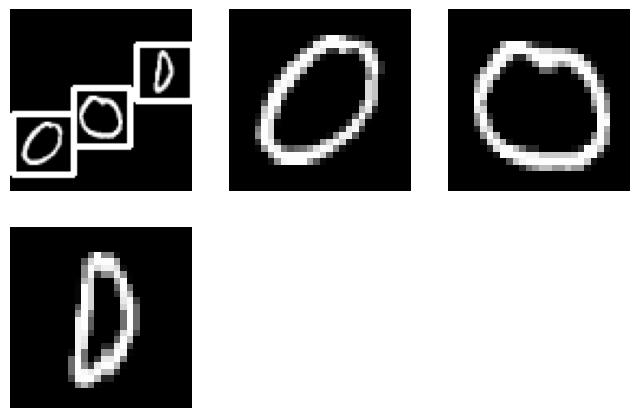

192000
60000
48000
(192000, 28, 28)
(60000, 28, 28)
(48000, 28, 28)
(192000,)
(60000,)
(48000,)
10
10
10


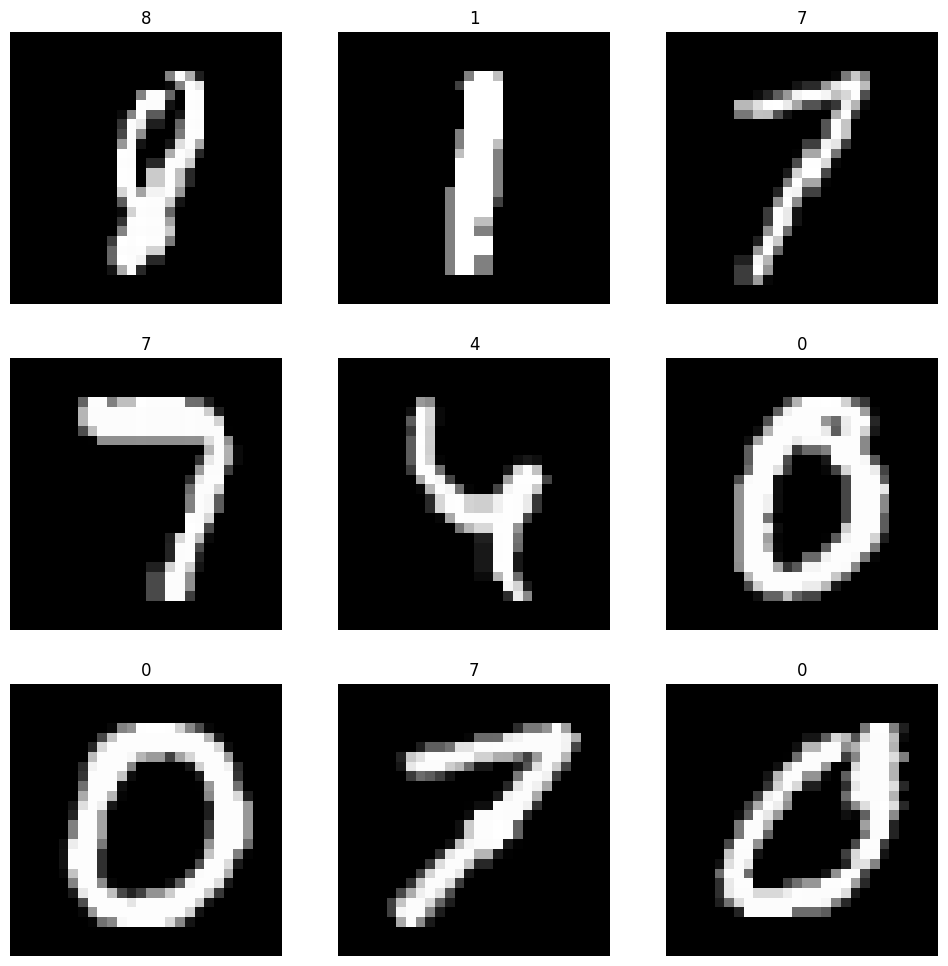

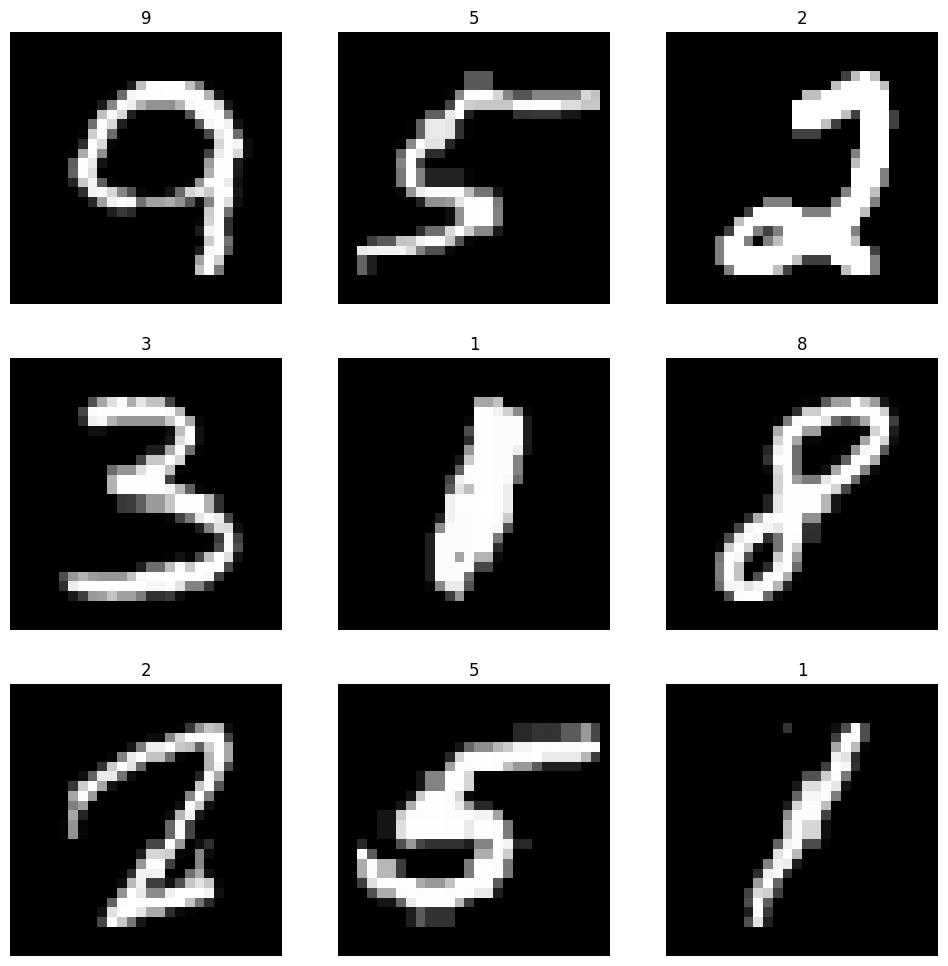

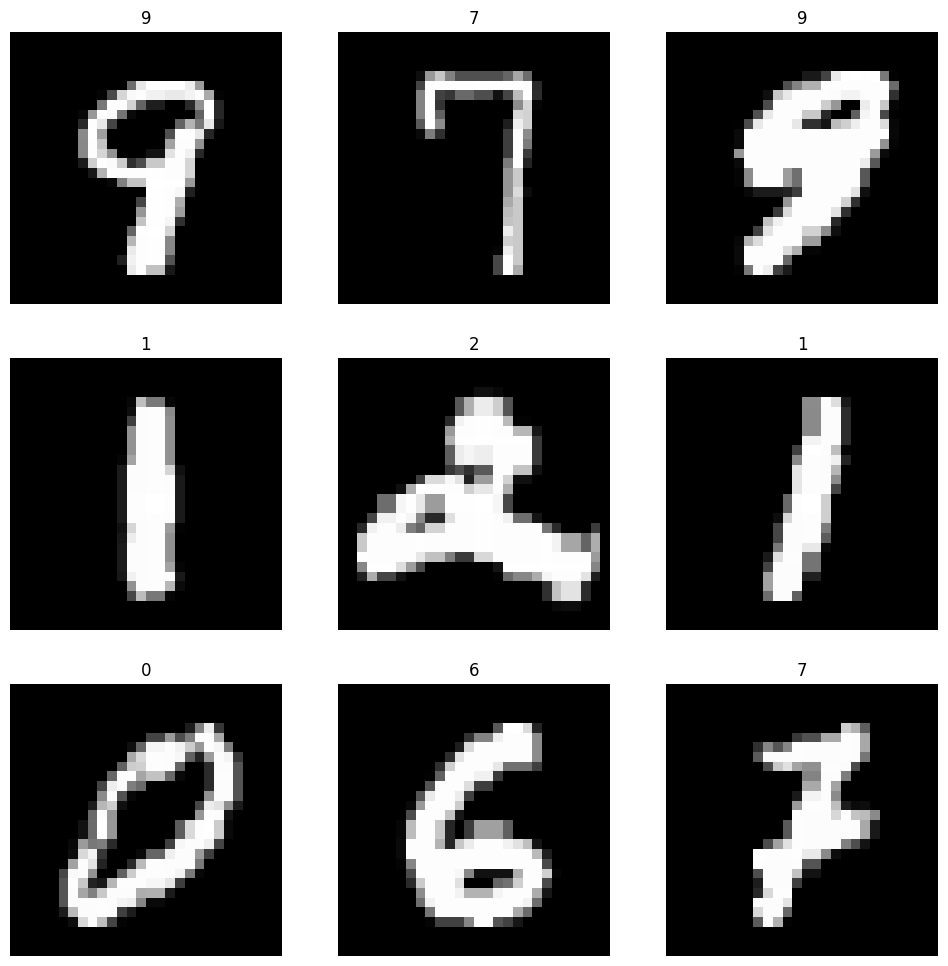

Training data shape: (192000, 28, 28, 1) (192000,)
Validation data shape: (48000, 28, 28, 1) (48000,)
Test data shape: (60000, 28, 28, 1) (60000,)


/usr/local/lib/python3.10/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/5
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 25s 4ms/step - accuracy: 0.9006 - auc: 0.9859 - loss: 0.3385 - precision: 0.9400 - recall: 0.8690 - val_accuracy: 0.9810 - val_auc: 0.9987 - val_loss: 0.0732 - val_precision: 0.9843 - val_recall: 0.9787
Epoch 2/5
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 18s 3ms/step - accuracy: 0.9855 - auc: 0.9991 - loss: 0.0568 - precision: 0.9880 - recall: 0.9833 - val_accuracy: 0.9877 - val_auc: 0.9990 - val_loss: 0.0508 - val_precision: 0.9898 - val_recall: 0.9860
Epoch 3/5
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 17s 3ms/step - accuracy: 0.9908 - auc: 0.9994 - loss: 0.0377 - precision: 0.9927 - recall: 0.9896 - val_accuracy: 0.9909 - val_auc: 0.9992 - val_loss: 0.0397 - val_precision: 0.9927 - val_recall: 0.9896
Epoch 4/5
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 18s 3ms/step - accuracy: 0.9931 - auc: 0.9995 - loss: 0.0288 - precision: 0.9948 - recall: 0.9921 - val_accuracy: 0.9919 - val_auc: 0.9992 - val_loss: 0.0360 - val_precision: 0.9933 - val_recall: 0.9911
Epoch 5/5
6000/6000 ━━━━

Single Digits Validation loss: 0.03277091309428215
Single Digits Validation accuracy: 0.9930416941642761
Epoch 1/5
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 23s 3ms/step - accuracy: 0.9559 - auc_1: 0.9949 - loss: 0.1611 - precision_1: 0.9645 - recall_1: 0.9508 - val_accuracy: 0.9852 - val_auc_1: 0.9985 - val_loss: 0.0591 - val_precision_1: 0.9867 - val_recall_1: 0.9844
Epoch 2/5
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 19s 3ms/step - accuracy: 0.9876 - auc_1: 0.9989 - loss: 0.0470 - precision_1: 0.9893 - recall_1: 0.9869 - val_accuracy: 0.9863 - val_auc_1: 0.9988 - val_loss: 0.0531 - val_precision_1: 0.9879 - val_recall_1: 0.9854
Epoch 3/5
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 19s 3ms/step - accuracy: 0.9917 - auc_1: 0.9994 - loss: 0.0316 - precision_1: 0.9932 - recall_1: 0.9911 - val_accuracy: 0.9906 - val_auc_1: 0.9992 - val_loss: 0.0374 - val_precision_1: 0.9918 - val_recall_1: 0.9899
Epoch 4/5
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 19s 3ms/step - accuracy: 0.9939 - auc_1: 0.9996 - loss: 0.0239 - precision_1: 0.9951 -

Single Digits Validation loss: 0.029089782387018204
Single Digits Validation accuracy: 0.9936875104904175
Epoch 1/10
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 23s 3ms/step - accuracy: 0.9028 - auc_2: 0.9857 - loss: 0.3363 - precision_2: 0.9399 - recall_2: 0.8749 - val_accuracy: 0.9822 - val_auc_2: 0.9987 - val_loss: 0.0691 - val_precision_2: 0.9854 - val_recall_2: 0.9799
Epoch 2/10
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 18s 3ms/step - accuracy: 0.9849 - auc_2: 0.9991 - loss: 0.0576 - precision_2: 0.9877 - recall_2: 0.9826 - val_accuracy: 0.9879 - val_auc_2: 0.9990 - val_loss: 0.0504 - val_precision_2: 0.9901 - val_recall_2: 0.9862
Epoch 3/10
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 18s 3ms/step - accuracy: 0.9907 - auc_2: 0.9994 - loss: 0.0389 - precision_2: 0.9926 - recall_2: 0.9894 - val_accuracy: 0.9901 - val_auc_2: 0.9991 - val_loss: 0.0413 - val_precision_2: 0.9920 - val_recall_2: 0.9892
Epoch 4/10
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 18s 3ms/step - accuracy: 0.9934 - auc_2: 0.9995 - loss: 0.0282 - precision_2: 0.9

Single Digits Validation loss: 0.027669085189700127
Single Digits Validation accuracy: 0.9950833320617676
Epoch 1/10
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 23s 3ms/step - accuracy: 0.9564 - auc_3: 0.9955 - loss: 0.1550 - precision_3: 0.9653 - recall_3: 0.9507 - val_accuracy: 0.9797 - val_auc_3: 0.9982 - val_loss: 0.0761 - val_precision_3: 0.9819 - val_recall_3: 0.9789
Epoch 2/10
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 18s 3ms/step - accuracy: 0.9882 - auc_3: 0.9990 - loss: 0.0451 - precision_3: 0.9897 - recall_3: 0.9874 - val_accuracy: 0.9889 - val_auc_3: 0.9989 - val_loss: 0.0448 - val_precision_3: 0.9905 - val_recall_3: 0.9881
Epoch 3/10
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 18s 3ms/step - accuracy: 0.9919 - auc_3: 0.9994 - loss: 0.0301 - precision_3: 0.9931 - recall_3: 0.9911 - val_accuracy: 0.9911 - val_auc_3: 0.9990 - val_loss: 0.0381 - val_precision_3: 0.9922 - val_recall_3: 0.9907
Epoch 4/10
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 18s 3ms/step - accuracy: 0.9933 - auc_3: 0.9996 - loss: 0.0242 - precision_3: 0.9

Single Digits Validation loss: 0.029867710545659065
Single Digits Validation accuracy: 0.9946249723434448
Single Digits Best Hyperparameters (CNN): {'batch_size': 32, 'epochs': 10, 'learning_rate': 0.0001}
Single Digits Best Accuracy Score (CNN): 0.9950833320617676


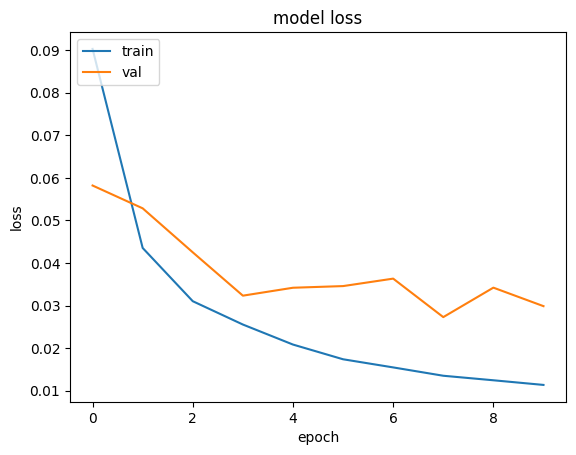

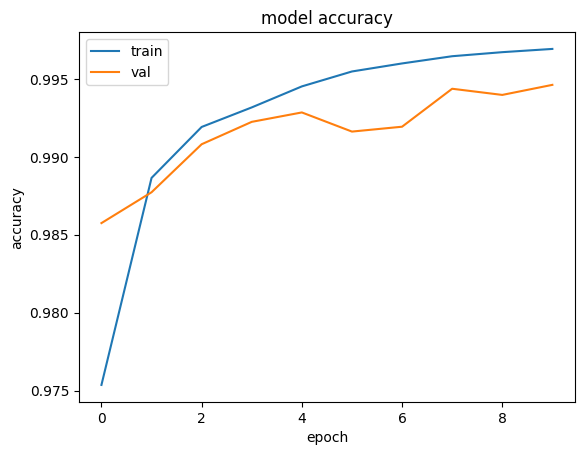

Single Digits Test loss: 0.021804124116897583
Single Digits Test accuracy: 0.9956833124160767
Single Digits Test precision: 0.9961974024772644
Single Digits Test recall: 0.9955166578292847
Single Digits Test AUC: 0.9993687272071838
single digit classific report
1875/1875 ━━━━━━━━━━━━━━━━━━━━ 3s 1ms/step
Classification Report (Single Digits):
              precision    recall  f1-score   support

           0     0.9984    0.9971    0.9978      6300
           1     0.9972    0.9981    0.9977      5800
           2     0.9923    0.9961    0.9942      4900
           3     0.9938    0.9948    0.9943      5800
           4     0.9967    0.9958    0.9962      6600
           5     0.9945    0.9927    0.9936      6700
           6     0.9952    0.9965    0.9958      6500
           7     0.9930    0.9956    0.9943      5000
           8     0.9976    0.9957    0.9966      6700
           9     0.9968    0.9947    0.9958      5700

    accuracy                         0.9957     60000
   mac

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


[[100   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0 

In [ ]:
#TASK-3 CNN with 3 distinct digits only bTCH NORMlızatıon
import tensorflow as tf
import tensorflow.keras as keras
from tensorflow.keras import layers, models
from sklearn.metrics import classification_report, confusion_matrix
import cv2
from tensorflow.keras import models, layers, optimizers, losses, metrics
##### SPLIT FUNCTION AND ITS DEMONSTRATION #####
digit_shape = (28, 28)
def crop_digits(img_path: str = None, im = None):
    #if im is None:
    #    im = cv2.imread(img_path)

    #gray = cv2.cvtColor(im, cv2.COLOR_BGR2GRAY)
    blur = cv2.GaussianBlur(img_path, (5, 5), 0)
    thresh = cv2.threshold(blur, 90, 255, cv2.THRESH_BINARY+cv2.THRESH_OTSU)[1]
    contours, hierarchy = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    digits = []
    rect = img_path.copy()
    for cnt in contours:
        x, y, w, h = cv2.boundingRect(cnt)
##########################################################666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666
        x = max(x - 3, 0)
        y = max(y - 3, 0)
        w += 6
        h += 6

        del_x = int(w / 2)
        del_y = int(h / 2)
        center_x = x + del_x
        center_y = y + del_y

        lu_corner = (max(center_x - del_y, 0), y)
        rd_corner = (max(center_x + del_y, 0), y + h)

        rect = cv2.rectangle(rect, lu_corner, rd_corner, (255, 0, 0), 2) #rectangle

        cropped = img_path[lu_corner[1]:rd_corner[1], lu_corner[0]:rd_corner[0]]
        digits.append(cropped)

    def filter_and_sort_digits(digits, contours):
        sizes = []
        for digit in digits:
            size = digit.shape[0] * digit.shape[1]
            sizes.append(size)
        avg_size = sum(sizes) / len(sizes)
        deviations = [abs(size - avg_size) for size in sizes]

        indices = np.argsort(deviations)[0:3]
        digits = [digits[i] for i in indices]
        contours = [cv2.boundingRect(contours[i]) for i in indices]

        xs = [contour[0] for contour in contours]
        indices = np.argsort(xs) #get highest likelihood digit
        digits = [digits[i] for i in indices]

        while len(digits) < 3:
            digits.append(digits[0])
        return digits

    digits = filter_and_sort_digits(digits, contours) #get highest likelihood digits
    digits = [cv2.resize(digit, digit_shape, interpolation = cv2.INTER_NEAREST) for digit in digits] #resize to 28,28

    return digits, contours, rect

print(f"Label: {train_labels[0]}")
print(train_labels[0][0])
print(train_labels[0][1])
print(train_labels[0][2])

fig = plt.figure(figsize=(8, 8))
cols, rows = 3, 3

digits, contours, rect = crop_digits(train_images[0])

fig.add_subplot(rows, cols, 1)
plt.axis("off")
plt.imshow(rect.squeeze(), cmap="gray")
for i in range(len(digits)):
    img = digits[i]
    print(train_labels[0][i])
    fig.add_subplot(rows, cols, i+2)
    plt.axis("off")
    plt.imshow(img.squeeze(), cmap="gray")
    print(f"crop shape: {img.shape}")
plt.show()


##### SPLIT ALL DATA TO DIGITS #####
def load_digits(images, labels):
  all_digits = []
  all_labels = []
  for i in range(len(images)):
    digits, contours, rect = crop_digits(images[i])
    for j in range(len(digits)):
      all_digits.append(digits[j])
      all_labels.append(labels[i][j])
  return np.array(all_digits), np.array(all_labels)

train_images, train_labels = load_digits(train_images, train_labels)
test_images_digits, test_labels_digits = load_digits(test_images, test_labels)
val_images, val_labels = load_digits(val_images, val_labels)
print(len(train_images))
print(len(test_images_digits))
print(len(val_images))
print(train_images.shape)
print(test_images_digits.shape)
print(val_images.shape)
print(train_labels.shape)
print(test_labels_digits.shape)
print(val_labels.shape)

print(len(np.unique(train_labels)))
print(len(np.unique(test_labels_digits)))
print(len(np.unique(val_labels)))

def visualize(images, labels):
  np.random.seed(42)
  random_indices = np.random.choice(len(images), size=9, replace=False)
  random_images = images[random_indices]
  random_labels = labels[random_indices]

  fig, axes = plt.subplots(3, 3, figsize=(12, 12))
  for i, (img, label) in enumerate(zip(random_images, random_labels)):
      ax = axes[i // 3, i % 3]
      ax.imshow(img, cmap='gray')
      ax.set_title(label)
      ax.axis('off')
  plt.show()

visualize(train_images, train_labels)
visualize(test_images_digits, test_labels_digits)
visualize(val_images, val_labels)

################################################################################################################################maxpooling iyii sionuc asssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssss
##### TRAIN CNN #####
train_images = train_images / 255.0
val_images = val_images / 255.0
test_images_digits = test_images_digits / 255.0

train_images = train_images.reshape((train_images.shape[0], 28, 28, 1))
val_images = val_images.reshape((val_images.shape[0], 28, 28, 1))
test_images_digits = test_images_digits.reshape((test_images_digits.shape[0], 28, 28, 1))

print('Training data shape:', train_images.shape, train_labels.shape)
print('Validation data shape:', val_images.shape, val_labels.shape)
print('Test data shape:', test_images_digits.shape, test_labels_digits.shape)

train_labels = tf.keras.utils.to_categorical(train_labels, num_classes=10)
val_labels = tf.keras.utils.to_categorical(val_labels, num_classes=10)
test_labels_digits = tf.keras.utils.to_categorical(test_labels_digits, num_classes=10)



# FOR TASK 4, NO HYPERPARAM SEARCH NEEDED!
param_grid_cnn = {
    'batch_size': [32,64],
    'epochs': [5,10],
    'learning_rate': [1e-4,1e-3],
    #'batch_size': [32],
    #'epochs': [7],
    #'learning_rate': [1e-2],
}

best_params_cnn = None
best_accuracy_cnn = -1
for batch_size in param_grid_cnn['batch_size']:
    for epochs in param_grid_cnn['epochs']:
        for learning_rate in param_grid_cnn['learning_rate']:
          model = models.Sequential()
          model.add(layers.Conv2D(32, (3, 3), activation='relu', input_shape=(28, 28, 1)))
          model.add(layers.BatchNormalization()) #### FOR TASK 4
          model.add(layers.MaxPooling2D((2, 2)))
          model.add(layers.Conv2D(64, (3, 3), activation='relu'))
          model.add(layers.BatchNormalization()) #### FOR TASK 4
          model.add(layers.MaxPooling2D((2, 2)))
          #model.add(layers.Conv2D(128, (3, 3), activation='relu')) #### FOR TASK 4
          #model.add(layers.BatchNormalization()) #### FOR TASK 4
          #model.add(layers.MaxPooling2D((2, 2))) #### FOR TASK 4
          model.add(layers.Flatten())
          #model.add(layers.Dropout(0.5)) #0.7 #### FOR TASK 4
          model.add(layers.Dense(10, activation='softmax'))
          model.compile(loss="categorical_crossentropy", optimizer=keras.optimizers.Adam(learning_rate=learning_rate), metrics=["accuracy", metrics.Precision(), metrics.Recall(), metrics.AUC()])


          history = model.fit(train_images, train_labels, batch_size=batch_size, epochs=epochs, validation_data=(val_images, val_labels))

          score_train = model.evaluate(train_images, train_labels, verbose=0)
          print("Single Digits Train loss:", score_train[0])
          print("Single Digits Train accuracy:", score_train[1])
          score_val = model.evaluate(val_images, val_labels, verbose=0)
          print("Single Digits Validation loss:", score_val[0])
          print("Single Digits Validation accuracy:", score_val[1])
          if score_val[1] > best_accuracy_cnn:
                  best_accuracy_cnn = score_val[1]
                  best_params_cnn = {'batch_size': batch_size, 'epochs': epochs, 'learning_rate':learning_rate}
                  model.save('best_model.h5')

print("Single Digits Best Hyperparameters (CNN):", best_params_cnn)
print("Single Digits Best Accuracy Score (CNN):", best_accuracy_cnn)
model = tf.keras.models.load_model('best_model.h5')
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

score = model.evaluate(test_images_digits, test_labels_digits, verbose=0)
print("Single Digits Test loss:", score[0])
print("Single Digits Test accuracy:", score[1])
print("Single Digits Test precision:", score[2])
print("Single Digits Test recall:", score[3])
print("Single Digits Test AUC:", score[4])
print("single digit classific report")
predictions_digits = model.predict(test_images_digits)
predicted_labels_digits = np.argmax(predictions_digits, axis=1)  # Convert predictions to class labels
true_labels_digits = np.argmax(test_labels_digits, axis=1)  # Convert one-hot encoded labels to class labels

# Print the classification report for single digits
print("Classification Report (Single Digits):")
print(classification_report(true_labels_digits, predicted_labels_digits, digits=4))

final_test_predictions = []
for i in range(len(test_images)):
  img = test_images[i]
  concat = ""
  for j in range(0,3):
    img_digit = test_images_digits[3*i + j]
    #prediction = model.predict_on_batch([img_digit])
    prediction = model.predict_on_batch(np.expand_dims(img_digit, axis=0))
    prediction = np.argmax(prediction)
    #print(prediction, test_labels[i])
    concat = concat + str(prediction)
  #print(concat, test_labels[i])
  final_test_predictions.append(concat)

np.set_printoptions(threshold=np.inf)

print("Classification Report:")
print(classification_report(test_labels, final_test_predictions, digits = 4))

print("\nConfusion Matrix:")
print(confusion_matrix(test_labels, final_test_predictions))



# NORMAL FILTRE 3 LAYER BATCH NORM

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from google.colab import drive
drive.mount('/content/drive')
test_images = np.load('/content/drive/MyDrive/npy_2/np_save_test_images_2.npy')
test_labels = np.load('/content/drive/MyDrive/npy_2/np_save_test_labels_2.npy')
val_images = np.load('/content/drive/MyDrive/npy_2/np_save_val_images_2.npy')
val_labels = np.load('/content/drive/MyDrive/npy_2/np_save_val_labels_2.npy')
train_images = np.load('/content/drive/MyDrive/npy_2/np_save_train_images_2.npy')
train_labels = np.load('/content/drive/MyDrive/npy_2/np_save_train_labels_2.npy')

Mounted at /content/drive


Label: 000
0
0
0
0
crop shape: (28, 28)
0
crop shape: (28, 28)
0
crop shape: (28, 28)


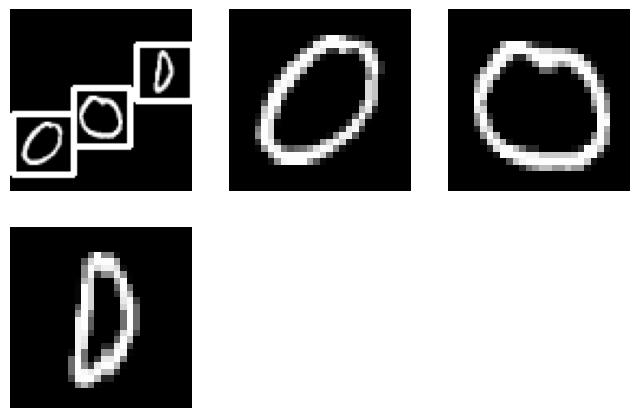

192000
60000
48000
(192000, 28, 28)
(60000, 28, 28)
(48000, 28, 28)
(192000,)
(60000,)
(48000,)
10
10
10


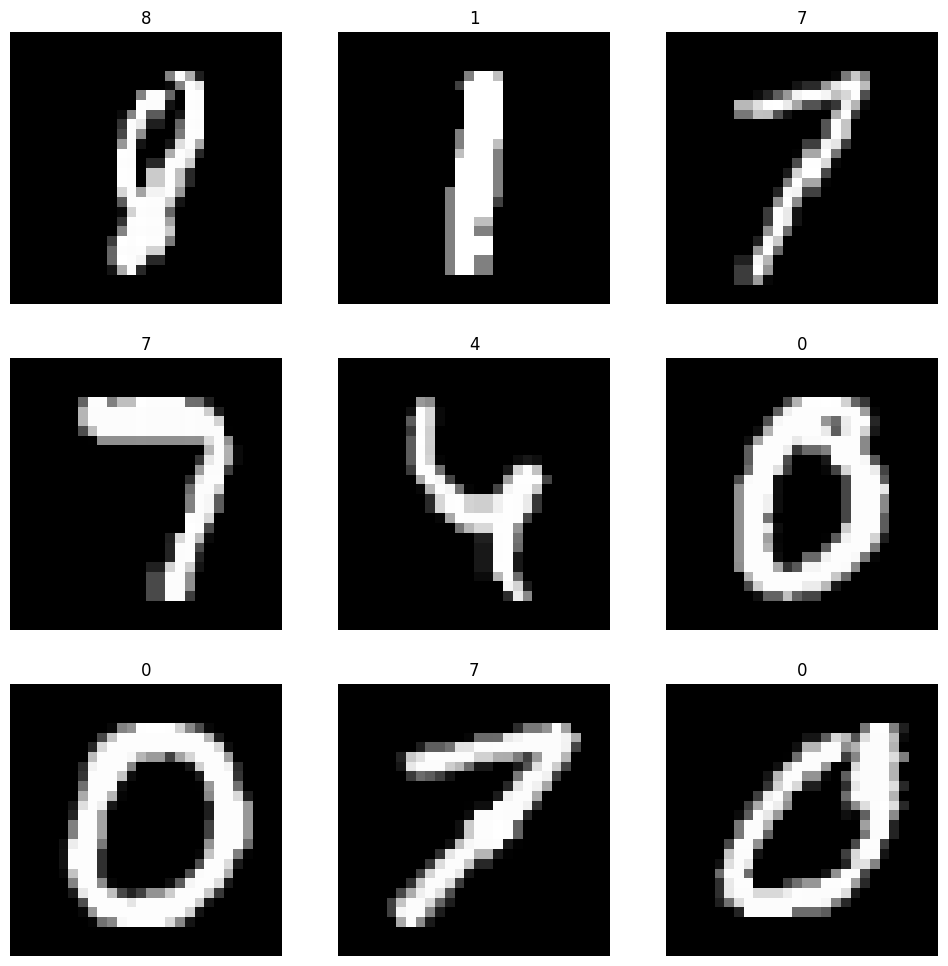

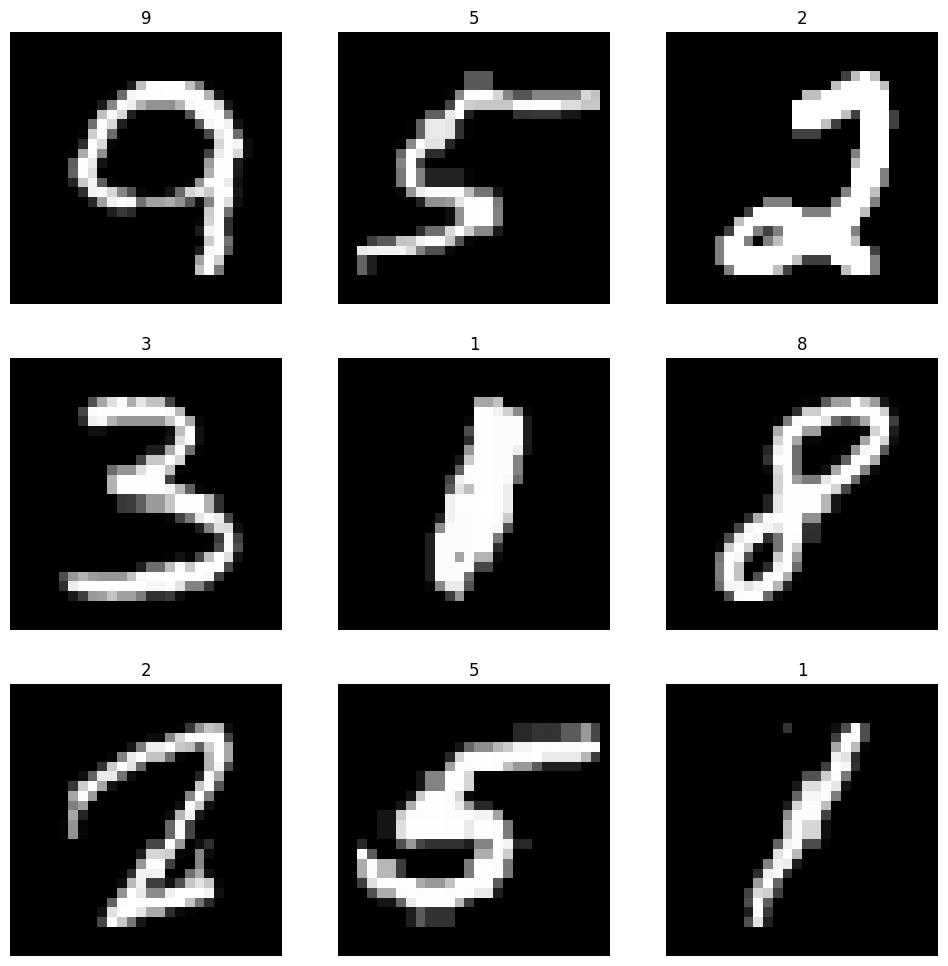

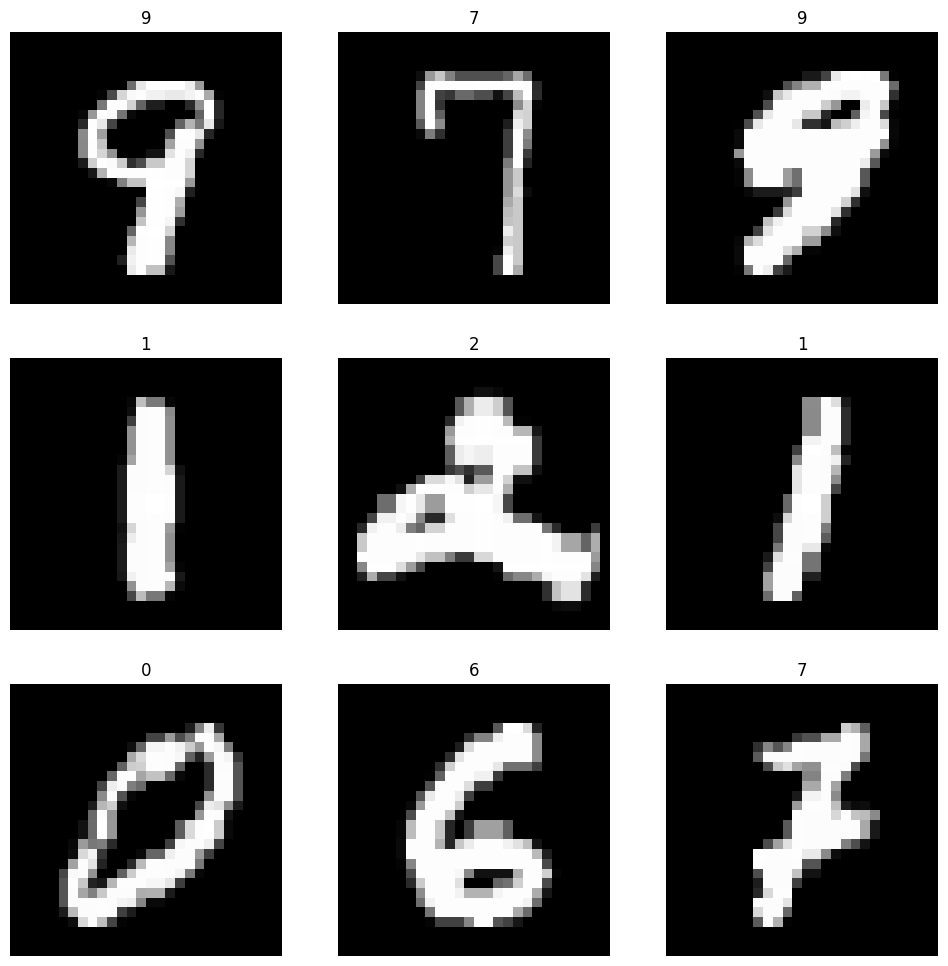

Training data shape: (192000, 28, 28, 1) (192000,)
Validation data shape: (48000, 28, 28, 1) (48000,)
Test data shape: (60000, 28, 28, 1) (60000,)


/usr/local/lib/python3.10/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/5
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 26s 3ms/step - accuracy: 0.8977 - auc: 0.9859 - loss: 0.3473 - precision: 0.9309 - recall: 0.8714 - val_accuracy: 0.9804 - val_auc: 0.9989 - val_loss: 0.0736 - val_precision: 0.9844 - val_recall: 0.9769
Epoch 2/5
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 17s 3ms/step - accuracy: 0.9832 - auc: 0.9991 - loss: 0.0613 - precision: 0.9867 - recall: 0.9808 - val_accuracy: 0.9866 - val_auc: 0.9991 - val_loss: 0.0537 - val_precision: 0.9892 - val_recall: 0.9847
Epoch 3/5
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 18s 3ms/step - accuracy: 0.9891 - auc: 0.9994 - loss: 0.0408 - precision: 0.9915 - recall: 0.9873 - val_accuracy: 0.9907 - val_auc: 0.9992 - val_loss: 0.0391 - val_precision: 0.9926 - val_recall: 0.9895
Epoch 4/5
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 18s 3ms/step - accuracy: 0.9926 - auc: 0.9996 - loss: 0.0283 - precision: 0.9942 - recall: 0.9916 - val_accuracy: 0.9911 - val_auc: 0.9993 - val_loss: 0.0358 - val_precision: 0.9928 - val_recall: 0.9906
Epoch 5/5
6000/6000 ━━━━

Single Digits Validation loss: 0.03157920017838478
Single Digits Validation accuracy: 0.9927708506584167
Epoch 1/5
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 23s 3ms/step - accuracy: 0.9491 - auc_1: 0.9954 - loss: 0.1730 - precision_1: 0.9618 - recall_1: 0.9392 - val_accuracy: 0.9774 - val_auc_1: 0.9988 - val_loss: 0.0772 - val_precision_1: 0.9808 - val_recall_1: 0.9753
Epoch 2/5
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 18s 3ms/step - accuracy: 0.9857 - auc_1: 0.9992 - loss: 0.0507 - precision_1: 0.9879 - recall_1: 0.9843 - val_accuracy: 0.9885 - val_auc_1: 0.9991 - val_loss: 0.0431 - val_precision_1: 0.9908 - val_recall_1: 0.9875
Epoch 3/5
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 18s 3ms/step - accuracy: 0.9908 - auc_1: 0.9996 - loss: 0.0333 - precision_1: 0.9928 - recall_1: 0.9898 - val_accuracy: 0.9888 - val_auc_1: 0.9992 - val_loss: 0.0429 - val_precision_1: 0.9910 - val_recall_1: 0.9877
Epoch 4/5
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 18s 3ms/step - accuracy: 0.9929 - auc_1: 0.9997 - loss: 0.0250 - precision_1: 0.9945 -

Single Digits Validation loss: 0.032264210283756256
Single Digits Validation accuracy: 0.9937499761581421
Epoch 1/10
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 22s 3ms/step - accuracy: 0.9503 - auc_3: 0.9956 - loss: 0.1666 - precision_3: 0.9621 - recall_3: 0.9418 - val_accuracy: 0.9846 - val_auc_3: 0.9989 - val_loss: 0.0554 - val_precision_3: 0.9879 - val_recall_3: 0.9830
Epoch 2/10
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 17s 3ms/step - accuracy: 0.9854 - auc_3: 0.9992 - loss: 0.0514 - precision_3: 0.9877 - recall_3: 0.9838 - val_accuracy: 0.9861 - val_auc_3: 0.9992 - val_loss: 0.0513 - val_precision_3: 0.9885 - val_recall_3: 0.9848
Epoch 3/10
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 17s 3ms/step - accuracy: 0.9904 - auc_3: 0.9996 - loss: 0.0330 - precision_3: 0.9925 - recall_3: 0.9893 - val_accuracy: 0.9901 - val_auc_3: 0.9991 - val_loss: 0.0382 - val_precision_3: 0.9917 - val_recall_3: 0.9895
Epoch 4/10
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 17s 3ms/step - accuracy: 0.9928 - auc_3: 0.9997 - loss: 0.0255 - precision_3: 0.9

Single Digits Validation loss: 0.030343972146511078
Single Digits Validation accuracy: 0.9943125247955322
Epoch 1/5
3000/3000 ━━━━━━━━━━━━━━━━━━━━ 16s 4ms/step - accuracy: 0.8622 - auc_4: 0.9781 - loss: 0.4593 - precision_4: 0.9104 - recall_4: 0.8250 - val_accuracy: 0.9745 - val_auc_4: 0.9986 - val_loss: 0.0913 - val_precision_4: 0.9807 - val_recall_4: 0.9698
Epoch 2/5
3000/3000 ━━━━━━━━━━━━━━━━━━━━ 10s 3ms/step - accuracy: 0.9806 - auc_4: 0.9990 - loss: 0.0703 - precision_4: 0.9849 - recall_4: 0.9770 - val_accuracy: 0.9846 - val_auc_4: 0.9991 - val_loss: 0.0583 - val_precision_4: 0.9874 - val_recall_4: 0.9824
Epoch 3/5
3000/3000 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/step - accuracy: 0.9888 - auc_4: 0.9994 - loss: 0.0449 - precision_4: 0.9913 - recall_4: 0.9868 - val_accuracy: 0.9890 - val_auc_4: 0.9992 - val_loss: 0.0442 - val_precision_4: 0.9911 - val_recall_4: 0.9877
Epoch 4/5
3000/3000 ━━━━━━━━━━━━━━━━━━━━ 10s 3ms/step - accuracy: 0.9929 - auc_4: 0.9996 - loss: 0.0310 - precision_4: 0.9944 -

Single Digits Validation loss: 0.0298218484967947
Single Digits Validation accuracy: 0.9942708611488342
Single Digits Best Hyperparameters (CNN): {'batch_size': 32, 'epochs': 10, 'learning_rate': 0.001}
Single Digits Best Accuracy Score (CNN): 0.9943125247955322


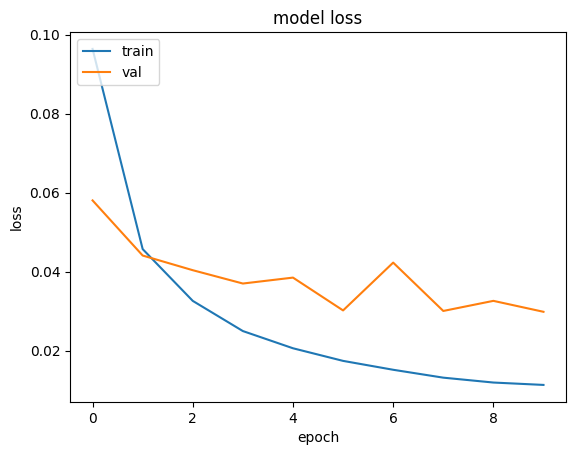

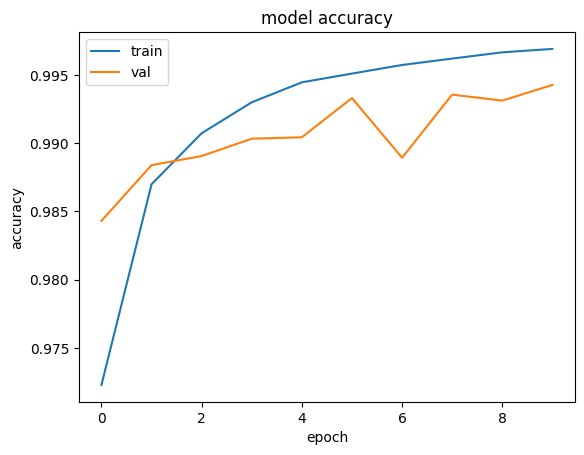

Single Digits Test loss: 0.023740598931908607
Single Digits Test accuracy: 0.9950666427612305
Single Digits Test precision: 0.995795488357544
Single Digits Test recall: 0.9947333335876465
Single Digits Test AUC: 0.9993342161178589
single digit classific report
1875/1875 ━━━━━━━━━━━━━━━━━━━━ 3s 1ms/step
Classification Report (Single Digits):
              precision    recall  f1-score   support

           0     0.9979    0.9960    0.9970      6300
           1     0.9972    0.9974    0.9973      5800
           2     0.9870    0.9933    0.9901      4900
           3     0.9911    0.9966    0.9938      5800
           4     0.9976    0.9967    0.9971      6600
           5     0.9954    0.9921    0.9937      6700
           6     0.9957    0.9966    0.9962      6500
           7     0.9950    0.9900    0.9925      5000
           8     0.9945    0.9961    0.9953      6700
           9     0.9975    0.9947    0.9961      5700

    accuracy                         0.9951     60000
   macr

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


[[100   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0 

In [ ]:
#TASK-3 CNN with 3 distinct digits only bTCH NORMlızatıon
import tensorflow as tf
import tensorflow.keras as keras
from tensorflow.keras import layers, models
from sklearn.metrics import classification_report, confusion_matrix
import cv2
from tensorflow.keras import models, layers, optimizers, losses, metrics
##### SPLIT FUNCTION AND ITS DEMONSTRATION #####
digit_shape = (28, 28)
def crop_digits(img_path: str = None, im = None):
    #if im is None:
    #    im = cv2.imread(img_path)

    #gray = cv2.cvtColor(im, cv2.COLOR_BGR2GRAY)
    blur = cv2.GaussianBlur(img_path, (5, 5), 0)
    thresh = cv2.threshold(blur, 90, 255, cv2.THRESH_BINARY+cv2.THRESH_OTSU)[1]
    contours, hierarchy = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    digits = []
    rect = img_path.copy()
    for cnt in contours:
        x, y, w, h = cv2.boundingRect(cnt)
##########################################################666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666
        x = max(x - 3, 0)
        y = max(y - 3, 0)
        w += 6
        h += 6

        del_x = int(w / 2)
        del_y = int(h / 2)
        center_x = x + del_x
        center_y = y + del_y

        lu_corner = (max(center_x - del_y, 0), y)
        rd_corner = (max(center_x + del_y, 0), y + h)

        rect = cv2.rectangle(rect, lu_corner, rd_corner, (255, 0, 0), 2) #rectangle

        cropped = img_path[lu_corner[1]:rd_corner[1], lu_corner[0]:rd_corner[0]]
        digits.append(cropped)

    def filter_and_sort_digits(digits, contours):
        sizes = []
        for digit in digits:
            size = digit.shape[0] * digit.shape[1]
            sizes.append(size)
        avg_size = sum(sizes) / len(sizes)
        deviations = [abs(size - avg_size) for size in sizes]

        indices = np.argsort(deviations)[0:3]
        digits = [digits[i] for i in indices]
        contours = [cv2.boundingRect(contours[i]) for i in indices]

        xs = [contour[0] for contour in contours]
        indices = np.argsort(xs) #get highest likelihood digit
        digits = [digits[i] for i in indices]

        while len(digits) < 3:
            digits.append(digits[0])
        return digits

    digits = filter_and_sort_digits(digits, contours) #get highest likelihood digits
    digits = [cv2.resize(digit, digit_shape, interpolation = cv2.INTER_NEAREST) for digit in digits] #resize to 28,28

    return digits, contours, rect

print(f"Label: {train_labels[0]}")
print(train_labels[0][0])
print(train_labels[0][1])
print(train_labels[0][2])

fig = plt.figure(figsize=(8, 8))
cols, rows = 3, 3

digits, contours, rect = crop_digits(train_images[0])

fig.add_subplot(rows, cols, 1)
plt.axis("off")
plt.imshow(rect.squeeze(), cmap="gray")
for i in range(len(digits)):
    img = digits[i]
    print(train_labels[0][i])
    fig.add_subplot(rows, cols, i+2)
    plt.axis("off")
    plt.imshow(img.squeeze(), cmap="gray")
    print(f"crop shape: {img.shape}")
plt.show()


##### SPLIT ALL DATA TO DIGITS #####
def load_digits(images, labels):
  all_digits = []
  all_labels = []
  for i in range(len(images)):
    digits, contours, rect = crop_digits(images[i])
    for j in range(len(digits)):
      all_digits.append(digits[j])
      all_labels.append(labels[i][j])
  return np.array(all_digits), np.array(all_labels)

train_images, train_labels = load_digits(train_images, train_labels)
test_images_digits, test_labels_digits = load_digits(test_images, test_labels)
val_images, val_labels = load_digits(val_images, val_labels)
print(len(train_images))
print(len(test_images_digits))
print(len(val_images))
print(train_images.shape)
print(test_images_digits.shape)
print(val_images.shape)
print(train_labels.shape)
print(test_labels_digits.shape)
print(val_labels.shape)

print(len(np.unique(train_labels)))
print(len(np.unique(test_labels_digits)))
print(len(np.unique(val_labels)))

def visualize(images, labels):
  np.random.seed(42)
  random_indices = np.random.choice(len(images), size=9, replace=False)
  random_images = images[random_indices]
  random_labels = labels[random_indices]

  fig, axes = plt.subplots(3, 3, figsize=(12, 12))
  for i, (img, label) in enumerate(zip(random_images, random_labels)):
      ax = axes[i // 3, i % 3]
      ax.imshow(img, cmap='gray')
      ax.set_title(label)
      ax.axis('off')
  plt.show()

visualize(train_images, train_labels)
visualize(test_images_digits, test_labels_digits)
visualize(val_images, val_labels)

################################################################################################################################maxpooling iyii sionuc asssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssss
##### TRAIN CNN #####
train_images = train_images / 255.0
val_images = val_images / 255.0
test_images_digits = test_images_digits / 255.0

train_images = train_images.reshape((train_images.shape[0], 28, 28, 1))
val_images = val_images.reshape((val_images.shape[0], 28, 28, 1))
test_images_digits = test_images_digits.reshape((test_images_digits.shape[0], 28, 28, 1))

print('Training data shape:', train_images.shape, train_labels.shape)
print('Validation data shape:', val_images.shape, val_labels.shape)
print('Test data shape:', test_images_digits.shape, test_labels_digits.shape)

train_labels = tf.keras.utils.to_categorical(train_labels, num_classes=10)
val_labels = tf.keras.utils.to_categorical(val_labels, num_classes=10)
test_labels_digits = tf.keras.utils.to_categorical(test_labels_digits, num_classes=10)



# FOR TASK 4, NO HYPERPARAM SEARCH NEEDED!
param_grid_cnn = {
    'batch_size': [32,64],
    'epochs': [5,10],
    'learning_rate': [1e-4,1e-3],
    #'batch_size': [32],
    #'epochs': [7],
    #'learning_rate': [1e-2],
}

best_params_cnn = None
best_accuracy_cnn = -1
for batch_size in param_grid_cnn['batch_size']:
    for epochs in param_grid_cnn['epochs']:
        for learning_rate in param_grid_cnn['learning_rate']:
          model = models.Sequential()
          model.add(layers.Conv2D(32, (3, 3), activation='relu', input_shape=(28, 28, 1)))
          model.add(layers.BatchNormalization()) #### FOR TASK 4
          model.add(layers.MaxPooling2D((2, 2)))
          model.add(layers.Conv2D(64, (3, 3), activation='relu'))
          model.add(layers.BatchNormalization()) #### FOR TASK 4
          model.add(layers.MaxPooling2D((2, 2)))
          model.add(layers.Conv2D(128, (3, 3), activation='relu')) #### FOR TASK 4
          model.add(layers.BatchNormalization()) #### FOR TASK 4
          model.add(layers.MaxPooling2D((2, 2))) #### FOR TASK 4
          model.add(layers.Flatten())
          #model.add(layers.Dropout(0.5)) #0.7 #### FOR TASK 4
          model.add(layers.Dense(10, activation='softmax'))
          model.compile(loss="categorical_crossentropy", optimizer=keras.optimizers.Adam(learning_rate=learning_rate), metrics=["accuracy", metrics.Precision(), metrics.Recall(), metrics.AUC()])


          history = model.fit(train_images, train_labels, batch_size=batch_size, epochs=epochs, validation_data=(val_images, val_labels))

          score_train = model.evaluate(train_images, train_labels, verbose=0)
          print("Single Digits Train loss:", score_train[0])
          print("Single Digits Train accuracy:", score_train[1])
          score_val = model.evaluate(val_images, val_labels, verbose=0)
          print("Single Digits Validation loss:", score_val[0])
          print("Single Digits Validation accuracy:", score_val[1])
          if score_val[1] > best_accuracy_cnn:
                  best_accuracy_cnn = score_val[1]
                  best_params_cnn = {'batch_size': batch_size, 'epochs': epochs, 'learning_rate':learning_rate}
                  model.save('best_model.h5')

print("Single Digits Best Hyperparameters (CNN):", best_params_cnn)
print("Single Digits Best Accuracy Score (CNN):", best_accuracy_cnn)
model = tf.keras.models.load_model('best_model.h5')
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

score = model.evaluate(test_images_digits, test_labels_digits, verbose=0)
print("Single Digits Test loss:", score[0])
print("Single Digits Test accuracy:", score[1])
print("Single Digits Test precision:", score[2])
print("Single Digits Test recall:", score[3])
print("Single Digits Test AUC:", score[4])
print("single digit classific report")
predictions_digits = model.predict(test_images_digits)
predicted_labels_digits = np.argmax(predictions_digits, axis=1)  # Convert predictions to class labels
true_labels_digits = np.argmax(test_labels_digits, axis=1)  # Convert one-hot encoded labels to class labels

# Print the classification report for single digits
print("Classification Report (Single Digits):")
print(classification_report(true_labels_digits, predicted_labels_digits, digits=4))

final_test_predictions = []
for i in range(len(test_images)):
  img = test_images[i]
  concat = ""
  for j in range(0,3):
    img_digit = test_images_digits[3*i + j]
    #prediction = model.predict_on_batch([img_digit])
    prediction = model.predict_on_batch(np.expand_dims(img_digit, axis=0))
    prediction = np.argmax(prediction)
    #print(prediction, test_labels[i])
    concat = concat + str(prediction)
  #print(concat, test_labels[i])
  final_test_predictions.append(concat)

np.set_printoptions(threshold=np.inf)

print("Classification Report:")
print(classification_report(test_labels, final_test_predictions, digits = 4))

print("\nConfusion Matrix:")
print(confusion_matrix(test_labels, final_test_predictions))


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from google.colab import drive
drive.mount('/content/drive')
test_images = np.load('/content/drive/MyDrive/npy_2/np_save_test_images_2.npy')
test_labels = np.load('/content/drive/MyDrive/npy_2/np_save_test_labels_2.npy')
val_images = np.load('/content/drive/MyDrive/npy_2/np_save_val_images_2.npy')
val_labels = np.load('/content/drive/MyDrive/npy_2/np_save_val_labels_2.npy')
train_images = np.load('/content/drive/MyDrive/npy_2/np_save_train_images_2.npy')
train_labels = np.load('/content/drive/MyDrive/npy_2/np_save_train_labels_2.npy')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


# COK FILTRE 3 LAYER BATCH NORM

Label: 000
0
0
0
0
crop shape: (28, 28)
0
crop shape: (28, 28)
0
crop shape: (28, 28)


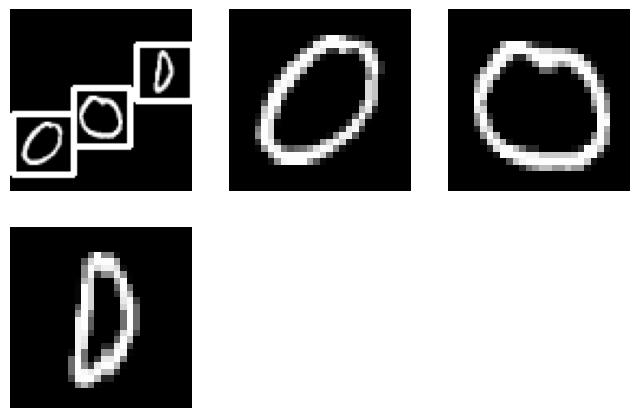

192000
60000
48000
(192000, 28, 28)
(60000, 28, 28)
(48000, 28, 28)
(192000,)
(60000,)
(48000,)
10
10
10


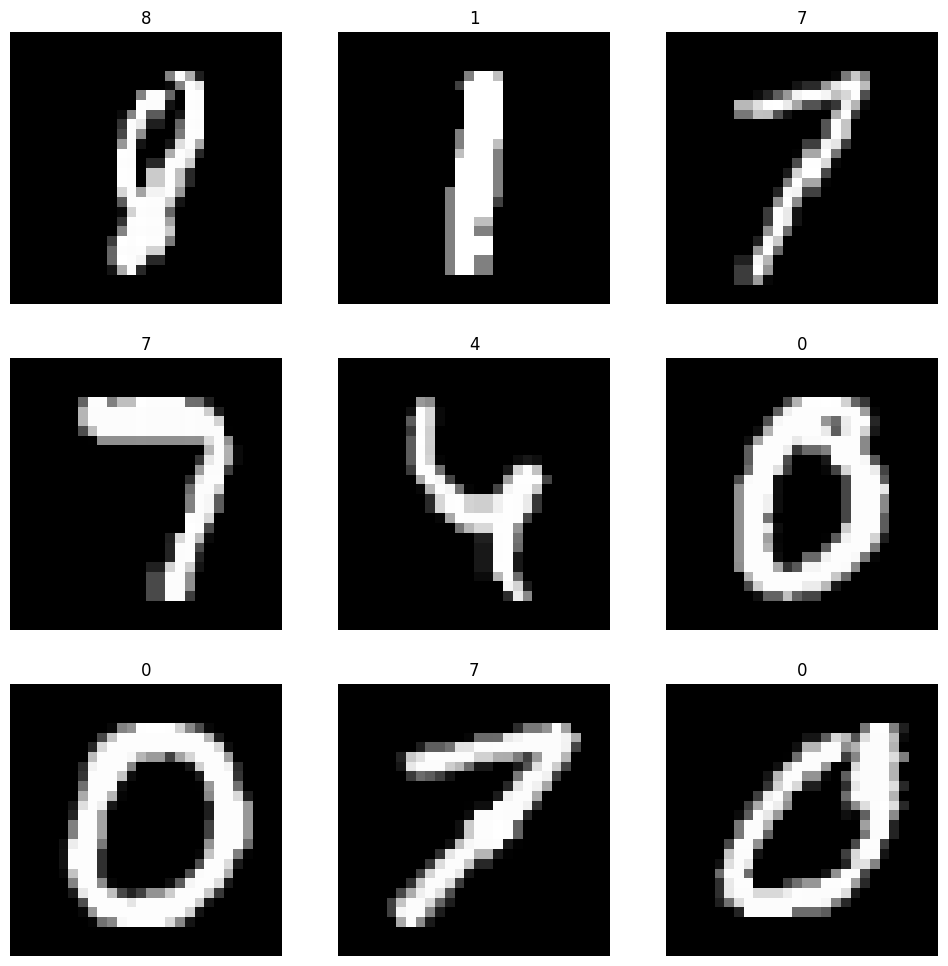

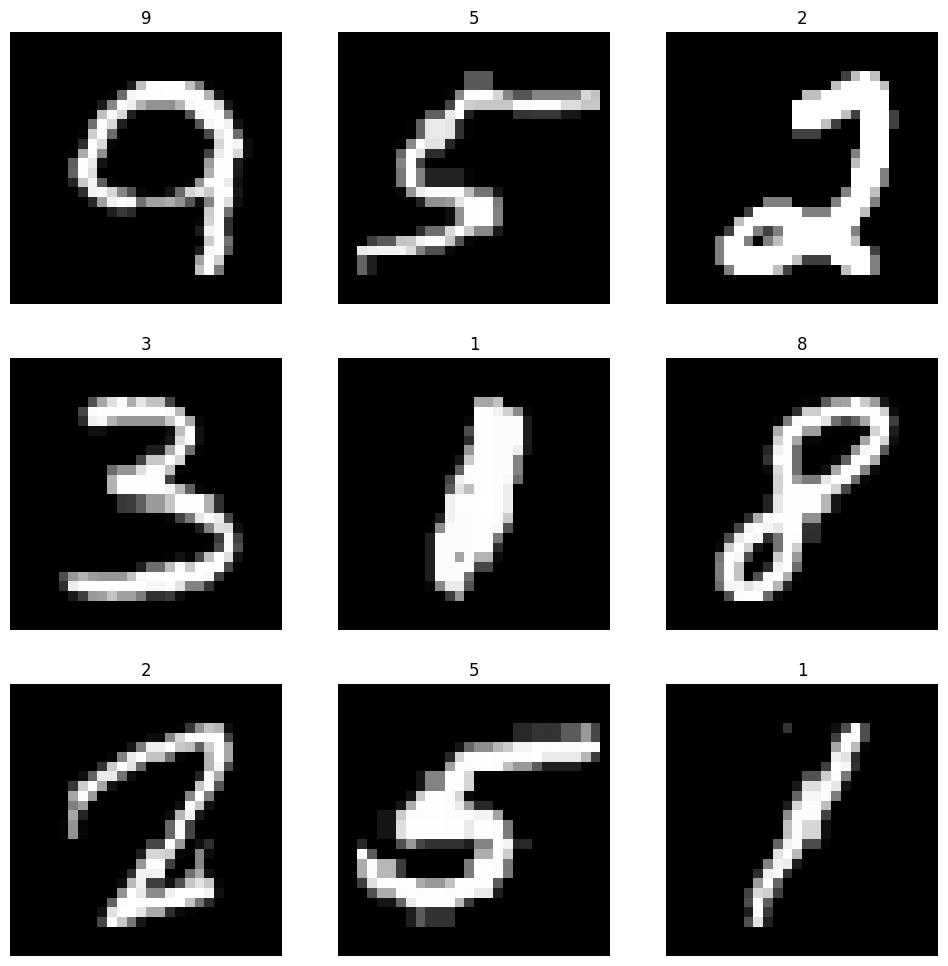

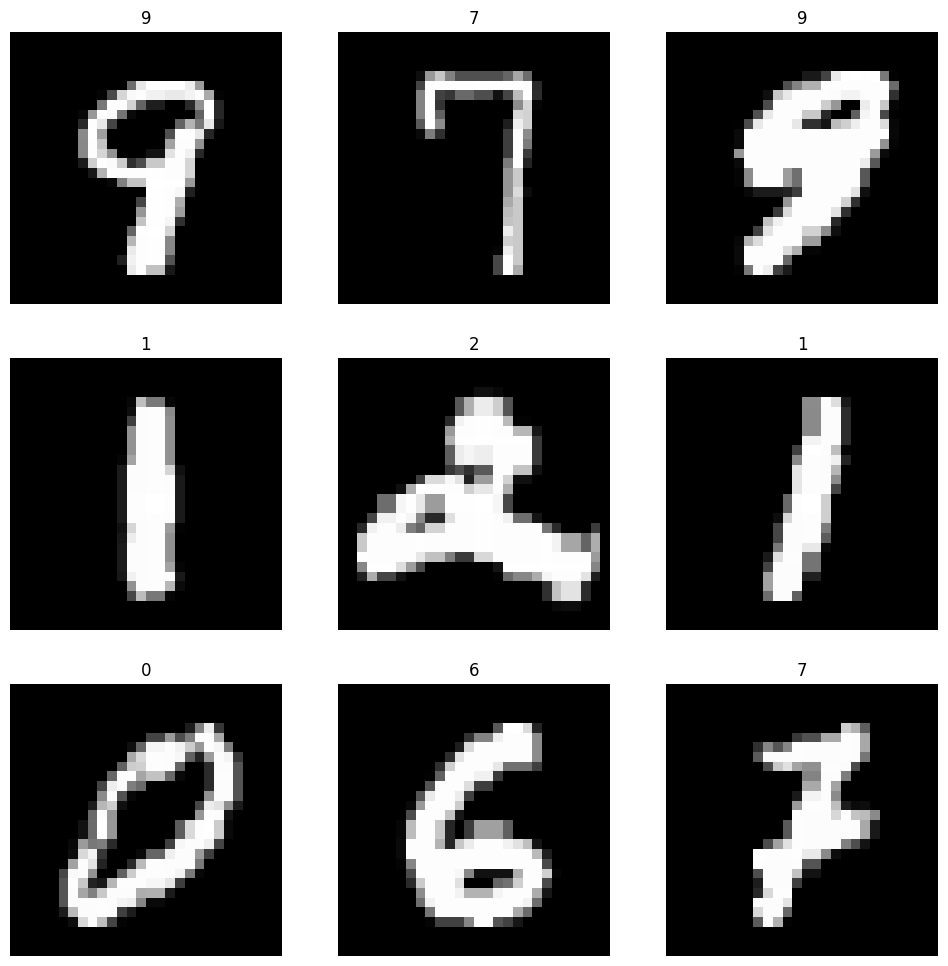

Training data shape: (192000, 28, 28, 1) (192000,)
Validation data shape: (48000, 28, 28, 1) (48000,)
Test data shape: (60000, 28, 28, 1) (60000,)


/usr/local/lib/python3.10/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/5
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 29s 4ms/step - accuracy: 0.9339 - auc_8: 0.9925 - loss: 0.2247 - precision_8: 0.9526 - recall_8: 0.9204 - val_accuracy: 0.9842 - val_auc_8: 0.9990 - val_loss: 0.0570 - val_precision_8: 0.9869 - val_recall_8: 0.9827
Epoch 2/5
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 21s 4ms/step - accuracy: 0.9873 - auc_8: 0.9993 - loss: 0.0456 - precision_8: 0.9895 - recall_8: 0.9857 - val_accuracy: 0.9897 - val_auc_8: 0.9993 - val_loss: 0.0403 - val_precision_8: 0.9915 - val_recall_8: 0.9886
Epoch 3/5
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 21s 4ms/step - accuracy: 0.9926 - auc_8: 0.9996 - loss: 0.0282 - precision_8: 0.9942 - recall_8: 0.9918 - val_accuracy: 0.9922 - val_auc_8: 0.9993 - val_loss: 0.0322 - val_precision_8: 0.9937 - val_recall_8: 0.9914
Epoch 4/5
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 21s 4ms/step - accuracy: 0.9945 - auc_8: 0.9997 - loss: 0.0206 - precision_8: 0.9957 - recall_8: 0.9937 - val_accuracy: 0.9929 - val_auc_8: 0.9993 - val_loss: 0.0303 - val_precision_8: 0.9943

Single Digits Validation loss: 0.030644718557596207
Single Digits Validation accuracy: 0.9926666617393494
Epoch 1/5
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 27s 4ms/step - accuracy: 0.9568 - auc_9: 0.9961 - loss: 0.1482 - precision_9: 0.9650 - recall_9: 0.9506 - val_accuracy: 0.9822 - val_auc_9: 0.9987 - val_loss: 0.0635 - val_precision_9: 0.9852 - val_recall_9: 0.9808
Epoch 2/5
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 21s 4ms/step - accuracy: 0.9865 - auc_9: 0.9992 - loss: 0.0466 - precision_9: 0.9887 - recall_9: 0.9852 - val_accuracy: 0.9888 - val_auc_9: 0.9992 - val_loss: 0.0409 - val_precision_9: 0.9905 - val_recall_9: 0.9881
Epoch 3/5
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 21s 4ms/step - accuracy: 0.9914 - auc_9: 0.9996 - loss: 0.0308 - precision_9: 0.9928 - recall_9: 0.9904 - val_accuracy: 0.9896 - val_auc_9: 0.9992 - val_loss: 0.0408 - val_precision_9: 0.9914 - val_recall_9: 0.9887
Epoch 4/5
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 21s 4ms/step - accuracy: 0.9939 - auc_9: 0.9997 - loss: 0.0217 - precision_9: 0.9953 

Single Digits Validation loss: 0.031038755550980568
Single Digits Validation accuracy: 0.9927916526794434
Epoch 1/10
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 26s 4ms/step - accuracy: 0.9338 - auc_10: 0.9929 - loss: 0.2235 - precision_10: 0.9530 - recall_10: 0.9209 - val_accuracy: 0.9849 - val_auc_10: 0.9989 - val_loss: 0.0581 - val_precision_10: 0.9875 - val_recall_10: 0.9830
Epoch 2/10
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 21s 4ms/step - accuracy: 0.9878 - auc_10: 0.9993 - loss: 0.0447 - precision_10: 0.9901 - recall_10: 0.9863 - val_accuracy: 0.9893 - val_auc_10: 0.9992 - val_loss: 0.0412 - val_precision_10: 0.9910 - val_recall_10: 0.9881
Epoch 3/10
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 21s 4ms/step - accuracy: 0.9928 - auc_10: 0.9996 - loss: 0.0277 - precision_10: 0.9942 - recall_10: 0.9919 - val_accuracy: 0.9924 - val_auc_10: 0.9992 - val_loss: 0.0333 - val_precision_10: 0.9937 - val_recall_10: 0.9916
Epoch 4/10
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 21s 4ms/step - accuracy: 0.9948 - auc_10: 0.9997 - loss: 0.0204

Single Digits Validation loss: 0.02873264253139496
Single Digits Validation accuracy: 0.9947291612625122
Epoch 1/10
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 27s 4ms/step - accuracy: 0.9546 - auc_11: 0.9958 - loss: 0.1545 - precision_11: 0.9629 - recall_11: 0.9492 - val_accuracy: 0.9789 - val_auc_11: 0.9986 - val_loss: 0.0741 - val_precision_11: 0.9824 - val_recall_11: 0.9762
Epoch 2/10
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 22s 4ms/step - accuracy: 0.9859 - auc_11: 0.9993 - loss: 0.0487 - precision_11: 0.9879 - recall_11: 0.9846 - val_accuracy: 0.9863 - val_auc_11: 0.9988 - val_loss: 0.0503 - val_precision_11: 0.9877 - val_recall_11: 0.9857
Epoch 3/10
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 22s 4ms/step - accuracy: 0.9910 - auc_11: 0.9995 - loss: 0.0312 - precision_11: 0.9926 - recall_11: 0.9902 - val_accuracy: 0.9901 - val_auc_11: 0.9991 - val_loss: 0.0405 - val_precision_11: 0.9915 - val_recall_11: 0.9895
Epoch 4/10
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 21s 4ms/step - accuracy: 0.9933 - auc_11: 0.9996 - loss: 0.0236 

Single Digits Validation loss: 0.02582586370408535
Single Digits Validation accuracy: 0.995187520980835
Epoch 1/10
3000/3000 ━━━━━━━━━━━━━━━━━━━━ 20s 5ms/step - accuracy: 0.9562 - auc_15: 0.9959 - loss: 0.1506 - precision_15: 0.9653 - recall_15: 0.9494 - val_accuracy: 0.9846 - val_auc_15: 0.9990 - val_loss: 0.0552 - val_precision_15: 0.9871 - val_recall_15: 0.9830
Epoch 2/10
3000/3000 ━━━━━━━━━━━━━━━━━━━━ 15s 5ms/step - accuracy: 0.9870 - auc_15: 0.9994 - loss: 0.0443 - precision_15: 0.9892 - recall_15: 0.9856 - val_accuracy: 0.9893 - val_auc_15: 0.9993 - val_loss: 0.0406 - val_precision_15: 0.9911 - val_recall_15: 0.9881
Epoch 3/10
3000/3000 ━━━━━━━━━━━━━━━━━━━━ 15s 5ms/step - accuracy: 0.9916 - auc_15: 0.9996 - loss: 0.0284 - precision_15: 0.9934 - recall_15: 0.9906 - val_accuracy: 0.9896 - val_auc_15: 0.9993 - val_loss: 0.0394 - val_precision_15: 0.9916 - val_recall_15: 0.9881
Epoch 4/10
3000/3000 ━━━━━━━━━━━━━━━━━━━━ 15s 5ms/step - accuracy: 0.9942 - auc_15: 0.9997 - loss: 0.0201 -

Single Digits Validation loss: 0.0291249081492424
Single Digits Validation accuracy: 0.9945208430290222
Single Digits Best Hyperparameters (CNN): {'batch_size': 64, 'epochs': 10, 'learning_rate': 0.0001}
Single Digits Best Accuracy Score (CNN): 0.995187520980835


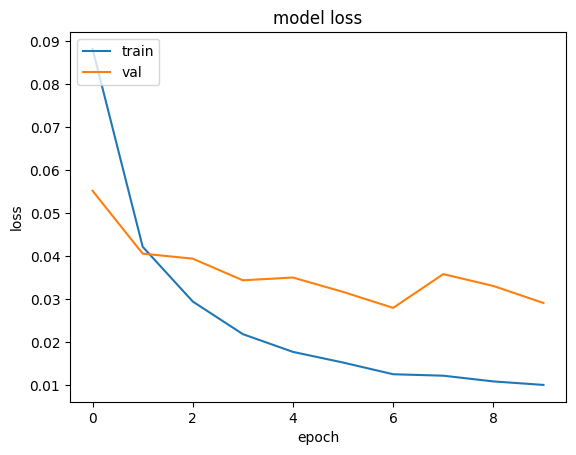

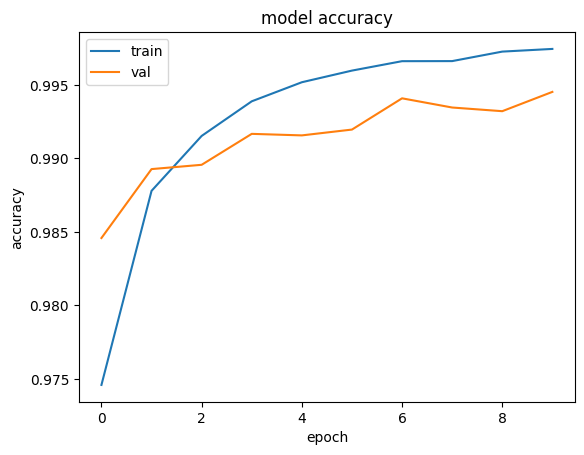

Single Digits Test loss: 0.021403096616268158
Single Digits Test accuracy: 0.9951666593551636
Single Digits Test precision: 0.9960120320320129
Single Digits Test recall: 0.9948499798774719
Single Digits Test AUC: 0.9994596838951111
single digit classific report
1875/1875 ━━━━━━━━━━━━━━━━━━━━ 3s 1ms/step
Classification Report (Single Digits):
              precision    recall  f1-score   support

           0     0.9965    0.9957    0.9961      6300
           1     0.9966    0.9981    0.9973      5800
           2     0.9914    0.9933    0.9924      4900
           3     0.9947    0.9962    0.9954      5800
           4     0.9946    0.9968    0.9957      6600
           5     0.9952    0.9934    0.9943      6700
           6     0.9946    0.9966    0.9956      6500
           7     0.9918    0.9922    0.9920      5000
           8     0.9979    0.9943    0.9961      6700
           9     0.9970    0.9942    0.9956      5700

    accuracy                         0.9952     60000
   mac

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


[[100   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0 

In [ ]:
#TASK-3 CNN with 3 distinct digits only bTCH NORMlızatıon
import tensorflow as tf
import tensorflow.keras as keras
from tensorflow.keras import layers, models
from sklearn.metrics import classification_report, confusion_matrix
import cv2
from tensorflow.keras import models, layers, optimizers, losses, metrics
##### SPLIT FUNCTION AND ITS DEMONSTRATION #####
digit_shape = (28, 28)
def crop_digits(img_path: str = None, im = None):
    #if im is None:
    #    im = cv2.imread(img_path)

    #gray = cv2.cvtColor(im, cv2.COLOR_BGR2GRAY)
    blur = cv2.GaussianBlur(img_path, (5, 5), 0)
    thresh = cv2.threshold(blur, 90, 255, cv2.THRESH_BINARY+cv2.THRESH_OTSU)[1]
    contours, hierarchy = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    digits = []
    rect = img_path.copy()
    for cnt in contours:
        x, y, w, h = cv2.boundingRect(cnt)
##########################################################666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666
        x = max(x - 3, 0)
        y = max(y - 3, 0)
        w += 6
        h += 6

        del_x = int(w / 2)
        del_y = int(h / 2)
        center_x = x + del_x
        center_y = y + del_y

        lu_corner = (max(center_x - del_y, 0), y)
        rd_corner = (max(center_x + del_y, 0), y + h)

        rect = cv2.rectangle(rect, lu_corner, rd_corner, (255, 0, 0), 2) #rectangle

        cropped = img_path[lu_corner[1]:rd_corner[1], lu_corner[0]:rd_corner[0]]
        digits.append(cropped)

    def filter_and_sort_digits(digits, contours):
        sizes = []
        for digit in digits:
            size = digit.shape[0] * digit.shape[1]
            sizes.append(size)
        avg_size = sum(sizes) / len(sizes)
        deviations = [abs(size - avg_size) for size in sizes]

        indices = np.argsort(deviations)[0:3]
        digits = [digits[i] for i in indices]
        contours = [cv2.boundingRect(contours[i]) for i in indices]

        xs = [contour[0] for contour in contours]
        indices = np.argsort(xs) #get highest likelihood digit
        digits = [digits[i] for i in indices]

        while len(digits) < 3:
            digits.append(digits[0])
        return digits

    digits = filter_and_sort_digits(digits, contours) #get highest likelihood digits
    digits = [cv2.resize(digit, digit_shape, interpolation = cv2.INTER_NEAREST) for digit in digits] #resize to 28,28

    return digits, contours, rect

print(f"Label: {train_labels[0]}")
print(train_labels[0][0])
print(train_labels[0][1])
print(train_labels[0][2])

fig = plt.figure(figsize=(8, 8))
cols, rows = 3, 3

digits, contours, rect = crop_digits(train_images[0])

fig.add_subplot(rows, cols, 1)
plt.axis("off")
plt.imshow(rect.squeeze(), cmap="gray")
for i in range(len(digits)):
    img = digits[i]
    print(train_labels[0][i])
    fig.add_subplot(rows, cols, i+2)
    plt.axis("off")
    plt.imshow(img.squeeze(), cmap="gray")
    print(f"crop shape: {img.shape}")
plt.show()


##### SPLIT ALL DATA TO DIGITS #####
def load_digits(images, labels):
  all_digits = []
  all_labels = []
  for i in range(len(images)):
    digits, contours, rect = crop_digits(images[i])
    for j in range(len(digits)):
      all_digits.append(digits[j])
      all_labels.append(labels[i][j])
  return np.array(all_digits), np.array(all_labels)

train_images, train_labels = load_digits(train_images, train_labels)
test_images_digits, test_labels_digits = load_digits(test_images, test_labels)
val_images, val_labels = load_digits(val_images, val_labels)
print(len(train_images))
print(len(test_images_digits))
print(len(val_images))
print(train_images.shape)
print(test_images_digits.shape)
print(val_images.shape)
print(train_labels.shape)
print(test_labels_digits.shape)
print(val_labels.shape)

print(len(np.unique(train_labels)))
print(len(np.unique(test_labels_digits)))
print(len(np.unique(val_labels)))

def visualize(images, labels):
  np.random.seed(42)
  random_indices = np.random.choice(len(images), size=9, replace=False)
  random_images = images[random_indices]
  random_labels = labels[random_indices]

  fig, axes = plt.subplots(3, 3, figsize=(12, 12))
  for i, (img, label) in enumerate(zip(random_images, random_labels)):
      ax = axes[i // 3, i % 3]
      ax.imshow(img, cmap='gray')
      ax.set_title(label)
      ax.axis('off')
  plt.show()

visualize(train_images, train_labels)
visualize(test_images_digits, test_labels_digits)
visualize(val_images, val_labels)

################################################################################################################################maxpooling iyii sionuc asssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssss
##### TRAIN CNN #####
train_images = train_images / 255.0
val_images = val_images / 255.0
test_images_digits = test_images_digits / 255.0

train_images = train_images.reshape((train_images.shape[0], 28, 28, 1))
val_images = val_images.reshape((val_images.shape[0], 28, 28, 1))
test_images_digits = test_images_digits.reshape((test_images_digits.shape[0], 28, 28, 1))

print('Training data shape:', train_images.shape, train_labels.shape)
print('Validation data shape:', val_images.shape, val_labels.shape)
print('Test data shape:', test_images_digits.shape, test_labels_digits.shape)

train_labels = tf.keras.utils.to_categorical(train_labels, num_classes=10)
val_labels = tf.keras.utils.to_categorical(val_labels, num_classes=10)
test_labels_digits = tf.keras.utils.to_categorical(test_labels_digits, num_classes=10)



# FOR TASK 4, NO HYPERPARAM SEARCH NEEDED!
param_grid_cnn = {
    'batch_size': [32,64],
    'epochs': [5,10],
    'learning_rate': [1e-4,1e-3],
    #'batch_size': [32],
    #'epochs': [7],
    #'learning_rate': [1e-2],
}

best_params_cnn = None
best_accuracy_cnn = -1
for batch_size in param_grid_cnn['batch_size']:
    for epochs in param_grid_cnn['epochs']:
        for learning_rate in param_grid_cnn['learning_rate']:
          model = models.Sequential()
          model.add(layers.Conv2D(64, (3, 3), activation='relu', input_shape=(28, 28, 1)))
          model.add(layers.BatchNormalization()) #### FOR TASK 4
          model.add(layers.MaxPooling2D((2, 2)))
          model.add(layers.Conv2D(128, (3, 3), activation='relu'))
          model.add(layers.BatchNormalization()) #### FOR TASK 4
          model.add(layers.MaxPooling2D((2, 2)))
          model.add(layers.Conv2D(256, (3, 3), activation='relu')) #### FOR TASK 4
          model.add(layers.BatchNormalization()) #### FOR TASK 4
          model.add(layers.MaxPooling2D((2, 2))) #### FOR TASK 4
          model.add(layers.Flatten())
          #model.add(layers.Dropout(0.5)) #0.7 #### FOR TASK 4
          model.add(layers.Dense(10, activation='softmax'))
          model.compile(loss="categorical_crossentropy", optimizer=keras.optimizers.Adam(learning_rate=learning_rate), metrics=["accuracy", metrics.Precision(), metrics.Recall(), metrics.AUC()])


          history = model.fit(train_images, train_labels, batch_size=batch_size, epochs=epochs, validation_data=(val_images, val_labels))

          score_train = model.evaluate(train_images, train_labels, verbose=0)
          print("Single Digits Train loss:", score_train[0])
          print("Single Digits Train accuracy:", score_train[1])
          score_val = model.evaluate(val_images, val_labels, verbose=0)
          print("Single Digits Validation loss:", score_val[0])
          print("Single Digits Validation accuracy:", score_val[1])
          if score_val[1] > best_accuracy_cnn:
                  best_accuracy_cnn = score_val[1]
                  best_params_cnn = {'batch_size': batch_size, 'epochs': epochs, 'learning_rate':learning_rate}
                  model.save('best_model.h5')

print("Single Digits Best Hyperparameters (CNN):", best_params_cnn)
print("Single Digits Best Accuracy Score (CNN):", best_accuracy_cnn)
model = tf.keras.models.load_model('best_model.h5')
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

score = model.evaluate(test_images_digits, test_labels_digits, verbose=0)
print("Single Digits Test loss:", score[0])
print("Single Digits Test accuracy:", score[1])
print("Single Digits Test precision:", score[2])
print("Single Digits Test recall:", score[3])
print("Single Digits Test AUC:", score[4])
print("single digit classific report")
predictions_digits = model.predict(test_images_digits)
predicted_labels_digits = np.argmax(predictions_digits, axis=1)  # Convert predictions to class labels
true_labels_digits = np.argmax(test_labels_digits, axis=1)  # Convert one-hot encoded labels to class labels

# Print the classification report for single digits
print("Classification Report (Single Digits):")
print(classification_report(true_labels_digits, predicted_labels_digits, digits=4))

final_test_predictions = []
for i in range(len(test_images)):
  img = test_images[i]
  concat = ""
  for j in range(0,3):
    img_digit = test_images_digits[3*i + j]
    #prediction = model.predict_on_batch([img_digit])
    prediction = model.predict_on_batch(np.expand_dims(img_digit, axis=0))
    prediction = np.argmax(prediction)
    #print(prediction, test_labels[i])
    concat = concat + str(prediction)
  #print(concat, test_labels[i])
  final_test_predictions.append(concat)

np.set_printoptions(threshold=np.inf)

print("Classification Report:")
print(classification_report(test_labels, final_test_predictions, digits = 4))

print("\nConfusion Matrix:")
print(confusion_matrix(test_labels, final_test_predictions))

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from google.colab import drive
drive.mount('/content/drive')
test_images = np.load('/content/drive/MyDrive/npy_2/np_save_test_images_2.npy')
test_labels = np.load('/content/drive/MyDrive/npy_2/np_save_test_labels_2.npy')
val_images = np.load('/content/drive/MyDrive/npy_2/np_save_val_images_2.npy')
val_labels = np.load('/content/drive/MyDrive/npy_2/np_save_val_labels_2.npy')
train_images = np.load('/content/drive/MyDrive/npy_2/np_save_train_images_2.npy')
train_labels = np.load('/content/drive/MyDrive/npy_2/np_save_train_labels_2.npy')


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


# 3 layer batch norm extra dense layers dropout between dense layers hf


> Add blockquote

> Add blockquote





Label: 000
0
0
0
0
crop shape: (28, 28)
0
crop shape: (28, 28)
0
crop shape: (28, 28)


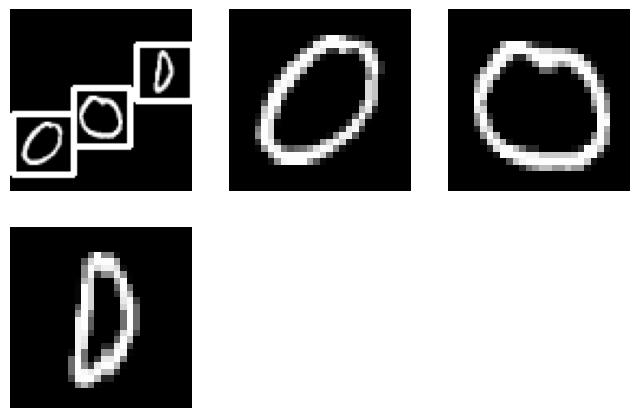

192000
60000
48000
(192000, 28, 28)
(60000, 28, 28)
(48000, 28, 28)
(192000,)
(60000,)
(48000,)
10
10
10


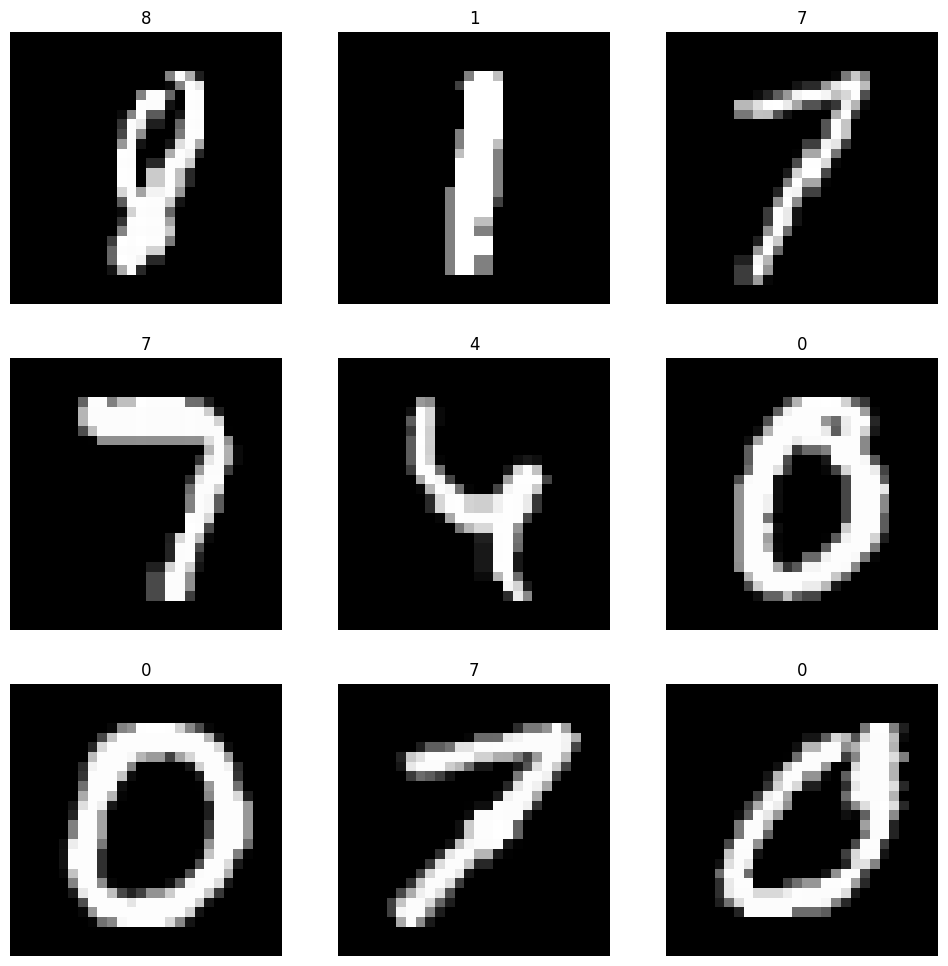

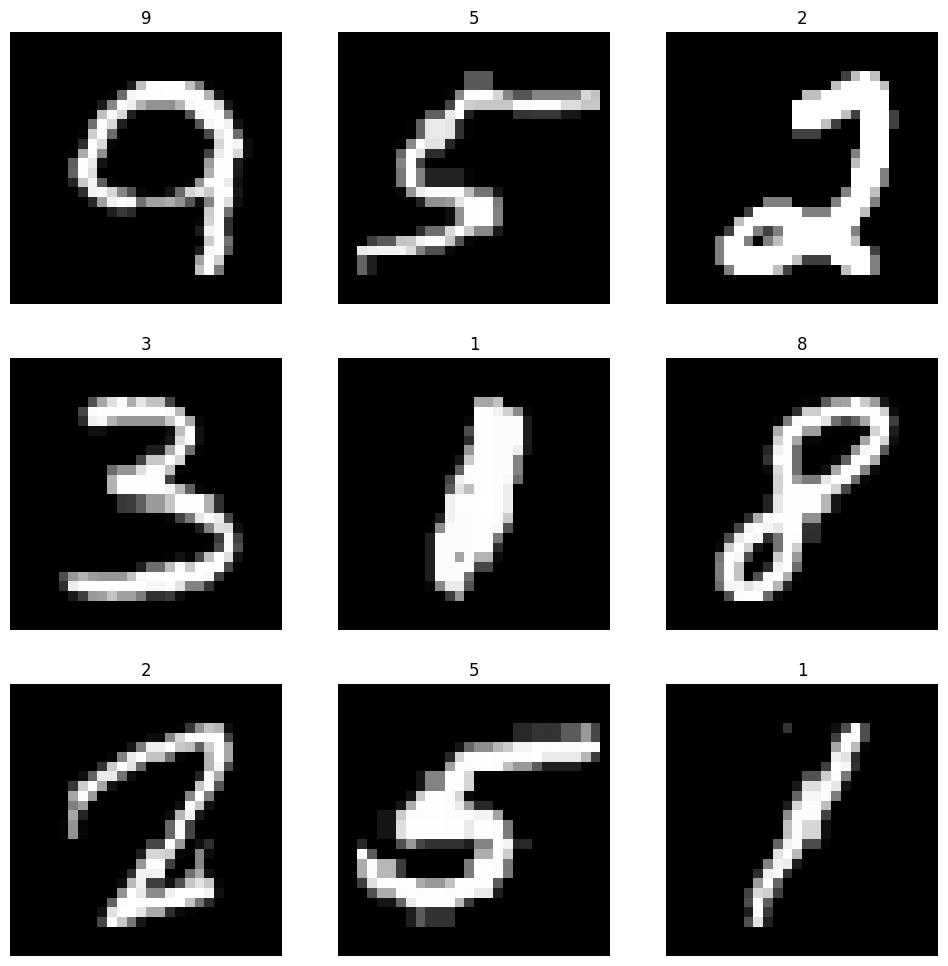

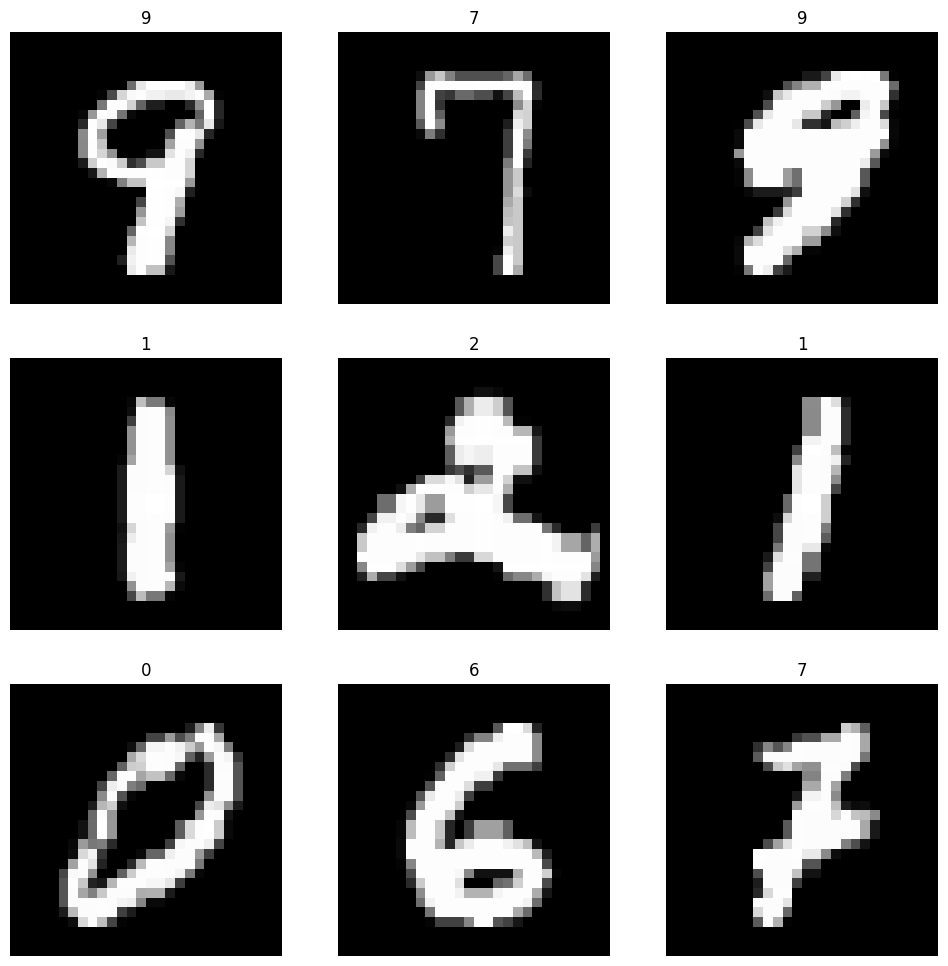

Training data shape: (192000, 28, 28, 1) (192000,)
Validation data shape: (48000, 28, 28, 1) (48000,)
Test data shape: (60000, 28, 28, 1) (60000,)
batch_size: 32, epochs: 5, learning_rate: 0.0001


/usr/local/lib/python3.10/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/5
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 32s 4ms/step - accuracy: 0.7997 - auc_16: 0.9616 - loss: 0.6991 - precision_16: 0.8418 - recall_16: 0.7675 - val_accuracy: 0.9782 - val_auc_16: 0.9984 - val_loss: 0.0778 - val_precision_16: 0.9819 - val_recall_16: 0.9760
Epoch 2/5
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 23s 4ms/step - accuracy: 0.9650 - auc_16: 0.9972 - loss: 0.1239 - precision_16: 0.9705 - recall_16: 0.9607 - val_accuracy: 0.9848 - val_auc_16: 0.9987 - val_loss: 0.0574 - val_precision_16: 0.9867 - val_recall_16: 0.9836
Epoch 3/5
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 22s 4ms/step - accuracy: 0.9757 - auc_16: 0.9983 - loss: 0.0841 - precision_16: 0.9795 - recall_16: 0.9726 - val_accuracy: 0.9889 - val_auc_16: 0.9991 - val_loss: 0.0428 - val_precision_16: 0.9910 - val_recall_16: 0.9877
Epoch 4/5
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 22s 4ms/step - accuracy: 0.9816 - auc_16: 0.9989 - loss: 0.0636 - precision_16: 0.9848 - recall_16: 0.9795 - val_accuracy: 0.9898 - val_auc_16: 0.9993 - val_loss: 0.0386 - v

Single Digits Validation loss: 0.035831108689308167
Single Digits Validation accuracy: 0.9905833601951599
batch_size: 32, epochs: 5, learning_rate: 0.001
Epoch 1/5
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 29s 4ms/step - accuracy: 0.8998 - auc_17: 0.9869 - loss: 0.3356 - precision_17: 0.9208 - recall_17: 0.8846 - val_accuracy: 0.9810 - val_auc_17: 0.9986 - val_loss: 0.0717 - val_precision_17: 0.9847 - val_recall_17: 0.9780
Epoch 2/5
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 22s 4ms/step - accuracy: 0.9738 - auc_17: 0.9978 - loss: 0.0956 - precision_17: 0.9789 - recall_17: 0.9704 - val_accuracy: 0.9819 - val_auc_17: 0.9983 - val_loss: 0.0677 - val_precision_17: 0.9850 - val_recall_17: 0.9798
Epoch 3/5
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 22s 4ms/step - accuracy: 0.9787 - auc_17: 0.9986 - loss: 0.0748 - precision_17: 0.9830 - recall_17: 0.9759 - val_accuracy: 0.9892 - val_auc_17: 0.9991 - val_loss: 0.0428 - val_precision_17: 0.9923 - val_recall_17: 0.9869
Epoch 4/5
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 22s 4ms/step - accu

Single Digits Validation loss: 0.02679567039012909
Single Digits Validation accuracy: 0.9940208196640015
batch_size: 32, epochs: 10, learning_rate: 0.001
Epoch 1/10
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 29s 4ms/step - accuracy: 0.8969 - auc_19: 0.9861 - loss: 0.3538 - precision_19: 0.9183 - recall_19: 0.8810 - val_accuracy: 0.9785 - val_auc_19: 0.9985 - val_loss: 0.0770 - val_precision_19: 0.9826 - val_recall_19: 0.9759
Epoch 2/10
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 22s 4ms/step - accuracy: 0.9740 - auc_19: 0.9979 - loss: 0.0955 - precision_19: 0.9790 - recall_19: 0.9706 - val_accuracy: 0.9839 - val_auc_19: 0.9990 - val_loss: 0.0585 - val_precision_19: 0.9881 - val_recall_19: 0.9806
Epoch 3/10
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 22s 4ms/step - accuracy: 0.9792 - auc_19: 0.9985 - loss: 0.0739 - precision_19: 0.9836 - recall_19: 0.9765 - val_accuracy: 0.9874 - val_auc_19: 0.9992 - val_loss: 0.0463 - val_precision_19: 0.9904 - val_recall_19: 0.9857
Epoch 4/10
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 22s 4ms/step - 

Single Digits Validation loss: 0.03428224101662636
Single Digits Validation accuracy: 0.9927291870117188
Single Digits Best Hyperparameters (CNN): {'batch_size': 32, 'epochs': 10, 'learning_rate': 0.0001}
Single Digits Best Accuracy Score (CNN): 0.9940208196640015


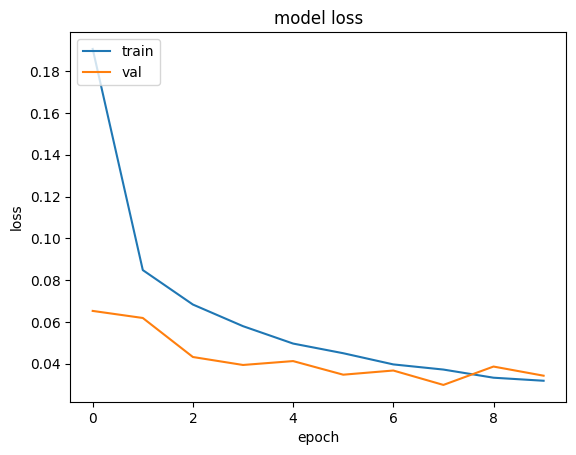

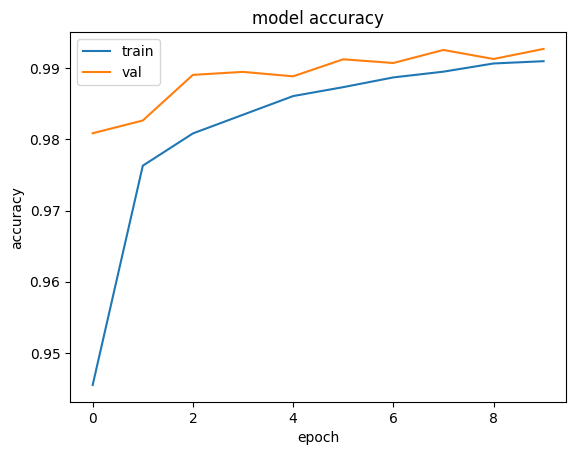

Single Digits Test loss: 0.020693635568022728
Single Digits Test accuracy: 0.9948499798774719
Single Digits Test precision: 0.996425986289978
Single Digits Test recall: 0.9943833351135254
Single Digits Test AUC: 0.9995898008346558
single digit classific report
1875/1875 ━━━━━━━━━━━━━━━━━━━━ 3s 1ms/step
Classification Report (Single Digits):
              precision    recall  f1-score   support

           0     0.9984    0.9968    0.9976      6300
           1     0.9957    0.9976    0.9966      5800
           2     0.9902    0.9898    0.9900      4900
           3     0.9914    0.9966    0.9940      5800
           4     0.9980    0.9964    0.9972      6600
           5     0.9934    0.9924    0.9929      6700
           6     0.9920    0.9965    0.9942      6500
           7     0.9912    0.9924    0.9918      5000
           8     0.9992    0.9940    0.9966      6700
           9     0.9968    0.9949    0.9959      5700

    accuracy                         0.9949     60000
   macr

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


[[100   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0 

In [ ]:
#TASK-3 CNN with 3 distinct digits only bTCH NORMlızatıon
import tensorflow as tf
import tensorflow.keras as keras
from tensorflow.keras import layers, models
from sklearn.metrics import classification_report, confusion_matrix
import cv2
from tensorflow.keras import models, layers, optimizers, losses, metrics
##### SPLIT FUNCTION AND ITS DEMONSTRATION #####
digit_shape = (28, 28)
def crop_digits(img_path: str = None, im = None):
    #if im is None:
    #    im = cv2.imread(img_path)

    #gray = cv2.cvtColor(im, cv2.COLOR_BGR2GRAY)
    blur = cv2.GaussianBlur(img_path, (5, 5), 0)
    thresh = cv2.threshold(blur, 90, 255, cv2.THRESH_BINARY+cv2.THRESH_OTSU)[1]
    contours, hierarchy = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    digits = []
    rect = img_path.copy()
    for cnt in contours:
        x, y, w, h = cv2.boundingRect(cnt)
##########################################################666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666
        x = max(x - 3, 0)
        y = max(y - 3, 0)
        w += 6
        h += 6

        del_x = int(w / 2)
        del_y = int(h / 2)
        center_x = x + del_x
        center_y = y + del_y

        lu_corner = (max(center_x - del_y, 0), y)
        rd_corner = (max(center_x + del_y, 0), y + h)

        rect = cv2.rectangle(rect, lu_corner, rd_corner, (255, 0, 0), 2) #rectangle

        cropped = img_path[lu_corner[1]:rd_corner[1], lu_corner[0]:rd_corner[0]]
        digits.append(cropped)

    def filter_and_sort_digits(digits, contours):
        sizes = []
        for digit in digits:
            size = digit.shape[0] * digit.shape[1]
            sizes.append(size)
        avg_size = sum(sizes) / len(sizes)
        deviations = [abs(size - avg_size) for size in sizes]

        indices = np.argsort(deviations)[0:3]
        digits = [digits[i] for i in indices]
        contours = [cv2.boundingRect(contours[i]) for i in indices]

        xs = [contour[0] for contour in contours]
        indices = np.argsort(xs) #get highest likelihood digit
        digits = [digits[i] for i in indices]

        while len(digits) < 3:
            digits.append(digits[0])
        return digits

    digits = filter_and_sort_digits(digits, contours) #get highest likelihood digits
    digits = [cv2.resize(digit, digit_shape, interpolation = cv2.INTER_NEAREST) for digit in digits] #resize to 28,28

    return digits, contours, rect

print(f"Label: {train_labels[0]}")
print(train_labels[0][0])
print(train_labels[0][1])
print(train_labels[0][2])

fig = plt.figure(figsize=(8, 8))
cols, rows = 3, 3

digits, contours, rect = crop_digits(train_images[0])

fig.add_subplot(rows, cols, 1)
plt.axis("off")
plt.imshow(rect.squeeze(), cmap="gray")
for i in range(len(digits)):
    img = digits[i]
    print(train_labels[0][i])
    fig.add_subplot(rows, cols, i+2)
    plt.axis("off")
    plt.imshow(img.squeeze(), cmap="gray")
    print(f"crop shape: {img.shape}")
plt.show()


##### SPLIT ALL DATA TO DIGITS #####
def load_digits(images, labels):
  all_digits = []
  all_labels = []
  for i in range(len(images)):
    digits, contours, rect = crop_digits(images[i])
    for j in range(len(digits)):
      all_digits.append(digits[j])
      all_labels.append(labels[i][j])
  return np.array(all_digits), np.array(all_labels)

train_images, train_labels = load_digits(train_images, train_labels)
test_images_digits, test_labels_digits = load_digits(test_images, test_labels)
val_images, val_labels = load_digits(val_images, val_labels)
print(len(train_images))
print(len(test_images_digits))
print(len(val_images))
print(train_images.shape)
print(test_images_digits.shape)
print(val_images.shape)
print(train_labels.shape)
print(test_labels_digits.shape)
print(val_labels.shape)

print(len(np.unique(train_labels)))
print(len(np.unique(test_labels_digits)))
print(len(np.unique(val_labels)))

def visualize(images, labels):
  np.random.seed(42)
  random_indices = np.random.choice(len(images), size=9, replace=False)
  random_images = images[random_indices]
  random_labels = labels[random_indices]

  fig, axes = plt.subplots(3, 3, figsize=(12, 12))
  for i, (img, label) in enumerate(zip(random_images, random_labels)):
      ax = axes[i // 3, i % 3]
      ax.imshow(img, cmap='gray')
      ax.set_title(label)
      ax.axis('off')
  plt.show()

visualize(train_images, train_labels)
visualize(test_images_digits, test_labels_digits)
visualize(val_images, val_labels)

################################################################################################################################maxpooling iyii sionuc asssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssss
##### TRAIN CNN #####
train_images = train_images / 255.0
val_images = val_images / 255.0
test_images_digits = test_images_digits / 255.0

train_images = train_images.reshape((train_images.shape[0], 28, 28, 1))
val_images = val_images.reshape((val_images.shape[0], 28, 28, 1))
test_images_digits = test_images_digits.reshape((test_images_digits.shape[0], 28, 28, 1))

print('Training data shape:', train_images.shape, train_labels.shape)
print('Validation data shape:', val_images.shape, val_labels.shape)
print('Test data shape:', test_images_digits.shape, test_labels_digits.shape)

train_labels = tf.keras.utils.to_categorical(train_labels, num_classes=10)
val_labels = tf.keras.utils.to_categorical(val_labels, num_classes=10)
test_labels_digits = tf.keras.utils.to_categorical(test_labels_digits, num_classes=10)



# FOR TASK 4, NO HYPERPARAM SEARCH NEEDED!
param_grid_cnn = {
    'batch_size': [32,64],
    'epochs': [5,10],
    'learning_rate': [1e-4,1e-3],
    #'batch_size': [32],
    #'epochs': [7],
    #'learning_rate': [1e-2],
}

best_params_cnn = None
best_accuracy_cnn = -1
for batch_size in param_grid_cnn['batch_size']:
    for epochs in param_grid_cnn['epochs']:
        for learning_rate in param_grid_cnn['learning_rate']:
          print(f"batch_size: {batch_size}, epochs: {epochs}, learning_rate: {learning_rate}")
          model = models.Sequential()
          model.add(layers.Conv2D(64, (3, 3), activation='relu', input_shape=(28, 28, 1)))
          model.add(layers.BatchNormalization()) #### FOR TASK 4
          model.add(layers.MaxPooling2D((2, 2)))
          model.add(layers.Conv2D(128, (3, 3), activation='relu'))
          model.add(layers.BatchNormalization()) #### FOR TASK 4
          model.add(layers.MaxPooling2D((2, 2)))
          model.add(layers.Conv2D(256, (3, 3), activation='relu')) #### FOR TASK 4
          model.add(layers.BatchNormalization()) #### FOR TASK 4
          model.add(layers.MaxPooling2D((2, 2))) #### FOR TASK 4
          model.add(layers.Flatten())
          model.add(layers.Dropout(0.5)) #0.7 #### FOR TASK 4
          model.add(layers.Dense(256, activation='relu'))
          model.add(layers.Dropout(0.5)) #0.7 #### FOR TASK 4
          model.add(layers.Dense(10, activation='softmax'))
          model.compile(loss="categorical_crossentropy", optimizer=keras.optimizers.Adam(learning_rate=learning_rate), metrics=["accuracy", metrics.Precision(), metrics.Recall(), metrics.AUC()])


          history = model.fit(train_images, train_labels, batch_size=batch_size, epochs=epochs, validation_data=(val_images, val_labels))

          score_train = model.evaluate(train_images, train_labels, verbose=0)
          print("Single Digits Train loss:", score_train[0])
          print("Single Digits Train accuracy:", score_train[1])
          score_val = model.evaluate(val_images, val_labels, verbose=0)
          print("Single Digits Validation loss:", score_val[0])
          print("Single Digits Validation accuracy:", score_val[1])
          if score_val[1] > best_accuracy_cnn:
                  best_accuracy_cnn = score_val[1]
                  best_params_cnn = {'batch_size': batch_size, 'epochs': epochs, 'learning_rate':learning_rate}
                  model.save('best_model.h5')

print("Single Digits Best Hyperparameters (CNN):", best_params_cnn)
print("Single Digits Best Accuracy Score (CNN):", best_accuracy_cnn)
model = tf.keras.models.load_model('best_model.h5')
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

score = model.evaluate(test_images_digits, test_labels_digits, verbose=0)
print("Single Digits Test loss:", score[0])
print("Single Digits Test accuracy:", score[1])
print("Single Digits Test precision:", score[2])
print("Single Digits Test recall:", score[3])
print("Single Digits Test AUC:", score[4])
print("single digit classific report")
predictions_digits = model.predict(test_images_digits)
predicted_labels_digits = np.argmax(predictions_digits, axis=1)  # Convert predictions to class labels
true_labels_digits = np.argmax(test_labels_digits, axis=1)  # Convert one-hot encoded labels to class labels

# Print the classification report for single digits
print("Classification Report (Single Digits):")
print(classification_report(true_labels_digits, predicted_labels_digits, digits=4))

final_test_predictions = []
for i in range(len(test_images)):
  img = test_images[i]
  concat = ""
  for j in range(0,3):
    img_digit = test_images_digits[3*i + j]
    #prediction = model.predict_on_batch([img_digit])
    prediction = model.predict_on_batch(np.expand_dims(img_digit, axis=0))
    prediction = np.argmax(prediction)
    #print(prediction, test_labels[i])
    concat = concat + str(prediction)
  #print(concat, test_labels[i])
  final_test_predictions.append(concat)

np.set_printoptions(threshold=np.inf)

print("Classification Report:")
print(classification_report(test_labels, final_test_predictions, digits = 4))

print("\nConfusion Matrix:")
print(confusion_matrix(test_labels, final_test_predictions))

In [ ]:
train_images = np.load('/content/drive/MyDrive/npy_2/np_save_train_images_2.npy')
train_labels = np.load('/content/drive/MyDrive/npy_2/np_save_train_labels_2.npy')
test_images = np.load('/content/drive/MyDrive/npy_2/np_save_test_images_2.npy')
test_labels = np.load('/content/drive/MyDrive/npy_2/np_save_test_labels_2.npy')
val_images = np.load('/content/drive/MyDrive/npy_2/np_save_val_images_2.npy')
val_labels = np.load('/content/drive/MyDrive/npy_2/np_save_val_labels_2.npy')

# sadece bir 0.3 droppout

Label: 000
0
0
0
0
crop shape: (28, 28)
0
crop shape: (28, 28)
0
crop shape: (28, 28)


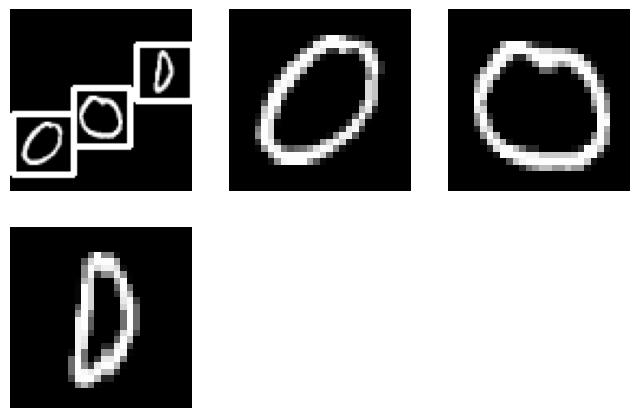

192000
60000
48000
(192000, 28, 28)
(60000, 28, 28)
(48000, 28, 28)
(192000,)
(60000,)
(48000,)
10
10
10


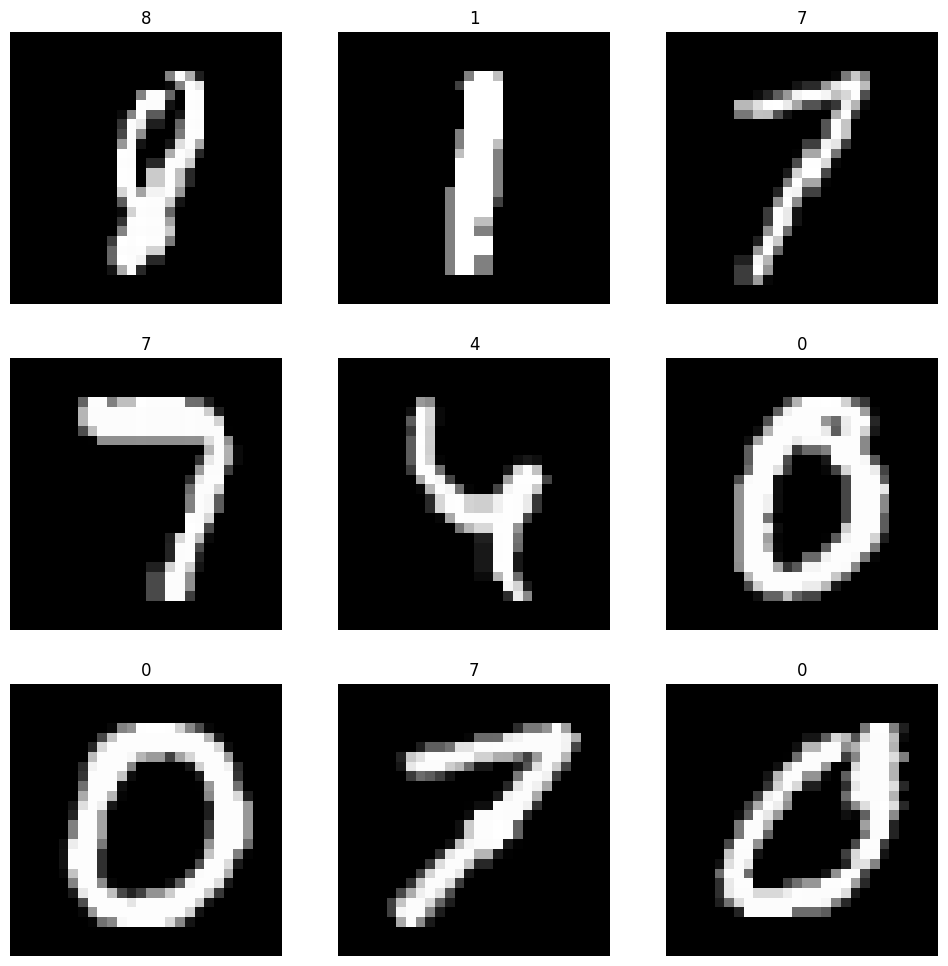

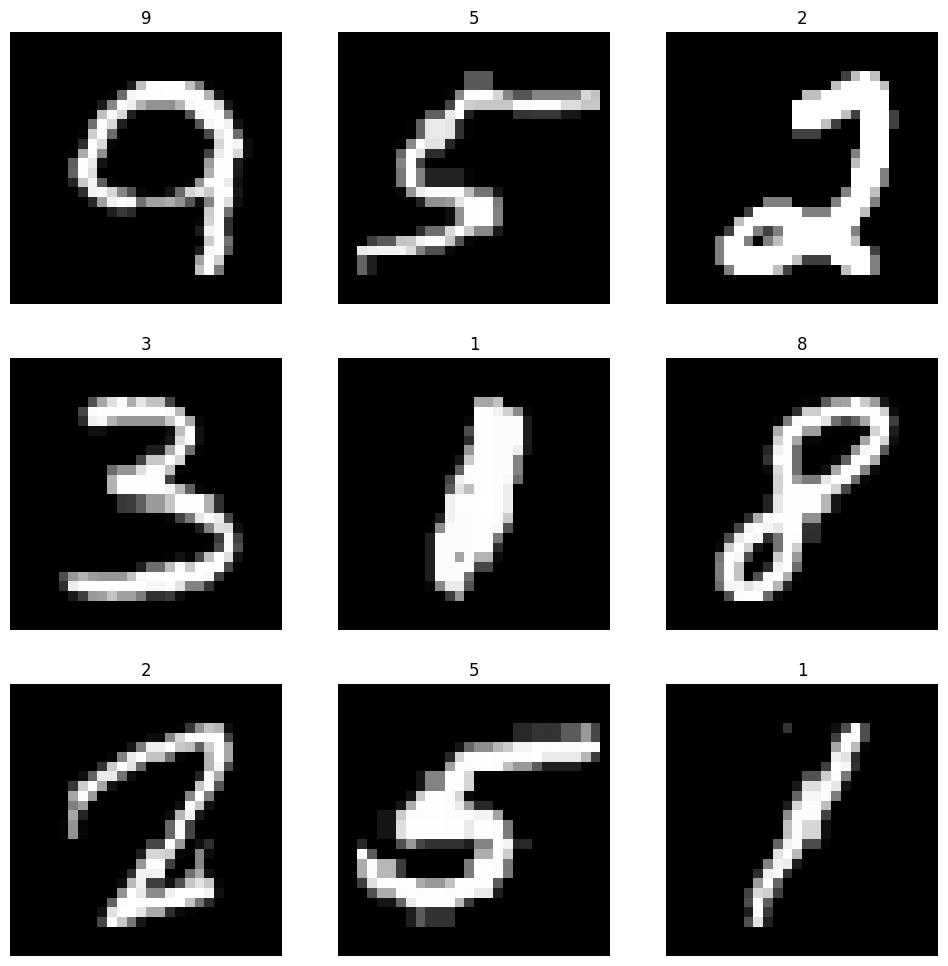

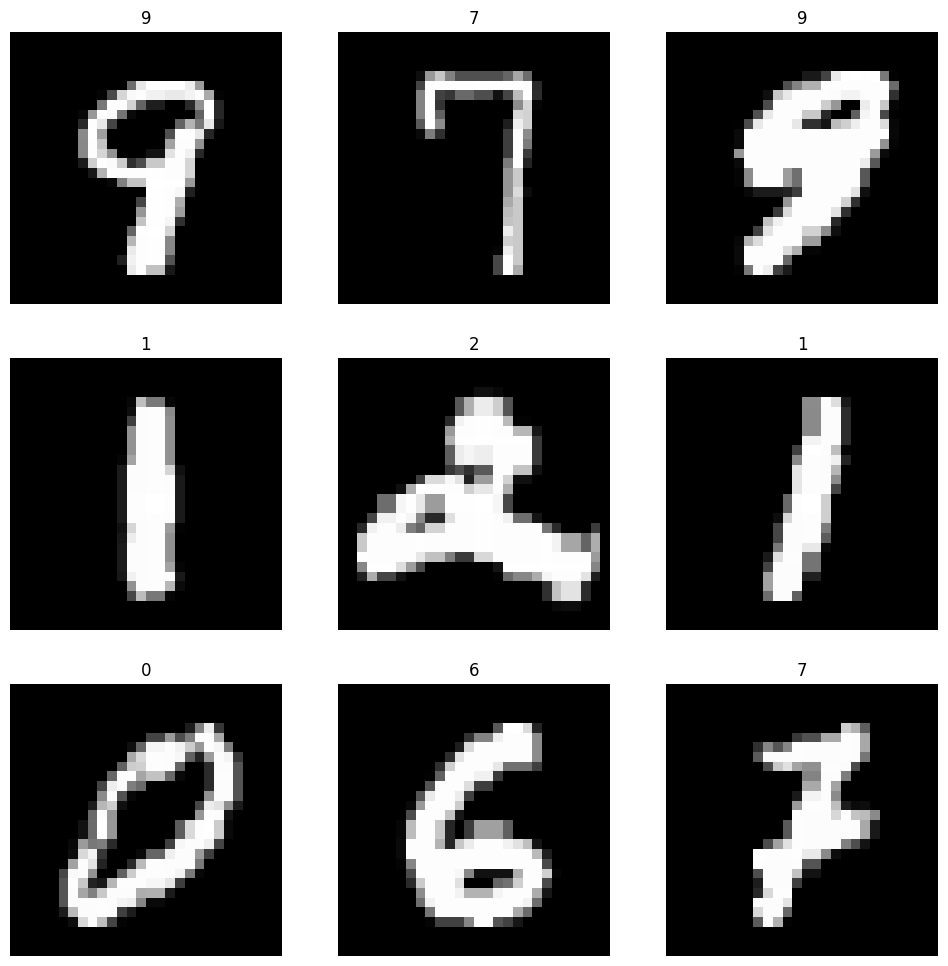

Training data shape: (192000, 28, 28, 1) (192000,)
Validation data shape: (48000, 28, 28, 1) (48000,)
Test data shape: (60000, 28, 28, 1) (60000,)
batch_size: 32, epochs: 5, learning_rate: 0.0001


/usr/local/lib/python3.10/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/5
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 31s 4ms/step - accuracy: 0.9085 - auc_24: 0.9892 - loss: 0.2996 - precision_24: 0.9383 - recall_24: 0.8862 - val_accuracy: 0.9839 - val_auc_24: 0.9990 - val_loss: 0.0580 - val_precision_24: 0.9867 - val_recall_24: 0.9820
Epoch 2/5
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 23s 4ms/step - accuracy: 0.9833 - auc_24: 0.9991 - loss: 0.0584 - precision_24: 0.9863 - recall_24: 0.9811 - val_accuracy: 0.9884 - val_auc_24: 0.9992 - val_loss: 0.0442 - val_precision_24: 0.9908 - val_recall_24: 0.9872
Epoch 3/5
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 23s 4ms/step - accuracy: 0.9888 - auc_24: 0.9995 - loss: 0.0376 - precision_24: 0.9911 - recall_24: 0.9875 - val_accuracy: 0.9910 - val_auc_24: 0.9993 - val_loss: 0.0350 - val_precision_24: 0.9929 - val_recall_24: 0.9904
Epoch 4/5
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 22s 4ms/step - accuracy: 0.9922 - auc_24: 0.9997 - loss: 0.0273 - precision_24: 0.9938 - recall_24: 0.9912 - val_accuracy: 0.9931 - val_auc_24: 0.9994 - val_loss: 0.0288 - v

Single Digits Validation loss: 0.02666463516652584
Single Digits Validation accuracy: 0.9936458468437195
batch_size: 32, epochs: 5, learning_rate: 0.001
Epoch 1/5
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 30s 4ms/step - accuracy: 0.9434 - auc_25: 0.9946 - loss: 0.1904 - precision_25: 0.9568 - recall_25: 0.9344 - val_accuracy: 0.9807 - val_auc_25: 0.9985 - val_loss: 0.0685 - val_precision_25: 0.9836 - val_recall_25: 0.9786
Epoch 2/5
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 23s 4ms/step - accuracy: 0.9822 - auc_25: 0.9989 - loss: 0.0607 - precision_25: 0.9857 - recall_25: 0.9801 - val_accuracy: 0.9885 - val_auc_25: 0.9991 - val_loss: 0.0452 - val_precision_25: 0.9912 - val_recall_25: 0.9869
Epoch 3/5
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 23s 4ms/step - accuracy: 0.9876 - auc_25: 0.9994 - loss: 0.0414 - precision_25: 0.9904 - recall_25: 0.9861 - val_accuracy: 0.9907 - val_auc_25: 0.9992 - val_loss: 0.0371 - val_precision_25: 0.9928 - val_recall_25: 0.9897
Epoch 4/5
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 23s 4ms/step - accur

Single Digits Validation loss: 0.028843650594353676
Single Digits Validation accuracy: 0.9942083358764648
batch_size: 32, epochs: 10, learning_rate: 0.001
Epoch 1/10
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 29s 4ms/step - accuracy: 0.9426 - auc_27: 0.9943 - loss: 0.1927 - precision_27: 0.9553 - recall_27: 0.9324 - val_accuracy: 0.9830 - val_auc_27: 0.9987 - val_loss: 0.0606 - val_precision_27: 0.9864 - val_recall_27: 0.9813
Epoch 2/10
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 23s 4ms/step - accuracy: 0.9825 - auc_27: 0.9988 - loss: 0.0608 - precision_27: 0.9859 - recall_27: 0.9804 - val_accuracy: 0.9865 - val_auc_27: 0.9987 - val_loss: 0.0559 - val_precision_27: 0.9884 - val_recall_27: 0.9849
Epoch 3/10
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 23s 4ms/step - accuracy: 0.9876 - auc_27: 0.9992 - loss: 0.0434 - precision_27: 0.9902 - recall_27: 0.9861 - val_accuracy: 0.9886 - val_auc_27: 0.9991 - val_loss: 0.0447 - val_precision_27: 0.9915 - val_recall_27: 0.9875
Epoch 4/10
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 23s 4ms/step -

Single Digits Validation loss: 0.026410121470689774
Single Digits Validation accuracy: 0.9943125247955322
batch_size: 64, epochs: 5, learning_rate: 0.001
Epoch 1/5
3000/3000 ━━━━━━━━━━━━━━━━━━━━ 21s 6ms/step - accuracy: 0.9455 - auc_29: 0.9947 - loss: 0.1818 - precision_29: 0.9588 - recall_29: 0.9358 - val_accuracy: 0.9797 - val_auc_29: 0.9990 - val_loss: 0.0689 - val_precision_29: 0.9835 - val_recall_29: 0.9772
Epoch 2/5
3000/3000 ━━━━━━━━━━━━━━━━━━━━ 15s 5ms/step - accuracy: 0.9841 - auc_29: 0.9992 - loss: 0.0532 - precision_29: 0.9869 - recall_29: 0.9823 - val_accuracy: 0.9867 - val_auc_29: 0.9993 - val_loss: 0.0460 - val_precision_29: 0.9901 - val_recall_29: 0.9849
Epoch 3/5
3000/3000 ━━━━━━━━━━━━━━━━━━━━ 15s 5ms/step - accuracy: 0.9881 - auc_29: 0.9995 - loss: 0.0391 - precision_29: 0.9907 - recall_29: 0.9868 - val_accuracy: 0.9903 - val_auc_29: 0.9990 - val_loss: 0.0389 - val_precision_29: 0.9924 - val_recall_29: 0.9893
Epoch 4/5
3000/3000 ━━━━━━━━━━━━━━━━━━━━ 15s 5ms/step - accu

Single Digits Validation loss: 0.026116197928786278
Single Digits Validation accuracy: 0.9943749904632568
batch_size: 64, epochs: 10, learning_rate: 0.001
Epoch 1/10
3000/3000 ━━━━━━━━━━━━━━━━━━━━ 21s 6ms/step - accuracy: 0.9406 - auc_31: 0.9942 - loss: 0.1946 - precision_31: 0.9551 - recall_31: 0.9299 - val_accuracy: 0.9718 - val_auc_31: 0.9985 - val_loss: 0.0928 - val_precision_31: 0.9777 - val_recall_31: 0.9676
Epoch 2/10
3000/3000 ━━━━━━━━━━━━━━━━━━━━ 15s 5ms/step - accuracy: 0.9838 - auc_31: 0.9991 - loss: 0.0540 - precision_31: 0.9869 - recall_31: 0.9817 - val_accuracy: 0.9842 - val_auc_31: 0.9980 - val_loss: 0.0636 - val_precision_31: 0.9865 - val_recall_31: 0.9834
Epoch 3/10
3000/3000 ━━━━━━━━━━━━━━━━━━━━ 15s 5ms/step - accuracy: 0.9883 - auc_31: 0.9994 - loss: 0.0391 - precision_31: 0.9907 - recall_31: 0.9867 - val_accuracy: 0.9898 - val_auc_31: 0.9991 - val_loss: 0.0397 - val_precision_31: 0.9919 - val_recall_31: 0.9885
Epoch 4/10
3000/3000 ━━━━━━━━━━━━━━━━━━━━ 15s 5ms/step -

Single Digits Validation loss: 0.03601472079753876
Single Digits Validation accuracy: 0.9944583177566528
Single Digits Best Hyperparameters (CNN): {'batch_size': 64, 'epochs': 10, 'learning_rate': 0.001}
Single Digits Best Accuracy Score (CNN): 0.9944583177566528


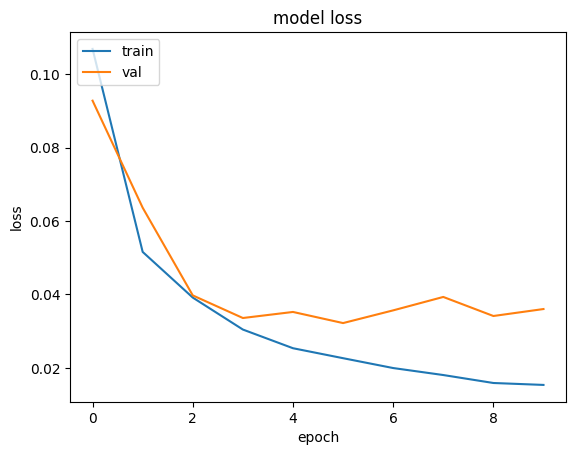

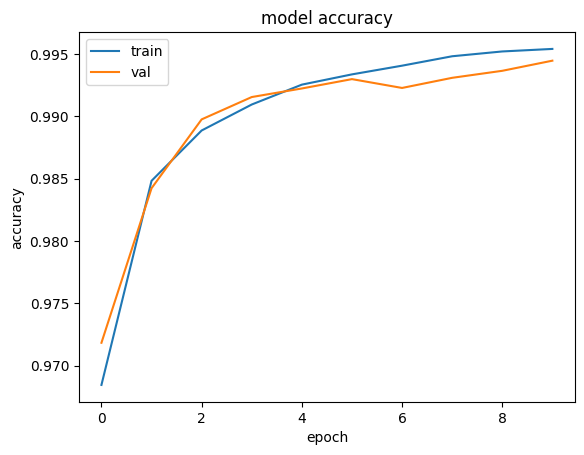

Single Digits Test loss: 0.027240246534347534
Single Digits Test accuracy: 0.994949996471405
Single Digits Test precision: 0.9959438443183899
Single Digits Test recall: 0.9944333434104919
Single Digits Test AUC: 0.9993382692337036
single digit classific report
1875/1875 ━━━━━━━━━━━━━━━━━━━━ 3s 1ms/step
Classification Report (Single Digits):
              precision    recall  f1-score   support

           0     0.9956    0.9976    0.9966      6300
           1     0.9969    0.9971    0.9970      5800
           2     0.9922    0.9912    0.9917      4900
           3     0.9950    0.9950    0.9950      5800
           4     0.9968    0.9977    0.9973      6600
           5     0.9945    0.9899    0.9921      6700
           6     0.9969    0.9948    0.9958      6500
           7     0.9871    0.9966    0.9918      5000
           8     0.9957    0.9963    0.9960      6700
           9     0.9968    0.9930    0.9949      5700

    accuracy                         0.9950     60000
   macr

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


[[  0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0 

In [ ]:
#TASK-3 CNN with 3 distinct digits only bTCH NORMlızatıon
import tensorflow as tf
import tensorflow.keras as keras
from tensorflow.keras import layers, models
from sklearn.metrics import classification_report, confusion_matrix
import cv2
from tensorflow.keras import models, layers, optimizers, losses, metrics
##### SPLIT FUNCTION AND ITS DEMONSTRATION #####
digit_shape = (28, 28)
def crop_digits(img_path: str = None, im = None):
    #if im is None:
    #    im = cv2.imread(img_path)

    #gray = cv2.cvtColor(im, cv2.COLOR_BGR2GRAY)
    blur = cv2.GaussianBlur(img_path, (5, 5), 0)
    thresh = cv2.threshold(blur, 90, 255, cv2.THRESH_BINARY+cv2.THRESH_OTSU)[1]
    contours, hierarchy = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    digits = []
    rect = img_path.copy()
    for cnt in contours:
        x, y, w, h = cv2.boundingRect(cnt)
##########################################################666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666
        x = max(x - 3, 0)
        y = max(y - 3, 0)
        w += 6
        h += 6

        del_x = int(w / 2)
        del_y = int(h / 2)
        center_x = x + del_x
        center_y = y + del_y

        lu_corner = (max(center_x - del_y, 0), y)
        rd_corner = (max(center_x + del_y, 0), y + h)

        rect = cv2.rectangle(rect, lu_corner, rd_corner, (255, 0, 0), 2) #rectangle

        cropped = img_path[lu_corner[1]:rd_corner[1], lu_corner[0]:rd_corner[0]]
        digits.append(cropped)

    def filter_and_sort_digits(digits, contours):
        sizes = []
        for digit in digits:
            size = digit.shape[0] * digit.shape[1]
            sizes.append(size)
        avg_size = sum(sizes) / len(sizes)
        deviations = [abs(size - avg_size) for size in sizes]

        indices = np.argsort(deviations)[0:3]
        digits = [digits[i] for i in indices]
        contours = [cv2.boundingRect(contours[i]) for i in indices]

        xs = [contour[0] for contour in contours]
        indices = np.argsort(xs) #get highest likelihood digit
        digits = [digits[i] for i in indices]

        while len(digits) < 3:
            digits.append(digits[0])
        return digits

    digits = filter_and_sort_digits(digits, contours) #get highest likelihood digits
    digits = [cv2.resize(digit, digit_shape, interpolation = cv2.INTER_NEAREST) for digit in digits] #resize to 28,28

    return digits, contours, rect

print(f"Label: {train_labels[0]}")
print(train_labels[0][0])
print(train_labels[0][1])
print(train_labels[0][2])

fig = plt.figure(figsize=(8, 8))
cols, rows = 3, 3

digits, contours, rect = crop_digits(train_images[0])

fig.add_subplot(rows, cols, 1)
plt.axis("off")
plt.imshow(rect.squeeze(), cmap="gray")
for i in range(len(digits)):
    img = digits[i]
    print(train_labels[0][i])
    fig.add_subplot(rows, cols, i+2)
    plt.axis("off")
    plt.imshow(img.squeeze(), cmap="gray")
    print(f"crop shape: {img.shape}")
plt.show()


##### SPLIT ALL DATA TO DIGITS #####
def load_digits(images, labels):
  all_digits = []
  all_labels = []
  for i in range(len(images)):
    digits, contours, rect = crop_digits(images[i])
    for j in range(len(digits)):
      all_digits.append(digits[j])
      all_labels.append(labels[i][j])
  return np.array(all_digits), np.array(all_labels)

train_images, train_labels = load_digits(train_images, train_labels)
test_images_digits, test_labels_digits = load_digits(test_images, test_labels)
val_images, val_labels = load_digits(val_images, val_labels)
print(len(train_images))
print(len(test_images_digits))
print(len(val_images))
print(train_images.shape)
print(test_images_digits.shape)
print(val_images.shape)
print(train_labels.shape)
print(test_labels_digits.shape)
print(val_labels.shape)

print(len(np.unique(train_labels)))
print(len(np.unique(test_labels_digits)))
print(len(np.unique(val_labels)))

def visualize(images, labels):
  np.random.seed(42)
  random_indices = np.random.choice(len(images), size=9, replace=False)
  random_images = images[random_indices]
  random_labels = labels[random_indices]

  fig, axes = plt.subplots(3, 3, figsize=(12, 12))
  for i, (img, label) in enumerate(zip(random_images, random_labels)):
      ax = axes[i // 3, i % 3]
      ax.imshow(img, cmap='gray')
      ax.set_title(label)
      ax.axis('off')
  plt.show()

visualize(train_images, train_labels)
visualize(test_images_digits, test_labels_digits)
visualize(val_images, val_labels)

################################################################################################################################maxpooling iyii sionuc asssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssss
##### TRAIN CNN #####
train_images = train_images / 255.0
val_images = val_images / 255.0
test_images_digits = test_images_digits / 255.0

train_images = train_images.reshape((train_images.shape[0], 28, 28, 1))
val_images = val_images.reshape((val_images.shape[0], 28, 28, 1))
test_images_digits = test_images_digits.reshape((test_images_digits.shape[0], 28, 28, 1))

print('Training data shape:', train_images.shape, train_labels.shape)
print('Validation data shape:', val_images.shape, val_labels.shape)
print('Test data shape:', test_images_digits.shape, test_labels_digits.shape)

train_labels = tf.keras.utils.to_categorical(train_labels, num_classes=10)
val_labels = tf.keras.utils.to_categorical(val_labels, num_classes=10)
test_labels_digits = tf.keras.utils.to_categorical(test_labels_digits, num_classes=10)



# FOR TASK 4, NO HYPERPARAM SEARCH NEEDED!
param_grid_cnn = {
    'batch_size': [32,64],
    'epochs': [5,10],
    'learning_rate': [1e-4,1e-3],
    #'batch_size': [32],
    #'epochs': [7],
    #'learning_rate': [1e-2],
}

best_params_cnn = None
best_accuracy_cnn = -1
for batch_size in param_grid_cnn['batch_size']:
    for epochs in param_grid_cnn['epochs']:
        for learning_rate in param_grid_cnn['learning_rate']:
          print(f"batch_size: {batch_size}, epochs: {epochs}, learning_rate: {learning_rate}")
          model = models.Sequential()
          model.add(layers.Conv2D(64, (3, 3), activation='relu', input_shape=(28, 28, 1)))
          model.add(layers.BatchNormalization()) #### FOR TASK 4
          model.add(layers.MaxPooling2D((2, 2)))
          model.add(layers.Conv2D(128, (3, 3), activation='relu'))
          model.add(layers.BatchNormalization()) #### FOR TASK 4
          model.add(layers.MaxPooling2D((2, 2)))
          model.add(layers.Conv2D(256, (3, 3), activation='relu')) #### FOR TASK 4
          model.add(layers.BatchNormalization()) #### FOR TASK 4
          model.add(layers.MaxPooling2D((2, 2))) #### FOR TASK 4
          model.add(layers.Flatten())
          model.add(layers.Dense(256, activation='relu'))
          model.add(layers.Dropout(0.3)) #0.7 #### FOR TASK 4
          model.add(layers.Dense(10, activation='softmax'))
          model.compile(loss="categorical_crossentropy", optimizer=keras.optimizers.Adam(learning_rate=learning_rate), metrics=["accuracy", metrics.Precision(), metrics.Recall(), metrics.AUC()])


          history = model.fit(train_images, train_labels, batch_size=batch_size, epochs=epochs, validation_data=(val_images, val_labels))

          score_train = model.evaluate(train_images, train_labels, verbose=0)
          print("Single Digits Train loss:", score_train[0])
          print("Single Digits Train accuracy:", score_train[1])
          score_val = model.evaluate(val_images, val_labels, verbose=0)
          print("Single Digits Validation loss:", score_val[0])
          print("Single Digits Validation accuracy:", score_val[1])
          if score_val[1] > best_accuracy_cnn:
                  best_accuracy_cnn = score_val[1]
                  best_params_cnn = {'batch_size': batch_size, 'epochs': epochs, 'learning_rate':learning_rate}
                  model.save('best_model.h5')

print("Single Digits Best Hyperparameters (CNN):", best_params_cnn)
print("Single Digits Best Accuracy Score (CNN):", best_accuracy_cnn)
model = tf.keras.models.load_model('best_model.h5')
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

score = model.evaluate(test_images_digits, test_labels_digits, verbose=0)
print("Single Digits Test loss:", score[0])
print("Single Digits Test accuracy:", score[1])
print("Single Digits Test precision:", score[2])
print("Single Digits Test recall:", score[3])
print("Single Digits Test AUC:", score[4])
print("single digit classific report")
predictions_digits = model.predict(test_images_digits)
predicted_labels_digits = np.argmax(predictions_digits, axis=1)  # Convert predictions to class labels
true_labels_digits = np.argmax(test_labels_digits, axis=1)  # Convert one-hot encoded labels to class labels

# Print the classification report for single digits
print("Classification Report (Single Digits):")
print(classification_report(true_labels_digits, predicted_labels_digits, digits=4))

final_test_predictions = []
for i in range(len(test_images)):
  img = test_images[i]
  concat = ""
  for j in range(0,3):
    img_digit = test_images_digits[3*i + j]
    #prediction = model.predict_on_batch([img_digit])
    prediction = model.predict_on_batch(np.expand_dims(img_digit, axis=0))
    prediction = np.argmax(prediction)
    #print(prediction, test_labels[i])
    concat = concat + str(prediction)
  #print(concat, test_labels[i])
  final_test_predictions.append(concat)

np.set_printoptions(threshold=np.inf)

print("Classification Report:")
print(classification_report(test_labels, final_test_predictions, digits = 4))

print("\nConfusion Matrix:")
print(confusion_matrix(test_labels, final_test_predictions))

# 1 dense 2 layer dropout 0.3 bn

In [ ]:
import google.colab as colab
colab.drive.mount('/content/drive')
import numpy as np
import matplotlib.pyplot as plt

train_images = np.load('/content/drive/MyDrive/npy_2/np_save_train_images_2.npy')
train_labels = np.load('/content/drive/MyDrive/npy_2/np_save_train_labels_2.npy')
test_images = np.load('/content/drive/MyDrive/npy_2/np_save_test_images_2.npy')
test_labels = np.load('/content/drive/MyDrive/npy_2/np_save_test_labels_2.npy')
val_images = np.load('/content/drive/MyDrive/npy_2/np_save_val_images_2.npy')
val_labels = np.load('/content/drive/MyDrive/npy_2/np_save_val_labels_2.npy')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


Label: 000
0
0
0
0
crop shape: (28, 28)
0
crop shape: (28, 28)
0
crop shape: (28, 28)


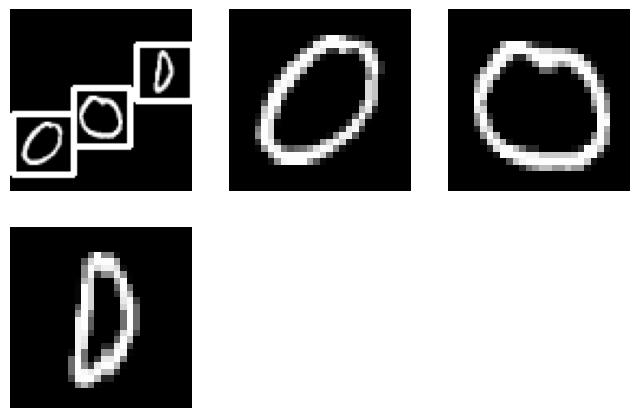

192000
60000
48000
(192000, 28, 28)
(60000, 28, 28)
(48000, 28, 28)
(192000,)
(60000,)
(48000,)
10
10
10


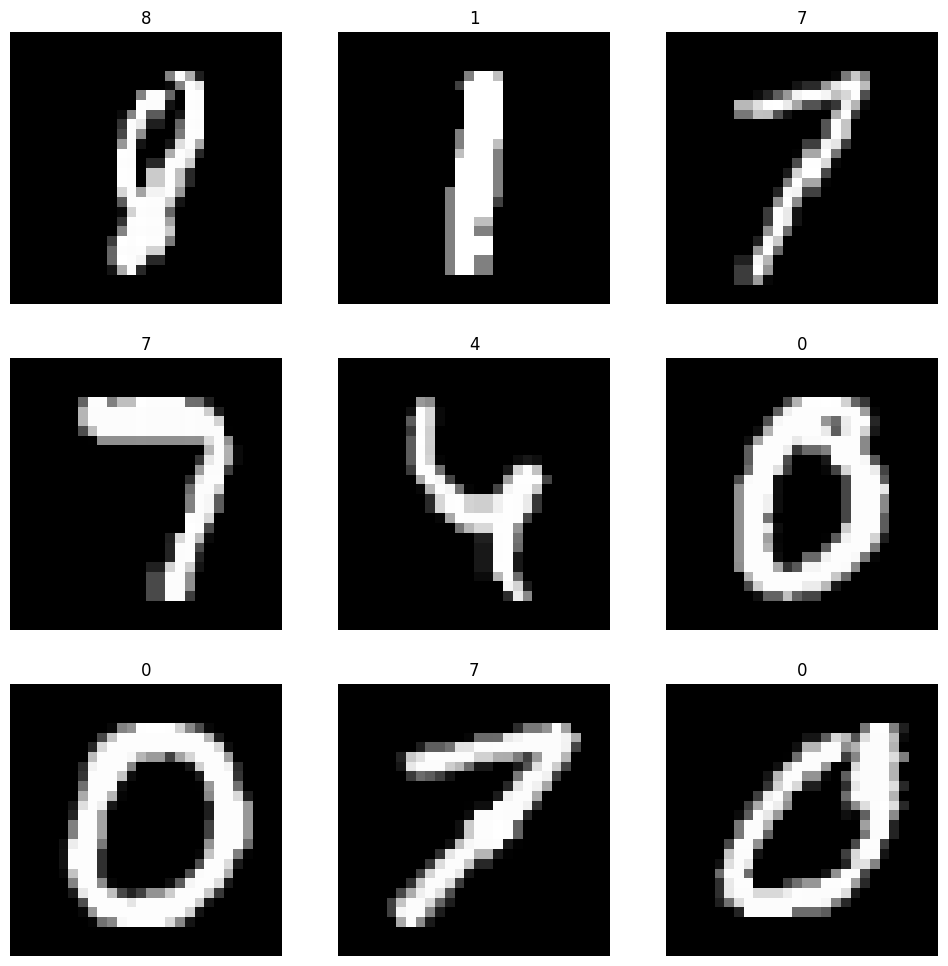

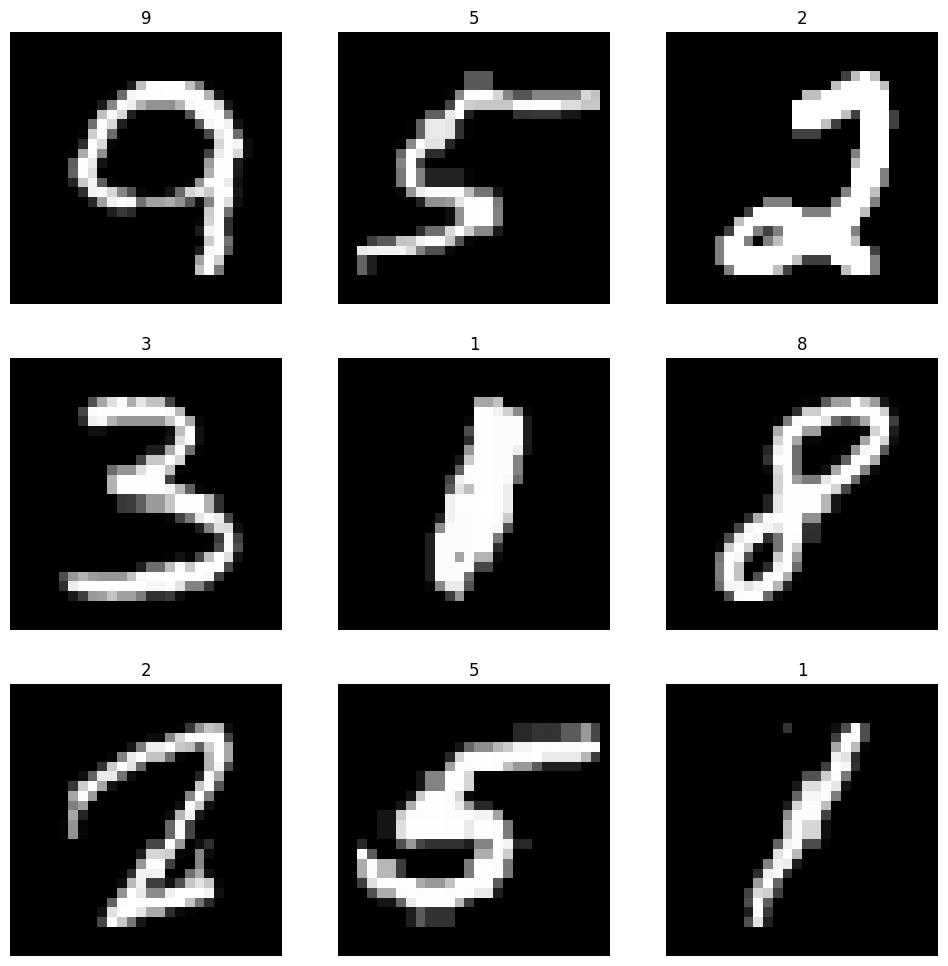

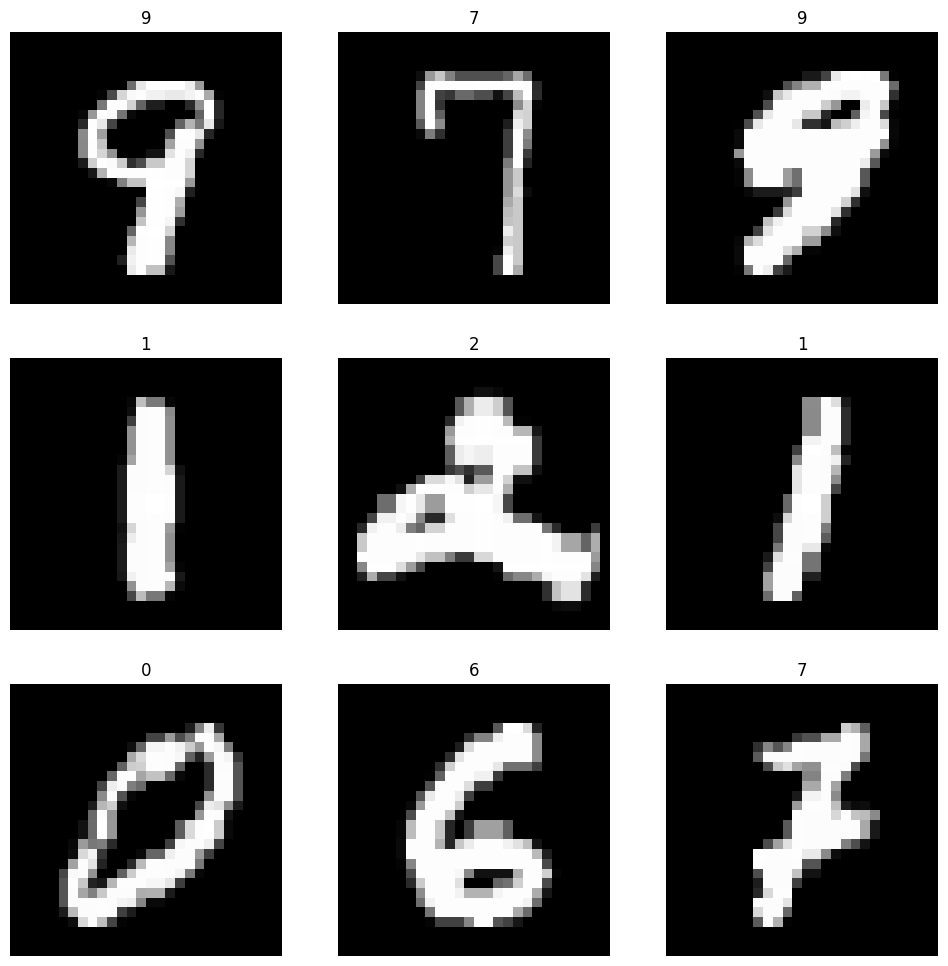

Training data shape: (192000, 28, 28, 1) (192000,)
Validation data shape: (48000, 28, 28, 1) (48000,)
Test data shape: (60000, 28, 28, 1) (60000,)
batch_size: 32, epochs: 5, learning_rate: 0.0001


/usr/local/lib/python3.10/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/5
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 27s 4ms/step - accuracy: 0.9280 - auc_32: 0.9917 - loss: 0.2418 - precision_32: 0.9510 - recall_32: 0.9120 - val_accuracy: 0.9883 - val_auc_32: 0.9991 - val_loss: 0.0446 - val_precision_32: 0.9904 - val_recall_32: 0.9868
Epoch 2/5
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 20s 3ms/step - accuracy: 0.9855 - auc_32: 0.9992 - loss: 0.0492 - precision_32: 0.9883 - recall_32: 0.9838 - val_accuracy: 0.9919 - val_auc_32: 0.9994 - val_loss: 0.0319 - val_precision_32: 0.9940 - val_recall_32: 0.9910
Epoch 3/5
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 20s 3ms/step - accuracy: 0.9904 - auc_32: 0.9995 - loss: 0.0326 - precision_32: 0.9925 - recall_32: 0.9891 - val_accuracy: 0.9942 - val_auc_32: 0.9994 - val_loss: 0.0260 - val_precision_32: 0.9959 - val_recall_32: 0.9935
Epoch 4/5
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 20s 3ms/step - accuracy: 0.9928 - auc_32: 0.9996 - loss: 0.0255 - precision_32: 0.9945 - recall_32: 0.9919 - val_accuracy: 0.9947 - val_auc_32: 0.9994 - val_loss: 0.0262 - v

Single Digits Validation loss: 0.022888407111167908
Single Digits Validation accuracy: 0.995145857334137
batch_size: 32, epochs: 5, learning_rate: 0.001
Epoch 1/5
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 25s 3ms/step - accuracy: 0.9428 - auc_33: 0.9933 - loss: 0.2086 - precision_33: 0.9544 - recall_33: 0.9356 - val_accuracy: 0.9827 - val_auc_33: 0.9984 - val_loss: 0.0654 - val_precision_33: 0.9862 - val_recall_33: 0.9811
Epoch 2/5
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 19s 3ms/step - accuracy: 0.9828 - auc_33: 0.9988 - loss: 0.0608 - precision_33: 0.9869 - recall_33: 0.9808 - val_accuracy: 0.9912 - val_auc_33: 0.9991 - val_loss: 0.0398 - val_precision_33: 0.9936 - val_recall_33: 0.9903
Epoch 3/5
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 19s 3ms/step - accuracy: 0.9880 - auc_33: 0.9993 - loss: 0.0444 - precision_33: 0.9911 - recall_33: 0.9863 - val_accuracy: 0.9921 - val_auc_33: 0.9993 - val_loss: 0.0344 - val_precision_33: 0.9948 - val_recall_33: 0.9904
Epoch 4/5
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 19s 3ms/step - accur

Single Digits Validation loss: 0.024685846641659737
Single Digits Validation accuracy: 0.9959791898727417
batch_size: 32, epochs: 10, learning_rate: 0.001
Epoch 1/10
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 25s 3ms/step - accuracy: 0.9421 - auc_35: 0.9931 - loss: 0.2128 - precision_35: 0.9529 - recall_35: 0.9346 - val_accuracy: 0.9864 - val_auc_35: 0.9988 - val_loss: 0.0549 - val_precision_35: 0.9895 - val_recall_35: 0.9846
Epoch 2/10
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 19s 3ms/step - accuracy: 0.9829 - auc_35: 0.9988 - loss: 0.0613 - precision_35: 0.9867 - recall_35: 0.9807 - val_accuracy: 0.9902 - val_auc_35: 0.9989 - val_loss: 0.0435 - val_precision_35: 0.9924 - val_recall_35: 0.9893
Epoch 3/10
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 19s 3ms/step - accuracy: 0.9883 - auc_35: 0.9993 - loss: 0.0417 - precision_35: 0.9911 - recall_35: 0.9869 - val_accuracy: 0.9921 - val_auc_35: 0.9992 - val_loss: 0.0368 - val_precision_35: 0.9942 - val_recall_35: 0.9914
Epoch 4/10
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 20s 3ms/step -

Single Digits Validation loss: 0.03038579225540161
Single Digits Validation accuracy: 0.9952083230018616
Single Digits Best Hyperparameters (CNN): {'batch_size': 32, 'epochs': 10, 'learning_rate': 0.0001}
Single Digits Best Accuracy Score (CNN): 0.9959791898727417


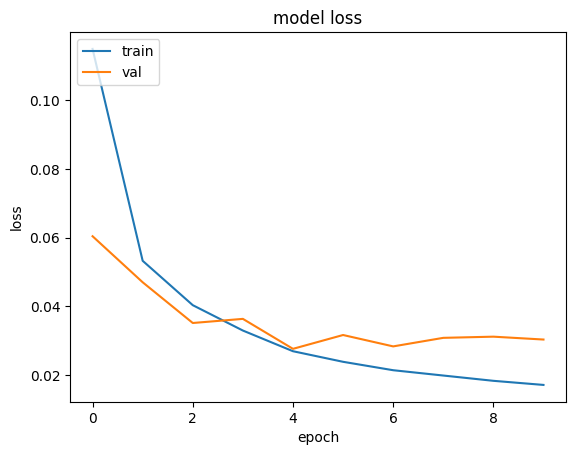

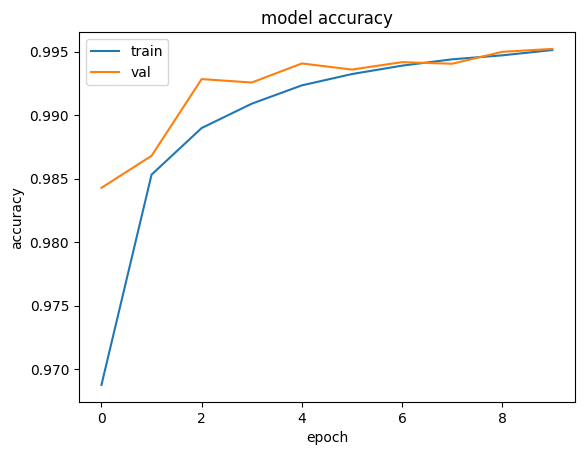

Single Digits Test loss: 0.01746334880590439
Single Digits Test accuracy: 0.9968500137329102
Single Digits Test precision: 0.9977474212646484
Single Digits Test recall: 0.9965999722480774
Single Digits Test AUC: 0.99958735704422
single digit classific report
1875/1875 ━━━━━━━━━━━━━━━━━━━━ 3s 1ms/step
Classification Report (Single Digits):
              precision    recall  f1-score   support

           0     0.9987    0.9976    0.9982      6300
           1     0.9971    0.9974    0.9972      5800
           2     0.9951    0.9978    0.9964      4900
           3     0.9979    0.9943    0.9961      5800
           4     0.9982    0.9979    0.9980      6600
           5     0.9930    0.9966    0.9948      6700
           6     0.9968    0.9971    0.9969      6500
           7     0.9982    0.9968    0.9975      5000
           8     0.9961    0.9975    0.9968      6700
           9     0.9977    0.9954    0.9966      5700

    accuracy                         0.9969     60000
   macro 

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


[[100   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0 

In [ ]:
#TASK-3 CNN with 3 distinct digits only bTCH NORMlızatıon
import tensorflow as tf
import tensorflow.keras as keras
from tensorflow.keras import layers, models
from sklearn.metrics import classification_report, confusion_matrix
import cv2
from tensorflow.keras import models, layers, optimizers, losses, metrics
##### SPLIT FUNCTION AND ITS DEMONSTRATION #####
digit_shape = (28, 28)
def crop_digits(img_path: str = None, im = None):
    #if im is None:
    #    im = cv2.imread(img_path)

    #gray = cv2.cvtColor(im, cv2.COLOR_BGR2GRAY)
    blur = cv2.GaussianBlur(img_path, (5, 5), 0)
    thresh = cv2.threshold(blur, 90, 255, cv2.THRESH_BINARY+cv2.THRESH_OTSU)[1]
    contours, hierarchy = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    digits = []
    rect = img_path.copy()
    for cnt in contours:
        x, y, w, h = cv2.boundingRect(cnt)
##########################################################666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666
        x = max(x - 3, 0)
        y = max(y - 3, 0)
        w += 6
        h += 6

        del_x = int(w / 2)
        del_y = int(h / 2)
        center_x = x + del_x
        center_y = y + del_y

        lu_corner = (max(center_x - del_y, 0), y)
        rd_corner = (max(center_x + del_y, 0), y + h)

        rect = cv2.rectangle(rect, lu_corner, rd_corner, (255, 0, 0), 2) #rectangle

        cropped = img_path[lu_corner[1]:rd_corner[1], lu_corner[0]:rd_corner[0]]
        digits.append(cropped)

    def filter_and_sort_digits(digits, contours):
        sizes = []
        for digit in digits:
            size = digit.shape[0] * digit.shape[1]
            sizes.append(size)
        avg_size = sum(sizes) / len(sizes)
        deviations = [abs(size - avg_size) for size in sizes]

        indices = np.argsort(deviations)[0:3]
        digits = [digits[i] for i in indices]
        contours = [cv2.boundingRect(contours[i]) for i in indices]

        xs = [contour[0] for contour in contours]
        indices = np.argsort(xs) #get highest likelihood digit
        digits = [digits[i] for i in indices]

        while len(digits) < 3:
            digits.append(digits[0])
        return digits

    digits = filter_and_sort_digits(digits, contours) #get highest likelihood digits
    digits = [cv2.resize(digit, digit_shape, interpolation = cv2.INTER_NEAREST) for digit in digits] #resize to 28,28

    return digits, contours, rect

print(f"Label: {train_labels[0]}")
print(train_labels[0][0])
print(train_labels[0][1])
print(train_labels[0][2])

fig = plt.figure(figsize=(8, 8))
cols, rows = 3, 3

digits, contours, rect = crop_digits(train_images[0])

fig.add_subplot(rows, cols, 1)
plt.axis("off")
plt.imshow(rect.squeeze(), cmap="gray")
for i in range(len(digits)):
    img = digits[i]
    print(train_labels[0][i])
    fig.add_subplot(rows, cols, i+2)
    plt.axis("off")
    plt.imshow(img.squeeze(), cmap="gray")
    print(f"crop shape: {img.shape}")
plt.show()


##### SPLIT ALL DATA TO DIGITS #####
def load_digits(images, labels):
  all_digits = []
  all_labels = []
  for i in range(len(images)):
    digits, contours, rect = crop_digits(images[i])
    for j in range(len(digits)):
      all_digits.append(digits[j])
      all_labels.append(labels[i][j])
  return np.array(all_digits), np.array(all_labels)

train_images, train_labels = load_digits(train_images, train_labels)
test_images_digits, test_labels_digits = load_digits(test_images, test_labels)
val_images, val_labels = load_digits(val_images, val_labels)
print(len(train_images))
print(len(test_images_digits))
print(len(val_images))
print(train_images.shape)
print(test_images_digits.shape)
print(val_images.shape)
print(train_labels.shape)
print(test_labels_digits.shape)
print(val_labels.shape)

print(len(np.unique(train_labels)))
print(len(np.unique(test_labels_digits)))
print(len(np.unique(val_labels)))

def visualize(images, labels):
  np.random.seed(42)
  random_indices = np.random.choice(len(images), size=9, replace=False)
  random_images = images[random_indices]
  random_labels = labels[random_indices]

  fig, axes = plt.subplots(3, 3, figsize=(12, 12))
  for i, (img, label) in enumerate(zip(random_images, random_labels)):
      ax = axes[i // 3, i % 3]
      ax.imshow(img, cmap='gray')
      ax.set_title(label)
      ax.axis('off')
  plt.show()

visualize(train_images, train_labels)
visualize(test_images_digits, test_labels_digits)
visualize(val_images, val_labels)

################################################################################################################################maxpooling iyii sionuc asssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssss
##### TRAIN CNN #####
train_images = train_images / 255.0
val_images = val_images / 255.0
test_images_digits = test_images_digits / 255.0

train_images = train_images.reshape((train_images.shape[0], 28, 28, 1))
val_images = val_images.reshape((val_images.shape[0], 28, 28, 1))
test_images_digits = test_images_digits.reshape((test_images_digits.shape[0], 28, 28, 1))

print('Training data shape:', train_images.shape, train_labels.shape)
print('Validation data shape:', val_images.shape, val_labels.shape)
print('Test data shape:', test_images_digits.shape, test_labels_digits.shape)

train_labels = tf.keras.utils.to_categorical(train_labels, num_classes=10)
val_labels = tf.keras.utils.to_categorical(val_labels, num_classes=10)
test_labels_digits = tf.keras.utils.to_categorical(test_labels_digits, num_classes=10)



# FOR TASK 4, NO HYPERPARAM SEARCH NEEDED!
param_grid_cnn = {
    'batch_size': [32,64],
    'epochs': [5,10],
    'learning_rate': [1e-4,1e-3],
    #'batch_size': [32],
    #'epochs': [7],
    #'learning_rate': [1e-2],
}

best_params_cnn = None
best_accuracy_cnn = -1
for batch_size in param_grid_cnn['batch_size']:
    for epochs in param_grid_cnn['epochs']:
        for learning_rate in param_grid_cnn['learning_rate']:
          print(f"batch_size: {batch_size}, epochs: {epochs}, learning_rate: {learning_rate}")
          model = models.Sequential()
          model.add(layers.Conv2D(64, (3, 3), activation='relu', input_shape=(28, 28, 1)))
          model.add(layers.BatchNormalization()) #### FOR TASK 4
          model.add(layers.MaxPooling2D((2, 2)))
          model.add(layers.Conv2D(128, (3, 3), activation='relu'))
          model.add(layers.BatchNormalization()) #### FOR TASK 4
          model.add(layers.MaxPooling2D((2, 2)))
          model.add(layers.Flatten())
          model.add(layers.Dense(128, activation='relu'))
          model.add(layers.Dropout(0.3)) #0.7 #### FOR TASK 4
          model.add(layers.Dense(10, activation='softmax'))
          model.compile(loss="categorical_crossentropy", optimizer=keras.optimizers.Adam(learning_rate=learning_rate), metrics=["accuracy", metrics.Precision(), metrics.Recall(), metrics.AUC()])


          history = model.fit(train_images, train_labels, batch_size=batch_size, epochs=epochs, validation_data=(val_images, val_labels))

          score_train = model.evaluate(train_images, train_labels, verbose=0)
          print("Single Digits Train loss:", score_train[0])
          print("Single Digits Train accuracy:", score_train[1])
          score_val = model.evaluate(val_images, val_labels, verbose=0)
          print("Single Digits Validation loss:", score_val[0])
          print("Single Digits Validation accuracy:", score_val[1])
          if score_val[1] > best_accuracy_cnn:
                  best_accuracy_cnn = score_val[1]
                  best_params_cnn = {'batch_size': batch_size, 'epochs': epochs, 'learning_rate':learning_rate}
                  model.save('best_model.h5')

print("Single Digits Best Hyperparameters (CNN):", best_params_cnn)
print("Single Digits Best Accuracy Score (CNN):", best_accuracy_cnn)
model = tf.keras.models.load_model('best_model.h5')
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

score = model.evaluate(test_images_digits, test_labels_digits, verbose=0)
print("Single Digits Test loss:", score[0])
print("Single Digits Test accuracy:", score[1])
print("Single Digits Test precision:", score[2])
print("Single Digits Test recall:", score[3])
print("Single Digits Test AUC:", score[4])
print("single digit classific report")
predictions_digits = model.predict(test_images_digits)
predicted_labels_digits = np.argmax(predictions_digits, axis=1)  # Convert predictions to class labels
true_labels_digits = np.argmax(test_labels_digits, axis=1)  # Convert one-hot encoded labels to class labels

# Print the classification report for single digits
print("Classification Report (Single Digits):")
print(classification_report(true_labels_digits, predicted_labels_digits, digits=4))

final_test_predictions = []
for i in range(len(test_images)):
  img = test_images[i]
  concat = ""
  for j in range(0,3):
    img_digit = test_images_digits[3*i + j]
    #prediction = model.predict_on_batch([img_digit])
    prediction = model.predict_on_batch(np.expand_dims(img_digit, axis=0))
    prediction = np.argmax(prediction)
    #print(prediction, test_labels[i])
    concat = concat + str(prediction)
  #print(concat, test_labels[i])
  final_test_predictions.append(concat)

np.set_printoptions(threshold=np.inf)

print("Classification Report:")
print(classification_report(test_labels, final_test_predictions, digits = 4))

print("\nConfusion Matrix:")
print(confusion_matrix(test_labels, final_test_predictions))

In [ ]:
from sklearn.metrics import ConfusionMatrixDisplay


# NO GRID SEARCH

Label: 000
0
0
0
0
crop shape: (28, 28)
0
crop shape: (28, 28)
0
crop shape: (28, 28)


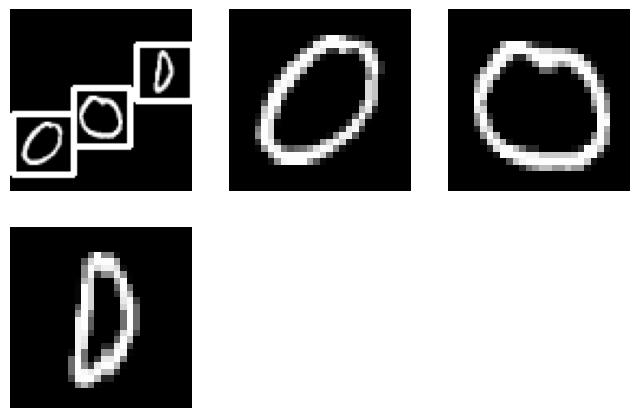

192000
60000
48000
(192000, 28, 28)
(60000, 28, 28)
(48000, 28, 28)
(192000,)
(60000,)
(48000,)
10
10
10


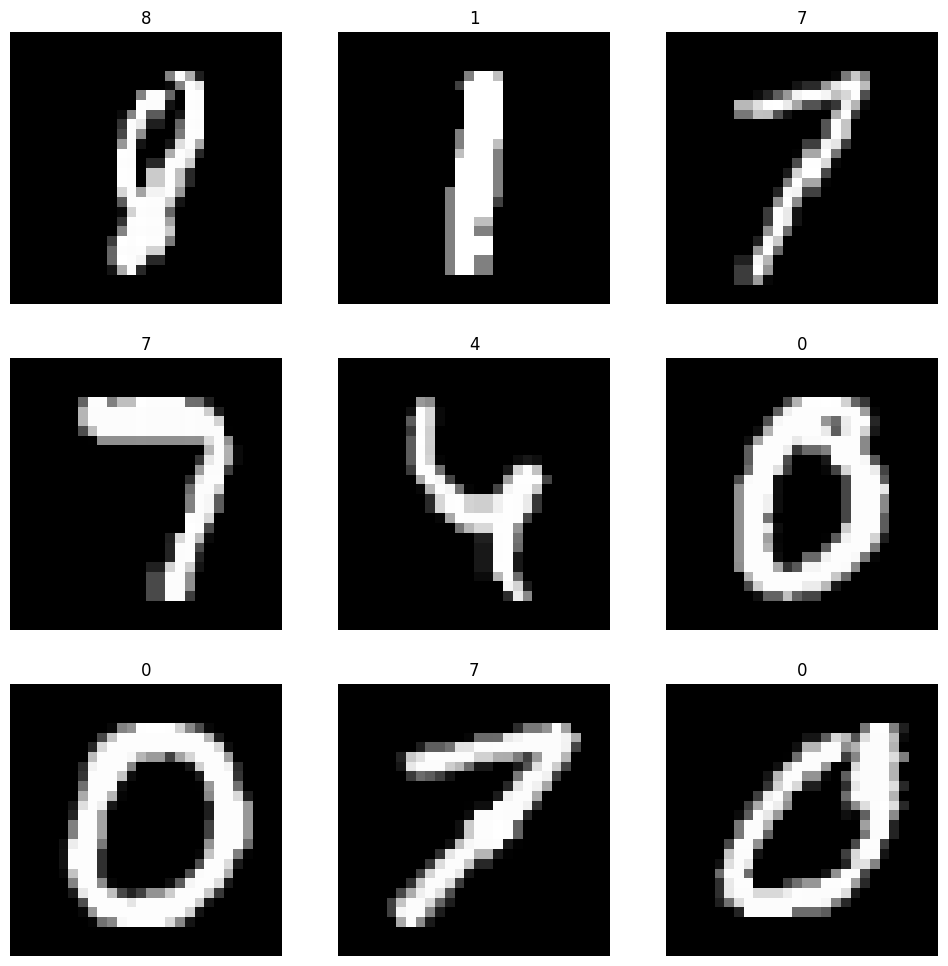

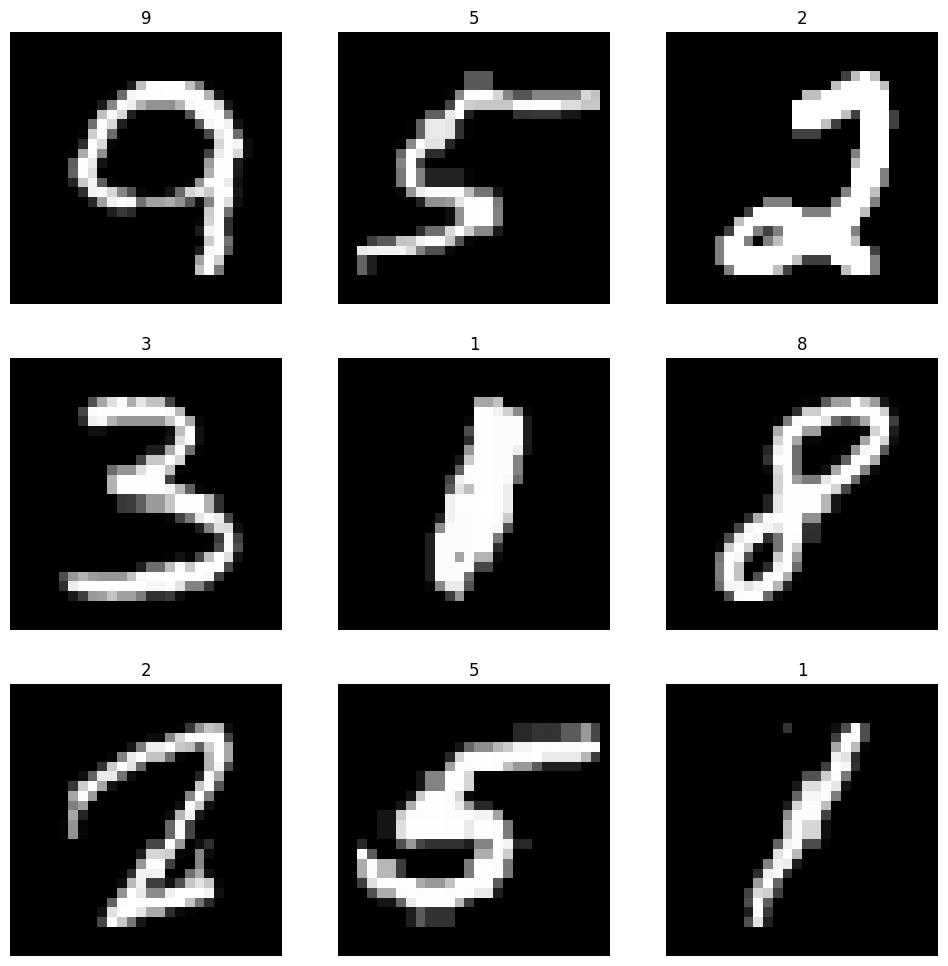

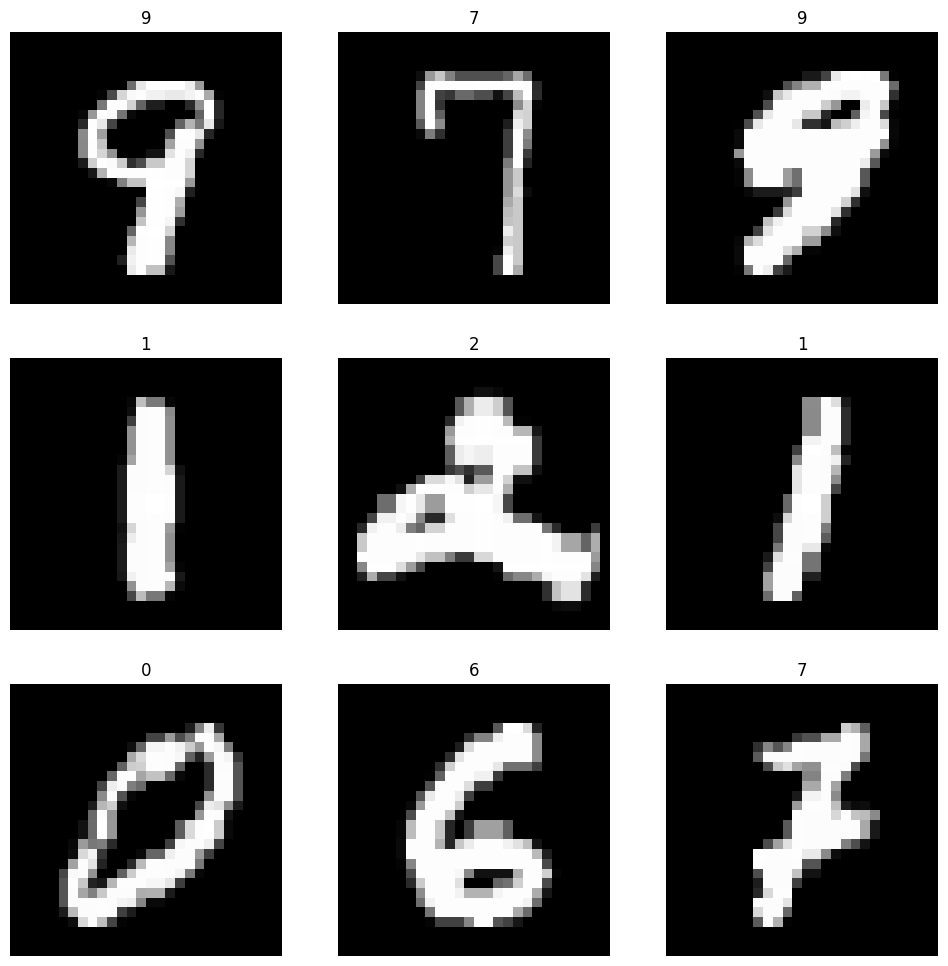

Training data shape: (192000, 28, 28, 1) (192000,)
Validation data shape: (48000, 28, 28, 1) (48000,)
Test data shape: (60000, 28, 28, 1) (60000,)
batch_size: 32, epochs: 10, learning_rate: 0.0001


/usr/local/lib/python3.10/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/10
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 25s 3ms/step - accuracy: 0.9243 - auc_1: 0.9910 - loss: 0.2557 - precision_1: 0.9474 - recall_1: 0.9081 - val_accuracy: 0.9880 - val_auc_1: 0.9990 - val_loss: 0.0442 - val_precision_1: 0.9905 - val_recall_1: 0.9871
Epoch 2/10
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 19s 3ms/step - accuracy: 0.9864 - auc_1: 0.9992 - loss: 0.0478 - precision_1: 0.9891 - recall_1: 0.9847 - val_accuracy: 0.9925 - val_auc_1: 0.9992 - val_loss: 0.0336 - val_precision_1: 0.9940 - val_recall_1: 0.9911
Epoch 3/10
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 19s 3ms/step - accuracy: 0.9910 - auc_1: 0.9996 - loss: 0.0320 - precision_1: 0.9934 - recall_1: 0.9897 - val_accuracy: 0.9941 - val_auc_1: 0.9993 - val_loss: 0.0270 - val_precision_1: 0.9956 - val_recall_1: 0.9936
Epoch 4/10
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 19s 3ms/step - accuracy: 0.9937 - auc_1: 0.9997 - loss: 0.0223 - precision_1: 0.9953 - recall_1: 0.9929 - val_accuracy: 0.9948 - val_auc_1: 0.9994 - val_loss: 0.0241 - val_precision_1: 0.

Single Digits Validation loss: 0.02470831386744976
Single Digits Validation accuracy: 0.9960208535194397
Single Digits Best Hyperparameters (CNN): {'batch_size': 32, 'epochs': 10, 'learning_rate': 0.0001}
Single Digits Best Accuracy Score (CNN): 0.9960208535194397


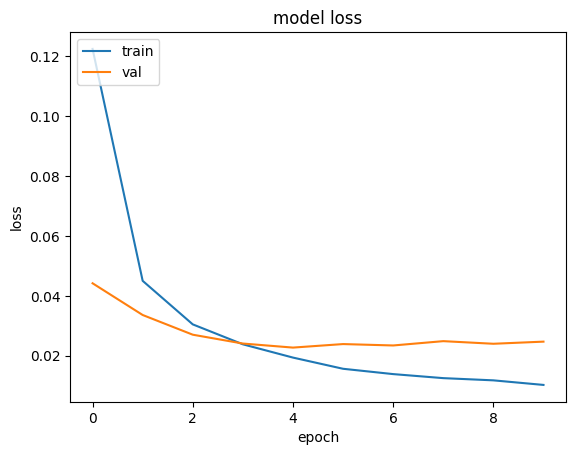

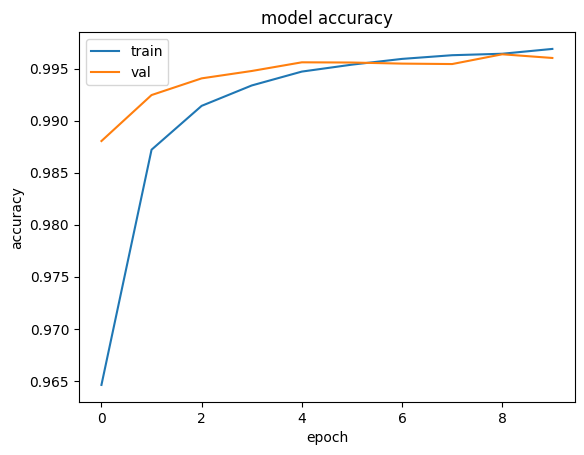

Single Digits Test loss: 0.017014119774103165
Single Digits Test accuracy: 0.9968833327293396
Single Digits Test precision: 0.9977473020553589
Single Digits Test recall: 0.9965500235557556
Single Digits Test AUC: 0.9995851516723633
single digit classific report
1875/1875 ━━━━━━━━━━━━━━━━━━━━ 2s 1ms/step


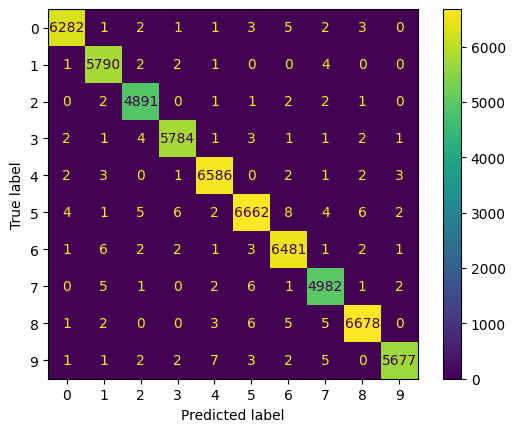

Classification Report (Single Digits):
              precision    recall  f1-score   support

           0     0.9981    0.9971    0.9976      6300
           1     0.9962    0.9983    0.9972      5800
           2     0.9963    0.9982    0.9972      4900
           3     0.9976    0.9972    0.9974      5800
           4     0.9971    0.9979    0.9975      6600
           5     0.9963    0.9943    0.9953      6700
           6     0.9960    0.9971    0.9965      6500
           7     0.9950    0.9964    0.9957      5000
           8     0.9975    0.9967    0.9971      6700
           9     0.9984    0.9960    0.9972      5700

    accuracy                         0.9969     60000
   macro avg     0.9969    0.9969    0.9969     60000
weighted avg     0.9969    0.9969    0.9969     60000

Classification Report:
              precision    recall  f1-score   support

         002     1.0000    1.0000    1.0000       100
         003     1.0000    0.9900    0.9950       100
         004    

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


[[100   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0 

In [ ]:
#TASK-3 CNN with 3 distinct digits only bTCH NORMlızatıon
import tensorflow as tf
import tensorflow.keras as keras
from tensorflow.keras import layers, models
from sklearn.metrics import classification_report, confusion_matrix
import cv2
from tensorflow.keras import models, layers, optimizers, losses, metrics
##### SPLIT FUNCTION AND ITS DEMONSTRATION #####
digit_shape = (28, 28)
def crop_digits(img_path: str = None, im = None):
    #if im is None:
    #    im = cv2.imread(img_path)

    #gray = cv2.cvtColor(im, cv2.COLOR_BGR2GRAY)
    blur = cv2.GaussianBlur(img_path, (5, 5), 0)
    thresh = cv2.threshold(blur, 90, 255, cv2.THRESH_BINARY+cv2.THRESH_OTSU)[1]
    contours, hierarchy = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    digits = []
    rect = img_path.copy()
    for cnt in contours:
        x, y, w, h = cv2.boundingRect(cnt)
##########################################################666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666
        x = max(x - 3, 0)
        y = max(y - 3, 0)
        w += 6
        h += 6

        del_x = int(w / 2)
        del_y = int(h / 2)
        center_x = x + del_x
        center_y = y + del_y

        lu_corner = (max(center_x - del_y, 0), y)
        rd_corner = (max(center_x + del_y, 0), y + h)

        rect = cv2.rectangle(rect, lu_corner, rd_corner, (255, 0, 0), 2) #rectangle

        cropped = img_path[lu_corner[1]:rd_corner[1], lu_corner[0]:rd_corner[0]]
        digits.append(cropped)

    def filter_and_sort_digits(digits, contours):
        sizes = []
        for digit in digits:
            size = digit.shape[0] * digit.shape[1]
            sizes.append(size)
        avg_size = sum(sizes) / len(sizes)
        deviations = [abs(size - avg_size) for size in sizes]

        indices = np.argsort(deviations)[0:3]
        digits = [digits[i] for i in indices]
        contours = [cv2.boundingRect(contours[i]) for i in indices]

        xs = [contour[0] for contour in contours]
        indices = np.argsort(xs) #get highest likelihood digit
        digits = [digits[i] for i in indices]

        while len(digits) < 3:
            digits.append(digits[0])
        return digits

    digits = filter_and_sort_digits(digits, contours) #get highest likelihood digits
    digits = [cv2.resize(digit, digit_shape, interpolation = cv2.INTER_NEAREST) for digit in digits] #resize to 28,28

    return digits, contours, rect

print(f"Label: {train_labels[0]}")
print(train_labels[0][0])
print(train_labels[0][1])
print(train_labels[0][2])

fig = plt.figure(figsize=(8, 8))
cols, rows = 3, 3

digits, contours, rect = crop_digits(train_images[0])

fig.add_subplot(rows, cols, 1)
plt.axis("off")
plt.imshow(rect.squeeze(), cmap="gray")
for i in range(len(digits)):
    img = digits[i]
    print(train_labels[0][i])
    fig.add_subplot(rows, cols, i+2)
    plt.axis("off")
    plt.imshow(img.squeeze(), cmap="gray")
    print(f"crop shape: {img.shape}")
plt.show()


##### SPLIT ALL DATA TO DIGITS #####
def load_digits(images, labels):
  all_digits = []
  all_labels = []
  for i in range(len(images)):
    digits, contours, rect = crop_digits(images[i])
    for j in range(len(digits)):
      all_digits.append(digits[j])
      all_labels.append(labels[i][j])
  return np.array(all_digits), np.array(all_labels)

train_images, train_labels = load_digits(train_images, train_labels)
test_images_digits, test_labels_digits = load_digits(test_images, test_labels)
val_images, val_labels = load_digits(val_images, val_labels)
print(len(train_images))
print(len(test_images_digits))
print(len(val_images))
print(train_images.shape)
print(test_images_digits.shape)
print(val_images.shape)
print(train_labels.shape)
print(test_labels_digits.shape)
print(val_labels.shape)

print(len(np.unique(train_labels)))
print(len(np.unique(test_labels_digits)))
print(len(np.unique(val_labels)))

def visualize(images, labels):
  np.random.seed(42)
  random_indices = np.random.choice(len(images), size=9, replace=False)
  random_images = images[random_indices]
  random_labels = labels[random_indices]

  fig, axes = plt.subplots(3, 3, figsize=(12, 12))
  for i, (img, label) in enumerate(zip(random_images, random_labels)):
      ax = axes[i // 3, i % 3]
      ax.imshow(img, cmap='gray')
      ax.set_title(label)
      ax.axis('off')
  plt.show()

visualize(train_images, train_labels)
visualize(test_images_digits, test_labels_digits)
visualize(val_images, val_labels)

################################################################################################################################maxpooling iyii sionuc asssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssss
##### TRAIN CNN #####
train_images = train_images / 255.0
val_images = val_images / 255.0
test_images_digits = test_images_digits / 255.0

train_images = train_images.reshape((train_images.shape[0], 28, 28, 1))
val_images = val_images.reshape((val_images.shape[0], 28, 28, 1))
test_images_digits = test_images_digits.reshape((test_images_digits.shape[0], 28, 28, 1))

print('Training data shape:', train_images.shape, train_labels.shape)
print('Validation data shape:', val_images.shape, val_labels.shape)
print('Test data shape:', test_images_digits.shape, test_labels_digits.shape)

train_labels = tf.keras.utils.to_categorical(train_labels, num_classes=10)
val_labels = tf.keras.utils.to_categorical(val_labels, num_classes=10)
test_labels_digits = tf.keras.utils.to_categorical(test_labels_digits, num_classes=10)



# FOR TASK 4, NO HYPERPARAM SEARCH NEEDED!
param_grid_cnn = {
    'batch_size': [32],
    'epochs': [10],
    'learning_rate': [1e-4],
    #'batch_size': [32],
    #'epochs': [7],
    #'learning_rate': [1e-2],
}

best_params_cnn = None
best_accuracy_cnn = -1
for batch_size in param_grid_cnn['batch_size']:
    for epochs in param_grid_cnn['epochs']:
        for learning_rate in param_grid_cnn['learning_rate']:
          print(f"batch_size: {batch_size}, epochs: {epochs}, learning_rate: {learning_rate}")
          model = models.Sequential()
          model.add(layers.Conv2D(64, (3, 3), activation='relu', input_shape=(28, 28, 1)))
          model.add(layers.BatchNormalization()) #### FOR TASK 4
          model.add(layers.MaxPooling2D((2, 2)))
          model.add(layers.Conv2D(128, (3, 3), activation='relu'))
          model.add(layers.BatchNormalization()) #### FOR TASK 4
          model.add(layers.MaxPooling2D((2, 2)))
          model.add(layers.Flatten())
          model.add(layers.Dense(128, activation='relu'))
          model.add(layers.Dropout(0.3)) #0.7 #### FOR TASK 4
          model.add(layers.Dense(10, activation='softmax'))
          model.compile(loss="categorical_crossentropy", optimizer=keras.optimizers.Adam(learning_rate=learning_rate), metrics=["accuracy", metrics.Precision(), metrics.Recall(), metrics.AUC()])


          history = model.fit(train_images, train_labels, batch_size=batch_size, epochs=epochs, validation_data=(val_images, val_labels))

          score_train = model.evaluate(train_images, train_labels, verbose=0)
          print("Single Digits Train loss:", score_train[0])
          print("Single Digits Train accuracy:", score_train[1])
          score_val = model.evaluate(val_images, val_labels, verbose=0)
          print("Single Digits Validation loss:", score_val[0])
          print("Single Digits Validation accuracy:", score_val[1])
          if score_val[1] > best_accuracy_cnn:
                  best_accuracy_cnn = score_val[1]
                  best_params_cnn = {'batch_size': batch_size, 'epochs': epochs, 'learning_rate':learning_rate}
                  model.save('best_model.h5')

print("Single Digits Best Hyperparameters (CNN):", best_params_cnn)
print("Single Digits Best Accuracy Score (CNN):", best_accuracy_cnn)
model = tf.keras.models.load_model('best_model.h5')
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

score = model.evaluate(test_images_digits, test_labels_digits, verbose=0)
print("Single Digits Test loss:", score[0])
print("Single Digits Test accuracy:", score[1])
print("Single Digits Test precision:", score[2])
print("Single Digits Test recall:", score[3])
print("Single Digits Test AUC:", score[4])
print("single digit classific report")
predictions_digits = model.predict(test_images_digits)
predicted_labels_digits = np.argmax(predictions_digits, axis=1)  # Convert predictions to class labels
true_labels_digits = np.argmax(test_labels_digits, axis=1)  # Convert one-hot encoded labels to class labels
cm = confusion_matrix(true_labels_digits, predicted_labels_digits)
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot()
plt.show()

# Print the classification report for single digits
print("Classification Report (Single Digits):")
print(classification_report(true_labels_digits, predicted_labels_digits, digits=4))

final_test_predictions = []
for i in range(len(test_images)):
  img = test_images[i]
  concat = ""
  for j in range(0,3):
    img_digit = test_images_digits[3*i + j]
    #prediction = model.predict_on_batch([img_digit])
    prediction = model.predict_on_batch(np.expand_dims(img_digit, axis=0))
    prediction = np.argmax(prediction)
    #print(prediction, test_labels[i])
    concat = concat + str(prediction)
  #print(concat, test_labels[i])
  final_test_predictions.append(concat)

np.set_printoptions(threshold=np.inf)

print("Classification Report:")
print(classification_report(test_labels, final_test_predictions, digits = 4))

print("\nConfusion Matrix:")
print(confusion_matrix(test_labels, final_test_predictions))

Label: 000
0
0
0
0
crop shape: (28, 28)
0
crop shape: (28, 28)
0
crop shape: (28, 28)


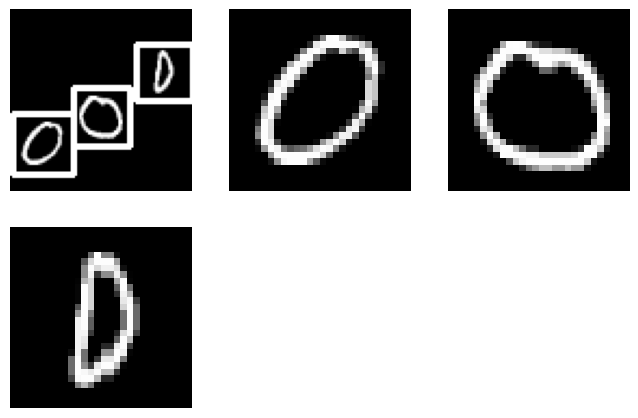

192000
60000
48000
(192000, 28, 28)
(60000, 28, 28)
(48000, 28, 28)
(192000,)
(60000,)
(48000,)
10
10
10


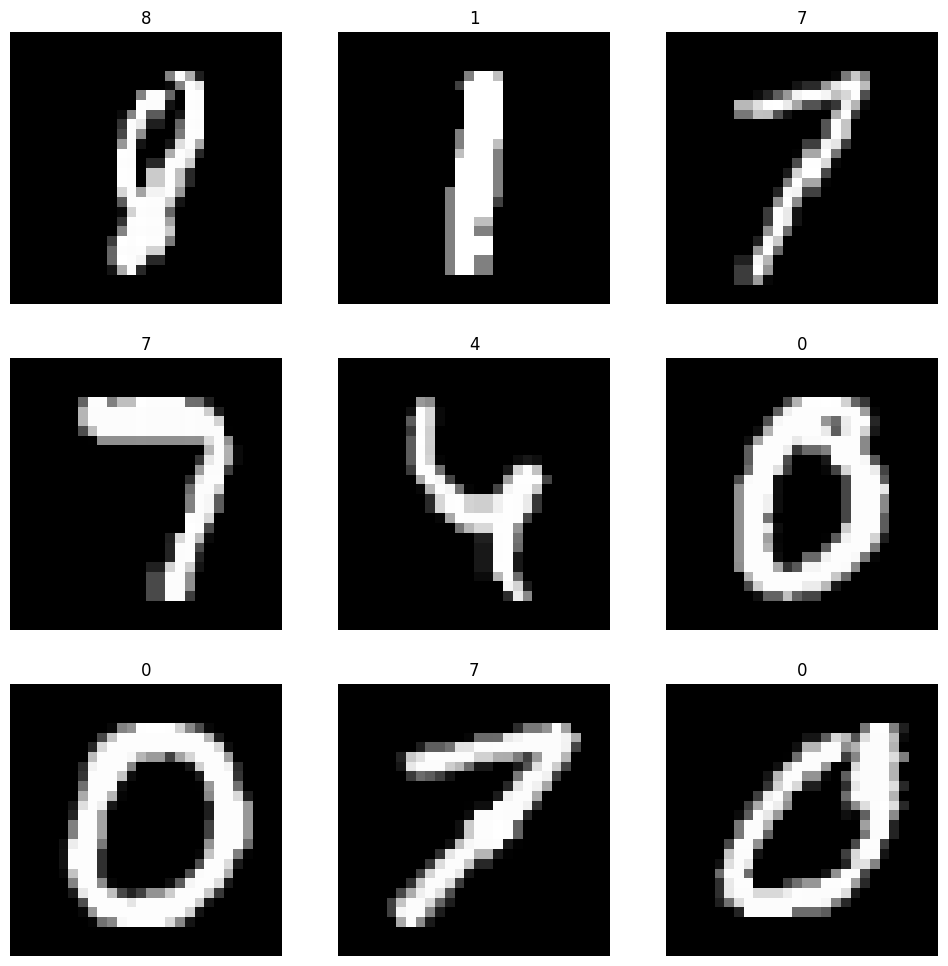

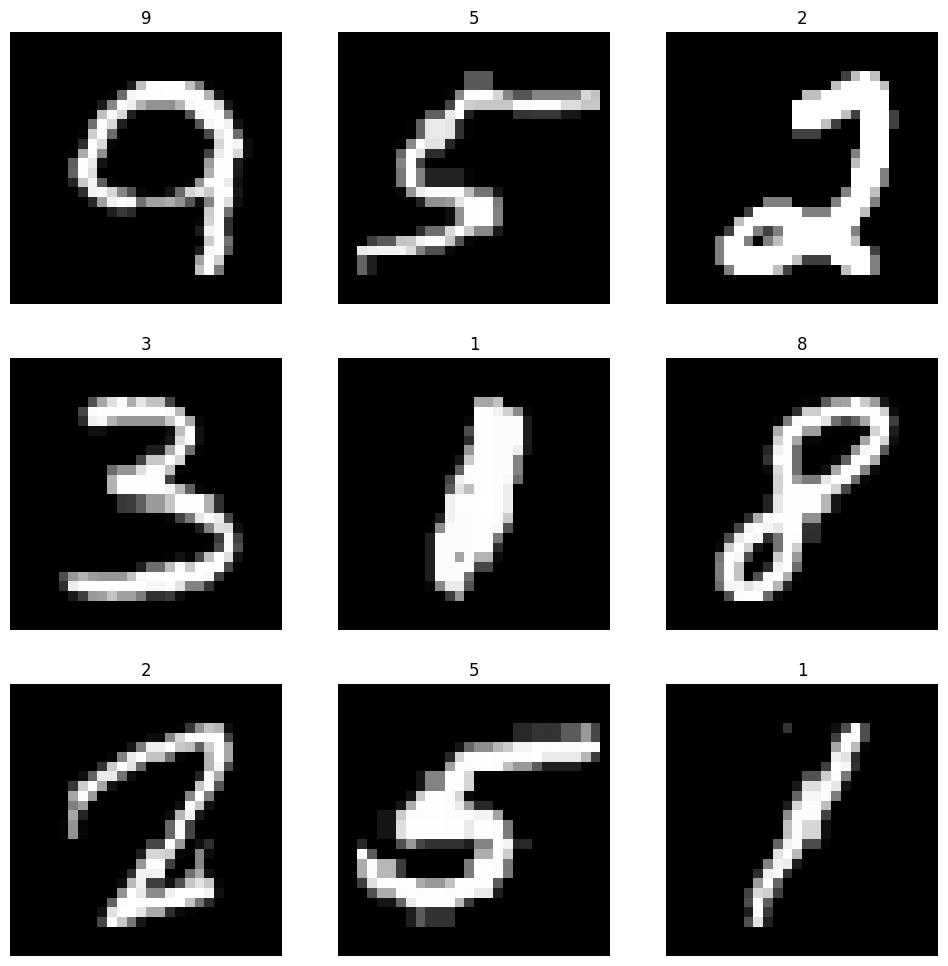

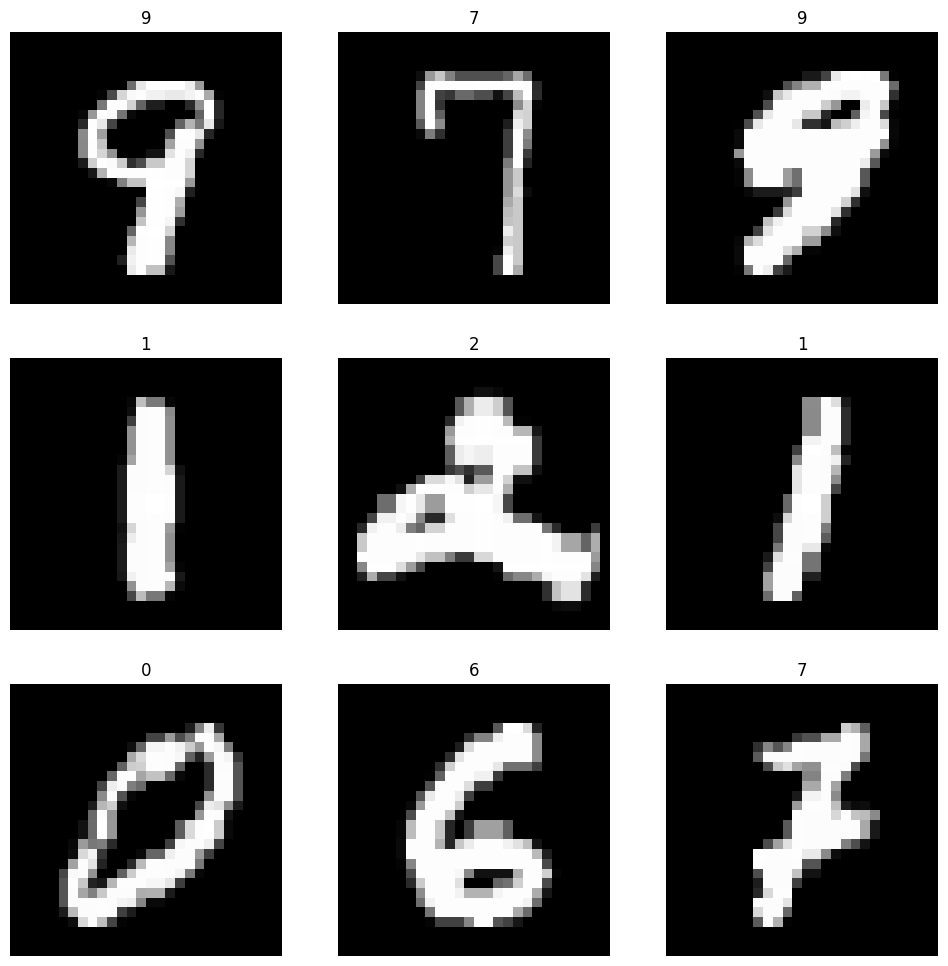

Training data shape: (192000, 28, 28, 1) (192000,)
Validation data shape: (48000, 28, 28, 1) (48000,)
Test data shape: (60000, 28, 28, 1) (60000,)


/usr/local/lib/python3.10/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d_5 (Conv2D)                    │ (None, 26, 26, 32)          │             320 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_2                │ (None, 26, 26, 32)          │             128 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_5 (MaxPooling2D)       │ (None, 13, 13, 32)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_6 (Conv2D)                    │ (None, 11, 11, 64)          │          18,496 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_3                │ (None, 11, 11, 64)          │             256 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_6 (MaxPooling2D)       │ (None, 5, 5, 64)            │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_7 (Conv2D)                    │ (None, 3, 3, 128)           │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_4                │ (None, 3, 3, 128)           │             512 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_7 (MaxPooling2D)       │ (None, 1, 1, 128)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_2 (Flatten)                  │ (None, 128)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 128)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 10)                  │           1,290 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 94,858 (370.54 KB)

 Trainable params: 94,410 (368.79 KB)

 Non-trainable params: 448 (1.75 KB)

6000/6000 ━━━━━━━━━━━━━━━━━━━━ 28s 4ms/step - accuracy: 0.9232 - loss: 0.2690 - val_accuracy: 0.9770 - val_loss: 0.0853
Single Digits Train loss: 0.08063238114118576
Single Digits Train accuracy: 0.977302074432373
Single Digits Validation loss: 0.08534350246191025
Single Digits Validation accuracy: 0.9769583344459534
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 26s 4ms/step - accuracy: 0.9791 - loss: 0.0735 - val_accuracy: 0.9868 - val_loss: 0.0483
Single Digits Train loss: 0.03731279820203781
Single Digits Train accuracy: 0.9893489480018616
Single Digits Validation loss: 0.04825867339968681
Single Digits Validation accuracy: 0.9868333339691162
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 30s 4ms/step - accuracy: 0.9854 - loss: 0.0532 - val_accuracy: 0.9883 - val_loss: 0.0452
Single Digits Train loss: 0.03426790237426758
Single Digits Train accuracy: 0.9906614422798157
Single Digits Validation loss: 0.045241303741931915
Single Digits Validation accuracy: 0.9882708191871643
Epoch 1/3
6000/6000 ━━━━━━━━━━━━━━━━━━━━

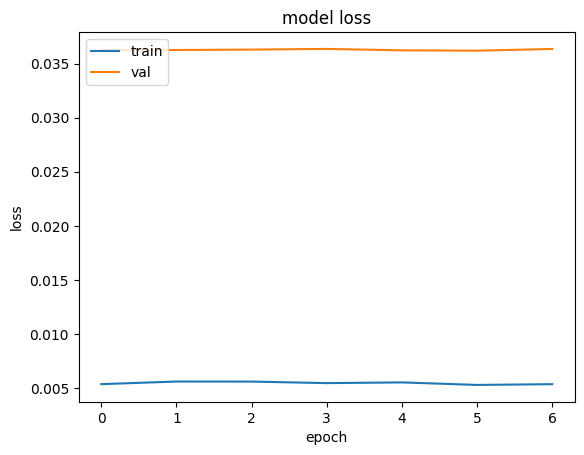

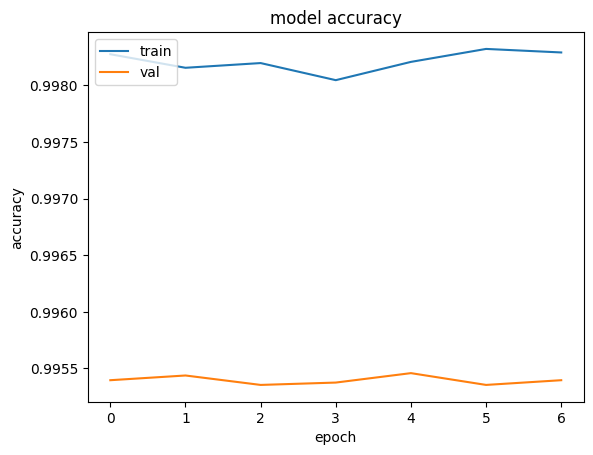

Single Digits Test loss: 0.025691812857985497
Single Digits Test accuracy: 0.9957500100135803
Classification Report:
              precision    recall  f1-score   support

         002       1.00      1.00      1.00       100
         003       1.00      0.99      0.99       100
         004       0.00      0.00      0.00         0
         008       1.00      1.00      1.00       100
         010       0.00      0.00      0.00         0
         014       1.00      1.00      1.00       100
         016       1.00      1.00      1.00       100
         017       1.00      1.00      1.00       100
         031       0.00      0.00      0.00         0
         035       0.00      0.00      0.00         0
         039       1.00      0.99      0.99       100
         041       0.00      0.00      0.00         0
         046       1.00      0.99      0.99       100
         047       1.00      0.99      0.99       100
         051       1.00      0.99      0.99       100
         055      

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


[[100   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0 

In [ ]:
#TASK-3 CNN with 3 distinct digits everythıng
import tensorflow as tf
import tensorflow.keras as keras
from tensorflow.keras import layers, models
from sklearn.metrics import classification_report, confusion_matrix
import cv2
##### SPLIT FUNCTION AND ITS DEMONSTRATION #####
digit_shape = (28, 28)
def crop_digits(img_path: str = None, im = None):
    #if im is None:
    #    im = cv2.imread(img_path)

    #gray = cv2.cvtColor(im, cv2.COLOR_BGR2GRAY)
    blur = cv2.GaussianBlur(img_path, (5, 5), 0)
    thresh = cv2.threshold(blur, 90, 255, cv2.THRESH_BINARY+cv2.THRESH_OTSU)[1]
    contours, hierarchy = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    digits = []
    rect = img_path.copy()
    for cnt in contours:
        x, y, w, h = cv2.boundingRect(cnt)

        x = max(x - 3, 0)
        y = max(y - 3, 0)
        w += 6
        h += 6

        del_x = int(w / 2)
        del_y = int(h / 2)
        center_x = x + del_x
        center_y = y + del_y

        lu_corner = (max(center_x - del_y, 0), y)
        rd_corner = (max(center_x + del_y, 0), y + h)

        rect = cv2.rectangle(rect, lu_corner, rd_corner, (255, 0, 0), 2) #rectangle

        cropped = img_path[lu_corner[1]:rd_corner[1], lu_corner[0]:rd_corner[0]]
        digits.append(cropped)

    def filter_and_sort_digits(digits, contours):
        sizes = []
        for digit in digits:
            size = digit.shape[0] * digit.shape[1]
            sizes.append(size)
        avg_size = sum(sizes) / len(sizes)
        deviations = [abs(size - avg_size) for size in sizes]

        indices = np.argsort(deviations)[0:3]
        digits = [digits[i] for i in indices]
        contours = [cv2.boundingRect(contours[i]) for i in indices]

        xs = [contour[0] for contour in contours]
        indices = np.argsort(xs) #get highest likelihood digit
        digits = [digits[i] for i in indices]

        while len(digits) < 3:
            digits.append(digits[0])
        return digits

    digits = filter_and_sort_digits(digits, contours) #get highest likelihood digits
    digits = [cv2.resize(digit, digit_shape, interpolation = cv2.INTER_NEAREST) for digit in digits] #resize to 28,28

    return digits, contours, rect

print(f"Label: {train_labels[0]}")
print(train_labels[0][0])
print(train_labels[0][1])
print(train_labels[0][2])

fig = plt.figure(figsize=(8, 8))
cols, rows = 3, 3

digits, contours, rect = crop_digits(train_images[0])

fig.add_subplot(rows, cols, 1)
plt.axis("off")
plt.imshow(rect.squeeze(), cmap="gray")
for i in range(len(digits)):
    img = digits[i]
    print(train_labels[0][i])
    fig.add_subplot(rows, cols, i+2)
    plt.axis("off")
    plt.imshow(img.squeeze(), cmap="gray")
    print(f"crop shape: {img.shape}")
plt.show()


##### SPLIT ALL DATA TO DIGITS #####
def load_digits(images, labels):
  all_digits = []
  all_labels = []
  for i in range(len(images)):
    digits, contours, rect = crop_digits(images[i])
    for j in range(len(digits)):
      all_digits.append(digits[j])
      all_labels.append(labels[i][j])
  return np.array(all_digits), np.array(all_labels)

train_images, train_labels = load_digits(train_images, train_labels)
test_images_digits, test_labels_digits = load_digits(test_images, test_labels)
val_images, val_labels = load_digits(val_images, val_labels)
print(len(train_images))
print(len(test_images_digits))
print(len(val_images))
print(train_images.shape)
print(test_images_digits.shape)
print(val_images.shape)
print(train_labels.shape)
print(test_labels_digits.shape)
print(val_labels.shape)

print(len(np.unique(train_labels)))
print(len(np.unique(test_labels_digits)))
print(len(np.unique(val_labels)))

def visualize(images, labels):
  np.random.seed(42)
  random_indices = np.random.choice(len(images), size=9, replace=False)
  random_images = images[random_indices]
  random_labels = labels[random_indices]

  fig, axes = plt.subplots(3, 3, figsize=(12, 12))
  for i, (img, label) in enumerate(zip(random_images, random_labels)):
      ax = axes[i // 3, i % 3]
      ax.imshow(img, cmap='gray')
      ax.set_title(label)
      ax.axis('off')
  plt.show()

visualize(train_images, train_labels)
visualize(test_images_digits, test_labels_digits)
visualize(val_images, val_labels)


##### TRAIN CNN #####
train_images = train_images / 255.0
val_images = val_images / 255.0
test_images_digits = test_images_digits / 255.0

train_images = train_images.reshape((train_images.shape[0], 28, 28, 1))
val_images = val_images.reshape((val_images.shape[0], 28, 28, 1))
test_images_digits = test_images_digits.reshape((test_images_digits.shape[0], 28, 28, 1))

print('Training data shape:', train_images.shape, train_labels.shape)
print('Validation data shape:', val_images.shape, val_labels.shape)
print('Test data shape:', test_images_digits.shape, test_labels_digits.shape)

train_labels = tf.keras.utils.to_categorical(train_labels, num_classes=10)
val_labels = tf.keras.utils.to_categorical(val_labels, num_classes=10)
test_labels_digits = tf.keras.utils.to_categorical(test_labels_digits, num_classes=10)

model = models.Sequential()
model.add(layers.Conv2D(32, (3, 3), activation='relu', input_shape=(28, 28, 1)))
model.add(layers.BatchNormalization()) #### FOR TASK 4
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Conv2D(64, (3, 3), activation='relu'))
model.add(layers.BatchNormalization()) #### FOR TASK 4
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Conv2D(128, (3, 3), activation='relu')) #### FOR TASK 4
model.add(layers.BatchNormalization()) #### FOR TASK 4
model.add(layers.MaxPooling2D((2, 2))) #### FOR TASK 4
model.add(layers.Flatten())
model.add(layers.Dropout(0.5)) #0.7 #### FOR TASK 4
model.add(layers.Dense(10, activation='softmax'))
model.summary()

# FOR TASK 4, NO HYPERPARAM SEARCH NEEDED!
param_grid_cnn = {
    'batch_size': [32, 64, 128],
    'epochs': [1, 3, 5, 7],
    'learning_rate': [1e-2, 1e-3, 1e-4],
    #'batch_size': [32],
    #'epochs': [7],
    #'learning_rate': [1e-2],
}

best_params_cnn = None
best_loss_cnn = 999
for batch_size in param_grid_cnn['batch_size']:
    for epochs in param_grid_cnn['epochs']:
        for learning_rate in param_grid_cnn['learning_rate']:
          model.compile(loss="categorical_crossentropy", optimizer=keras.optimizers.Adam(learning_rate=learning_rate), metrics=["accuracy"])

          history = model.fit(train_images, train_labels, batch_size=batch_size, epochs=epochs, validation_data=(val_images, val_labels))

          score_train = model.evaluate(train_images, train_labels, verbose=0)
          print("Single Digits Train loss:", score_train[0])
          print("Single Digits Train accuracy:", score_train[1])
          score_val = model.evaluate(val_images, val_labels, verbose=0)
          print("Single Digits Validation loss:", score_val[0])
          print("Single Digits Validation accuracy:", score_val[1])
          if score_val[0] < best_loss_cnn:
                  best_loss_cnn = score_val[0]
                  best_params_cnn = {'batch_size': batch_size, 'epochs': epochs, 'learning_rate':learning_rate}

print("Single Digits Best Hyperparameters (CNN):", best_params_cnn)
print("Single Digits Best Loss Score (CNN):", best_loss_cnn)

plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

score = model.evaluate(test_images_digits, test_labels_digits, verbose=0)
print("Single Digits Test loss:", score[0])
print("Single Digits Test accuracy:", score[1])

final_test_predictions = []
for i in range(len(test_images)):
  img = test_images[i]
  concat = ""
  for j in range(0,3):
    img_digit = test_images_digits[3*i + j]
    #prediction = model.predict_on_batch([img_digit])
    prediction = model.predict_on_batch(np.expand_dims(img_digit, axis=0))
    prediction = np.argmax(prediction)
    #print(prediction, test_labels[i])
    concat = concat + str(prediction)
  #print(concat, test_labels[i])
  final_test_predictions.append(concat)

np.set_printoptions(precision = 6, suppress= 1,threshold=np.inf)

print("Classification Report:")
print(classification_report(test_labels, final_test_predictions))

print("\nConfusion Matrix:")
print(confusion_matrix(test_labels, final_test_predictions))



In [ ]:
import numpy as np
import matplotlib.pyplot as plt

test_images = np.load('/content/drive/MyDrive/npy_2/np_save_test_images_2.npy')
test_labels = np.load('/content/drive/MyDrive/npy_2/np_save_test_labels_2.npy')
val_images = np.load('/content/drive/MyDrive/npy_2/np_save_val_images_2.npy')
val_labels = np.load('/content/drive/MyDrive/npy_2/np_save_val_labels_2.npy')
train_images = np.load('/content/drive/MyDrive/npy_2/np_save_train_images_2.npy')
train_labels = np.load('/content/drive/MyDrive/npy_2/np_save_train_labels_2.npy')

In [ ]:
print(train_images.shape)
print(test_images.shape)
print(val_images.shape)
print(train_labels.shape)
print(test_labels.shape)
print(val_labels.shape)

(64000, 84, 84)
(20000, 84, 84)
(16000, 84, 84)
(64000,)
(20000,)
(16000,)


In [ ]:
print((np.unique(train_labels)))
print((np.unique(test_labels)))
print((np.unique(val_labels)))

['000' '004' '005' '006' '007' '009' '011' '013' '015' '018' '020' '021'
 '022' '023' '024' '026' '027' '028' '030' '031' '032' '033' '034' '035'
 '036' '037' '038' '040' '041' '042' '043' '045' '048' '049' '050' '052'
 '054' '055' '057' '059' '061' '062' '063' '064' '066' '070' '071' '072'
 '074' '075' '078' '079' '080' '082' '084' '085' '089' '090' '091' '093'
 '094' '095' '097' '100' '101' '102' '103' '104' '105' '107' '110' '114'
 '115' '116' '117' '118' '119' '120' '121' '122' '124' '125' '127' '128'
 '131' '132' '134' '138' '142' '145' '147' '148' '150' '151' '153' '155'
 '156' '157' '159' '160' '161' '162' '163' '164' '165' '166' '167' '169'
 '170' '171' '172' '174' '175' '177' '178' '179' '181' '182' '183' '184'
 '185' '188' '189' '190' '191' '192' '195' '196' '199' '200' '201' '202'
 '203' '204' '205' '209' '210' '211' '212' '216' '217' '219' '221' '223'
 '226' '227' '228' '229' '230' '231' '232' '233' '234' '235' '236' '237'
 '239' '240' '241' '242' '243' '245' '246' '248' '2

Label: 000
0
0
0
0
crop shape: (28, 28)
0
crop shape: (28, 28)
0
crop shape: (28, 28)


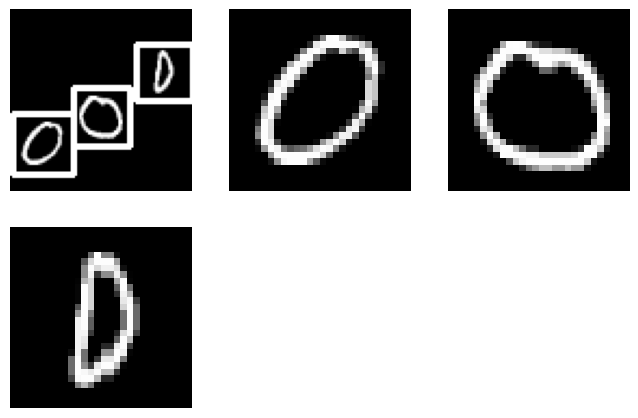

192000
60000
48000
(192000, 28, 28)
(60000, 28, 28)
(48000, 28, 28)
(192000,)
(60000,)
(48000,)
10
10
10


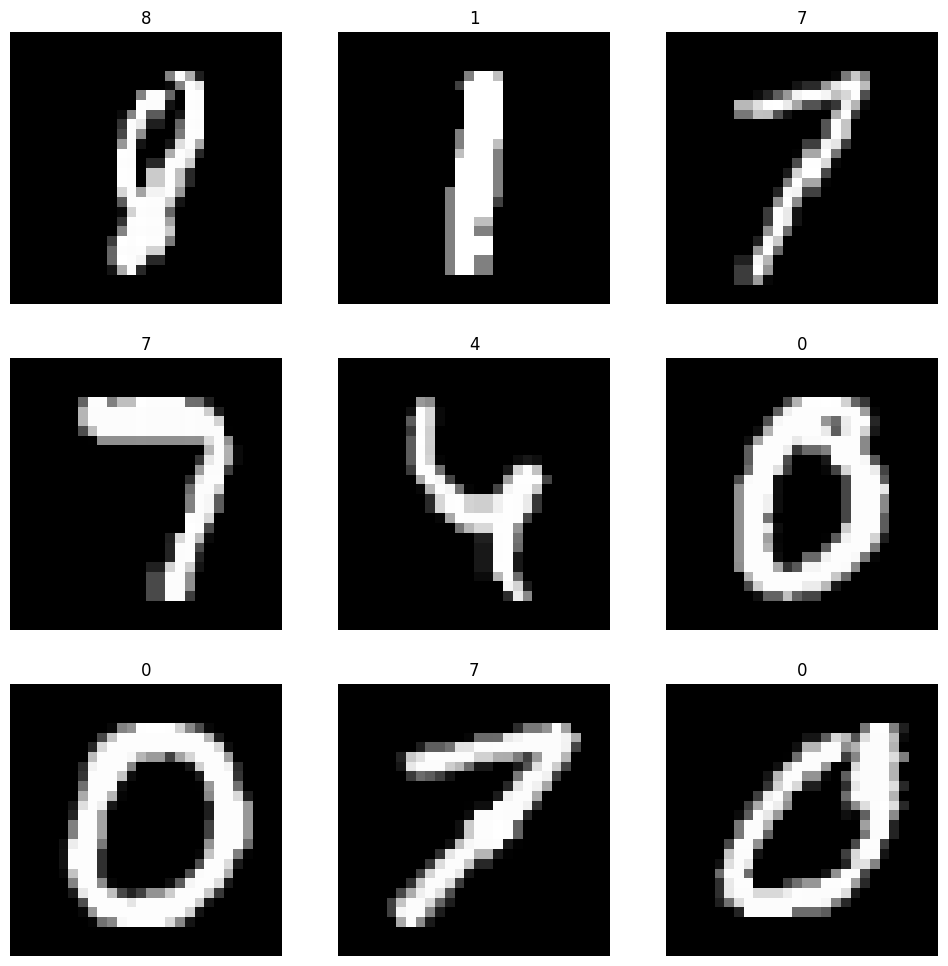

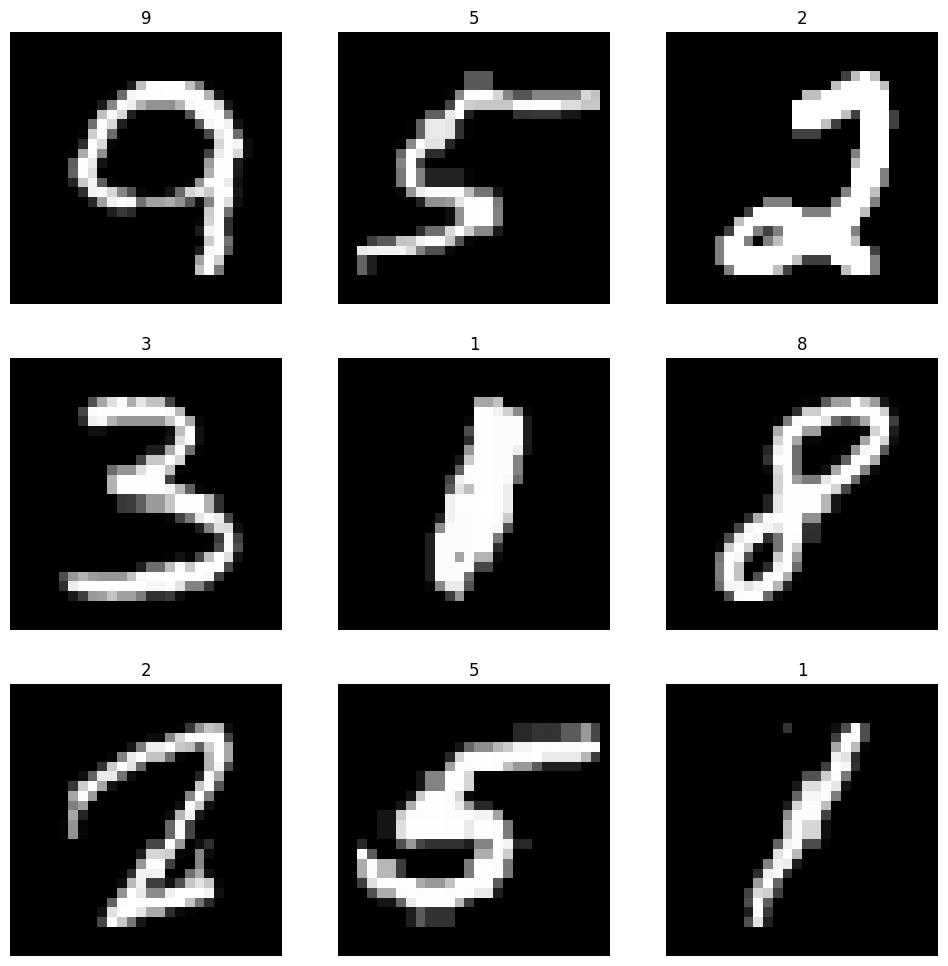

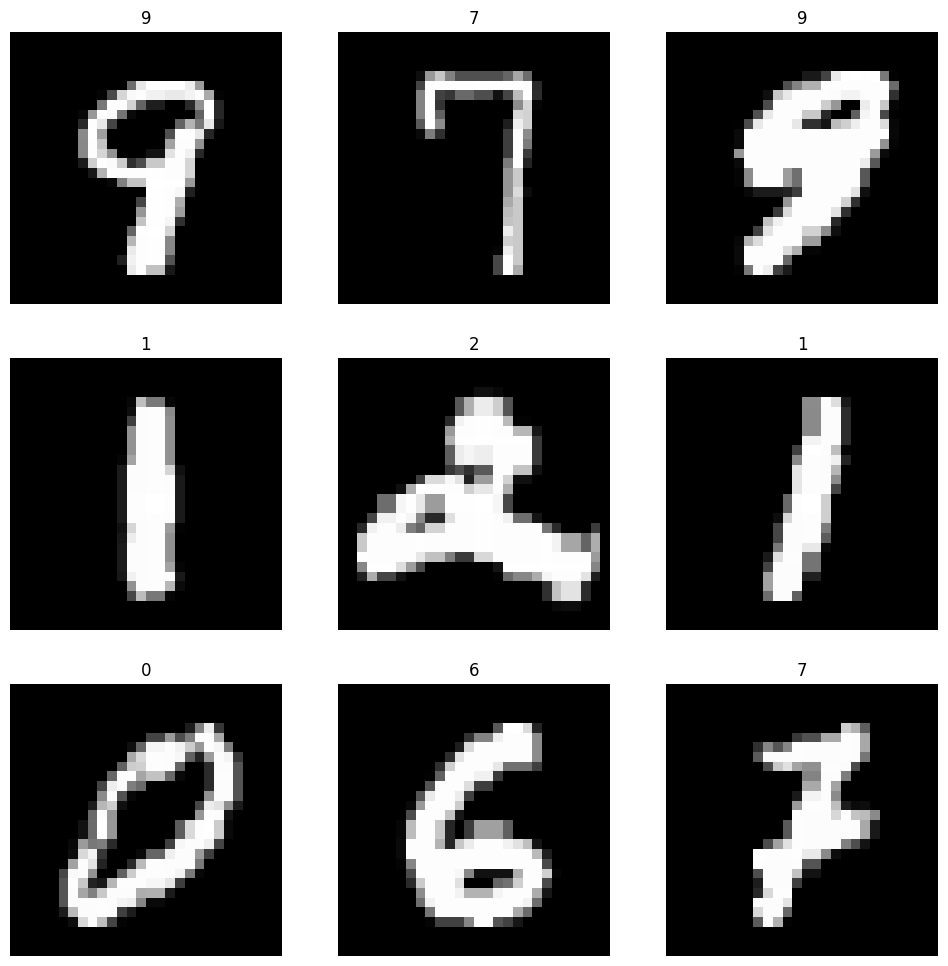

Training data shape: (192000, 28, 28, 1) (192000,)
Validation data shape: (48000, 28, 28, 1) (48000,)
Test data shape: (60000, 28, 28, 1) (60000,)


/usr/local/lib/python3.10/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                      │ (None, 28, 28, 32)          │             320 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization                  │ (None, 28, 28, 32)          │             128 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_1 (Conv2D)                    │ (None, 26, 26, 32)          │           9,248 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_1                │ (None, 26, 26, 32)          │             128 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_2 (Conv2D)                    │ (None, 13, 13, 32)          │          25,632 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d (MaxPooling2D)         │ (None, 6, 6, 32)            │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_2                │ (None, 6, 6, 32)            │             128 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 6, 6, 32)            │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_3 (Conv2D)                    │ (None, 3, 3, 64)            │          18,496 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_1 (MaxPooling2D)       │ (None, 1, 1, 64)            │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_3                │ (None, 1, 1, 64)            │             256 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_4 (Conv2D)                    │ (None, 1, 1, 64)            │          36,928 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_1 (Dropout)                  │ (None, 1, 1, 64)            │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 64)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 128)                 │           8,320 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_2 (Dropout)                  │ (None, 128)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 10)                  │           1,290 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 100,874 (394.04 KB)

 Trainable params: 100,554 (392.79 KB)

 Non-trainable params: 320 (1.25 KB)

6000/6000 ━━━━━━━━━━━━━━━━━━━━ 40s 5ms/step - accuracy: 0.8841 - loss: 0.4131 - val_accuracy: 0.9726 - val_loss: 0.1345
Single Digits Train loss: 0.13413402438163757
Single Digits Train accuracy: 0.9710989594459534
Single Digits Validation loss: 0.1344604343175888
Single Digits Validation accuracy: 0.9725833535194397
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 39s 5ms/step - accuracy: 0.9635 - loss: 0.1564 - val_accuracy: 0.9854 - val_loss: 0.0575
Single Digits Train loss: 0.05233662575483322
Single Digits Train accuracy: 0.9858177304267883
Single Digits Validation loss: 0.057461999356746674
Single Digits Validation accuracy: 0.9854375123977661
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 38s 5ms/step - accuracy: 0.9743 - loss: 0.1048 - val_accuracy: 0.9860 - val_loss: 0.0554
Single Digits Train loss: 0.0493025965988636
Single Digits Train accuracy: 0.9864687323570251
Single Digits Validation loss: 0.05535869672894478
Single Digits Validation accuracy: 0.9859583377838135
Epoch 1/3
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 

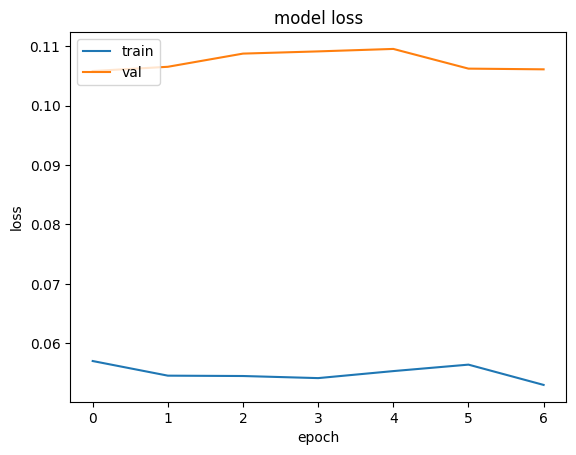

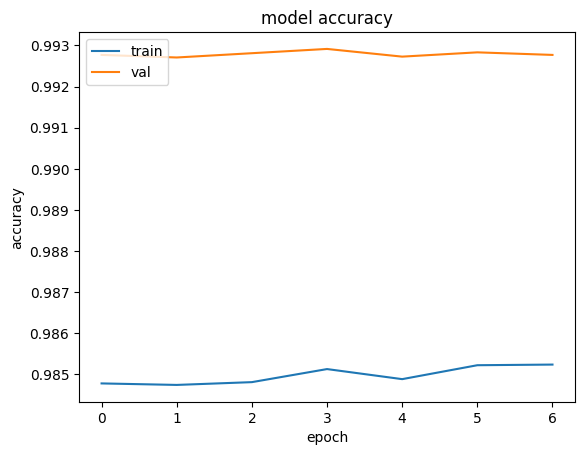

Single Digits Test loss: 0.05418854579329491
Single Digits Test accuracy: 0.9933833479881287
Classification Report:
              precision    recall  f1-score   support

         002       1.00      1.00      1.00       100
         003       1.00      0.99      0.99       100
         004       0.00      0.00      0.00         0
         006       0.00      0.00      0.00         0
         008       1.00      1.00      1.00       100
         014       1.00      1.00      1.00       100
         016       1.00      0.99      0.99       100
         017       1.00      1.00      1.00       100
         021       0.00      0.00      0.00         0
         022       0.00      0.00      0.00         0
         023       0.00      0.00      0.00         0
         025       0.00      0.00      0.00         0
         026       0.00      0.00      0.00         0
         027       0.00      0.00      0.00         0
         028       0.00      0.00      0.00         0
         029       

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


[[100   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0 

In [ ]:
#TASK-3 CNN with 3 distinct digits everythıng 2
import tensorflow as tf
import tensorflow.keras as keras
from tensorflow.keras import layers, models
from sklearn.metrics import classification_report, confusion_matrix
import cv2
##### SPLIT FUNCTION AND ITS DEMONSTRATION #####
digit_shape = (28, 28)
def crop_digits(img_path: str = None, im = None):
    #if im is None:
    #    im = cv2.imread(img_path)

    #gray = cv2.cvtColor(im, cv2.COLOR_BGR2GRAY)
    blur = cv2.GaussianBlur(img_path, (5, 5), 0)
    thresh = cv2.threshold(blur, 90, 255, cv2.THRESH_BINARY+cv2.THRESH_OTSU)[1]
    contours, hierarchy = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    digits = []
    rect = img_path.copy()
    for cnt in contours:
        x, y, w, h = cv2.boundingRect(cnt)

        x = max(x - 3, 0)
        y = max(y - 3, 0)
        w += 6
        h += 6

        del_x = int(w / 2)
        del_y = int(h / 2)
        center_x = x + del_x
        center_y = y + del_y

        lu_corner = (max(center_x - del_y, 0), y)
        rd_corner = (max(center_x + del_y, 0), y + h)

        rect = cv2.rectangle(rect, lu_corner, rd_corner, (255, 0, 0), 2) #rectangle

        cropped = img_path[lu_corner[1]:rd_corner[1], lu_corner[0]:rd_corner[0]]
        digits.append(cropped)

    def filter_and_sort_digits(digits, contours):
        sizes = []
        for digit in digits:
            size = digit.shape[0] * digit.shape[1]
            sizes.append(size)
        avg_size = sum(sizes) / len(sizes)
        deviations = [abs(size - avg_size) for size in sizes]

        indices = np.argsort(deviations)[0:3]
        digits = [digits[i] for i in indices]
        contours = [cv2.boundingRect(contours[i]) for i in indices]

        xs = [contour[0] for contour in contours]
        indices = np.argsort(xs) #get highest likelihood digit
        digits = [digits[i] for i in indices]

        while len(digits) < 3:
            digits.append(digits[0])
        return digits

    digits = filter_and_sort_digits(digits, contours) #get highest likelihood digits
    digits = [cv2.resize(digit, digit_shape, interpolation = cv2.INTER_NEAREST) for digit in digits] #resize to 28,28

    return digits, contours, rect

print(f"Label: {train_labels[0]}")
print(train_labels[0][0])
print(train_labels[0][1])
print(train_labels[0][2])

fig = plt.figure(figsize=(8, 8))
cols, rows = 3, 3

digits, contours, rect = crop_digits(train_images[0])

fig.add_subplot(rows, cols, 1)
plt.axis("off")
plt.imshow(rect.squeeze(), cmap="gray")
for i in range(len(digits)):
    img = digits[i]
    print(train_labels[0][i])
    fig.add_subplot(rows, cols, i+2)
    plt.axis("off")
    plt.imshow(img.squeeze(), cmap="gray")
    print(f"crop shape: {img.shape}")
plt.show()


##### SPLIT ALL DATA TO DIGITS #####
def load_digits(images, labels):
  all_digits = []
  all_labels = []
  for i in range(len(images)):
    digits, contours, rect = crop_digits(images[i])
    for j in range(len(digits)):
      all_digits.append(digits[j])
      all_labels.append(labels[i][j])
  return np.array(all_digits), np.array(all_labels)

train_images, train_labels = load_digits(train_images, train_labels)
test_images_digits, test_labels_digits = load_digits(test_images, test_labels)
val_images, val_labels = load_digits(val_images, val_labels)
print(len(train_images))
print(len(test_images_digits))
print(len(val_images))
print(train_images.shape)
print(test_images_digits.shape)
print(val_images.shape)
print(train_labels.shape)
print(test_labels_digits.shape)
print(val_labels.shape)

print(len(np.unique(train_labels)))
print(len(np.unique(test_labels_digits)))
print(len(np.unique(val_labels)))

def visualize(images, labels):
  np.random.seed(42)
  random_indices = np.random.choice(len(images), size=9, replace=False)
  random_images = images[random_indices]
  random_labels = labels[random_indices]

  fig, axes = plt.subplots(3, 3, figsize=(12, 12))
  for i, (img, label) in enumerate(zip(random_images, random_labels)):
      ax = axes[i // 3, i % 3]
      ax.imshow(img, cmap='gray')
      ax.set_title(label)
      ax.axis('off')
  plt.show()

visualize(train_images, train_labels)
visualize(test_images_digits, test_labels_digits)
visualize(val_images, val_labels)


##### TRAIN CNN #####
train_images = train_images / 255.0
val_images = val_images / 255.0
test_images_digits = test_images_digits / 255.0

train_images = train_images.reshape((train_images.shape[0], 28, 28, 1))
val_images = val_images.reshape((val_images.shape[0], 28, 28, 1))
test_images_digits = test_images_digits.reshape((test_images_digits.shape[0], 28, 28, 1))

print('Training data shape:', train_images.shape, train_labels.shape)
print('Validation data shape:', val_images.shape, val_labels.shape)
print('Test data shape:', test_images_digits.shape, test_labels_digits.shape)

train_labels = tf.keras.utils.to_categorical(train_labels, num_classes=10)
val_labels = tf.keras.utils.to_categorical(val_labels, num_classes=10)
test_labels_digits = tf.keras.utils.to_categorical(test_labels_digits, num_classes=10)

# Model
model = models.Sequential()
# Add convolution 2D
model.add(layers.Conv2D(32, kernel_size=(3, 3),activation='relu', padding="same", kernel_initializer='he_normal',input_shape=(28, 28, 1)))
model.add(layers.BatchNormalization())
model.add(layers.Conv2D(32,kernel_size=(3, 3), activation='relu'))
model.add(layers.BatchNormalization())
model.add(layers.Conv2D(32,kernel_size=5,strides=2,padding='same',activation='relu'))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.BatchNormalization())
# Add dropouts to the model
model.add(layers.Dropout(0.4))
model.add(layers.Conv2D(64, kernel_size=(3, 3), strides=2,padding='same', activation='relu'))
model.add(layers.MaxPooling2D(pool_size=(2, 2)))
model.add(layers.BatchNormalization())
model.add(layers.Conv2D(64, kernel_size=(3, 3), strides=2,padding='same', activation='relu'))
# Add dropouts to the model
model.add(layers.Dropout(0.4))
model.add(layers.Flatten())
model.add(layers.Dense(128, activation='relu'))
# Add dropouts to the model
model.add(layers.Dropout(0.4))
model.add(layers.Dense(10, activation='softmax'))
model.summary()

# FOR TASK 4, NO HYPERPARAM SEARCH NEEDED!
param_grid_cnn = {
    'batch_size': [32, 64, 128],
    'epochs': [1, 3, 5, 7],
    'learning_rate': [1e-2, 1e-3, 1e-4],
    #'batch_size': [32],
    #'epochs': [7],
    #'learning_rate': [1e-2],
}

best_params_cnn = None
best_loss_cnn = 999
for batch_size in param_grid_cnn['batch_size']:
    for epochs in param_grid_cnn['epochs']:
        for learning_rate in param_grid_cnn['learning_rate']:
          model.compile(loss="categorical_crossentropy", optimizer=keras.optimizers.Adam(learning_rate=learning_rate), metrics=["accuracy"])

          history = model.fit(train_images, train_labels, batch_size=batch_size, epochs=epochs, validation_data=(val_images, val_labels))

          score_train = model.evaluate(train_images, train_labels, verbose=0)
          print("Single Digits Train loss:", score_train[0])
          print("Single Digits Train accuracy:", score_train[1])
          score_val = model.evaluate(val_images, val_labels, verbose=0)
          print("Single Digits Validation loss:", score_val[0])
          print("Single Digits Validation accuracy:", score_val[1])
          if score_val[0] < best_loss_cnn:
                  best_loss_cnn = score_val[0]
                  best_params_cnn = {'batch_size': batch_size, 'epochs': epochs, 'learning_rate':learning_rate}

print("Single Digits Best Hyperparameters (CNN):", best_params_cnn)
print("Single Digits Best Loss Score (CNN):", best_loss_cnn)

plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

score = model.evaluate(test_images_digits, test_labels_digits, verbose=0)
print("Single Digits Test loss:", score[0])
print("Single Digits Test accuracy:", score[1])

final_test_predictions = []
for i in range(len(test_images)):
  img = test_images[i]
  concat = ""
  for j in range(0,3):
    img_digit = test_images_digits[3*i + j]
    #prediction = model.predict_on_batch([img_digit])
    prediction = model.predict_on_batch(np.expand_dims(img_digit, axis=0))
    prediction = np.argmax(prediction)
    #print(prediction, test_labels[i])
    concat = concat + str(prediction)
  #print(concat, test_labels[i])
  final_test_predictions.append(concat)

np.set_printoptions(threshold=np.inf)

print("Classification Report:")
print(classification_report(test_labels, final_test_predictions))

print("\nConfusion Matrix:")
print(confusion_matrix(test_labels, final_test_predictions))



Label: 000
0
0
0
0
crop shape: (28, 28)
0
crop shape: (28, 28)
0
crop shape: (28, 28)


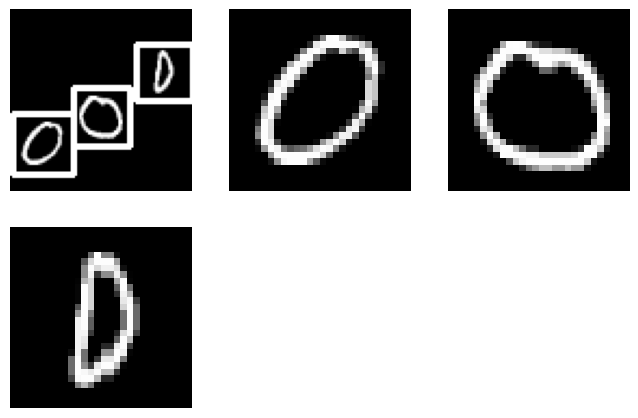

192000
60000
48000
(192000, 28, 28)
(60000, 28, 28)
(48000, 28, 28)
(192000,)
(60000,)
(48000,)
10
10
10


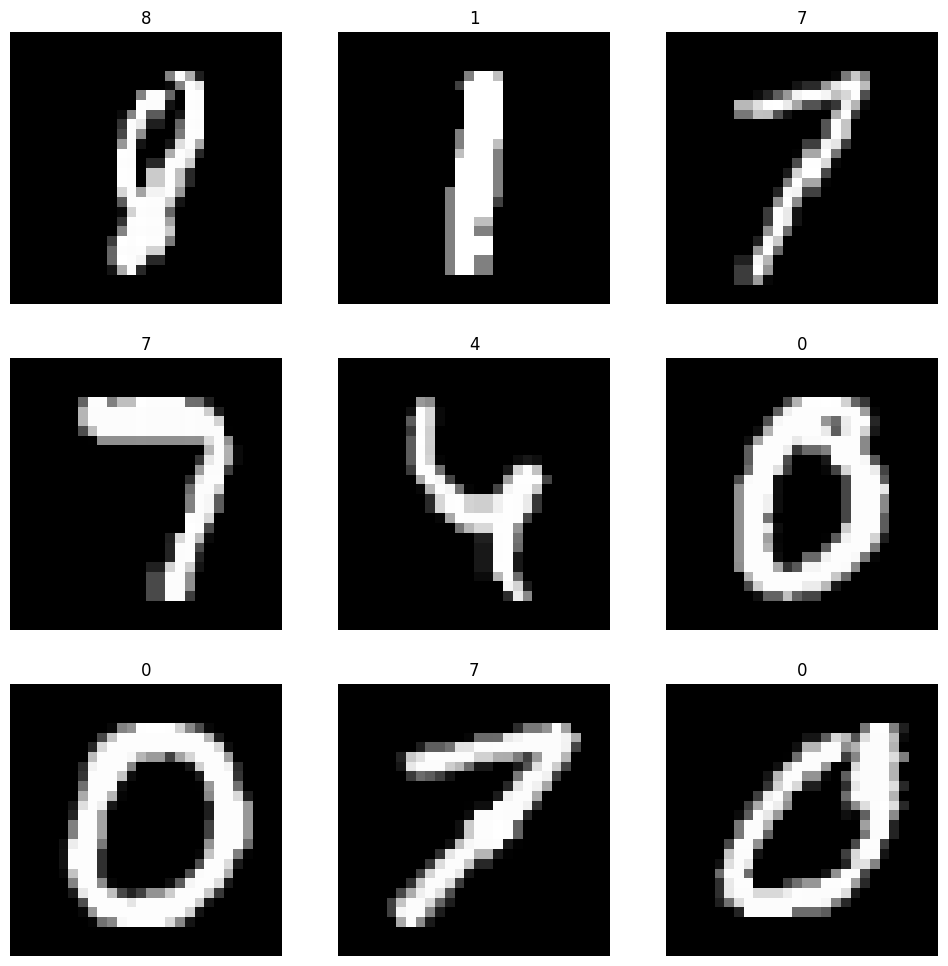

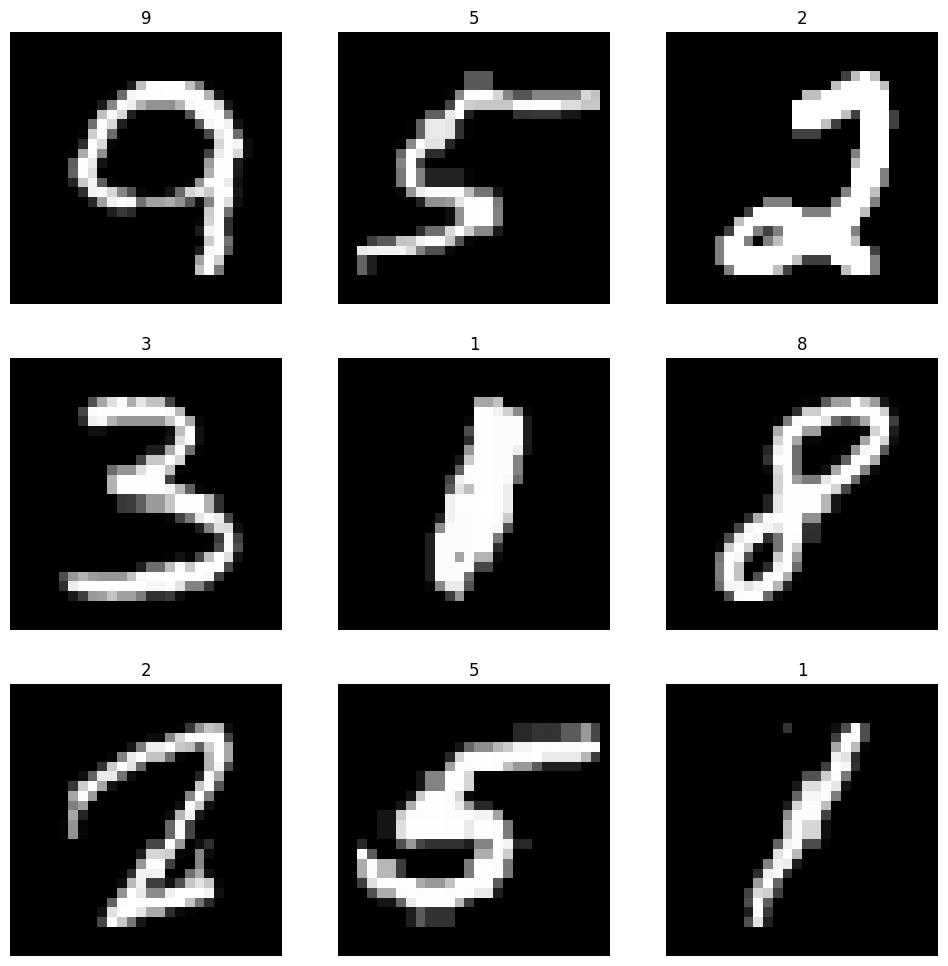

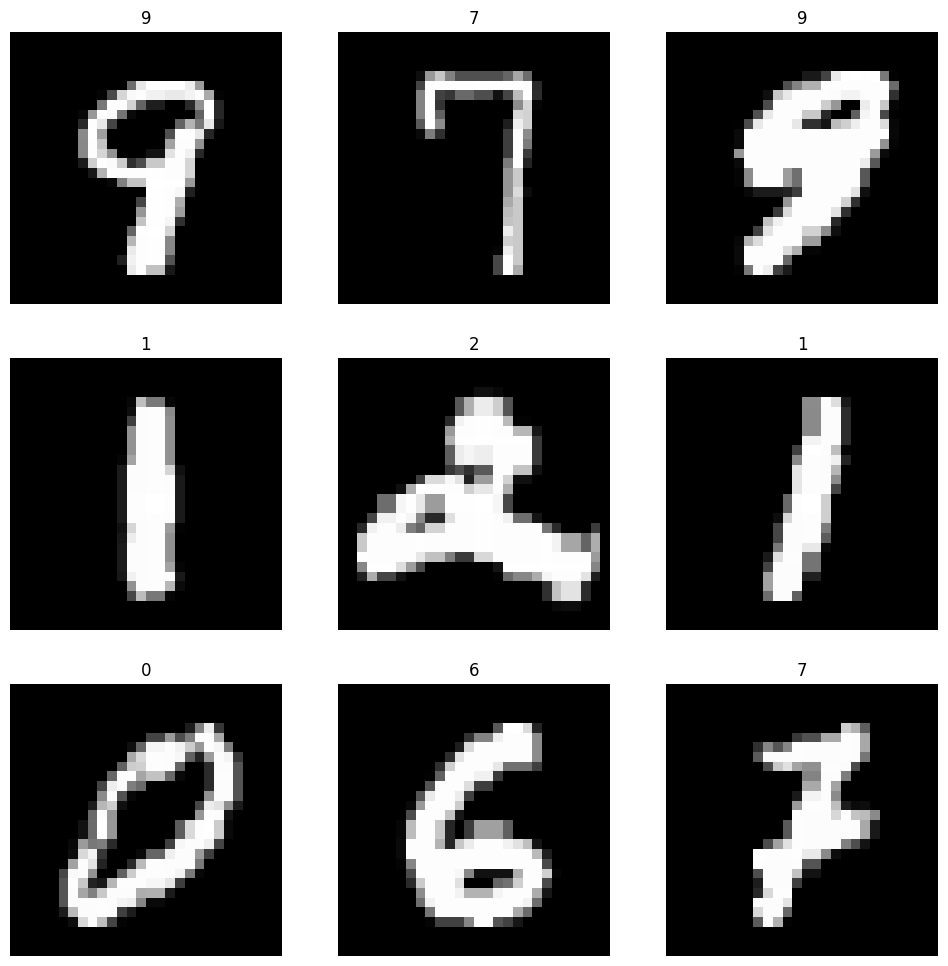

Training data shape: (192000, 28, 28, 1) (192000,)
Validation data shape: (48000, 28, 28, 1) (48000,)
Test data shape: (60000, 28, 28, 1) (60000,)


/usr/local/lib/python3.10/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d_5 (Conv2D)                    │ (None, 28, 28, 32)          │             320 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_4                │ (None, 28, 28, 32)          │             128 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_6 (Conv2D)                    │ (None, 26, 26, 32)          │           9,248 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_5                │ (None, 26, 26, 32)          │             128 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_7 (Conv2D)                    │ (None, 13, 13, 32)          │          25,632 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_2 (MaxPooling2D)       │ (None, 6, 6, 32)            │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_6                │ (None, 6, 6, 32)            │             128 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_3 (Dropout)                  │ (None, 6, 6, 32)            │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_8 (Conv2D)                    │ (None, 3, 3, 64)            │          18,496 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_3 (MaxPooling2D)       │ (None, 1, 1, 64)            │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_7                │ (None, 1, 1, 64)            │             256 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_9 (Conv2D)                    │ (None, 1, 1, 64)            │          36,928 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_4 (Dropout)                  │ (None, 1, 1, 64)            │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_1 (Flatten)                  │ (None, 64)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 128)                 │           8,320 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_5 (Dropout)                  │ (None, 128)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 10)                  │           1,290 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 100,874 (394.04 KB)

 Trainable params: 100,554 (392.79 KB)

 Non-trainable params: 320 (1.25 KB)

Epoch 1/3
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 35s 5ms/step - accuracy: 0.6354 - loss: 1.0886 - val_accuracy: 0.9755 - val_loss: 0.0882
Epoch 2/3
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 34s 4ms/step - accuracy: 0.9491 - loss: 0.1847 - val_accuracy: 0.9818 - val_loss: 0.0641
Epoch 3/3
6000/6000 ━━━━━━━━━━━━━━━━━━━━ 25s 4ms/step - accuracy: 0.9636 - loss: 0.1345 - val_accuracy: 0.9857 - val_loss: 0.0529
Single Digits Train loss: 0.046715814620256424
Single Digits Train accuracy: 0.9867916703224182
Single Digits Validation loss: 0.052921030670404434
Single Digits Validation accuracy: 0.9857291579246521
Single Digits Best Hyperparameters (CNN): {'batch_size': 32, 'epochs': 3, 'learning_rate': 0.0001}
Single Digits Best Loss Score (CNN): 0.052921030670404434


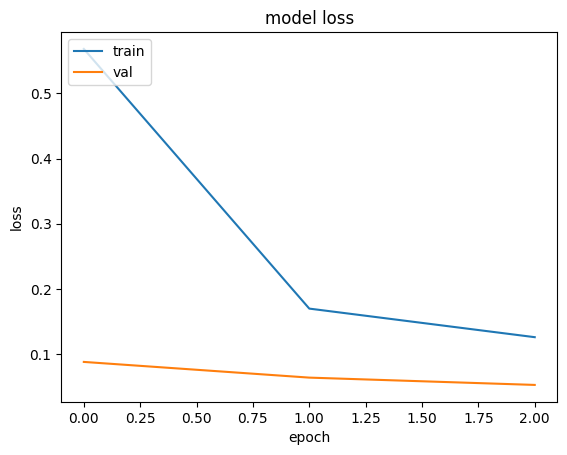

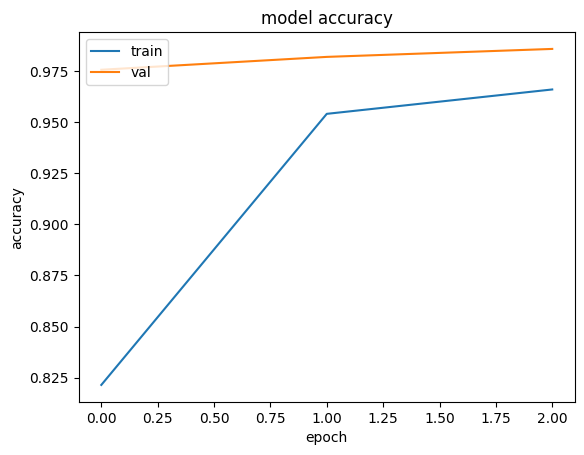

Single Digits Test loss: 0.04956663399934769
Single Digits Test accuracy: 0.986133337020874
Classification Report:
              precision    recall  f1-score   support

         002     1.0000    0.9800    0.9899       100
         003     0.9898    0.9700    0.9798       100
         004     0.0000    0.0000    0.0000         0
         005     0.0000    0.0000    0.0000         0
         006     0.0000    0.0000    0.0000         0
         007     0.0000    0.0000    0.0000         0
         008     0.9900    0.9900    0.9900       100
         009     0.0000    0.0000    0.0000         0
         011     0.0000    0.0000    0.0000         0
         012     0.0000    0.0000    0.0000         0
         014     1.0000    0.9800    0.9899       100
         015     0.0000    0.0000    0.0000         0
         016     1.0000    0.9900    0.9950       100
         017     0.9703    0.9800    0.9751       100
         019     0.0000    0.0000    0.0000         0
         026     0.0

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


[[ 98   1   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0 

In [ ]:
#TASK-3 CNN with 3 distinct digits everythıng 3
import tensorflow as tf
import tensorflow.keras as keras
from tensorflow.keras import layers, models
from sklearn.metrics import classification_report, confusion_matrix
import cv2
##### SPLIT FUNCTION AND ITS DEMONSTRATION #####
digit_shape = (28, 28)
def crop_digits(img_path: str = None, im = None):
    #if im is None:
    #    im = cv2.imread(img_path)

    #gray = cv2.cvtColor(im, cv2.COLOR_BGR2GRAY)
    blur = cv2.GaussianBlur(img_path, (5, 5), 0)
    thresh = cv2.threshold(blur, 90, 255, cv2.THRESH_BINARY+cv2.THRESH_OTSU)[1]
    contours, hierarchy = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    digits = []
    rect = img_path.copy()
    for cnt in contours:
        x, y, w, h = cv2.boundingRect(cnt)

        x = max(x - 3, 0)
        y = max(y - 3, 0)
        w += 6
        h += 6

        del_x = int(w / 2)
        del_y = int(h / 2)
        center_x = x + del_x
        center_y = y + del_y

        lu_corner = (max(center_x - del_y, 0), y)
        rd_corner = (max(center_x + del_y, 0), y + h)

        rect = cv2.rectangle(rect, lu_corner, rd_corner, (255, 0, 0), 2) #rectangle

        cropped = img_path[lu_corner[1]:rd_corner[1], lu_corner[0]:rd_corner[0]]
        digits.append(cropped)

    def filter_and_sort_digits(digits, contours):
        sizes = []
        for digit in digits:
            size = digit.shape[0] * digit.shape[1]
            sizes.append(size)
        avg_size = sum(sizes) / len(sizes)
        deviations = [abs(size - avg_size) for size in sizes]

        indices = np.argsort(deviations)[0:3]
        digits = [digits[i] for i in indices]
        contours = [cv2.boundingRect(contours[i]) for i in indices]

        xs = [contour[0] for contour in contours]
        indices = np.argsort(xs) #get highest likelihood digit
        digits = [digits[i] for i in indices]

        while len(digits) < 3:
            digits.append(digits[0])
        return digits

    digits = filter_and_sort_digits(digits, contours) #get highest likelihood digits
    digits = [cv2.resize(digit, digit_shape, interpolation = cv2.INTER_NEAREST) for digit in digits] #resize to 28,28

    return digits, contours, rect

print(f"Label: {train_labels[0]}")
print(train_labels[0][0])
print(train_labels[0][1])
print(train_labels[0][2])

fig = plt.figure(figsize=(8, 8))
cols, rows = 3, 3

digits, contours, rect = crop_digits(train_images[0])

fig.add_subplot(rows, cols, 1)
plt.axis("off")
plt.imshow(rect.squeeze(), cmap="gray")
for i in range(len(digits)):
    img = digits[i]
    print(train_labels[0][i])
    fig.add_subplot(rows, cols, i+2)
    plt.axis("off")
    plt.imshow(img.squeeze(), cmap="gray")
    print(f"crop shape: {img.shape}")
plt.show()


##### SPLIT ALL DATA TO DIGITS #####
def load_digits(images, labels):
  all_digits = []
  all_labels = []
  for i in range(len(images)):
    digits, contours, rect = crop_digits(images[i])
    for j in range(len(digits)):
      all_digits.append(digits[j])
      all_labels.append(labels[i][j])
  return np.array(all_digits), np.array(all_labels)

train_images, train_labels = load_digits(train_images, train_labels)
test_images_digits, test_labels_digits = load_digits(test_images, test_labels)
val_images, val_labels = load_digits(val_images, val_labels)
print(len(train_images))
print(len(test_images_digits))
print(len(val_images))
print(train_images.shape)
print(test_images_digits.shape)
print(val_images.shape)
print(train_labels.shape)
print(test_labels_digits.shape)
print(val_labels.shape)

print(len(np.unique(train_labels)))
print(len(np.unique(test_labels_digits)))
print(len(np.unique(val_labels)))

def visualize(images, labels):
  np.random.seed(42)
  random_indices = np.random.choice(len(images), size=9, replace=False)
  random_images = images[random_indices]
  random_labels = labels[random_indices]

  fig, axes = plt.subplots(3, 3, figsize=(12, 12))
  for i, (img, label) in enumerate(zip(random_images, random_labels)):
      ax = axes[i // 3, i % 3]
      ax.imshow(img, cmap='gray')
      ax.set_title(label)
      ax.axis('off')
  plt.show()

visualize(train_images, train_labels)
visualize(test_images_digits, test_labels_digits)
visualize(val_images, val_labels)


##### TRAIN CNN #####
train_images = train_images / 255.0
val_images = val_images / 255.0
test_images_digits = test_images_digits / 255.0

train_images = train_images.reshape((train_images.shape[0], 28, 28, 1))
val_images = val_images.reshape((val_images.shape[0], 28, 28, 1))
test_images_digits = test_images_digits.reshape((test_images_digits.shape[0], 28, 28, 1))

print('Training data shape:', train_images.shape, train_labels.shape)
print('Validation data shape:', val_images.shape, val_labels.shape)
print('Test data shape:', test_images_digits.shape, test_labels_digits.shape)

train_labels = tf.keras.utils.to_categorical(train_labels, num_classes=10)
val_labels = tf.keras.utils.to_categorical(val_labels, num_classes=10)
test_labels_digits = tf.keras.utils.to_categorical(test_labels_digits, num_classes=10)

# Model
model = models.Sequential()
# Add convolution 2D
model.add(layers.Conv2D(32, kernel_size=(3, 3),activation='relu', padding="same", kernel_initializer='he_normal',input_shape=(28, 28, 1)))
model.add(layers.BatchNormalization())
model.add(layers.Conv2D(32,kernel_size=(3, 3), activation='relu'))
model.add(layers.BatchNormalization())
model.add(layers.Conv2D(32,kernel_size=5,strides=2,padding='same',activation='relu'))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.BatchNormalization())
# Add dropouts to the model
model.add(layers.Dropout(0.4))
model.add(layers.Conv2D(64, kernel_size=(3, 3), strides=2,padding='same', activation='relu'))
model.add(layers.MaxPooling2D(pool_size=(2, 2)))
model.add(layers.BatchNormalization())
model.add(layers.Conv2D(64, kernel_size=(3, 3), strides=2,padding='same', activation='relu'))
# Add dropouts to the model
model.add(layers.Dropout(0.4))
model.add(layers.Flatten())
model.add(layers.Dense(128, activation='relu'))
# Add dropouts to the model
model.add(layers.Dropout(0.4))
model.add(layers.Dense(10, activation='softmax'))
model.summary()

# FOR TASK 4, NO HYPERPARAM SEARCH NEEDED!
param_grid_cnn = {
    #'batch_size': [32, 64, 128],
    #'epochs': [1, 3, 5, 7],
    #'learning_rate': [1e-2, 1e-3, 1e-4],
    'batch_size': [32],
    'epochs': [3],
    'learning_rate': [1e-4],
}

best_params_cnn = None
best_loss_cnn = 999
for batch_size in param_grid_cnn['batch_size']:
    for epochs in param_grid_cnn['epochs']:
        for learning_rate in param_grid_cnn['learning_rate']:
          model.compile(loss="categorical_crossentropy", optimizer=keras.optimizers.Adam(learning_rate=learning_rate), metrics=["accuracy"])

          history = model.fit(train_images, train_labels, batch_size=batch_size, epochs=epochs, validation_data=(val_images, val_labels))

          score_train = model.evaluate(train_images, train_labels, verbose=0)
          print("Single Digits Train loss:", score_train[0])
          print("Single Digits Train accuracy:", score_train[1])
          score_val = model.evaluate(val_images, val_labels, verbose=0)
          print("Single Digits Validation loss:", score_val[0])
          print("Single Digits Validation accuracy:", score_val[1])
          if score_val[0] < best_loss_cnn:
                  best_loss_cnn = score_val[0]
                  best_params_cnn = {'batch_size': batch_size, 'epochs': epochs, 'learning_rate':learning_rate}

print("Single Digits Best Hyperparameters (CNN):", best_params_cnn)
print("Single Digits Best Loss Score (CNN):", best_loss_cnn)

plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

score = model.evaluate(test_images_digits, test_labels_digits, verbose=0)
print("Single Digits Test loss:", score[0])
print("Single Digits Test accuracy:", score[1])

final_test_predictions = []
for i in range(len(test_images)):
  img = test_images[i]
  concat = ""
  for j in range(0,3):
    img_digit = test_images_digits[3*i + j]
    #prediction = model.predict_on_batch([img_digit])
    prediction = model.predict_on_batch(np.expand_dims(img_digit, axis=0))
    prediction = np.argmax(prediction)
    #print(prediction, test_labels[i])
    concat = concat + str(prediction)
  #print(concat, test_labels[i])
  final_test_predictions.append(concat)

np.set_printoptions(threshold=np.inf)

print("Classification Report:")
print(classification_report(test_labels, final_test_predictions, digits = 4))

print("\nConfusion Matrix:")
print(confusion_matrix(test_labels, final_test_predictions))



Label: 000
0
0
0
0
crop shape: (28, 28)
0
crop shape: (28, 28)
0
crop shape: (28, 28)


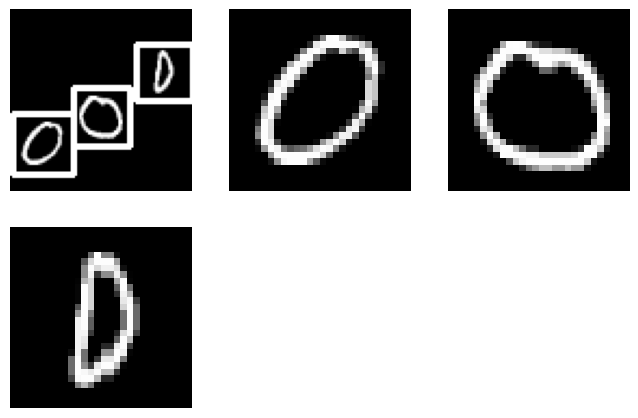

192000
60000
48000
(192000, 28, 28)
(60000, 28, 28)
(48000, 28, 28)
(192000,)
(60000,)
(48000,)
10
10
10
torch.Size([32, 28, 28]) torch.Size([32])
Starting epoch 0... Done!
Starting epoch 1... Done!
Starting epoch 2... Done!
Starting epoch 3... Done!
Starting epoch 4... Done!
Starting epoch 5... Done!
Starting epoch 6... Done!
Starting epoch 7... Done!
Starting epoch 8... Done!
Starting epoch 9... Done!
Starting epoch 10... Done!
Starting epoch 11... Done!
Starting epoch 12... Done!
Starting epoch 13... Done!
Starting epoch 14... Done!
Starting epoch 15... Done!
Starting epoch 16... Done!
Starting epoch 17... Done!
Starting epoch 18... Done!
Starting epoch 19... Done!
Starting epoch 20... Done!
Starting epoch 21... Done!
Starting epoch 22... Done!
Starting epoch 23... Done!
Starting epoch 24... Done!
Starting epoch 25... Done!
Starting epoch 26... Done!
Starting epoch 27... Done!
Starting epoch 28... Done!
Starting epoch 29... Done!
Starting epoch 30... Done!
Starting epoch 31... Done!

In [ ]:
#TASK-5: CGAN
import matplotlib.pyplot as plt
import numpy as np

import torch
import torch.nn as nn
from torchvision.datasets import ImageFolder, MNIST
from torchvision import transforms
from torch import autograd
from torch.autograd import Variable
from torchvision.utils import make_grid
import tensorflow as tf
import tensorflow.keras as keras
from tensorflow.keras import layers, models
from sklearn.metrics import classification_report, confusion_matrix
import cv2
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from torch.utils.data import TensorDataset, DataLoader

##### SPLIT FUNCTION AND ITS DEMONSTRATION #####
digit_shape = (28, 28)
def crop_digits(img_path: str = None, im = None):
    #if im is None:
    #    im = cv2.imread(img_path)

    #gray = cv2.cvtColor(im, cv2.COLOR_BGR2GRAY)
    blur = cv2.GaussianBlur(img_path, (5, 5), 0)
    thresh = cv2.threshold(blur, 90, 255, cv2.THRESH_BINARY+cv2.THRESH_OTSU)[1]
    contours, hierarchy = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    digits = []
    rect = img_path.copy()
    for cnt in contours:
        x, y, w, h = cv2.boundingRect(cnt)

        x = max(x - 3, 0)
        y = max(y - 3, 0)
        w += 6
        h += 6

        del_x = int(w / 2)
        del_y = int(h / 2)
        center_x = x + del_x
        center_y = y + del_y

        lu_corner = (max(center_x - del_y, 0), y)
        rd_corner = (max(center_x + del_y, 0), y + h)

        rect = cv2.rectangle(rect, lu_corner, rd_corner, (255, 0, 0), 2) #rectangle

        cropped = img_path[lu_corner[1]:rd_corner[1], lu_corner[0]:rd_corner[0]]
        digits.append(cropped)

    def filter_and_sort_digits(digits, contours):
        sizes = []
        for digit in digits:
            size = digit.shape[0] * digit.shape[1]
            sizes.append(size)
        avg_size = sum(sizes) / len(sizes)
        deviations = [abs(size - avg_size) for size in sizes]

        indices = np.argsort(deviations)[0:3]
        digits = [digits[i] for i in indices]
        contours = [cv2.boundingRect(contours[i]) for i in indices]

        xs = [contour[0] for contour in contours]
        indices = np.argsort(xs) #get highest likelihood digit
        digits = [digits[i] for i in indices]

        while len(digits) < 3:
            digits.append(digits[0])
        return digits

    digits = filter_and_sort_digits(digits, contours) #get highest likelihood digits
    digits = [cv2.resize(digit, digit_shape, interpolation = cv2.INTER_NEAREST) for digit in digits] #resize to 28,28

    return digits, contours, rect

print(f"Label: {train_labels[0]}")
print(train_labels[0][0])
print(train_labels[0][1])
print(train_labels[0][2])

fig = plt.figure(figsize=(8, 8))
cols, rows = 3, 3

digits, contours, rect = crop_digits(train_images[0])

fig.add_subplot(rows, cols, 1)
plt.axis("off")
plt.imshow(rect.squeeze(), cmap="gray")
for i in range(len(digits)):
    img = digits[i]
    print(train_labels[0][i])
    fig.add_subplot(rows, cols, i+2)
    plt.axis("off")
    plt.imshow(img.squeeze(), cmap="gray")
    print(f"crop shape: {img.shape}")
plt.show()


##### SPLIT ALL DATA TO DIGITS #####
def load_digits(images, labels):
  all_digits = []
  all_labels = []
  for i in range(len(images)):
    digits, contours, rect = crop_digits(images[i])
    for j in range(len(digits)):
      all_digits.append(digits[j])
      all_labels.append(int(labels[i][j]))
  return np.array(all_digits), np.array(all_labels)

train_images, train_labels = load_digits(train_images, train_labels)
test_images_digits, test_labels_digits = load_digits(test_images, test_labels)
val_images, val_labels = load_digits(val_images, val_labels)
print(len(train_images))
print(len(test_images_digits))
print(len(val_images))
print(train_images.shape)
print(test_images_digits.shape)
print(val_images.shape)
print(train_labels.shape)
print(test_labels_digits.shape)
print(val_labels.shape)

print(len(np.unique(train_labels)))
print(len(np.unique(test_labels_digits)))
print(len(np.unique(val_labels)))

transform = transforms.Compose([
        transforms.ToTensor(),
        transforms.Normalize([0.5], [0.5])
])

#data_loader = torch.utils.data.DataLoader(MNIST('data', train=True, download=True, transform=transform),
#                                          batch_size=batch_size, shuffle=True)
train_images_tensor = torch.from_numpy(train_images).float()
train_labels_tensor = torch.from_numpy(train_labels).long()
train_dataset = TensorDataset(train_images_tensor, train_labels_tensor)
batch_size = 32
data_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
for images, labels in data_loader:
    print(images.shape, labels.shape)
    break

class Discriminator(nn.Module):
    def __init__(self):
        super().__init__()

        self.label_emb = nn.Embedding(10, 10)

        self.model = nn.Sequential(
            nn.Linear(794, 1024),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Dropout(0.3),
            nn.Linear(1024, 512),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Dropout(0.3),
            nn.Linear(512, 256),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Dropout(0.3),
            nn.Linear(256, 1),
            nn.Sigmoid()
        )

    def forward(self, x, labels):
        x = x.view(x.size(0), 784)
        c = self.label_emb(labels)
        x = torch.cat([x, c], 1)
        out = self.model(x)
        return out.squeeze()

class Generator(nn.Module):
    def __init__(self):
        super().__init__()

        self.label_emb = nn.Embedding(10, 10)

        self.model = nn.Sequential(
            nn.Linear(110, 256),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(256, 512),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(512, 1024),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(1024, 784),
            nn.Tanh()
        )

    def forward(self, z, labels):
        z = z.view(z.size(0), 100)
        c = self.label_emb(labels)
        x = torch.cat([z, c], 1)
        out = self.model(x)
        return out.view(x.size(0), 28, 28)

generator = Generator().cuda()
discriminator = Discriminator().cuda()

criterion = nn.BCELoss()
d_optimizer = torch.optim.Adam(discriminator.parameters(), lr=1e-4)
g_optimizer = torch.optim.Adam(generator.parameters(), lr=1e-4)

def generator_train_step(batch_size, discriminator, generator, g_optimizer, criterion):
    g_optimizer.zero_grad()
    z = Variable(torch.randn(batch_size, 100)).cuda()
    fake_labels = Variable(torch.LongTensor(np.random.randint(0, 10, batch_size))).cuda()
    fake_images = generator(z, fake_labels)
    validity = discriminator(fake_images, fake_labels)
    g_loss = criterion(validity, Variable(torch.ones(batch_size)).cuda())
    g_loss.backward()
    g_optimizer.step()
    return g_loss.item()

def discriminator_train_step(batch_size, discriminator, generator, d_optimizer, criterion, real_images, labels):
    d_optimizer.zero_grad()

    # train with real images
    real_validity = discriminator(real_images, labels)
    real_loss = criterion(real_validity, Variable(torch.ones(batch_size)).cuda())

    # train with fake images
    z = Variable(torch.randn(batch_size, 100)).cuda()
    fake_labels = Variable(torch.LongTensor(np.random.randint(0, 10, batch_size))).cuda()
    fake_images = generator(z, fake_labels)
    fake_validity = discriminator(fake_images, fake_labels)
    fake_loss = criterion(fake_validity, Variable(torch.zeros(batch_size)).cuda())

    d_loss = real_loss + fake_loss
    d_loss.backward()
    d_optimizer.step()
    return d_loss.item()

num_epochs = 50
n_critic = 5
display_step = 50
for epoch in range(num_epochs):
    print('Starting epoch {}...'.format(epoch), end=' ')
    for i, (images, labels) in enumerate(data_loader):

        step = epoch * len(data_loader) + i + 1
        real_images = Variable(images).cuda()
        labels = Variable(labels).cuda()
        generator.train()

        d_loss = 0
        for _ in range(n_critic):
            d_loss = discriminator_train_step(len(real_images), discriminator,
                                              generator, d_optimizer, criterion,
                                              real_images, labels)


        g_loss = generator_train_step(batch_size, discriminator, generator, g_optimizer, criterion)

        #writer.add_scalars('scalars', {'g_loss': g_loss, 'd_loss': (d_loss / n_critic)}, step)

        if step % display_step == 0:
            generator.eval()
            z = Variable(torch.randn(9, 100)).cuda()
            labels = Variable(torch.LongTensor(np.arange(9))).cuda()
            sample_images = generator(z, labels).unsqueeze(1)
            grid = make_grid(sample_images, nrow=3, normalize=True)
            #writer.add_image('sample_image', grid, step)
    print('Done!')

torch.save(generator.state_dict(), 'generator_state.pt')

#z = Variable(torch.randn(100, 100)).cuda()
#labels = torch.LongTensor([i for i in range(10) for _ in range(10)]).cuda()

#images = generator(z, labels).unsqueeze(1)

#grid = make_grid(images, nrow=10, normalize=True)

#fig, ax = plt.subplots(figsize=(10,10))
#ax.imshow(grid.permute(1, 2, 0).data, cmap='binary')
#ax.axis('off')

def generate_digit(generator, digit):
    z = Variable(torch.randn(1, 100)).cuda()
    label = torch.LongTensor([digit]).cuda()
    img = generator(z, label).data.cpu()
    img = 0.5 * img + 0.5
    return transforms.ToPILImage()(img)

generate_digit(generator, 8)


In [ ]:
import matplotlib.pyplot as plt
import numpy as np

import torch
import torch.nn as nn
from torch.utils.data import TensorDataset, DataLoader
import torch.optim as optim
from torchvision.utils import make_grid
import cv2
from sklearn.preprocessing import OneHotEncoder
import os

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f'Using device: {device}')

train_images = np.load('/content/drive/MyDrive/npy_2/np_save_train_images_2.npy')
train_labels = np.load('/content/drive/MyDrive/npy_2/np_save_train_labels_2.npy')
test_images = np.load('/content/drive/MyDrive/npy_2/np_save_test_images_2.npy')
test_labels = np.load('/content/drive/MyDrive/npy_2/np_save_test_labels_2.npy')
val_images = np.load('/content/drive/MyDrive/npy_2/np_save_val_images_2.npy')
val_labels = np.load('/content/drive/MyDrive/npy_2/np_save_val_labels_2.npy')
digit_shape = (28, 28)
def crop_digits(img, debug=False):
    blur = cv2.GaussianBlur(img, (5, 5), 0)
    thresh = cv2.threshold(blur, 90, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)[1]
    contours, hierarchy = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    digits = []
    rect = img.copy()
    for cnt in contours:
        x, y, w, h = cv2.boundingRect(cnt)
        x = max(x - 3, 0)
        y = max(y - 3, 0)
        w += 6
        h += 6

        del_x = int(w / 2)
        del_y = int(h / 2)
        center_x = x + del_x
        center_y = y + del_y

        lu_corner = (max(center_x - del_y, 0), y)
        rd_corner = (max(center_x + del_y, 0), y + h)

        rect = cv2.rectangle(rect, lu_corner, rd_corner, (255, 0, 0), 2)

        cropped = img[lu_corner[1]:rd_corner[1], lu_corner[0]:rd_corner[0]]
        digits.append(cropped)

    def filter_and_sort_digits(digits, contours):
        sizes = [digit.shape[0] * digit.shape[1] for digit in digits]
        avg_size = np.mean(sizes)
        deviations = [abs(size - avg_size) for size in sizes]

        deviations = np.array(deviations)
        indices = np.argsort(deviations)[:3]
        digits = [digits[i] for i in indices]
        contours = [contours[i] for i in indices]

        xs = [cv2.boundingRect(cnt)[0] for cnt in contours]
        indices = np.argsort(xs)
        digits = [digits[i] for i in indices]

        while len(digits) < 3:
            digits.append(digits[0])

        return digits

    if len(digits) < 3:
        digits = [img] * 3
    else:
        digits = filter_and_sort_digits(digits, contours)

    digits = [cv2.resize(digit, digit_shape, interpolation=cv2.INTER_NEAREST) for digit in digits]

    return digits, contours, rect

def load_digits(images, labels):
    all_digits = []
    all_labels = []
    for i in range(len(images)):
        digits, _, _ = crop_digits(images[i])
        for j in range(len(digits)):
            all_digits.append(digits[j])
            all_labels.append(int(labels[i][j]))
    return np.array(all_digits), np.array(all_labels)
train_images_digits, train_labels_digits = load_digits(train_images, train_labels)
test_images_digits, test_labels_digits = load_digits(test_images, test_labels)
val_images_digits, val_labels_digits = load_digits(val_images, val_labels)
print(f'Number of training samples: {len(train_images_digits)}')
print(f'Number of test samples: {len(test_images_digits)}')
print(f'Number of validation samples: {len(val_images_digits)}')

print(f'Train images shape: {train_images_digits.shape}')
print(f'Test images shape: {test_images_digits.shape}')
print(f'Validation images shape: {val_images_digits.shape}')

print(f'Unique train labels: {np.unique(train_labels_digits)}')
print(f'Unique test labels: {np.unique(test_labels_digits)}')
print(f'Unique validation labels: {np.unique(val_labels_digits)}')

def one_hot_encode(labels, num_classes=10):
    encoder = OneHotEncoder(categories='auto', sparse_output=False)
    labels = labels.reshape(-1, 1)
    one_hot = encoder.fit_transform(labels)
    return one_hot

train_labels_one_hot = one_hot_encode(train_labels_digits, num_classes=10)
test_labels_one_hot = one_hot_encode(test_labels_digits, num_classes=10)
val_labels_one_hot = one_hot_encode(val_labels_digits, num_classes=10)

def preprocess_images(images):
    images = images.astype(np.float32) / 255.0
    images = (images - 0.5) / 0.5
    images = np.expand_dims(images, axis=1)
    return images

train_images_norm = preprocess_images(train_images_digits)
test_images_norm = preprocess_images(test_images_digits)
val_images_norm = preprocess_images(val_images_digits)

train_images_tensor = torch.from_numpy(train_images_norm)
train_labels_tensor = torch.from_numpy(train_labels_one_hot).float()

test_images_tensor = torch.from_numpy(test_images_norm)
test_labels_tensor = torch.from_numpy(test_labels_one_hot).float()

val_images_tensor = torch.from_numpy(val_images_norm)
val_labels_tensor = torch.from_numpy(val_labels_one_hot).float()

train_dataset = TensorDataset(train_images_tensor, train_labels_tensor)
train_loader = DataLoader(train_dataset, batch_size=64, shuffle=True)

def one_hot_encode_tensor(labels, num_classes=10):
    return torch.zeros(labels.size(0), num_classes, device=labels.device).scatter_(1, labels.unsqueeze(1), 1)

class Generator(nn.Module):
    def __init__(self, noise_dim=100, label_dim=10):
        super(Generator, self).__init__()
        self.noise_dim = noise_dim
        self.label_dim = label_dim
        self.input_dim = noise_dim + label_dim

        self.linear = nn.Sequential(
            nn.Linear(self.input_dim, 7 * 7 * 128),
            nn.LeakyReLU(0.2, inplace=True)
        )

        self.main = nn.Sequential(
            nn.ConvTranspose2d(128, 128, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(True),

            nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(True),

            nn.Conv2d(64, 1, kernel_size=3, stride=1, padding=1),
            nn.Tanh()
        )

    def forward(self, noise, labels):
        x = torch.cat([noise, labels], dim=1)
        x = self.linear(x)
        x = x.view(-1, 128, 7, 7)
        x = self.main(x)
        return x

class Discriminator(nn.Module):
    def __init__(self, label_dim=10):
        super(Discriminator, self).__init__()
        self.label_dim = label_dim

        self.label_linear = nn.Sequential(
            nn.Linear(label_dim, 28 * 28),
            nn.LeakyReLU(0.2, inplace=True)
        )

        self.main = nn.Sequential(
            nn.Conv2d(2, 64, kernel_size=4, stride=2, padding=1),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Flatten(),
            nn.Linear(128 * 7 * 7, 1),
            nn.Sigmoid()
        )

    def forward(self, images, labels):
        labels = self.label_linear(labels)
        labels = labels.view(-1, 1, 28, 28)

        x = torch.cat([images, labels], dim=1)
        x = self.main(x)
        return x

G = Generator(noise_dim=100, label_dim=10).to(device)
D = Discriminator(label_dim=10).to(device)

def weights_init_normal(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1 or classname.find('Linear') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
        if m.bias is not None:
            nn.init.constant_(m.bias.data, 0)

G.apply(weights_init_normal)
D.apply(weights_init_normal)

criterion = nn.BCELoss()

optimizerD = optim.Adam(D.parameters(), lr=0.0002, betas=(0.5, 0.999))
optimizerG = optim.Adam(G.parameters(), lr=0.0002, betas=(0.5, 0.999))

os.makedirs('generated_images', exist_ok=True)

fixed_z = torch.randn(64, 100).to(device)
fixed_labels = torch.randint(0, 10, (64,)).to(device)
fixed_labels_one_hot = one_hot_encode_tensor(fixed_labels, num_classes=10)

num_epochs = 50
for epoch in range(num_epochs):
    for batch_idx, (real_images, real_labels) in enumerate(train_loader):
        real_images = real_images.to(device)
        real_labels = real_labels.to(device)

        batch_size_curr = real_images.size(0)

        D.zero_grad()

        real_validity = D(real_images, real_labels)
        valid = torch.ones(batch_size_curr, 1).to(device)
        loss_real = criterion(real_validity, valid)

        z = torch.randn(batch_size_curr, 100).to(device)
        fake_labels = torch.randint(0, 10, (batch_size_curr,)).to(device)
        fake_labels_one_hot = one_hot_encode_tensor(fake_labels, num_classes=10)

        fake_images = G(z, fake_labels_one_hot)

        fake_validity = D(fake_images.detach(), fake_labels_one_hot)
        fake = torch.zeros(batch_size_curr, 1).to(device)
        loss_fake = criterion(fake_validity, fake)

        loss_D = loss_real + loss_fake
        loss_D.backward()
        optimizerD.step()

        G.zero_grad()


        gen_validity = D(fake_images, fake_labels_one_hot)
        loss_G = criterion(gen_validity, valid)

        loss_G.backward()
        optimizerG.step()

    with torch.no_grad():
        fake_images = G(fixed_z, fixed_labels_one_hot).detach().cpu()
    grid = make_grid(fake_images, nrow=8, normalize=True)
    plt.figure(figsize=(8,8))
    plt.imshow(grid.permute(1, 2, 0).squeeze())
    plt.axis('off')
    plt.savefig(f'generated_images/epoch_{epoch+1}.png')
    plt.close()

    print(f'Epoch [{epoch+1}/{num_epochs}] | D Loss: {loss_D.item():.4f} | G Loss: {loss_G.item():.4f}')


Using device: cuda
Number of training samples: 192000
Number of test samples: 60000
Number of validation samples: 48000
Train images shape: (192000, 28, 28)
Test images shape: (60000, 28, 28)
Validation images shape: (48000, 28, 28)
Unique train labels: [0 1 2 3 4 5 6 7 8 9]
Unique test labels: [0 1 2 3 4 5 6 7 8 9]
Unique validation labels: [0 1 2 3 4 5 6 7 8 9]
Epoch [1/50] | D Loss: 1.0535 | G Loss: 1.2316
Epoch [2/50] | D Loss: 1.1485 | G Loss: 0.8675
Epoch [3/50] | D Loss: 1.0216 | G Loss: 1.0483
Epoch [4/50] | D Loss: 0.9352 | G Loss: 1.8497
Epoch [5/50] | D Loss: 0.8549 | G Loss: 1.5234
Epoch [6/50] | D Loss: 0.5460 | G Loss: 1.8129
Epoch [7/50] | D Loss: 0.8297 | G Loss: 0.8917
Epoch [8/50] | D Loss: 0.6437 | G Loss: 2.5700
Epoch [9/50] | D Loss: 0.7161 | G Loss: 1.6999
Epoch [10/50] | D Loss: 1.0383 | G Loss: 0.8764
Epoch [11/50] | D Loss: 0.9700 | G Loss: 2.0051
Epoch [12/50] | D Loss: 3.0321 | G Loss: 2.7784
Epoch [13/50] | D Loss: 0.5768 | G Loss: 1.9152
Epoch [14/50] | D L

In [ ]:
import matplotlib.pyplot as plt
import torch

def generate_images(generator, num_images=16, z_dim=200):
    generator.eval()

    noise = torch.randn(num_images, z_dim).to(device)
    with torch.no_grad():
        fake_images = generator(noise)
    fake_images = fake_images.cpu().view(-1, 28, 28)

    fig, axes = plt.subplots(4, 4, figsize=(8, 8))
    for i in range(num_images):
        ax = axes[i // 4, i % 4]
        ax.imshow(fake_images[i], cmap='gray')
        ax.axis('off')
    plt.show()

generate_images(G)

TypeError: Generator.forward() missing 1 required positional argument: 'labels'

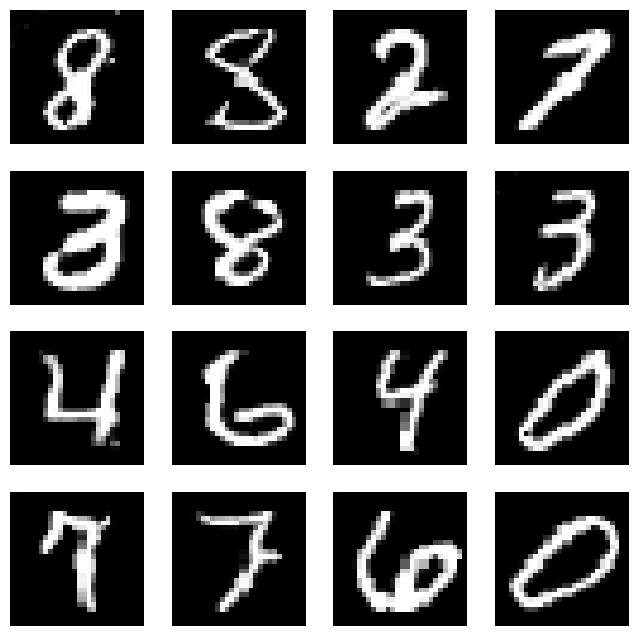

In [ ]:
import matplotlib.pyplot as plt
import torch


def generate_images(generator, num_images=16, z_dim=100, label_dim=10):
    generator.eval()

    noise = torch.randn(num_images, z_dim).to(device)
    labels = torch.randint(0, 10, (num_images,)).to(device)
    labels_one_hot = one_hot_encode_tensor(labels, num_classes=label_dim)
    with torch.no_grad():
        fake_images = generator(noise, labels_one_hot)
    fake_images = fake_images.cpu().view(-1, 28, 28)

    fig, axes = plt.subplots(4, 4, figsize=(8, 8))
    for i in range(num_images):
        ax = axes[i // 4, i % 4]
        ax.imshow(fake_images[i], cmap='gray')
        ax.axis('off')
    plt.show()

generate_images(G)

In [ ]:
def generate_images_for_label(generator, label, num_images, z_dim=100, label_dim=10):
    generator.eval()

    noise = torch.randn(num_images, z_dim).to(device)
    labels = torch.full((num_images,), label, dtype=torch.long).to(device)
    labels_one_hot = one_hot_encode_tensor(labels, num_classes=label_dim)

    with torch.no_grad():
        fake_images = generator(noise, labels_one_hot)
    fake_images = fake_images.cpu().view(-1, 28, 28)
    print(type(fake_images))
    print(fake_images.shape)
    fake_images_array = fake_images.cpu().numpy()
    print(fake_images_array.shape)



    '''fig, axes = plt.subplots(4, 4, figsize=(8, 8))
    for i in range(num_images):
        ax = axes[i // 4, i % 4]
        ax.imshow(fake_images[i], cmap='gray')
        ax.axis('off')
    plt.show()'''

    return fake_images_array


fake_images_array = generate_images_for_label(G_loaded, label=8, num_images=16)


<class 'torch.Tensor'>
torch.Size([16, 28, 28])
(16, 28, 28)


In [ ]:
print(fake_images_array[1])

[[-1.         -1.         -1.         -1.         -1.         -1.
  -1.         -1.         -1.         -1.         -1.         -1.
  -1.         -1.         -1.         -1.         -1.         -1.
  -1.         -1.         -1.         -1.         -1.         -1.
  -1.         -1.         -1.         -1.        ]
 [-1.         -1.         -1.         -1.         -1.         -1.
  -1.         -1.         -1.         -1.         -1.         -1.
  -1.         -1.         -1.         -1.         -1.         -1.
  -1.         -1.         -1.         -1.         -1.         -1.
  -1.         -1.         -1.         -1.        ]
 [-1.         -1.         -1.         -1.         -1.         -1.
  -1.         -1.         -1.         -1.         -1.         -1.
  -1.         -1.         -1.         -1.         -1.         -1.
  -1.         -1.         -1.         -1.         -1.         -1.
  -1.         -1.         -1.         -1.        ]
 [-1.         -1.         -1.         -1.         -1.  

In [ ]:
im_min = fake_images_array.min()
im_max = fake_images_array.max()
print(im_min, im_max)

-1.0 1.0


<class 'torch.Tensor'>
torch.Size([16, 28, 28])
(16, 28, 28)
[[-1.         -1.         -1.         -1.         -1.         -1.
  -1.         -1.         -1.         -1.         -1.         -1.
  -1.         -1.         -1.         -1.         -1.         -1.
  -1.         -1.         -1.         -1.         -1.         -1.
  -1.         -1.         -1.         -0.9999999 ]
 [-1.         -1.         -1.         -1.         -1.         -1.
  -1.         -1.         -1.         -1.         -1.         -1.
  -1.         -1.         -1.         -1.         -1.         -1.
  -1.         -1.         -1.         -1.         -1.         -1.
  -1.         -1.         -1.         -1.        ]
 [-1.         -1.         -1.         -1.         -1.         -1.
  -1.         -1.         -1.         -1.         -1.         -1.
  -1.         -1.         -1.         -1.         -1.         -1.
  -1.         -1.         -1.         -1.         -1.         -1.
  -1.         -1.         -1.         -1.    

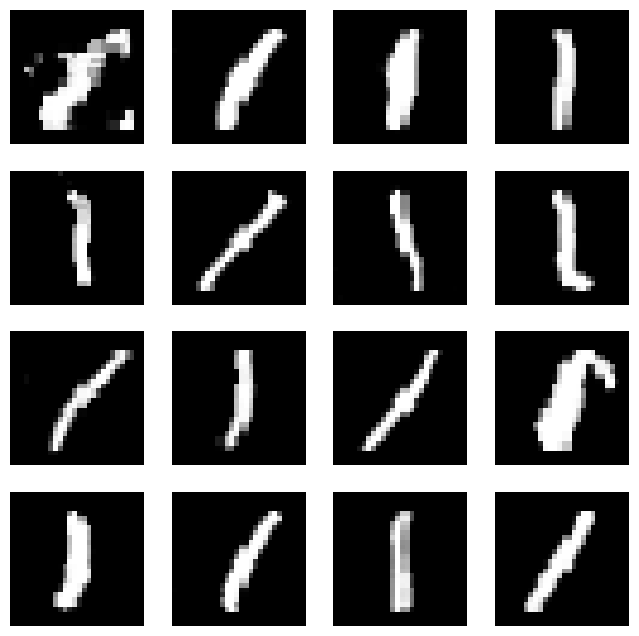

array([[[-1.        , -1.        , -1.        , ..., -1.        ,
         -1.        , -1.        ],
        [-1.        , -1.        , -1.        , ..., -1.        ,
         -1.        , -1.        ],
        [-1.        , -1.        , -1.        , ..., -1.        ,
         -1.        , -1.        ],
        ...,
        [-1.        , -1.        , -1.        , ..., -0.9829663 ,
         -0.99999946, -1.        ],
        [-1.        , -1.        , -1.        , ..., -0.9999876 ,
         -0.9999998 , -1.        ],
        [-1.        , -1.        , -1.        , ..., -0.99999255,
         -0.9999999 , -0.9999999 ]],

       [[-1.        , -1.        , -1.        , ..., -1.        ,
         -1.        , -0.9999999 ],
        [-1.        , -1.        , -1.        , ..., -1.        ,
         -1.        , -1.        ],
        [-1.        , -1.        , -1.        , ..., -1.        ,
         -1.        , -1.        ],
        ...,
        [-1.        , -1.        , -1.        , ..., -

In [ ]:
generate_images_for_label(G_loaded, label=1)

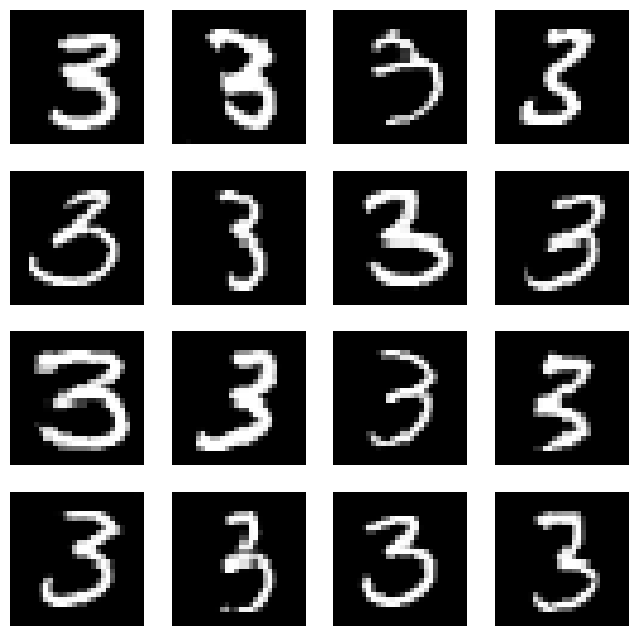

In [ ]:
generate_images_for_label(G, label=3)

<class 'torch.Tensor'>
torch.Size([16, 28, 28])
(16, 28, 28)
[[-1.         -1.         -1.         -1.         -1.         -1.
  -1.         -1.         -1.         -1.         -1.         -1.
  -1.         -1.         -1.         -1.         -1.         -1.
  -1.         -1.         -1.         -1.         -1.         -1.
  -1.         -1.         -1.         -1.        ]
 [-1.         -1.         -1.         -1.         -1.         -1.
  -1.         -1.         -1.         -1.         -1.         -1.
  -1.         -1.         -1.         -1.         -1.         -1.
  -1.         -1.         -1.         -1.         -1.         -1.
  -1.         -1.         -1.         -1.        ]
 [-1.         -1.         -1.         -1.         -1.         -1.
  -1.         -1.         -1.         -1.         -1.         -1.
  -1.         -1.         -1.         -1.         -1.         -1.
  -1.         -1.         -1.         -1.         -1.         -1.
  -1.         -1.         -1.         -1.    

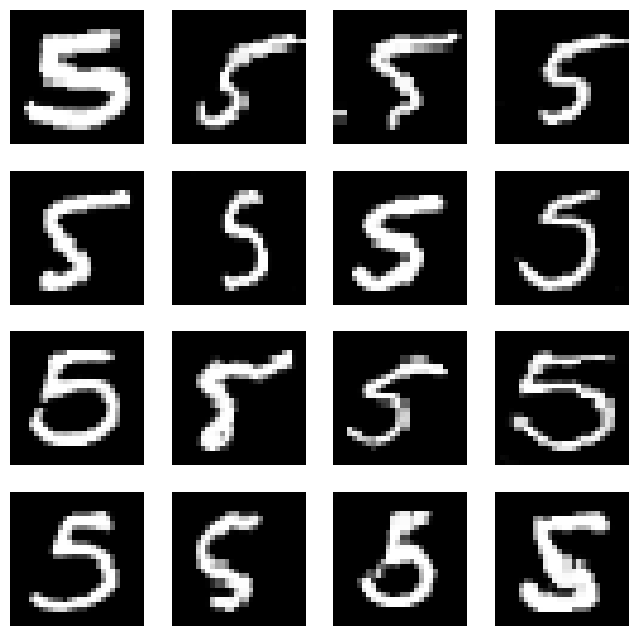

array([[[-1.        , -1.        , -1.        , ..., -1.        ,
         -1.        , -1.        ],
        [-1.        , -1.        , -1.        , ..., -1.        ,
         -1.        , -1.        ],
        [-1.        , -1.        , -1.        , ..., -1.        ,
         -1.        , -1.        ],
        ...,
        [-1.        , -1.        , -1.        , ..., -1.        ,
         -1.        , -1.        ],
        [-1.        , -1.        , -1.        , ..., -1.        ,
         -1.        , -1.        ],
        [-1.        , -1.        , -1.        , ..., -1.        ,
         -1.        , -1.        ]],

       [[-1.        , -1.        , -1.        , ..., -1.        ,
         -1.        , -1.        ],
        [-1.        , -1.        , -1.        , ..., -1.        ,
         -1.        , -1.        ],
        [-1.        , -1.        , -1.        , ..., -1.        ,
         -1.        , -1.        ],
        ...,
        [-1.        , -1.        , -1.        , ..., -

In [ ]:
generate_images_for_label(G_loaded, label=5)

In [ ]:
save_path = "/content/drive/MyDrive/generator.pth"
torch.save(G.state_dict(), save_path)


In [ ]:
save_path_discriminator = "/content/drive/MyDrive/discriminator.pth"
torch.save(D.state_dict(), save_path_discriminator)


In [ ]:
import matplotlib.pyplot as plt
import numpy as np

import torch
import torch.nn as nn
from torch.utils.data import TensorDataset, DataLoader
import torch.optim as optim
from torchvision.utils import make_grid
import cv2
from sklearn.preprocessing import OneHotEncoder
import os
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f'Using device: {device}')
def one_hot_encode_tensor(labels, num_classes=10):
    return torch.zeros(labels.size(0), num_classes, device=labels.device).scatter_(1, labels.unsqueeze(1), 1)

# Define Generator
class Generator(nn.Module):
    def __init__(self, noise_dim=100, label_dim=10):
        super(Generator, self).__init__()
        self.noise_dim = noise_dim
        self.label_dim = label_dim
        self.input_dim = noise_dim + label_dim

        self.linear = nn.Sequential(
            nn.Linear(self.input_dim, 7 * 7 * 128),
            nn.LeakyReLU(0.2, inplace=True)
        )

        self.main = nn.Sequential(
            nn.ConvTranspose2d(128, 128, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(True),

            nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(True),

            nn.Conv2d(64, 1, kernel_size=3, stride=1, padding=1),
            nn.Tanh()
        )

    def forward(self, noise, labels):
        x = torch.cat([noise, labels], dim=1)
        x = self.linear(x)
        x = x.view(-1, 128, 7, 7)
        x = self.main(x)
        return x

Using device: cuda


In [ ]:
G_loaded = Generator(noise_dim=100, label_dim=10).to(device)
G_loaded.load_state_dict(torch.load("/content/drive/MyDrive/generator.pth"))
G_loaded.eval()


<ipython-input-8-06908e124d68>:4: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  G_loaded.load_state_dict(torch.load("/content/drive/MyDrive/generator.pth"))


Generator(
  (linear): Sequential(
    (0): Linear(in_features=110, out_features=6272, bias=True)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
  )
  (main): Sequential(
    (0): ConvTranspose2d(128, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): Conv2d(64, 1, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (7): Tanh()
  )
)

In [ ]:
G_loaded = Generator(noise_dim=100, label_dim=10).to(device)
G_loaded.load_state_dict(torch.load("/content/drive/MyDrive/generator.pth", map_location=torch.device('cpu')))
G_loaded.eval()


<ipython-input-5-f82a2f5079ff>:3: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  G_loaded.load_state_dict(torch.load("/content/drive/MyDrive/generator.pth", map_location=torc

Generator(
  (linear): Sequential(
    (0): Linear(in_features=110, out_features=6272, bias=True)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
  )
  (main): Sequential(
    (0): ConvTranspose2d(128, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): Conv2d(64, 1, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (7): Tanh()
  )
)

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import os
from google.colab import drive
drive.mount('/content/drive')
print(os.path.exists("/content/drive/MyDrive/generator.pth"))
print(os.path.exists("/content/drive/MyDrive/discriminator.pth"))
print(os.path.exists("/content/drive/MyDrive/npy_2/np_save_train_images_2.npy"))


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
True
True
True


In [ ]:
import numpy as np
train_images = np.load("/content/drive/MyDrive/npy_2/np_save_train_images_2.npy")
train_labels = np.load("/content/drive/MyDrive/npy_2/np_save_train_labels_2.npy")
test_images = np.load("/content/drive/MyDrive/npy_2/np_save_test_images_2.npy")
test_labels = np.load("/content/drive/MyDrive/npy_2/np_save_test_labels_2.npy")
val_images = np.load("/content/drive/MyDrive/npy_2/np_save_val_images_2.npy")
val_labels = np.load("/content/drive/MyDrive/npy_2/np_save_val_labels_2.npy")

Label: 000
0
0
0
0
crop shape: (28, 28)
0
crop shape: (28, 28)
0
crop shape: (28, 28)


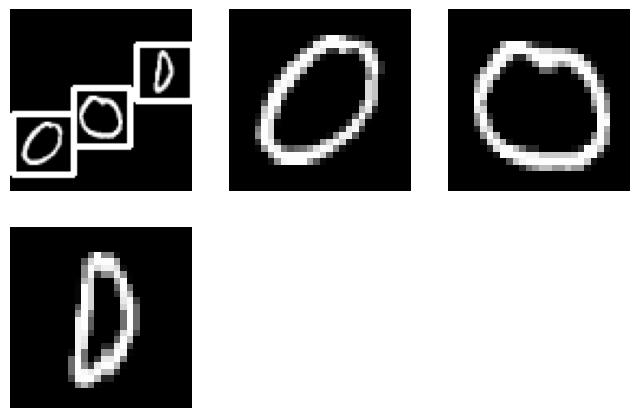

192000
60000
48000
(192000, 28, 28)
(60000, 28, 28)
(48000, 28, 28)
(192000,)
(60000,)
(48000,)
640
10
160


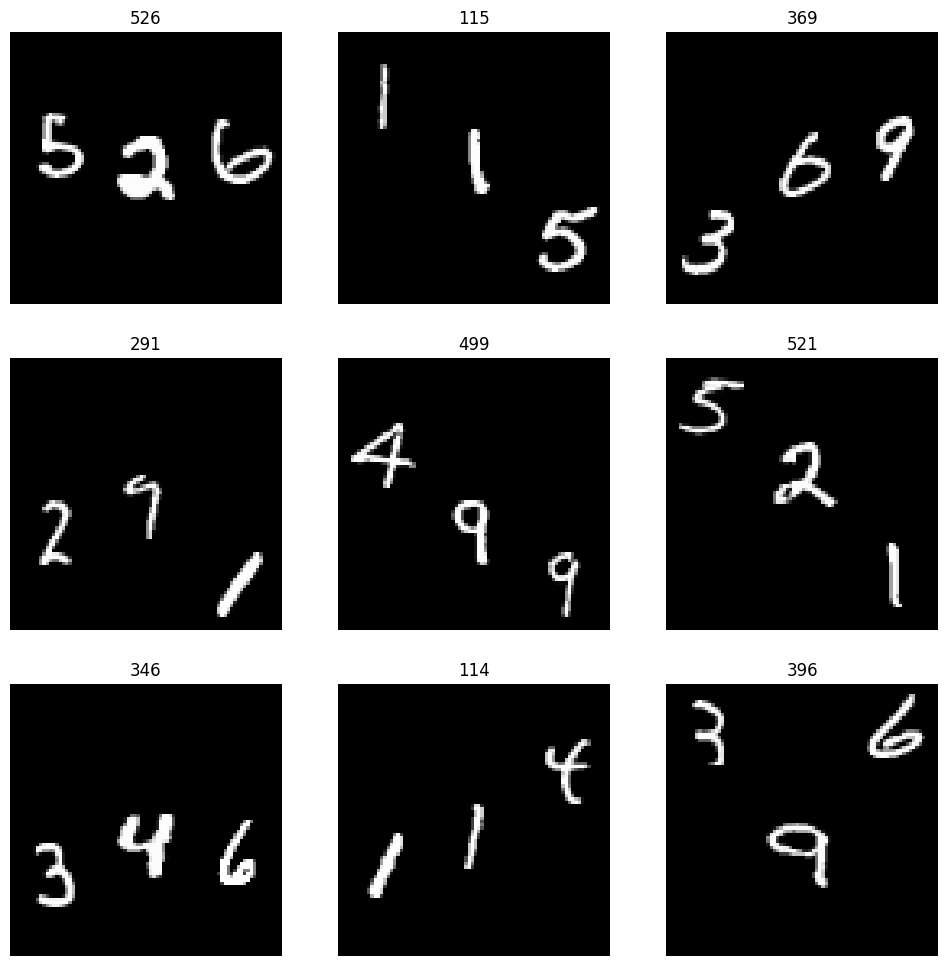

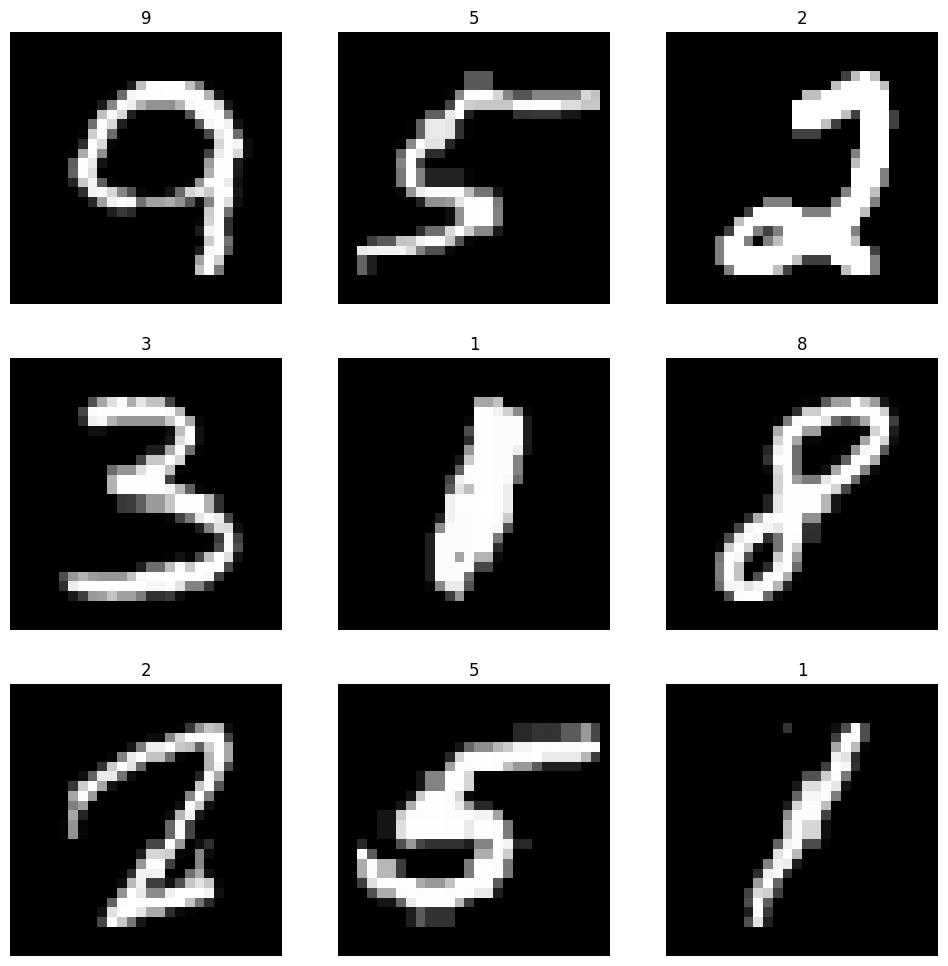

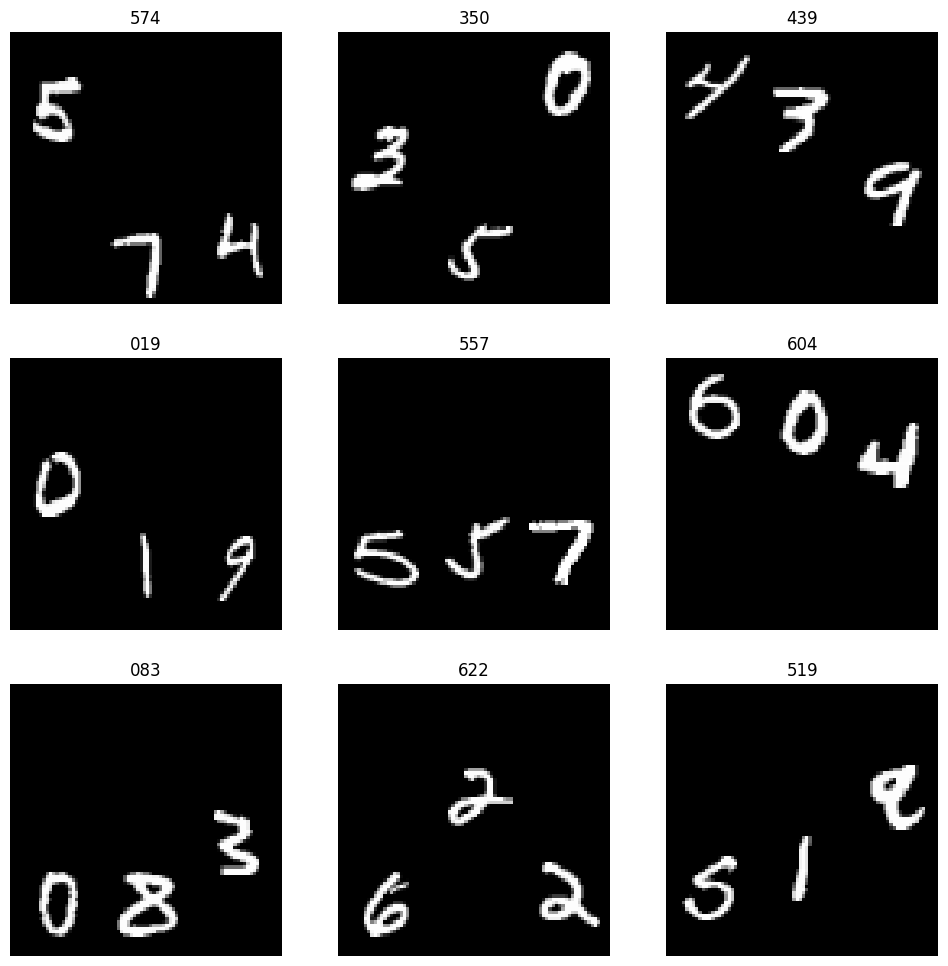

In [ ]:
#TASK-3 CNN with 3 distinct digits everythıng
import tensorflow as tf
import tensorflow.keras as keras
from tensorflow.keras import layers, models
from sklearn.metrics import classification_report, confusion_matrix
import cv2
##### SPLIT FUNCTION AND ITS DEMONSTRATION #####
digit_shape = (28, 28)
def crop_digits(img_path: str = None, im = None):
    #if im is None:
    #    im = cv2.imread(img_path)

    #gray = cv2.cvtColor(im, cv2.COLOR_BGR2GRAY)
    blur = cv2.GaussianBlur(img_path, (5, 5), 0)
    thresh = cv2.threshold(blur, 90, 255, cv2.THRESH_BINARY+cv2.THRESH_OTSU)[1]
    contours, hierarchy = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    digits = []
    rect = img_path.copy()
    for cnt in contours:
        x, y, w, h = cv2.boundingRect(cnt)

        x = max(x - 3, 0)
        y = max(y - 3, 0)
        w += 6
        h += 6

        del_x = int(w / 2)
        del_y = int(h / 2)
        center_x = x + del_x
        center_y = y + del_y

        lu_corner = (max(center_x - del_y, 0), y)
        rd_corner = (max(center_x + del_y, 0), y + h)

        rect = cv2.rectangle(rect, lu_corner, rd_corner, (255, 0, 0), 2) #rectangle

        cropped = img_path[lu_corner[1]:rd_corner[1], lu_corner[0]:rd_corner[0]]
        digits.append(cropped)

    def filter_and_sort_digits(digits, contours):
        sizes = []
        for digit in digits:
            size = digit.shape[0] * digit.shape[1]
            sizes.append(size)
        avg_size = sum(sizes) / len(sizes)
        deviations = [abs(size - avg_size) for size in sizes]

        indices = np.argsort(deviations)[0:3]
        digits = [digits[i] for i in indices]
        contours = [cv2.boundingRect(contours[i]) for i in indices]

        xs = [contour[0] for contour in contours]
        indices = np.argsort(xs) #get highest likelihood digit
        digits = [digits[i] for i in indices]

        while len(digits) < 3:
            digits.append(digits[0])
        return digits

    digits = filter_and_sort_digits(digits, contours) #get highest likelihood digits
    digits = [cv2.resize(digit, digit_shape, interpolation = cv2.INTER_NEAREST) for digit in digits] #resize to 28,28

    return digits, contours, rect

print(f"Label: {train_labels[0]}")
print(train_labels[0][0])
print(train_labels[0][1])
print(train_labels[0][2])

fig = plt.figure(figsize=(8, 8))
cols, rows = 3, 3

digits, contours, rect = crop_digits(train_images[0])

fig.add_subplot(rows, cols, 1)
plt.axis("off")
plt.imshow(rect.squeeze(), cmap="gray")
for i in range(len(digits)):
    img = digits[i]
    print(train_labels[0][i])
    fig.add_subplot(rows, cols, i+2)
    plt.axis("off")
    plt.imshow(img.squeeze(), cmap="gray")
    print(f"crop shape: {img.shape}")
plt.show()


##### SPLIT ALL DATA TO DIGITS #####
def load_digits(images, labels):
  all_digits = []
  all_labels = []
  for i in range(len(images)):
    digits, contours, rect = crop_digits(images[i])
    for j in range(len(digits)):
      all_digits.append(digits[j])
      all_labels.append(labels[i][j])
  return np.array(all_digits), np.array(all_labels)

train_images_digits, train_labels_digits = load_digits(train_images, train_labels)
test_images_digits, test_labels_digits = load_digits(test_images, test_labels)
val_images_digits, val_labels_digits = load_digits(val_images, val_labels)
print(len(train_images_digits))
print(len(test_images_digits))
print(len(val_images_digits))
print(train_images_digits.shape)
print(test_images_digits.shape)
print(val_images_digits.shape)
print(train_labels_digits.shape)
print(test_labels_digits.shape)
print(val_labels_digits.shape)

print(len(np.unique(train_labels)))
print(len(np.unique(test_labels_digits)))
print(len(np.unique(val_labels)))

def visualize(images, labels):
  np.random.seed(42)
  random_indices = np.random.choice(len(images), size=9, replace=False)
  random_images = images[random_indices]
  random_labels = labels[random_indices]

  fig, axes = plt.subplots(3, 3, figsize=(12, 12))
  for i, (img, label) in enumerate(zip(random_images, random_labels)):
      ax = axes[i // 3, i % 3]
      ax.imshow(img, cmap='gray')
      ax.set_title(label)
      ax.axis('off')
  plt.show()

visualize(train_images, train_labels)
visualize(test_images_digits, test_labels_digits)
visualize(val_images, val_labels)



In [ ]:


print(digit_counts)
print(train_labels_digits)
dict = {
     '0': 0,
     '1': 0,
      '2': 0,
      '3': 0,
      '4': 0,
      '5': 0,
      '6': 0,
      '7': 0,
      '8': 0,
      '9': 0
  }
for i in range(len(train_labels_digits)):

      dict[str(train_labels_digits[i])] += 1


print(dict)

Counter({'7': 20500, '2': 20500, '3': 19700, '8': 19500, '6': 19100, '9': 18900, '1': 18800, '0': 18700, '4': 18200, '5': 18100})
['0' '0' '0' ... '9' '9' '7']
{'0': 18700, '1': 18800, '2': 20500, '3': 19700, '4': 18200, '5': 18100, '6': 19100, '7': 20500, '8': 19500, '9': 18900}


In [ ]:
fake_fives = generate_images_for_label(G_loaded, label = 5, num_images=200)

<class 'torch.Tensor'>
torch.Size([200, 28, 28])
(200, 28, 28)


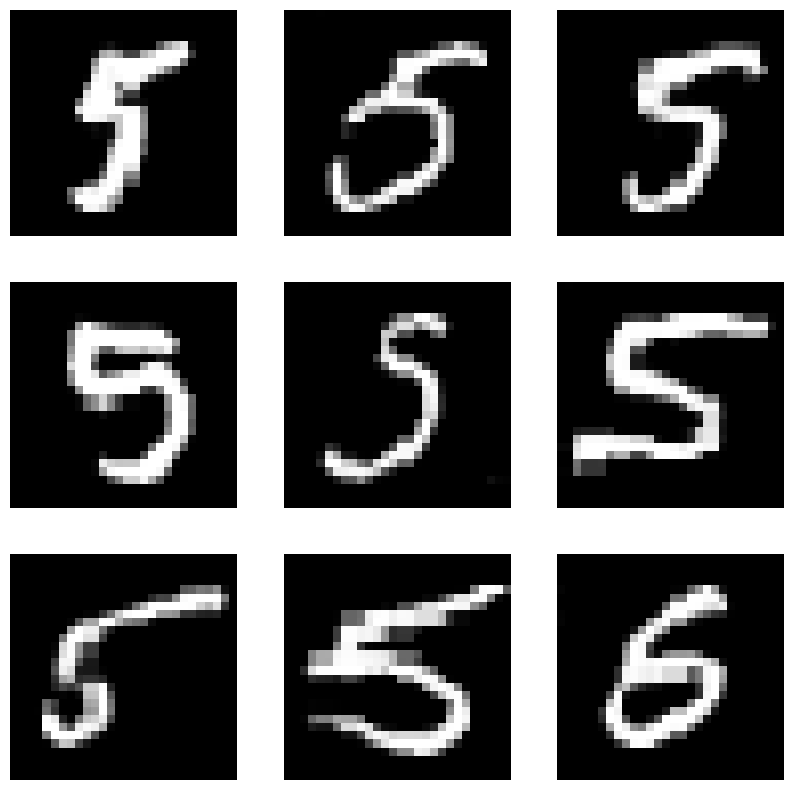

In [ ]:
# prompt: visualize random images from the array fake fives

import matplotlib.pyplot as plt
import numpy as np

# Assuming fake_fives is already defined and contains the generated images
# as a NumPy array with shape (num_images, 28, 28)

def visualize_fake_fives(fake_fives, num_images_to_show=9):
    num_images = fake_fives.shape[0]
    random_indices = np.random.choice(num_images, size=min(num_images_to_show, num_images), replace=False)
    random_images = fake_fives[random_indices]

    fig, axes = plt.subplots(int(np.sqrt(num_images_to_show)), int(np.sqrt(num_images_to_show)), figsize=(10, 10))
    for i, img in enumerate(random_images):
      ax = axes[i // int(np.sqrt(num_images_to_show)), i % int(np.sqrt(num_images_to_show))]
      ax.imshow(img, cmap='gray')
      ax.axis('off')
    plt.show()

visualize_fake_fives(fake_fives)

(200, 28, 28)
-1.0 1.0
-0.68995196
0.0 1.0


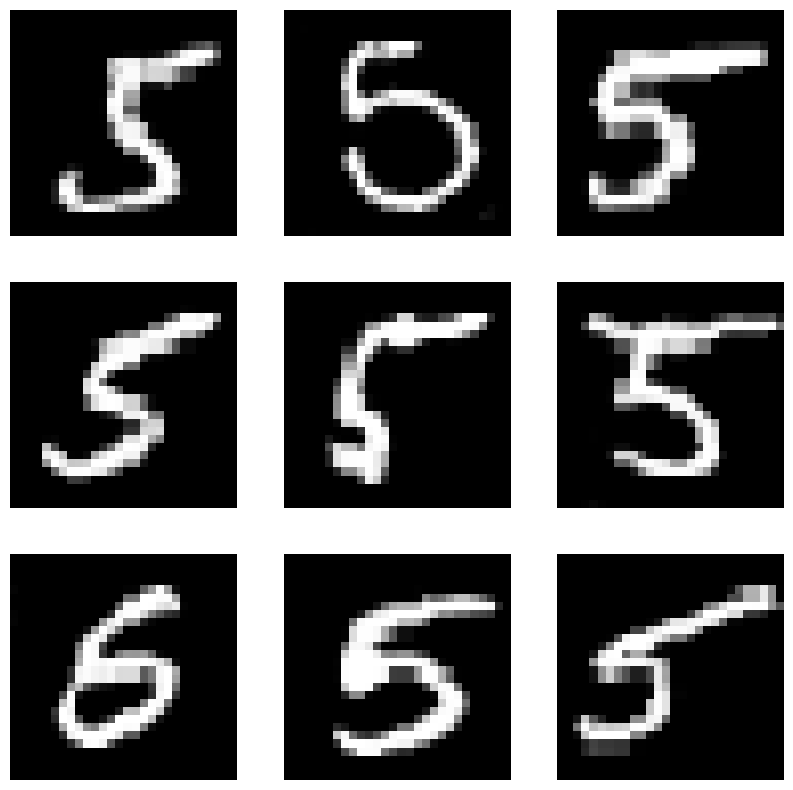

(200, 1, 28, 28)


In [ ]:
print(fake_fives.shape)
minmin = fake_fives.min()
maxmax = fake_fives.max()
print(minmin, maxmax)
mean = fake_fives.mean()
print(mean)
fake_fives = (fake_fives+1)/2
minmin = fake_fives.min()
maxmax = fake_fives.max()
print(minmin, maxmax)
visualize_fake_fives(fake_fives)
fake_fives = fake_fives[:, np.newaxis, :, :]
print(fake_fives.shape)


In [ ]:
def generate_and_preprocess(generator, label, num_images, z_dim=100, label_dim=10):
    noise = torch.randn(num_images, z_dim).to(device)
    labels = torch.full((num_images,), label, dtype=torch.long).to(device)
    labels_one_hot = one_hot_encode_tensor(labels, num_classes=label_dim)

    with torch.no_grad():
        fake_images = generator(noise, labels_one_hot)
    fake_images = fake_images.cpu().view(-1, 28, 28)
    print(type(fake_images))
    print(fake_images.shape)
    fake_images_array = fake_images.cpu().numpy()  # Convert to NumPy array
    print(fake_images_array.shape)  # Output: (16, 28, 28)
    fake_images_array = (fake_images_array+1)/2
    fake_images_array = fake_images_array[:, np.newaxis, :, :]
    fake_labels = np.full((fake_images_array.shape[0],), label)
    fake_images_array = fake_images_array.transpose(0, 2, 3, 1)






    '''fig, axes = plt.subplots(4, 4, figsize=(8, 8))
    for i in range(num_images):
        ax = axes[i // 4, i % 4]
        ax.imshow(fake_images[i], cmap='gray')
        ax.axis('off')
    plt.show()'''

    return fake_images_array, fake_labels

fake_fives_array, fake_fives_labels = generate_and_preprocess(G_loaded, label=5, num_images=1000)
fake_nines_array, fake_nines_labels = generate_and_preprocess(G_loaded, label=9, num_images=1000)
fake_eights_array, fake_eights_labels = generate_and_preprocess(G_loaded, label=8, num_images=1000)
fake_sevens_array, fake_sevens_labels = generate_and_preprocess(G_loaded, label=7, num_images=1000)



<class 'torch.Tensor'>
torch.Size([1000, 28, 28])
(1000, 28, 28)
<class 'torch.Tensor'>
torch.Size([1000, 28, 28])
(1000, 28, 28)
<class 'torch.Tensor'>
torch.Size([1000, 28, 28])
(1000, 28, 28)
<class 'torch.Tensor'>
torch.Size([1000, 28, 28])
(1000, 28, 28)


In [ ]:
print(fake_sevens_array.shape)
print(fake_sevens_labels.shape)


(1000, 28, 28, 1)
(1000,)


In [ ]:
reshaped_arrayfake_images = fake_images_array.transpose(0, 2, 3, 1)  # Rearrange dimensions
print(reshaped_arrayfake_images.shape)

(500, 28, 28, 1)


(28, 28)


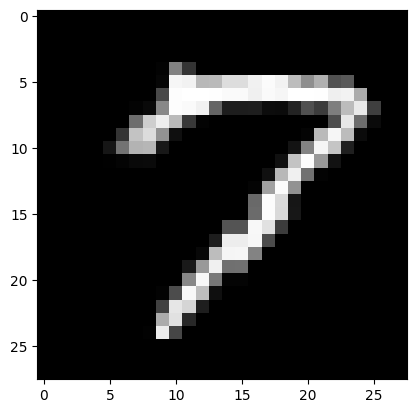

In [ ]:
image = fake_sevens_array[0].reshape(28, 28)
print(image.shape)
plt.imshow(image, cmap='gray')  # Correct line


In [ ]:
all_fake_images = np.concatenate((fake_fives_array, fake_nines_array, fake_eights_array, fake_sevens_array), axis=0)
all_fake_labels = np.concatenate((fake_fives_labels, fake_nines_labels, fake_eights_labels, fake_sevens_labels), axis=0)
print(all_fake_images.shape)

(4000, 28, 28, 1)


(28, 28)
8


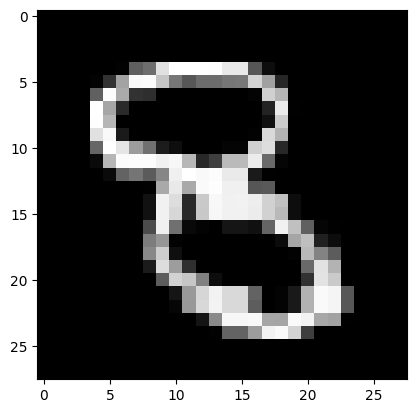

In [ ]:
image = all_fake_images[2300].reshape(28, 28)
print(image.shape)
print(all_fake_labels[2300])
plt.imshow(image, cmap='gray')

In [ ]:
print(fake_labels[3])

5


In [ ]:
from google.colab import drive
drive.mount('/content/drive')
train_images = np.load("/content/drive/MyDrive/npy_2/np_save_train_images_2.npy")
train_labels = np.load("/content/drive/MyDrive/npy_2/np_save_train_labels_2.npy")
val_images = np.load("/content/drive/MyDrive/npy_2/np_save_val_images_2.npy")
val_labels = np.load("/content/drive/MyDrive/npy_2/np_save_val_labels_2.npy")
test_images = np.load("/content/drive/MyDrive/npy_2/np_save_test_images_2.npy")
test_labels = np.load("/content/drive/MyDrive/npy_2/np_save_test_labels_2.npy")

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
print(train_images.shape)
print(train_labels.shape)
print(val_images.shape)
print(val_labels.shape)
print(test_images.shape)
print(test_labels.shape)

(64000, 84, 84)
(64000,)
(16000, 84, 84)
(16000,)
(20000, 84, 84)
(20000,)


Label: 000
0
0
0
0
crop shape: (28, 28)
0
crop shape: (28, 28)
0
crop shape: (28, 28)


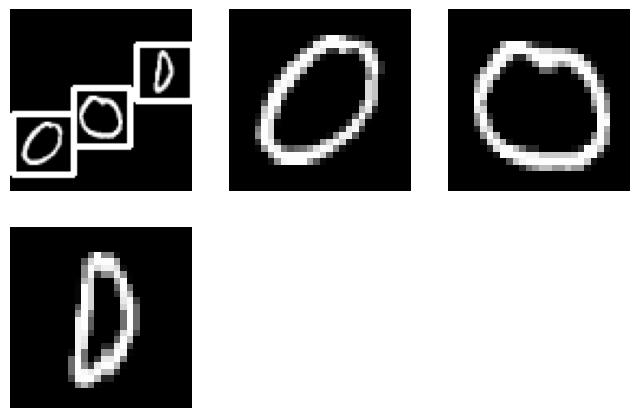

192000
60000
48000
(192000, 28, 28)
(60000, 28, 28)
(48000, 28, 28)
(192000,)
(60000,)
(48000,)
10
10
10


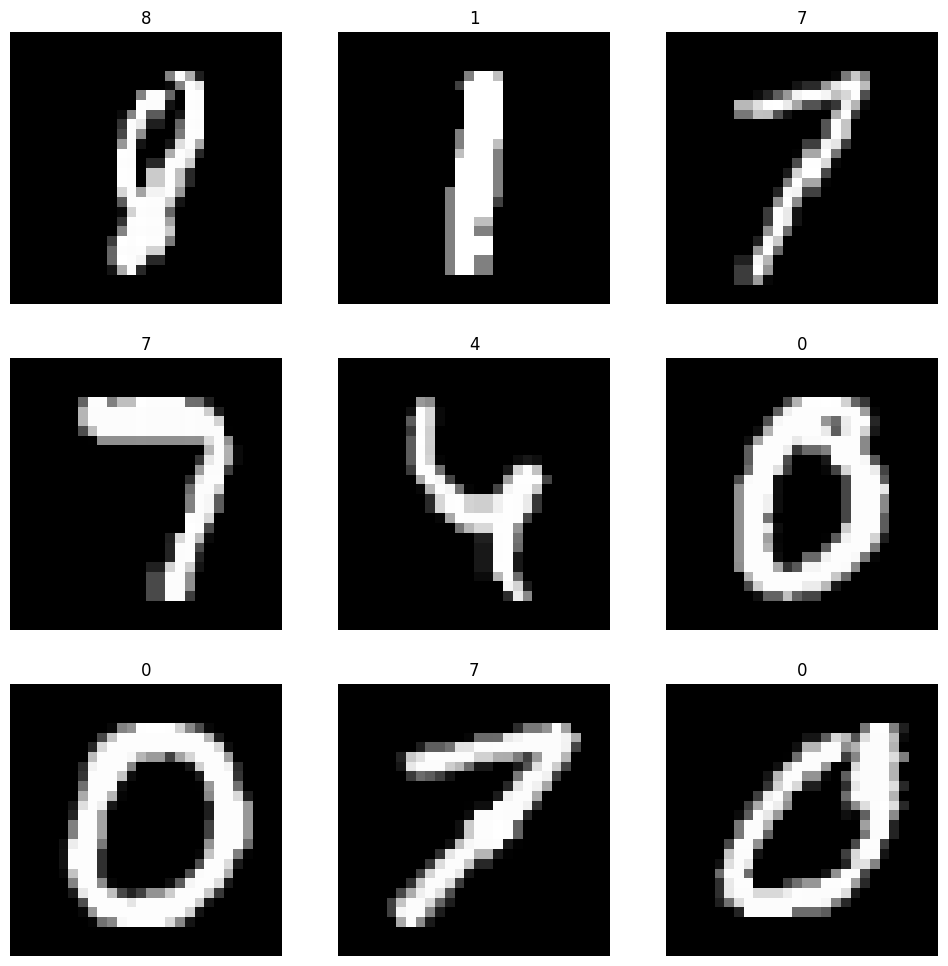

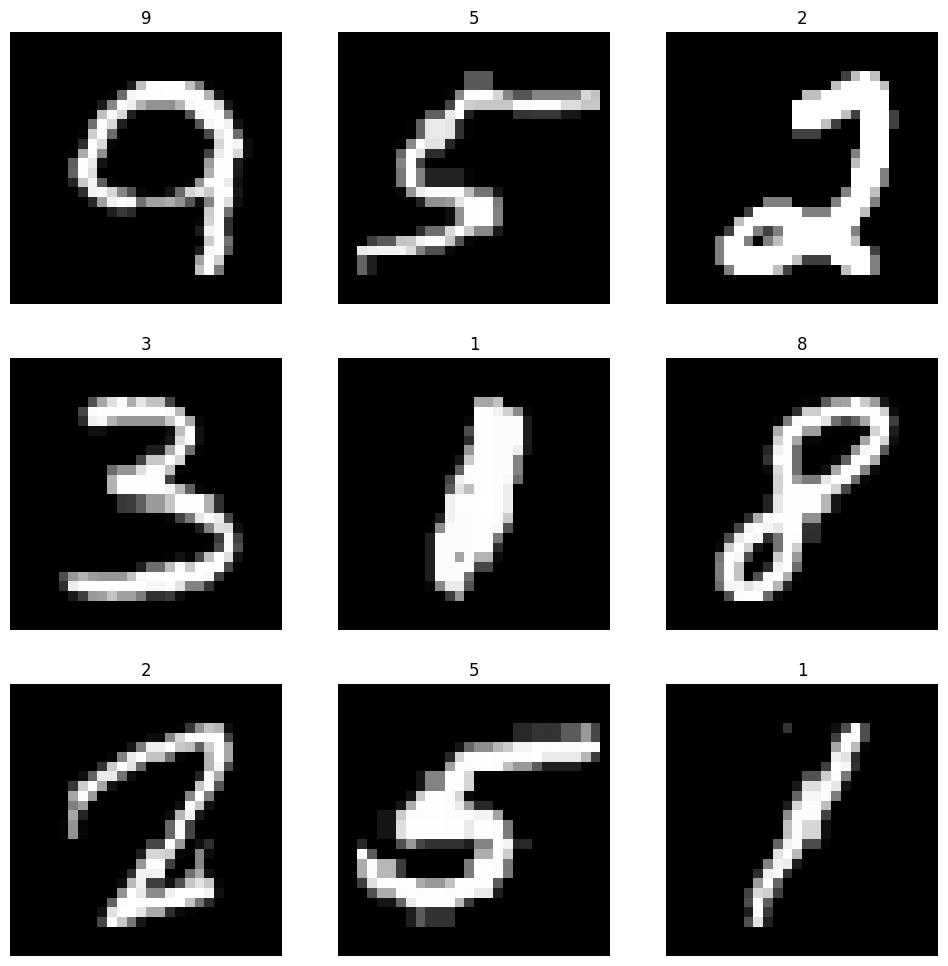

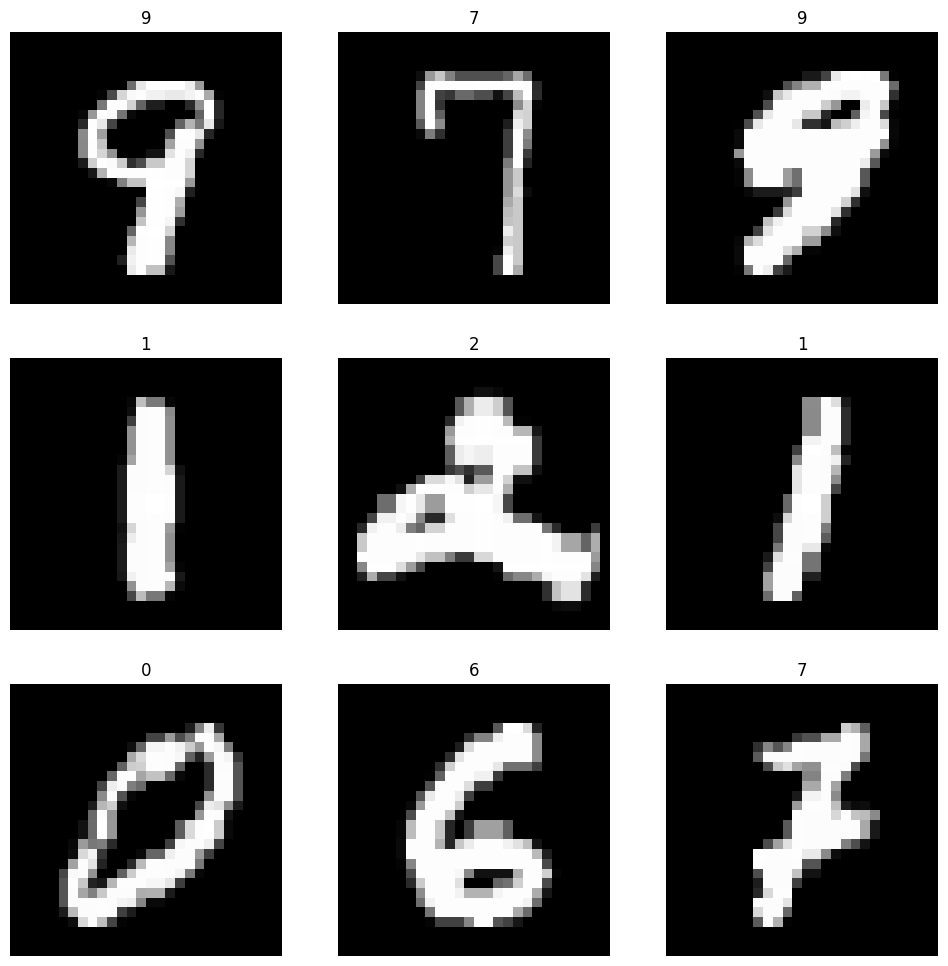

Training data shape: (192000, 28, 28, 1) (192000,)
Validation data shape: (48000, 28, 28, 1) (48000,)
Test data shape: (60000, 28, 28, 1) (60000,)
tl(192000, 10)
ti(192000, 28, 28, 1)
vl(48000, 10)
vi(48000, 28, 28, 1)
tl(60000, 10)
ti(60000, 28, 28, 1)


In [ ]:
#TASK-3 CNN with 3 distinct digits only bTCH NORMlızatıon
import tensorflow as tf
import tensorflow.keras as keras
from tensorflow.keras import layers, models
from sklearn.metrics import classification_report, confusion_matrix
import cv2
from tensorflow.keras import models, layers, optimizers, losses, metrics
##### SPLIT FUNCTION AND ITS DEMONSTRATION #####
digit_shape = (28, 28)
def crop_digits(img_path: str = None, im = None):
    #if im is None:
    #    im = cv2.imread(img_path)

    #gray = cv2.cvtColor(im, cv2.COLOR_BGR2GRAY)
    blur = cv2.GaussianBlur(img_path, (5, 5), 0)
    thresh = cv2.threshold(blur, 90, 255, cv2.THRESH_BINARY+cv2.THRESH_OTSU)[1]
    contours, hierarchy = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    digits = []
    rect = img_path.copy()
    for cnt in contours:
        x, y, w, h = cv2.boundingRect(cnt)
##########################################################666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666
        x = max(x - 3, 0)
        y = max(y - 3, 0)
        w += 6
        h += 6

        del_x = int(w / 2)
        del_y = int(h / 2)
        center_x = x + del_x
        center_y = y + del_y

        lu_corner = (max(center_x - del_y, 0), y)
        rd_corner = (max(center_x + del_y, 0), y + h)

        rect = cv2.rectangle(rect, lu_corner, rd_corner, (255, 0, 0), 2) #rectangle

        cropped = img_path[lu_corner[1]:rd_corner[1], lu_corner[0]:rd_corner[0]]
        digits.append(cropped)

    def filter_and_sort_digits(digits, contours):
        sizes = []
        for digit in digits:
            size = digit.shape[0] * digit.shape[1]
            sizes.append(size)
        avg_size = sum(sizes) / len(sizes)
        deviations = [abs(size - avg_size) for size in sizes]

        indices = np.argsort(deviations)[0:3]
        digits = [digits[i] for i in indices]
        contours = [cv2.boundingRect(contours[i]) for i in indices]

        xs = [contour[0] for contour in contours]
        indices = np.argsort(xs) #get highest likelihood digit
        digits = [digits[i] for i in indices]

        while len(digits) < 3:
            digits.append(digits[0])
        return digits

    digits = filter_and_sort_digits(digits, contours) #get highest likelihood digits
    digits = [cv2.resize(digit, digit_shape, interpolation = cv2.INTER_NEAREST) for digit in digits] #resize to 28,28

    return digits, contours, rect

print(f"Label: {train_labels[0]}")
print(train_labels[0][0])
print(train_labels[0][1])
print(train_labels[0][2])

fig = plt.figure(figsize=(8, 8))
cols, rows = 3, 3

digits, contours, rect = crop_digits(train_images[0])

fig.add_subplot(rows, cols, 1)
plt.axis("off")
plt.imshow(rect.squeeze(), cmap="gray")
for i in range(len(digits)):
    img = digits[i]
    print(train_labels[0][i])
    fig.add_subplot(rows, cols, i+2)
    plt.axis("off")
    plt.imshow(img.squeeze(), cmap="gray")
    print(f"crop shape: {img.shape}")
plt.show()


##### SPLIT ALL DATA TO DIGITS #####
def load_digits(images, labels):
  all_digits = []
  all_labels = []
  for i in range(len(images)):
    digits, contours, rect = crop_digits(images[i])
    for j in range(len(digits)):
      all_digits.append(digits[j])
      all_labels.append(labels[i][j])
  return np.array(all_digits), np.array(all_labels)

train_images, train_labels = load_digits(train_images, train_labels)
test_images_digits, test_labels_digits = load_digits(test_images, test_labels)
val_images, val_labels = load_digits(val_images, val_labels)
print(len(train_images))
print(len(test_images_digits))
print(len(val_images))
print(train_images.shape)
print(test_images_digits.shape)
print(val_images.shape)
print(train_labels.shape)
print(test_labels_digits.shape)
print(val_labels.shape)

print(len(np.unique(train_labels)))
print(len(np.unique(test_labels_digits)))
print(len(np.unique(val_labels)))

def visualize(images, labels):
  np.random.seed(42)
  random_indices = np.random.choice(len(images), size=9, replace=False)
  random_images = images[random_indices]
  random_labels = labels[random_indices]

  fig, axes = plt.subplots(3, 3, figsize=(12, 12))
  for i, (img, label) in enumerate(zip(random_images, random_labels)):
      ax = axes[i // 3, i % 3]
      ax.imshow(img, cmap='gray')
      ax.set_title(label)
      ax.axis('off')
  plt.show()

visualize(train_images, train_labels)
visualize(test_images_digits, test_labels_digits)
visualize(val_images, val_labels)

################################################################################################################################maxpooling iyii sionuc asssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssss
##### TRAIN CNN #####


train_images = train_images / 255.0
val_images = val_images / 255.0
test_images_digits = test_images_digits / 255.0

train_images = train_images.reshape((train_images.shape[0], 28, 28, 1))
val_images = val_images.reshape((val_images.shape[0], 28, 28, 1))
test_images_digits = test_images_digits.reshape((test_images_digits.shape[0], 28, 28, 1))

print('Training data shape:', train_images.shape, train_labels.shape)
print('Validation data shape:', val_images.shape, val_labels.shape)
print('Test data shape:', test_images_digits.shape, test_labels_digits.shape)

train_labels = tf.keras.utils.to_categorical(train_labels, num_classes=10)
val_labels = tf.keras.utils.to_categorical(val_labels, num_classes=10)
test_labels_digits = tf.keras.utils.to_categorical(test_labels_digits, num_classes=10)
print(f"tl{train_labels.shape}")
print(f"ti{train_images.shape}" )
print(f"vl{val_labels.shape}")
print(f"vi{val_images.shape}")
print(f"tl{test_labels_digits.shape}")
print(f"ti{test_images_digits.shape}")


Label: 000
0
0
0
0
crop shape: (28, 28)
0
crop shape: (28, 28)
0
crop shape: (28, 28)


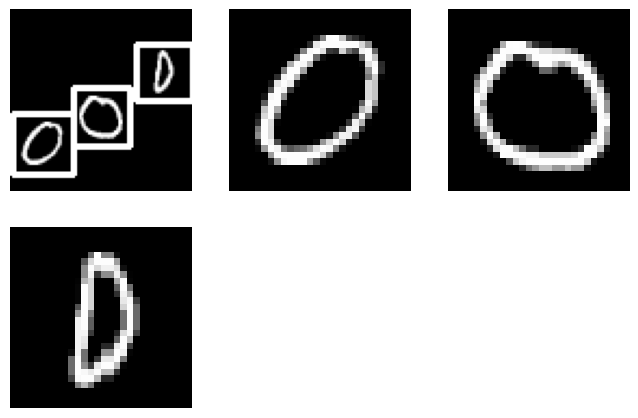

192000
60000
48000
(192000, 28, 28)
(60000, 28, 28)
(48000, 28, 28)
(192000,)
(60000,)
(48000,)
10
10
10


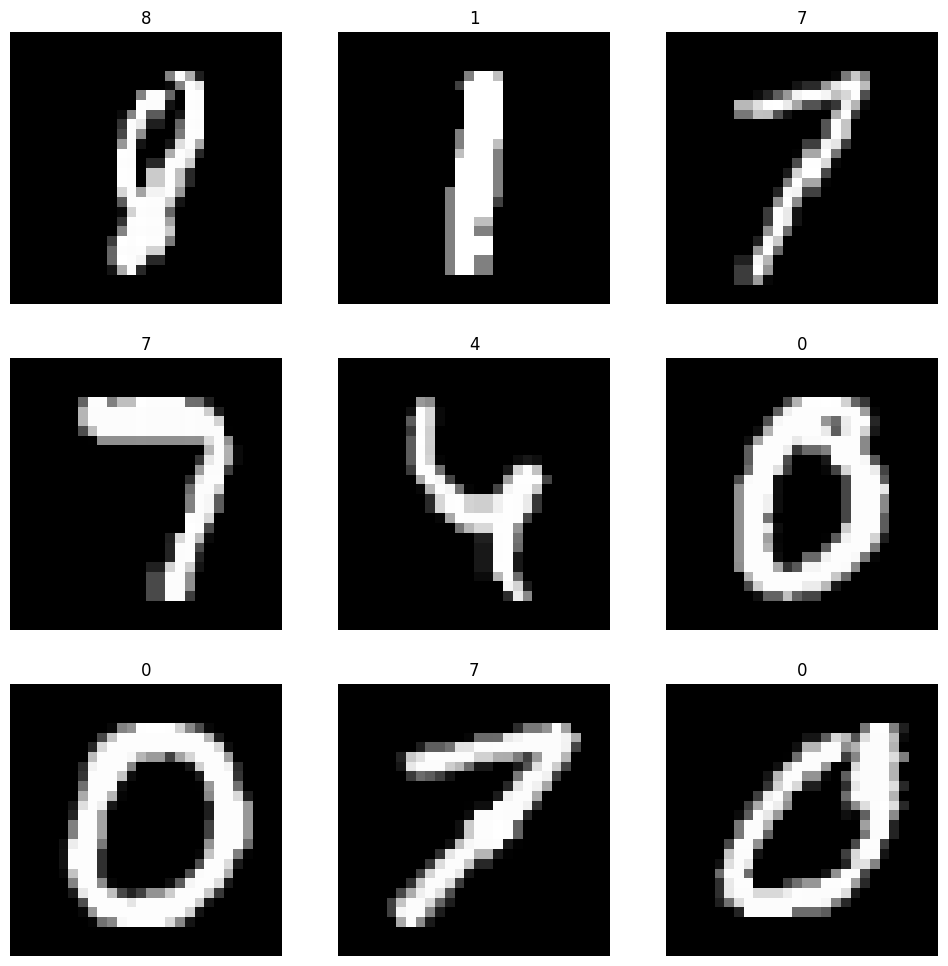

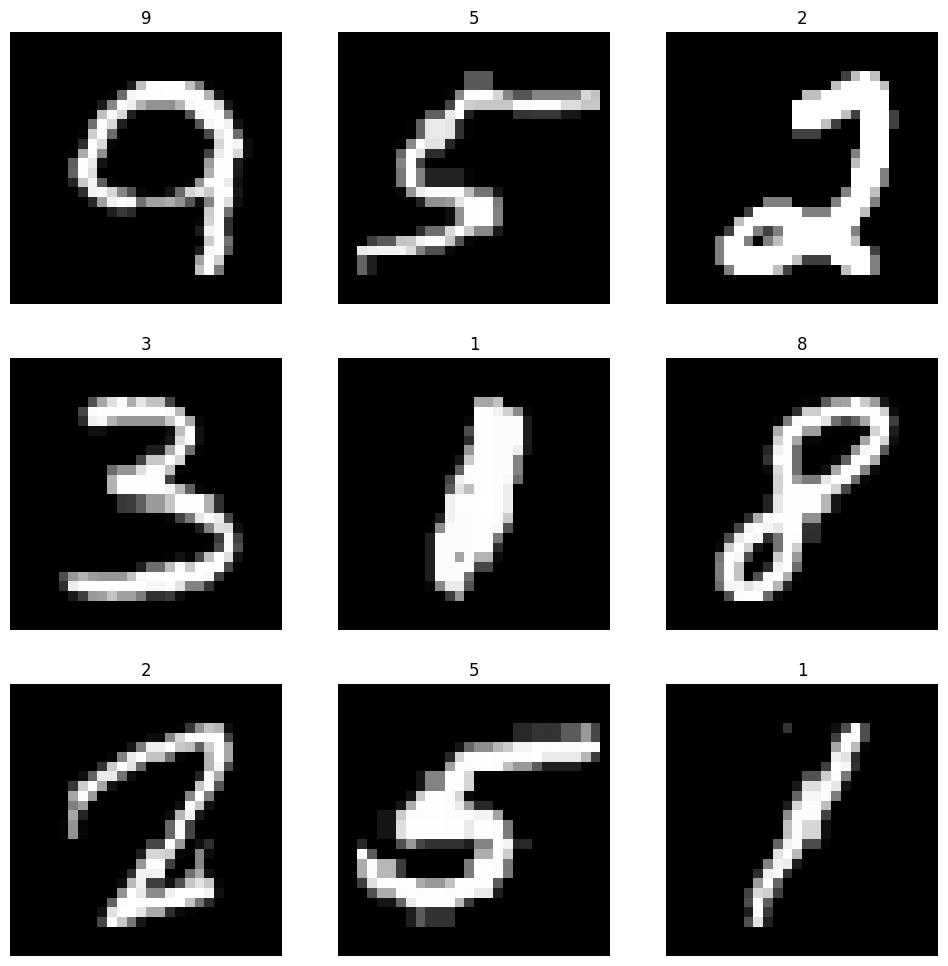

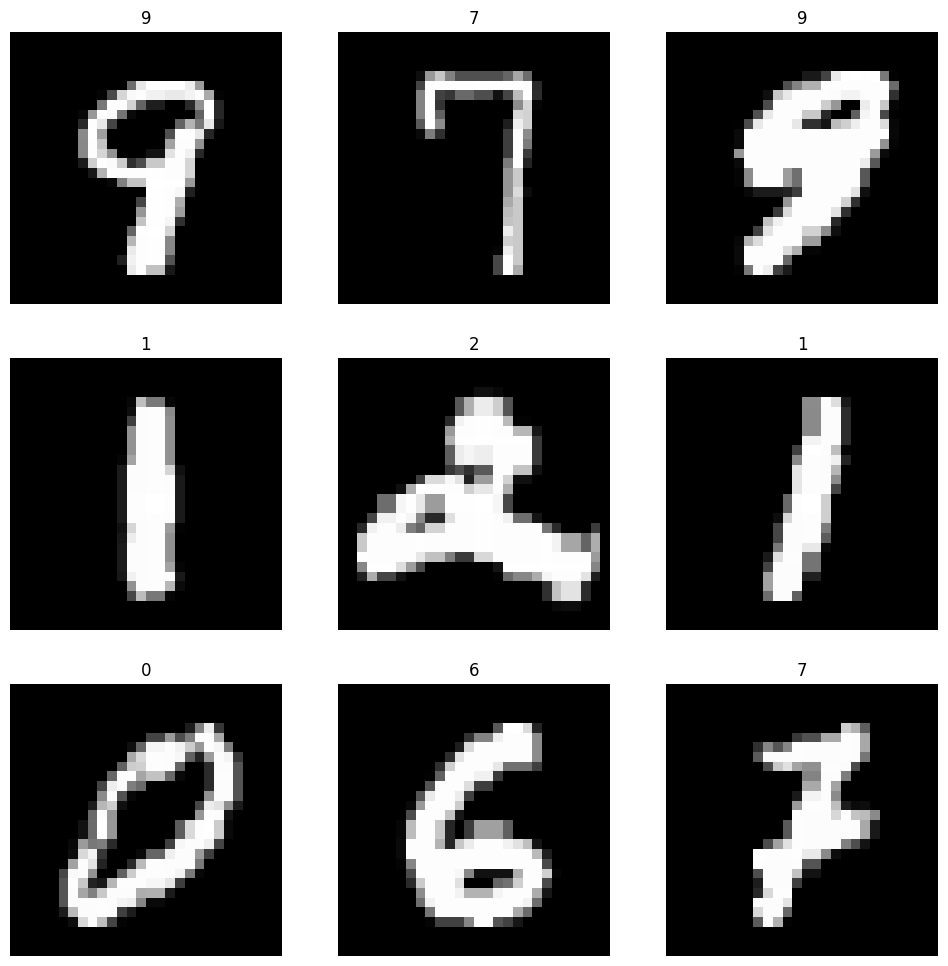

Training data shape: (196000, 28, 28, 1) (196000,)
Validation data shape: (48000, 28, 28, 1) (48000,)
Test data shape: (60000, 28, 28, 1) (60000,)
batch_size: 32, epochs: 10, learning_rate: 0.0001


/usr/local/lib/python3.10/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/10
6125/6125 ━━━━━━━━━━━━━━━━━━━━ 73s 10ms/step - accuracy: 0.9313 - auc: 0.9925 - loss: 0.2331 - precision: 0.9511 - recall: 0.9178 - val_accuracy: 0.9858 - val_auc: 0.9990 - val_loss: 0.0525 - val_precision: 0.9883 - val_recall: 0.9839
Epoch 2/10
6125/6125 ━━━━━━━━━━━━━━━━━━━━ 60s 8ms/step - accuracy: 0.9854 - auc: 0.9992 - loss: 0.0508 - precision: 0.9880 - recall: 0.9836 - val_accuracy: 0.9921 - val_auc: 0.9994 - val_loss: 0.0328 - val_precision: 0.9937 - val_recall: 0.9915
Epoch 3/10
6125/6125 ━━━━━━━━━━━━━━━━━━━━ 61s 4ms/step - accuracy: 0.9904 - auc: 0.9995 - loss: 0.0339 - precision: 0.9927 - recall: 0.9894 - val_accuracy: 0.9940 - val_auc: 0.9996 - val_loss: 0.0262 - val_precision: 0.9957 - val_recall: 0.9934
Epoch 4/10
6125/6125 ━━━━━━━━━━━━━━━━━━━━ 40s 4ms/step - accuracy: 0.9927 - auc: 0.9997 - loss: 0.0249 - precision: 0.9944 - recall: 0.9917 - val_accuracy: 0.9947 - val_auc: 0.9995 - val_loss: 0.0229 - val_precision: 0.9962 - val_recall: 0.9940
Epoch 5/10
6125/612

Single Digits Validation loss: 0.026824673637747765
Single Digits Validation accuracy: 0.9958541393280029
Single Digits Best Hyperparameters (CNN): {'batch_size': 32, 'epochs': 10, 'learning_rate': 0.0001}
Single Digits Best Accuracy Score (CNN): 0.9958541393280029


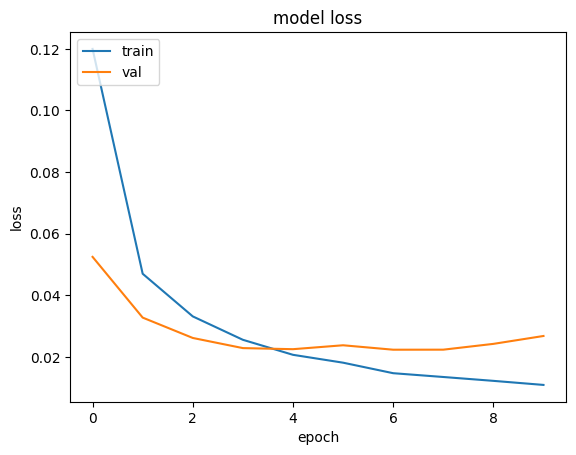

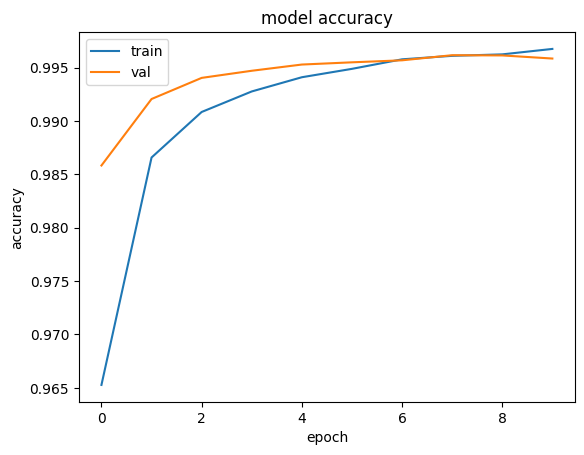

Single Digits Test loss: 0.0196557454764843
Single Digits Test accuracy: 0.9964333176612854
Single Digits Test precision: 0.9971631765365601
Single Digits Test recall: 0.9959333539009094
Single Digits Test AUC: 0.9995447993278503
single digit classific report
1875/1875 ━━━━━━━━━━━━━━━━━━━━ 3s 1ms/step


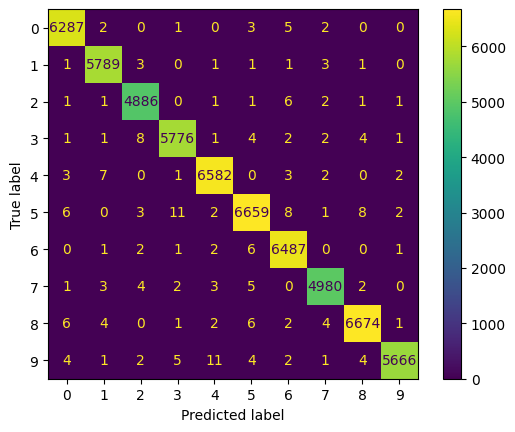

Classification Report (Single Digits):
              precision    recall  f1-score   support

           0     0.9964    0.9979    0.9971      6300
           1     0.9966    0.9981    0.9973      5800
           2     0.9955    0.9971    0.9963      4900
           3     0.9962    0.9959    0.9960      5800
           4     0.9965    0.9973    0.9969      6600
           5     0.9955    0.9939    0.9947      6700
           6     0.9955    0.9980    0.9968      6500
           7     0.9966    0.9960    0.9963      5000
           8     0.9970    0.9961    0.9966      6700
           9     0.9986    0.9940    0.9963      5700

    accuracy                         0.9964     60000
   macro avg     0.9964    0.9964    0.9964     60000
weighted avg     0.9964    0.9964    0.9964     60000

Classification Report:
              precision    recall  f1-score   support

         000     0.0000    0.0000    0.0000         0
         002     1.0000    1.0000    1.0000       100
         003    

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


[[  0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0 

In [ ]:
#TASK-3 CNN with 3 distinct digits only bTCH NORMlızatıon
import tensorflow as tf
import tensorflow.keras as keras
from tensorflow.keras import layers, models
from sklearn.metrics import classification_report, confusion_matrix
import cv2
from tensorflow.keras import models, layers, optimizers, losses, metrics
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
##### SPLIT FUNCTION AND ITS DEMONSTRATION #####
digit_shape = (28, 28)
def crop_digits(img_path: str = None, im = None):
    #if im is None:
    #    im = cv2.imread(img_path)

    #gray = cv2.cvtColor(im, cv2.COLOR_BGR2GRAY)
    blur = cv2.GaussianBlur(img_path, (5, 5), 0)
    thresh = cv2.threshold(blur, 90, 255, cv2.THRESH_BINARY+cv2.THRESH_OTSU)[1]
    contours, hierarchy = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    digits = []
    rect = img_path.copy()
    for cnt in contours:
        x, y, w, h = cv2.boundingRect(cnt)
##########################################################666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666666
        x = max(x - 3, 0)
        y = max(y - 3, 0)
        w += 6
        h += 6

        del_x = int(w / 2)
        del_y = int(h / 2)
        center_x = x + del_x
        center_y = y + del_y

        lu_corner = (max(center_x - del_y, 0), y)
        rd_corner = (max(center_x + del_y, 0), y + h)

        rect = cv2.rectangle(rect, lu_corner, rd_corner, (255, 0, 0), 2) #rectangle

        cropped = img_path[lu_corner[1]:rd_corner[1], lu_corner[0]:rd_corner[0]]
        digits.append(cropped)

    def filter_and_sort_digits(digits, contours):
        sizes = []
        for digit in digits:
            size = digit.shape[0] * digit.shape[1]
            sizes.append(size)
        avg_size = sum(sizes) / len(sizes)
        deviations = [abs(size - avg_size) for size in sizes]

        indices = np.argsort(deviations)[0:3]
        digits = [digits[i] for i in indices]
        contours = [cv2.boundingRect(contours[i]) for i in indices]

        xs = [contour[0] for contour in contours]
        indices = np.argsort(xs) #get highest likelihood digit
        digits = [digits[i] for i in indices]

        while len(digits) < 3:
            digits.append(digits[0])
        return digits

    digits = filter_and_sort_digits(digits, contours) #get highest likelihood digits
    digits = [cv2.resize(digit, digit_shape, interpolation = cv2.INTER_NEAREST) for digit in digits] #resize to 28,28

    return digits, contours, rect

print(f"Label: {train_labels[0]}")
print(train_labels[0][0])
print(train_labels[0][1])
print(train_labels[0][2])

fig = plt.figure(figsize=(8, 8))
cols, rows = 3, 3

digits, contours, rect = crop_digits(train_images[0])

fig.add_subplot(rows, cols, 1)
plt.axis("off")
plt.imshow(rect.squeeze(), cmap="gray")
for i in range(len(digits)):
    img = digits[i]
    print(train_labels[0][i])
    fig.add_subplot(rows, cols, i+2)
    plt.axis("off")
    plt.imshow(img.squeeze(), cmap="gray")
    print(f"crop shape: {img.shape}")
plt.show()


##### SPLIT ALL DATA TO DIGITS #####
def load_digits(images, labels):
  all_digits = []
  all_labels = []
  for i in range(len(images)):
    digits, contours, rect = crop_digits(images[i])
    for j in range(len(digits)):
      all_digits.append(digits[j])
      all_labels.append(labels[i][j])
  return np.array(all_digits), np.array(all_labels)

train_images, train_labels = load_digits(train_images, train_labels)
test_images_digits, test_labels_digits = load_digits(test_images, test_labels)
val_images, val_labels = load_digits(val_images, val_labels)
print(len(train_images))
print(len(test_images_digits))
print(len(val_images))
print(train_images.shape)
print(test_images_digits.shape)
print(val_images.shape)
print(train_labels.shape)
print(test_labels_digits.shape)
print(val_labels.shape)

print(len(np.unique(train_labels)))
print(len(np.unique(test_labels_digits)))
print(len(np.unique(val_labels)))

def visualize(images, labels):
  np.random.seed(42)
  random_indices = np.random.choice(len(images), size=9, replace=False)
  random_images = images[random_indices]
  random_labels = labels[random_indices]

  fig, axes = plt.subplots(3, 3, figsize=(12, 12))
  for i, (img, label) in enumerate(zip(random_images, random_labels)):
      ax = axes[i // 3, i % 3]
      ax.imshow(img, cmap='gray')
      ax.set_title(label)
      ax.axis('off')
  plt.show()

visualize(train_images, train_labels)
visualize(test_images_digits, test_labels_digits)
visualize(val_images, val_labels)

################################################################################################################################maxpooling iyii sionuc asssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssss
##### TRAIN CNN #####


train_images = train_images / 255.0
val_images = val_images / 255.0
test_images_digits = test_images_digits / 255.0

train_images = train_images.reshape((train_images.shape[0], 28, 28, 1))
val_images = val_images.reshape((val_images.shape[0], 28, 28, 1))
test_images_digits = test_images_digits.reshape((test_images_digits.shape[0], 28, 28, 1))
train_images = np.concatenate([train_images,all_fake_images], axis=0)
train_labels = np.concatenate([train_labels,all_fake_labels], axis=0)
print('Training data shape:', train_images.shape, train_labels.shape)
print('Validation data shape:', val_images.shape, val_labels.shape)
print('Test data shape:', test_images_digits.shape, test_labels_digits.shape)

train_labels = tf.keras.utils.to_categorical(train_labels, num_classes=10)
val_labels = tf.keras.utils.to_categorical(val_labels, num_classes=10)
test_labels_digits = tf.keras.utils.to_categorical(test_labels_digits, num_classes=10)



# FOR TASK 4, NO HYPERPARAM SEARCH NEEDED!
param_grid_cnn = {
    'batch_size': [32],
    'epochs': [10],
    'learning_rate': [1e-4],
    #'batch_size': [32],
    #'epochs': [7],
    #'learning_rate': [1e-2],
}

best_params_cnn = None
best_accuracy_cnn = -1
for batch_size in param_grid_cnn['batch_size']:
    for epochs in param_grid_cnn['epochs']:
        for learning_rate in param_grid_cnn['learning_rate']:
          print(f"batch_size: {batch_size}, epochs: {epochs}, learning_rate: {learning_rate}")
          model = models.Sequential()
          model.add(layers.Conv2D(64, (3, 3), activation='relu', input_shape=(28, 28, 1)))
          model.add(layers.BatchNormalization()) #### FOR TASK 4
          model.add(layers.MaxPooling2D((2, 2)))
          model.add(layers.Conv2D(128, (3, 3), activation='relu'))
          model.add(layers.BatchNormalization()) #### FOR TASK 4
          model.add(layers.MaxPooling2D((2, 2)))
          model.add(layers.Flatten())
          model.add(layers.Dense(128, activation='relu'))
          model.add(layers.Dropout(0.3)) #0.7 #### FOR TASK 4
          model.add(layers.Dense(10, activation='softmax'))
          model.compile(loss="categorical_crossentropy", optimizer=keras.optimizers.Adam(learning_rate=learning_rate), metrics=["accuracy", metrics.Precision(), metrics.Recall(), metrics.AUC()])


          history = model.fit(train_images, train_labels, batch_size=batch_size, epochs=epochs, validation_data=(val_images, val_labels))

          score_train = model.evaluate(train_images, train_labels, verbose=0)
          print("Single Digits Train loss:", score_train[0])
          print("Single Digits Train accuracy:", score_train[1])
          score_val = model.evaluate(val_images, val_labels, verbose=0)
          print("Single Digits Validation loss:", score_val[0])
          print("Single Digits Validation accuracy:", score_val[1])
          if score_val[1] > best_accuracy_cnn:
                  best_accuracy_cnn = score_val[1]
                  best_params_cnn = {'batch_size': batch_size, 'epochs': epochs, 'learning_rate':learning_rate}
                  model.save('best_model.h5')

print("Single Digits Best Hyperparameters (CNN):", best_params_cnn)
print("Single Digits Best Accuracy Score (CNN):", best_accuracy_cnn)
model = tf.keras.models.load_model('best_model.h5')
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

score = model.evaluate(test_images_digits, test_labels_digits, verbose=0)
print("Single Digits Test loss:", score[0])
print("Single Digits Test accuracy:", score[1])
print("Single Digits Test precision:", score[2])
print("Single Digits Test recall:", score[3])
print("Single Digits Test AUC:", score[4])
print("single digit classific report")
predictions_digits = model.predict(test_images_digits)
predicted_labels_digits = np.argmax(predictions_digits, axis=1)  # Convert predictions to class labels
true_labels_digits = np.argmax(test_labels_digits, axis=1)  # Convert one-hot encoded labels to class labels
cm = confusion_matrix(true_labels_digits, predicted_labels_digits)
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot()
plt.show()

# Print the classification report for single digits
print("Classification Report (Single Digits):")
print(classification_report(true_labels_digits, predicted_labels_digits, digits=4))

final_test_predictions = []
for i in range(len(test_images)):
  img = test_images[i]
  concat = ""
  for j in range(0,3):
    img_digit = test_images_digits[3*i + j]
    #prediction = model.predict_on_batch([img_digit])
    prediction = model.predict_on_batch(np.expand_dims(img_digit, axis=0))
    prediction = np.argmax(prediction)
    #print(prediction, test_labels[i])
    concat = concat + str(prediction)
  #print(concat, test_labels[i])
  final_test_predictions.append(concat)

np.set_printoptions(threshold=np.inf)

print("Classification Report:")
print(classification_report(test_labels, final_test_predictions, digits = 4))

print("\nConfusion Matrix:")
print(confusion_matrix(test_labels, final_test_predictions))